<a href="https://colab.research.google.com/github/huonggiangdhtn/DLightNet/blob/main/backup_of_small2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install torchmetrics

     |████████████████████████████████| 397 kB 2.7 MB/s 


In [ ]:
from collections import namedtuple
import matplotlib.pyplot as plt
import tensorflow as tf
from __future__ import division
import math
import os
import os.path as osp
import random
from glob import glob
import cv2
import numpy as np
# from cityscapesscripts.helpers.labels import trainId2label
from torch.utils.data import Dataset
from torchvision import transforms
import random
import torch
from torch import nn
from torch.nn import functional as F

In [ ]:

Label = namedtuple( 'Label' , [

    'name'        ,

    'id'          , 
    'trainId'     , 
    'category'    , 
    'categoryId'  , 

    'hasInstances',
    'ignoreInEval', 

    'color'       , 
    ] )
labels = [
    #       name                     id    trainId   category            catId     hasInstances   ignoreInEval   color
    Label(  'ground   '            ,  0 ,       0 , 'tomato'             , 0       , False        , False         , (  0,    0,  0   ) ),
    Label(  'stem'                 ,  1 ,       1 , 'tomato'             , 0       , False        , False         , (128, 64,  128) ),
   # Label(  'leaf'                 ,  2 ,       2 , 'tomato'             , 0       , False        , True         , ( 244,  35, 232) ),
    Label(  'branch'               ,  3 ,       2 , 'tomato'             , 0       , False        , False         , (250, 170,160) ),
    Label(  'sucker branch'        ,  4 ,       3 , 'tomato'             , 0       , False        , False         , (0, 255,0) ),
   # Label(  'fruit'                ,  5 ,       5 , 'tomato'             , 0       , False        , True         , (220, 20,60) ),
   # Label(  'flowerbranch'         ,  6 ,       6 , 'tomato'             , 0       , False        , True         ,  (172, 16,0) ),
 #   Label(  'flower'               ,  7 ,       7 , 'tomato'             , 0       , False        , True         , (255, 255,0) ),
 #   Label(  'fork'               ,  8 ,       4 , 'tomato'             , 0       , False        , False         , (0, 0,255) ),
  #  Label(  'sketleton'               ,  9 ,       1 , 'tomato'             , 0       , False        , True         , (0, 0,255) ),

]
relevant_labels = [l for l in labels if not l.ignoreInEval]
number_of_labels = len(relevant_labels) # all relevant + not mapped
min_label_id = min([l.trainId for l in relevant_labels])
max_label_id = max([l.trainId for l in relevant_labels])
import matplotlib.colors as colors

colorsList = [np.array(l.color)/255 for l in relevant_labels]   #colorsList = [np.array(l.color)/255 for l in relevant_labels]
LabelCmap = colors.ListedColormap(colorsList)

bounds = np.linspace(min_label_id, max_label_id, number_of_labels)
#bounds = np.linspace(1, 9, 9)
norm = colors.BoundaryNorm(bounds, LabelCmap.N)
def display_labels(labels, ax=None):  
  if ax is None:
    plt.imshow(labels, cmap=LabelCmap, vmin=min_label_id, vmax=max_label_id)
    cbar = plt.colorbar(cmap=LabelCmap,  orientation='horizontal',spacing='proportional')
   # cbar = plt.colorbar(cmap=LabelCmap, norm=norm, orientation='horizontal',spacing='proportional', ticks=bounds, boundaries=bounds)
  #  cbar.ax.set_xticklabels([l.name for l in relevant_labels], rotation=90)  
  else:
    return ax.imshow(labels, cmap=LabelCmap, vmin=min_label_id, vmax=max_label_id)

def convert_to_relevant_labels(input_label): 
  """Convert a <raw> label input image to only <relevant> ids. Class 0 means unlabeled"""
  label = np.zeros(input_label.shape)  
  for l in relevant_labels:
    label[input_label == l.id] = l.trainId
  return label
def convert_to_category(input_lable):
  
  #label = np.zeros(input_label.shape)  
  for l in relevant_labels:
   input_lable = torch.where(input_lable ==l.trainId ,l.categoryId, 0 )
  return input_lable
 #display 
def display(display_list):
  fig, axes = plt.subplots(1, len(display_list), sharey=True)
  fig.set_size_inches(15, 5)

  title = ['Input Image', 'Ground-truth Labels', 'Stage 1 Prediction Labels','Hard Pixels',' Labels state2','Labels state1']    
  
  im = None
  for i in range(len(display_list)):
    axes[i].set_title(title[i])    
    y = display_list[i]  
     
    if 'Label' in title[i]:
      y = y.reshape(480,640)
    #  im = display_labels(tf.keras.preprocessing.image.array_to_img(y, scale=False), ax=axes[i])
      im = display_labels(y, ax=axes[i])
    else:
       
      im = axes[i].imshow(tf.keras.preprocessing.image.array_to_img(y))  
    #    im = axes[i].imshow(y)    
    #plt.axis('off')
    axes[i].axis('off')

  cbar = plt.colorbar(im, ax=axes.ravel().tolist(), cmap=LabelCmap, norm=norm, orientation='horizontal',spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')
  cbar.ax.set_xticklabels([l.name for l in relevant_labels], rotation=90)     
  plt.show()

In [ ]:
import os
import os.path as osp
import random
from glob import glob
import cv2
import numpy as np
# from cityscapesscripts.helpers.labels import trainId2label
from torch.utils.data import Dataset
from torchvision import transforms

city_mean, city_std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
#transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize(city_mean, city_std)])

palette = []
# for key in sorted(trainId2label.keys()):
#     if key != -1 and key != 255:
#         palette += list(trainId2label[key].color)

def load_data2( split='train'):
  
    path = '/content/drive/MyDrive/colab/images/depthdataset'
    train_x = sorted(glob(os.path.join(path, "augment1/images/*")))
    train_y = sorted(glob(os.path.join(path, "augment1/masks/*")))
    train_z = sorted(glob(os.path.join(path, "augment1/depths/*")))
    valid_x = sorted(glob(os.path.join(path, "augment2/images/*")))
    valid_y = sorted(glob(os.path.join(path, "augment2/masks/*")))
    valid_z = sorted(glob(os.path.join(path, "augment2/depths/*")))
    test_x = sorted(glob(os.path.join(path, "augment3/images/*")))
    test_y = sorted(glob(os.path.join(path, "augment3/masks/*")))
    test_z = sorted(glob(os.path.join(path, "augment3/depths/*")))
    print('path',path)
   # print('trainx',os.path.join(path, "augment1/images/*"))
    if (split == 'train'):
      return (train_x, train_y,train_z)
    elif (split == "val"):
      return (valid_x, valid_y, valid_z)
    else:
        return (test_x, test_y,test_z)
def load_data1():
      path = '/content/drive/MyDrive/colab/images/depthdataset'
      splits=0.1
      images = sorted(glob(os.path.join(path, "dec13/images/*")))
      masks = sorted(glob(os.path.join(path, "dec13/masks/*")))
      depths = sorted(glob(os.path.join(path, "dec13/depths/*")))
      total_size = len(images)
      return images,masks

def loadimage(x,y):
        transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Lambda(lambda x: x.float()),
              transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
          ])
        image = cv2.imread(x, cv2.IMREAD_COLOR)
        label = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
        label = convert_to_relevant_labels(label)
      #  name = self.images[index].split('/')[-1].split(".")[0]
        name = x.split('/')[-1]
   
        image = transform(image)
        
       
      #  image = image.transpose((2, 0, 1))
        label = np.asarray(label, np.compat.long)
        return image, label, name
      #----------
def loadimagedepth(x,y,z=None):
        transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Lambda(lambda x: x.float()),
              transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
          ])
        image = cv2.imread(x, cv2.IMREAD_COLOR)
        label = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
        if(z!= None):
           depth = cv2.imread(z, cv2.IMREAD_COLOR)
        else:
          depth = np.zeros((480, 640 ,3))
        image =transform(image)
        re = np.zeros((480, 640 ,1))
        img = np.asarray(image)
        data = np.asarray(depth,np.float32)
        re = data[:,:,2] + data[:,:,1]*255 + data[:,:,0]*255*255
        min = np.mean(re)
        re = re - min
      #  print('imgsize',image.size())
        re = re.astype(np.float32)
       # print(type(re))
        re = torch.FloatTensor(re).unsqueeze(0) *0.01

     #   print('re',re.size())
        # nimg =torch.cat((image,re.unsqueeze(0)),0)
     #   print('nimg',nimg.size())
        image = torch.cat((image,re),0)
        label = convert_to_relevant_labels(label)
        name = x.split('/')[-1]
        label = np.asarray(label, np.compat.long)
        return image, label, name
      #----------
def loadimagedepth1(x,y,z=None):
        transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Lambda(lambda x: x.float()),
              transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
          ])
        image = cv2.imread(x, cv2.IMREAD_COLOR)
        label = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
        depth = cv2.imread(z, cv2.IMREAD_COLOR)
        image = transform(image)
        re = np.zeros((480,640,1))
        img = np.asarray(image)
        data = np.asarray(depth)
        
        re = data[:,:,2] + data[:,:,1]*255 + data[:,:,0]*255*255
        min = np.mean(re)
        re = re - min
      #  print('imgsize',image.size())
        re = re.astype(np.float32)
        #print(type(re))

        re = torch.FloatTensor(re).unsqueeze(0) *0.01
       # print(re)
   
        label = convert_to_relevant_labels(label)
       
       
      
        label = np.asarray(label, np.compat.long)
        label = torch.LongTensor(label)
        return image, label, re
      #----------

class Tomatos(Dataset):


    def __init__(self, root, split='train', crop_size=(480, 640), isdepth = False, std=city_std, ignore_label=255):
        self.transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Lambda(lambda x: x.float()),
              transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
          ])
        self.split = split
        self.crop_h, self.crop_w = crop_size
        self.h = 480
        self.w = 640
        self.isdepth = isdepth
        self.std = std
        self.ignore_label = ignore_label
      #  self.files = []
        self.images, self.masks, self.depths = load_data2(split = self.split)
   #     print(len(self.images))
        # for root_dir, dirs, files in os.walk(osp.join(root, 'leftImg8bit', split)):
        #     for file in files:
        #         img_file = osp.join(root_dir, file)
        #         label_file = osp.join(root_dir.replace('leftImg8bit', 'gtFine'),
        #                               file.replace('leftImg8bit', 'gtFine_labelTrainIds'))
        #         self.files.append({'img': img_file, 'label': label_file, 'name': file})

    def __len__(self):
        return len(self.images)
   
    def  __getitem__(self, index):
      if self.isdepth == True:
          return self.__getitem2__(index)
      else:
          return self.__getitem1__(index)
          
    def __getitem3__(self, index):
      #  print('getimte')
       # datafiles = self.files[index]
        image = cv2.imread(self.images[index], cv2.IMREAD_COLOR)
        label = cv2.imread(self.masks[index], cv2.IMREAD_GRAYSCALE)
        if(len(self.depths) > 0):
        #   print('co doc depth')
           depth = cv2.imread(self.depths[index], cv2.IMREAD_COLOR)
        else:
          depth = np.zeros(self.h, self.w ,3)
        image = self.transform(image)
        re = np.zeros((self.h,self.w,1))
        img = np.asarray(image)
        data = np.asarray(depth)
        
        re = data[:,:,2] + data[:,:,1]*255 + data[:,:,0]*255*255
        min = np.mean(re)
        re = re - min
      #  print('imgsize',image.size())
        re = re.astype(np.float32)
        #print(type(re))

        re = torch.FloatTensor(re).unsqueeze(0) *0.01
       # print(re)
   
        label = convert_to_relevant_labels(label)
      #  name = self.images[index].split('/')[-1]
       
      
        label = np.asarray(label, np.compat.long)
        label = torch.LongTensor(label)
        return image, label, re
  
    def __getitem2__(self, index):
      #  print('getimte')
       # datafiles = self.files[index]
        image = cv2.imread(self.images[index], cv2.IMREAD_COLOR)
        label = cv2.imread(self.masks[index], cv2.IMREAD_GRAYSCALE)
        if(len(self.depths) > 0):
           depth = cv2.imread(self.depths[index], cv2.IMREAD_COLOR)
        else:
          depth = np.zeros(self.h, self.w ,3)
        image = self.transform(image)
        re = np.zeros((self.h,self.w,1))
      #  img = np.asarray(image)
        data = np.asarray(depth)
        
        re = data[:,:,2] + data[:,:,1]*255 + data[:,:,0]*255*255
        min = np.mean(re)
        re = re - min
      #  print('imgsize',image.size())
        re = re.astype(np.float32)
        #print(type(re))
        re = torch.FloatTensor(re).unsqueeze(0) *0.01
        # print(image.size())
        # print(re.size())
        image = torch.cat((image,re),0)
   
        label = convert_to_relevant_labels(label)
        name = self.images[index].split('/')[-1]
       
      
        label = np.asarray(label, np.compat.long)
        label = torch.LongTensor(label)
        return image, label, name

    def __getitem1__(self, index):
      #  print('getimte')
       # datafiles = self.files[index]
        image = cv2.imread(self.images[index], cv2.IMREAD_COLOR)
        label = cv2.imread(self.masks[index], cv2.IMREAD_GRAYSCALE)
       
        label = convert_to_relevant_labels(label)
        name = self.images[index].split('/')[-1]
        image = self.transform(image)
        label = np.asarray(label, np.compat.long)
        label = torch.LongTensor(label)
        return image, label, name

In [ ]:
import argparse
import os
import time

import pandas as pd
import torch
import torch.optim as optim
# from cityscapesscripts.helpers.labels import trainId2label
#from thop import profile, clever_format
from torch import nn
from torch.utils.data import DataLoader
from torchvision.transforms import ToPILImage
from tqdm import tqdm
from torchmetrics import JaccardIndex
import shutil
from torchvision import models 
from torchsummary import summary

# train or val for one epoch

class Parg():
  def __init__(self, data_path='/home/data/cityscapes',crop_h=480,crop_w=640,batch_size=12,save_step=5,epochs=100):
      self.data_path = data_path
      self.crop_h = crop_h
      self.crop_w = crop_w
      self.batch_size = batch_size
      self.save_step = save_step
      self.epochs = epochs


def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1)  # BATCH x 1 x H x W => BATCH x H x W
    SMOOTH = 1e-6
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
    
    return thresholded  # Or thresholded.mean() if you are interested in average across the batch
    
    
    # parser = argparse.ArgumentParser(description='Train Fast-SCNN')
    # parser.add_argument('--data_path', default='/home/data/cityscapes', type=str,
    #                     help='Data path for cityscapes dataset')
    # parser.add_argument('--crop_h', default=480, type=int, help='Crop height for training images')
    # parser.add_argument('--crop_w', default=640, type=int, help='Crop width for training images')
    # parser.add_argument('--batch_size', default=12, type=int, help='Number of data for each batch to train')
    # parser.add_argument('--save_step', default=5, type=int, help='Number of steps to save predicted results')
    # parser.add_argument('--epochs', default=100, type=int, help='Number of sweeps over the dataset to train')

    # # args parse
    # args = parser.parse_args()
class Trainner():
  def __init__(self,net,modelname, batch_size,isdepth=False,num_output = 1):
    self.args = Parg()
    self.n = 480
    self.isdepth = False
    self.isdepths = isdepth
    self.num_output = num_output
    self.n2 =640
    self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    data_path, crop_h, crop_w = self.args.data_path, self.args.crop_h, self.args.crop_w
    self.batch_size, self.save_step, self.epochs = self.args.batch_size, self.args.save_step, self.args.epochs
    self.path = '/content/drive/MyDrive/colab/images/depthdataset'
    self.weights = '/content/drive/MyDrive/colab/images/depthdataset/weights'
    self.testresult = '/content/drive/MyDrive/colab/images/depthdataset/testresult/'
    self.modelname = modelname
    self.datasetname = 'tomato'
    self.batch_size =batch_size
    self.epoch = 0
    self.val_mPA = 0
    self.val_iou = 0
    self.cur_iters = 0
    self.maxfps = 0
    self.mpA = 0 
    self.epochs = 40
    self.lr = 0.0025
    #self.lr = 0.00002
# dataset, model setup and optimizer config
    self.train_data = Tomatos(root=data_path, split='train', isdepth = self.isdepths)
    self.val_data = Tomatos(root=data_path, split='val',isdepth = self.isdepths)
    self.test_data = Tomatos(root=data_path, split='test',isdepth = self.isdepths)
    self.train_loader = DataLoader(self.train_data, batch_size=self.batch_size, shuffle=True, num_workers=4)

    self.val_loader = DataLoader(self.val_data, batch_size=self.batch_size, shuffle=False, num_workers=4)
    self.test_loader = DataLoader(self.test_data, batch_size=self.batch_size, shuffle=False, num_workers=4)
    self.model = net(in_channels=3, num_classes=4).to(self.device)

    self.optimizer = optim.Adam(self.model.parameters(), lr=self.lr   )


   # self.lr_scheduler = LRScheduler(mode='poly', base_lr=self.lr, nepochs=100,
    #                           iters_per_epoch=170, power=0.7)
    self.fiou = JaccardIndex(num_classes=4).to(self.device)
 
    # self.flops, self.params = profile(self.model, inputs=(torch.randn(1, 3, crop_h, crop_w).cuda(),))
    # self.flops, self.params = clever_format([self.flops, self.params])
    # print('# Model Params: {} FLOPs: {}'.format(self.params, self.flops))
    self.loss_criterion = nn.CrossEntropyLoss(ignore_index=255)
    self.best_mPA = 0.0
  def save_checkpoint_val(self):
      filename = '{}_{}_bestval.pth'.format(self.modelname, self.datasetname)
      save_path = os.path.join(self.weights, filename)
      torch.save(self.model.state_dict(), save_path)

  def save_checkpoint(self, is_best=False):
    """Save Checkpoint"""
   # directory = os.path.expanduser(self.weights)
    if not os.path.exists(self.weights):
        os.makedirs(self.weights)
    filename = '{}_{}_{}.pth'.format(self.modelname, self.datasetname,self.epoch)
    save_path = os.path.join(self.weights, filename)
    torch.save(self.model.state_dict(), save_path)
    if is_best:
        best_filename = '{}_{}_best_model.pth'.format(self.modelname, self.datasetname)
        best_filename = os.path.join(self.weights, best_filename)
      #  shutil.copyfile(filename, best_filename)
        shutil.copyfile(save_path, best_filename)
  
  def load_weight(self,save_path=""):
        if(save_path == ""):
            filename = '{}_{}.pth'.format(self.modelname, self.datasetname)
            save_path = os.path.join(self.weights, filename)
        if os.path.isfile(save_path):
            name, ext = os.path.splitext(save_path)
            assert ext == '.pkl' or '.pth', 'Sorry only .pth and .pkl files supported.'
            print('Resuming training, loading {}...'.format(save_path))
            self.model.load_state_dict(torch.load(save_path, map_location=lambda storage, loc: storage))      
  def load_epoch(self,epoch=0):
    
      
        filename = '{}_{}_{}.pth'.format(self.modelname, self.datasetname,epoch)
        save_path = os.path.join(self.weights, filename)
        if os.path.isfile(save_path):
            name, ext = os.path.splitext(save_path)
            assert ext == '.pkl' or '.pth', 'Sorry only .pth and .pkl files supported.'
            print('Resuming training, loading {}...'.format(save_path))
            self.model.load_state_dict(torch.load(save_path, map_location=lambda storage, loc: storage))    
  def load_weight_best(self,save_path=""):
        if(save_path == ""):
            filename = '{}_{}_best_model.pth'.format(self.modelname, self.datasetname)
            save_path = os.path.join(self.weights, filename)
        if os.path.isfile(save_path):
            name, ext = os.path.splitext(save_path)
            assert ext == '.pkl' or '.pth', 'Sorry only .pth and .pkl files supported.'
            print('Resuming training, loading {}...'.format(save_path))
            self.model.load_state_dict(torch.load(save_path, map_location=lambda storage, loc: storage))                     
  def load_weight_bestval(self,save_path=""):
        if(save_path == ""):
            filename = '{}_{}_bestval.pth'.format(self.modelname, self.datasetname)
            save_path = os.path.join(self.weights, filename)
        if os.path.isfile(save_path):
            name, ext = os.path.splitext(save_path)
            assert ext == '.pkl' or '.pth', 'Sorry only .pth and .pkl files supported.'
            print('Resuming training, loading {}...'.format(save_path))
            self.model.load_state_dict(torch.load(save_path, map_location=lambda storage, loc: storage))                     
 
  def find_suckerbool(self, mask):
      s_noise = 160
      suckerlayer_bool = np.zeros(mask.shape)
      suckerlayer_bool[mask == 3] = 1
    #------------
    #delete noise
      connectivity = 8 
      sucker_region  =  np.array(suckerlayer_bool*255, dtype= np.uint8)
      retval_sucker, labels_sucker, stats_sucker, centroid_suckers = cv2.connectedComponentsWithStats(sucker_region, connectivity, cv2.CV_32S  )
      Saturation_number =s_noise
      suckers = [] #list of sucker has area > 30
      #stats_suckers at colum 4 is area
      for s in range(1,len(stats_sucker)):
          if stats_sucker[s,4] <= Saturation_number:
            labels_sucker[labels_sucker == s] = 0
          else:
            suckers.append((stats_sucker[s,0:4],s))  
      suckerlayer_bool[labels_sucker == 0] = 0
      return suckerlayer_bool,suckers,labels_sucker

  def count_sucker(self, yps,labels):
      found = 0
      found_w = 0
      sum = 0
      sum_w = 0
      n = yps.size()[0]
      for i in range (0,n):
          yp = yps[i].cpu().numpy()
          yp = yp.reshape(480,640)
          label = labels[i].cpu().numpy()
          label = label.reshape(480,640)
          p_bool,p_suckers,p_labels_sucker = self.find_suckerbool(yp)
          l_bool, l_suckers,labels_sucker = self.find_suckerbool(label)
         # plt.imshow(p_bool)
          n_sucker = len(l_suckers)
          list_suckers = np.zeros((n_sucker,480,640))
          for i in range(0,n_sucker):
            sucker = l_suckers[i]
            l_sucker = np.zeros((480,640))
            true_sucker = np.zeros((480,640))
            l_sucker[labels_sucker == sucker[1]] = 1  #forklayer get value 1
            true_sucker= p_bool + l_sucker
            if true_sucker.max() == 2: # only forklayer have intersection area
              found = found + 1
            sum += 1

          n_sucker = len(p_suckers)
          list_suckers = np.zeros((n_sucker,480,640))
          for i in range(0,n_sucker):
            sucker = p_suckers[i]
            l_sucker = np.zeros((480,640))
            true_sucker = np.zeros((480,640))
            l_sucker[p_labels_sucker == sucker[1]] = 1  #forklayer get value 1
            true_sucker= l_bool + l_sucker
            if true_sucker.max() == 1: # only forklayer have intersection area
              found_w = found_w + 1
            sum_w += 1

      return found,sum,found_w,sum_w

 

  def train(self):
    start = self.epoch
    for self.epoch in range(start, self.epochs + 1):
        self.train_loss, self.train_mPA = self.train_val()
        if self.train_loss <0.05 or self.epoch >= 0:
          if(self.num_output == 3):
              self.val_loss, val_mPA = self.eval_3output()
          else:
                  self.val_loss, val_mPA = self.eval()
          if self.val_mPA < val_mPA : 
              self.save_checkpoint_val()
              self.val_mPA = val_mPA
     
        # data_frame = pd.DataFrame(data=results, index=range(1, self.epoch + 1))
        # data_frame.to_csv('{}_{}_statistics.csv'.format(crop_h, crop_w), index_label='epoch')
        # if self.val_mPA > self.best_mPA:
        #     self.best_mPA = self.val_mPA
        #     torch.save(model.state_dict(), '{}_{}_model.pth'.format(crop_h, crop_w))


  def train_val(self):
    # if self.epoch == 17:
    #     self.lr = 0.002
    self.model.train() 
   # print('b5')
    cur_lr = 0
    totals = 0
    total_iou1 = 0
    total_iou,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.train_loader)
    torch.enable_grad() #if is_train else torch.no_grad()):
    num = 0
    for data, target, depth in data_bar:
       #     print('b6')
            self.cur_iters = self.cur_iters + 1
            num += 1
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False:
                data, target= data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)
            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
               
           # print(out)
            if(self.num_output > 1):
                  out1 = out[0]
                  out = out[1]
            if(self.modelname == 'custom_DeepLabv3'):
                out =out['out']
            prediction = torch.argmax(out, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out, target)
            iou_s1 = self.fiou(out.data.to(self.device), target.data.to(self.device))
            if self.num_output == 1:
                total_loss += (loss.item() ) * data.size(0)
             #   total_iou += iou_s1
            else:

                loss1 = self.loss_criterion(out1, target)
                iou_s2 = self.fiou(out1.data.to(self.device), target.data.to(self.device))
                total_loss += (loss.item() + loss1.item()) * data.size(0)/2
                total_iou += iou_s2
                  
            total_iou1 += iou_s1
            self.lr = self.lr*0.9997
            for param_group in self.optimizer.param_groups:
                param_group['lr'] = self.lr
            self.optimizer.zero_grad()
            if(self.num_output == 1):
                loss.backward()
            else:
              # if( self.epoch <8):
              #     loss1.backward()
              # else:
              #   loss1.backward() #retain_graph=True

              #  loss1.backward()
                loss.backward()
                

            
            self.optimizer.step()
           
            total_num += data.size(0)
            total_time += end_time - start_time
            
            total_correct += torch.sum(prediction == target).item() / target.numel() * data.size(0)
            
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} sucker: {:.4f} IOU1: {:.4f}'
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,
                                             self.lr,totals,total_iou1/num))
    best = False
    if self.mpA < total_correct / total_num * 100:
              self.mpA = total_correct / total_num * 100
              best = True
    self.save_checkpoint(best)
    print('best_val')
    return total_loss / total_num, total_correct / total_num * 100

  def train_va1l(self):
   
    self.model.train() 
   # print('b5')
    cur_lr = 0
    totals = 0
    total_iou,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.train_loader)
    torch.enable_grad() #if is_train else torch.no_grad()):
    num = 0
    for data, target, depth in data_bar:
       #     print('b6')
            self.cur_iters = self.cur_iters + 1
            num += 1
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False:
                data, target= data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)
            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
           # print(out)
            if(self.num_output > 1):
                  out = out[self.num_output-1]
                  
            if(self.modelname == 'custom_DeepLabv3'):
                out =out['out']
            prediction = torch.argmax(out, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out, target)
           
            iou_s = self.fiou(out.data.to(self.device), target.data.to(self.device))
            self.lr = self.lr*0.9997
            for param_group in self.optimizer.param_groups:
                param_group['lr'] = self.lr
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            total_iou += iou_s
            total_num += data.size(0)
            total_time += end_time - start_time
            total_loss += loss.item() * data.size(0)
            total_correct += torch.sum(prediction == target).item() / target.numel() * data.size(0)
            
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} IOU: {:.4f}'
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,self.lr,total_iou/num))
    best = False
    if self.mpA < total_correct / total_num * 100:
              self.mpA = total_correct / total_num * 100
              best = True
    self.save_checkpoint(best)
    print('best_val')
    return total_loss / total_num, total_correct / total_num * 100
  def test(self):
   
    self.model.eval() 
   # print('b5')
    cur_lr = 0
    total_iou,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.test_loader)
    torch.no_grad()
    num = 0
    for data, target, depth in data_bar:
            num += 1
       #     print('b6')
            self.cur_iters = self.cur_iters + +self.batch_size
         #   print(data.size())
         #   if(self.modelname == 'custom_DeepLabv3'):
         #       data, target = data.cpu(), target.cpu()
       #     else:
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False: #kiem tra anh depth co ko
                data, target = data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)

            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
            if(self.num_output > 1):
                  out1 = out[0]
                #  print(out1.size())
                  out = out[self.num_output-1]
            if(self.modelname == 'custom_DeepLabv3'):
                out =out['out']
            prediction = torch.argmax(out, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out, target)
            iou_s1 = self.fiou(out.data.to(self.device), target.data.to(self.device))
            if self.num_output == 1:
                total_loss += (loss.item() ) * data.size(0)
              #  total_iou += iou_s1
            else:
                loss1 = self.loss_criterion(out1, target)
                total_loss += (loss.item() + loss1.item()) * data.size(0)/2
                iou_s2 = self.fiou(out1.data.to(self.device), target.data.to(self.device))
          #      total_iou +=(iou_s1 + iou_s2)/2
            total_iou += iou_s1
            total_num += data.size(0)
            total_time += end_time - start_time
            total_loss += loss.item() * data.size(0)
            total_correct += torch.sum(prediction == target).item() / target.numel() * data.size(0)

           
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} IOU: {:.4f} '
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,cur_lr,total_iou/num))
    self.test_train()
    # if self.val_iou < total_iou/num:
    #   self.val_iou = total_iou/num
    # print('best val iou',self.val_iou)
    return total_loss / total_num, total_correct / total_num * 100
  def eval(self):
   
    self.model.eval() 
   # print('b5')
    cur_lr = 0
    total_iou1 = 0
    totals = 0
    totalw = 0
    sumw = 1e-8
    sums = 1e-8
    total_iou,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.val_loader)
    torch.no_grad()
    num = 0
    for data, target, depth in data_bar:
            num += 1
       #     print('b6')
            self.cur_iters = self.cur_iters + +self.batch_size
         #   print(data.size())
         #   if(self.modelname == 'custom_DeepLabv3'):
         #       data, target = data.cpu(), target.cpu()
       #     else:
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False: #kiem tra anh depth co ko
                data, target = data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)

            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
            if(self.num_output > 1):
                  out1 = out[0]
                #  print(out1.size())
                  out = out[self.num_output-1]
            if(self.modelname == 'custom_DeepLabv3'):
                out =out['out']
            prediction = torch.argmax(out, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out, target)
            iou_s1 = self.fiou(out.data.to(self.device), target.data.to(self.device))
            if self.num_output == 1:
                total_loss += (loss.item() ) * data.size(0)
              #  total_iou += iou_s1
            else:
                loss1 = self.loss_criterion(out1, target)
                total_loss += (loss.item() + loss1.item()) * data.size(0)/2
                iou_s2 = self.fiou(out1.data.to(self.device), target.data.to(self.device))
                total_iou1 +=iou_s2
            total_iou += iou_s1
            total_num += data.size(0)
            total_time += end_time - start_time
            total_loss += loss.item() * data.size(0)
            total_correct += torch.sum(prediction == target).item() / target.numel() * data.size(0)
            found,sum, found_w,sum_w = self.count_sucker(prediction,target)
            totals += found
            sums += sum
            sumw += sum_w
            totalw += found_w
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} sucker_t: {:.1f} sucker_f: {:.1f}   IOU1: {:.4f} '
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,cur_lr,totals/sums*100,totalw/sumw*100,total_iou/num))
    self.random_val_predict(idx = 169)
    if self.val_iou < total_iou/num:
      self.val_iou = total_iou/num
    print('best val iou',self.val_iou)
    return total_loss / total_num, total_correct / total_num * 100

  def eval1(self):
   
    self.model.eval() 
   # print('b5')
    cur_lr = 0
    total_iou,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.val_loader)
    torch.no_grad()
    num = 0
    for data, target, depth in data_bar:
            num += 1
       #     print('b6')
            self.cur_iters = self.cur_iters + +self.batch_size
         #   print(data.size())
         #   if(self.modelname == 'custom_DeepLabv3'):
         #       data, target = data.cpu(), target.cpu()
       #     else:
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False: #kiem tra anh depth co ko
                data, target = data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)

            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
            if(self.num_output > 1):
                  out = out[self.num_output-1]
            if(self.modelname == 'custom_DeepLabv3'):
                out =out['out']
            prediction = torch.argmax(out, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out, target)
           
            iou_s = self.fiou(out.data.to(self.device), target.data.to(self.device))
            
            total_iou += iou_s
          
            total_num += data.size(0)
            total_time += end_time - start_time
            total_loss += loss.item() * data.size(0)
            total_correct += torch.sum(prediction == target).item() / target.numel() * data.size(0)

           
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} IOU: {:.4f} sIOU: {:.4f}'
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,cur_lr,total_iou/num, iou_s))
    self.test_train()
    if self.val_iou < total_iou/num:
      self.val_iou = total_iou/num
    print('best val iou',self.val_iou)
    return total_loss / total_num, total_correct / total_num * 100
  def summary(self):
      if(self.isdepths == True):
        summary(self.model, [(4,480,640)], batch_size=-1, device='cuda')
      else:
         summary(self.model, [(3,480,640)], batch_size=-1, device='cuda')
  def eval_3output(self):
   
    self.model.eval() 
   # print('b5')
    cur_lr = 0
    total_iou2 = 0
    total_iou3 = 0
    total_iou1,total_loss, total_correct, total_time, total_num, data_bar = 0.0,0.0, 0.0, 0.0, 0, tqdm(self.val_loader)
    torch.no_grad()
    num = 0
    for data, target, depth in data_bar:
            num += 1
       #     print('b6')
            self.cur_iters = self.cur_iters + +self.batch_size
         #   print(data.size())
         #   if(self.modelname == 'custom_DeepLabv3'):
         #       data, target = data.cpu(), target.cpu()
       #     else:
           
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
           
            if self.isdepth == False: #kiem tra anh depth co ko
                data, target = data.to(self.device), target.to(self.device)
                start_time = time.time()
                out = self.model(data)

            else:
                data, target ,depth = data.to(self.device), target.to(self.device),depth.to(self.device)
                start_time = time.time()
                out = self.model(data,depth)
            out1 = out[0]
            out2 = out[1]
            out3 = out[2]
            prediction1 = torch.argmax(out1, dim=1)
            prediction2 = torch.argmax(out2, dim=1)
            prediction3 = torch.argmax(out3, dim=1)
            if(self.device == 'cuda'):
              torch.cuda.synchronize()
            end_time = time.time()
            loss = self.loss_criterion(out3, target)
           
            iou_s1 = self.fiou(out1.data.to(self.device), target.data.to(self.device))
            iou_s2 = self.fiou(out2.data.to(self.device), target.data.to(self.device))
            iou_s3 = self.fiou(out3.data.to(self.device), target.data.to(self.device))
            total_iou1 += iou_s1
            total_iou2 += iou_s2
            total_iou3 += iou_s3
          
            total_num += data.size(0)
            total_time += end_time - start_time
            total_loss += loss.item() * data.size(0)
            total_correct += torch.sum(prediction3 == target).item() / target.numel() * data.size(0)

           
            data_bar.set_description('{} Epoch: [{}/{}] Loss: {:.4f} mPA: {:.2f}% FPS: {:.1f} Lr: {:.10f} IOU1: {:.4f} IOU2: {:.4f} IOU3: {:.4f} '
                                     .format('Train' , self.epoch, self.epochs, total_loss / total_num,
                                             total_correct / total_num * 100, total_num / total_time,cur_lr,total_iou1/num,total_iou2/num,total_iou3/num))
    self.test_train_3()
    
    return total_loss / total_num, total_correct / total_num * 100

  def colorize(self,mask,true_image):
   
    stemp = true_image[:,:,0]
    stemp[mask == 1] = 128
    stemp[mask == 2] = 160
    stemp[mask == 3] = 0
    stemp[mask == 4] = 255
    true_image[:,:,0] = stemp

    stemp = true_image[:,:,1]
    stemp[mask == 1] = 64
    stemp[mask == 2] = 170
    stemp[mask == 3] = 255
    stemp[mask == 4] = 0
    true_image[:,:,1] = stemp

    stemp = true_image[:,:,2]
    stemp[mask == 1] = 128
    stemp[mask == 2] = 250
    stemp[mask == 3] = 0
    stemp[mask == 4] = 0
    true_image[:,:,2] = stemp
    return true_image
  
  def create_mask(outputs): 
    pred = torch.argmax(outputs, 1).squeeze(0).cpu().data.numpy()
    return pred

  def predict_oneimage(self, items,info = False):
      self.model.eval()
      transform = transforms.Compose([
              transforms.ToTensor(),
              transforms.Lambda(lambda x: x.float()),
          #    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
          ])

      rgb = items[0]
      if(len(items)> 1):
        depth = items[1]
      if(len(items)> 2):
        mask = items[2]
      rgb = transform(rgb).unsqueeze(0).to(self.device)
      depth = depth.unsqueeze(0).to(self.device)
      mask=torch.LongTensor(np.array(mask).astype('int32')).unsqueeze(0).to(self.device)

      print(rgb.size())
      with torch.no_grad():
          if info == True:
                start_time = time.time()
          if self.isdepth == False:
                outputs = self.model(rgb)
          else:
                outputs = self.model(rgb,depth)
          if(self.num_output > 1):
                  outputs = outputs[self.num_output-1]
          if(self.modelname == 'custom_DeepLabv3'):
                outputs =outputs['out']
          if info == True:
                stop_time = time.time()
                fps= 1/(stop_time - start_time)
                loss = self.loss_criterion(outputs, mask)
                iou_s = self.fiou(outputs, mask)
                print('{} Loss: {:.4f} FPS: {:.1f} IOU: {:.4f}'.format('Val',  loss.item(),fps,iou_s))
      pred = torch.argmax(outputs, 1).squeeze(0).cpu().data.numpy()
      return pred
  def show_all_predict(self):
    self.maxfps = 0
    total = 0
    n = len(self.val_data)
    for i in range (0, n):
      total += self.random_val_predict(idx = i)
    print('max fps:', self.maxfps)
    print('avg fps:', total/n)


  def random_val_predict(self,info = True,idx = 0):
     if (idx ==0):
        idx = random.randint(0, len(self.val_data)-1)
     print('idx:',idx)
     rgb,mask,depth= self.val_data[idx]
     image =rgb.unsqueeze(0).to( self.device)
     fps = 0
     mask = mask.unsqueeze(0).to( self.device)
    
     self.model.eval()
     with torch.no_grad():
          if info == True:
                start_time = time.time()
          if self.isdepth == False:
                outputs = self.model(image)
          else:
                depth = depth.unsqueeze(0).to( self.device)
                outputs = self.model(image,depth)
          if(self.num_output > 1):
                  output1s = outputs[0]
                  outputs = outputs[self.num_output-1]
                  
          if(self.modelname == 'custom_DeepLabv3'):
                outputs =outputs['out']
          if info == True:
                stop_time = time.time()
                fps= 1/(stop_time - start_time)
                if (fps > self.maxfps):
                  self.maxfps = fps
                loss = self.loss_criterion(outputs, mask)
                iou_s = self.fiou(outputs, mask)
                print('{} Loss: {:.4f} FPS: {:.1f} IOU: {:.4f}'.format('Val',  loss.item(),fps,iou_s))

          pred = torch.argmax(outputs, 1).squeeze(0).cpu().data.numpy()
          label = mask.cpu().numpy()
          ########them
      #    self.count_sucker(pred,label)
        #  print(label.shape)
          label = label.transpose(1, 2, 0)
          label = label.reshape( self.n, self.n2,1)
          img = image.squeeze(0)
         
          img = img.cpu().numpy()
          
         # print(img.shape)
          img = img.transpose(1, 2, 0)
          if img.shape[2] > 3:
            img = img[:,:,0:3]
          r,g,b = cv2.split(img)
          img_bgr = cv2.merge([b,g,r])
          #im_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
          if(self.num_output > 1):
              pred2 = output1s.squeeze(0)
         
              pred2 = pred2.cpu().numpy()
              
            # print(img.shape)
              pred2 = pred2.transpose(1, 2, 0)
              if pred2.shape[2] > 3:
                pred2 = pred2[:,:,0:3]
              r,g,b = cv2.split(pred2)
              pred2 = cv2.merge([b,g,r])
             
           #  pred2 = torch.argmax(output1s, 1).squeeze(0).cpu().data.numpy()
           #  display([img_bgr, label,pred2.reshape( self.n, self.n2,1), pred.reshape( self.n, self.n2,1)]) 
              display([img_bgr, label, pred.reshape( self.n, self.n2,1),pred2]) 
          else:
            display([img[:,:,0:3], label, pred.reshape( self.n, self.n2,1)])  
         # img = get_color_pallete(label, dataset='citys')
        #  plt.imshow(img)
     return fps
  def predict(self,items):
      # pathimg = '/content/drive/MyDrive/colab/images/depthdataset/augment2/images/13118_1639361306_7.png'
      # pathdepth = '/content/drive/MyDrive/colab/images/depthdataset/augment2/depths/13118_1639361306_7.png'
      # pathmask = '/content/drive/MyDrive/colab/images/depthdataset/augment2/masks/13118_1639361306_7.png'
      pathimg = items[0]
      img = cv2.imread(pathimg,1)

      if(len(items)>1):
         pathmask = items[1]
         mask = cv2.imread(pathmask,0)
         mask = convert_to_relevant_labels(mask)
      else:
        mask = np.zeros((self.n,self.n2,1))
     

      if(len(items)>2):
        pathdepth = items[2]
        depth = cv2.imread(pathdepth,1)
      else:
         depth = np.zeros((self.n,self.n2,3))
      
     
      #check size of image
     # shape = img.shape
      h,w,c = img.shape
      print(img.shape)
      if (w < self.n2 and h < self.n):
            print('1a')
            new_img_rgb = cv2.copyMakeBorder(img, 0, self.n - h, 0,
                                           self.n2 - w, cv2.BORDER_CONSTANT,
                                         value=(0.0, 0.0, 0.0))
            new_img_depth = cv2.copyMakeBorder(depth, 0, self.n - h, 0,
                                           self.n2 - w, cv2.BORDER_CONSTANT,
                                         value=(0.0, 0.0, 0.0))
            new_img_mask = cv2.copyMakeBorder(mask, 0, self.n - h, 0,
                                           self.n2 - w, cv2.BORDER_CONSTANT,
                                         value=(0.0, 0.0, 0.0))
      elif( h < self.n or w < self.n2 ):
          print('2a')
          new_img_rgb = cv2.resize(img, (self.n,self.n2), interpolation = cv2.INTER_AREA)
          new_img_mask = cv2.resize(mask, (self.n,self.n2), interpolation = cv2.INTER_AREA)
          new_img_depth = cv2.resize(depth, (self.n,self.n2), interpolation = cv2.INTER_AREA)
      elif( h > self.n or w > self.n2 ):
          print('3a')
          x = w//2 - self.n2//2
          y = h//2 - self.n//2
          new_img_rgb = img[y:y+h, x:x+w]
          new_img_depth = depth[y:y+h, x:x+w]
          new_img_mask = mask[y:y+h, x:x+w]
      else:
          print('4a')
          new_img_rgb = img
          new_img_depth = depth
          new_img_mask = mask


     
      pred = self.predict_oneimage([new_img_rgb,new_img_depth,new_img_mask],info=True)
     
      new_img_mask = new_img_mask.reshape(self.n,self.n2,1)
      print()
      display([new_img_rgb, new_img_mask, pred.reshape(self.n,self.n2,1)])  
      predimg = self.colorize(pred,img)
       #write image 
      name = pathimg.split('/')[-1]
      print(self.testresult + name)
      cv2.imwrite(self.testresult + name,predimg)
      plt.imshow(predimg)
  def test_train(self):
      if self.isdepth == True:
        return self.test_train1()
      else:
        return self.test_train2() 
  def test_train_3(self):
        x = '/content/drive/MyDrive/colab/images/depthdataset/augment2/images/13118_1639361306_7.png'
        z = '/content/drive/MyDrive/colab/images/depthdataset/augment2/depths/13118_1639361306_7.png'
        y = '/content/drive/MyDrive/colab/images/depthdataset/augment2/masks/13118_1639361306_7.png'
       
        self.model.eval()
        img,label,depth = loadimagedepth(x,y,z)

        image =img.unsqueeze(0).to( self.device)
        depth = depth.unsqueeze(0).to( self.device)
        mask = label.unsqueeze(0).to( self.device)
        info = True
        self.model.eval()
        with torch.no_grad():
              if info == True:
                    start_time = time.time()
              if self.isdepth == False:
                    outputs = self.model(image)
              else:
                    outputs = self.model(image,depth)
              if(self.num_output > 1):
                  output1 = outputs[0]
                  output2 = outputs[1]
                  output3 = outputs[2]
              if(self.modelname == 'custom_DeepLabv3'):
                    outputs =outputs['out']
              if info == True:
                    stop_time = time.time()
                    fps= 1/(stop_time - start_time)
                    loss = self.loss_criterion(output3, mask)
                    iou_s1 = self.fiou(output1, mask)
                    iou_s2 = self.fiou(output2, mask)
                    iou_s3 = self.fiou(output3, mask)
                    print('{} Loss: {:.4f} FPS: {:.0f} IOU1: {:.4f} IOU2: {:.4f} IOU3: {:.4f}'.format('Val',  loss.item(),fps,iou_s1,iou_s2,iou_s3))

              pred1 = torch.argmax(output1, 1).squeeze(0).cpu().data.numpy()
              pred2 = torch.argmax(output2, 1).squeeze(0).cpu().data.numpy()
              pred3 = torch.argmax(output3, 1).squeeze(0).cpu().data.numpy()
              label = mask.cpu().numpy()
              print(label.shape)
              label = label.transpose(1, 2, 0)
              label = label.reshape( self.n, self.n2,1)
              img = image.squeeze(0)
              img = img.cpu().numpy()
              print(img.shape)
              img = img.transpose(1, 2, 0)
              print('num_put',self.num_output)
              if(self.num_output > 1):
                   
                   
                   
                   
                    display([img[:,:,0:3], label, pred1.reshape( self.n, self.n2,1), pred2.reshape( self.n, self.n2,1),pred3.reshape( self.n, self.n2,1)]) 
              else:
                    display([img[:,:,0:3], label, pred1.reshape( self.n, self.n2,1)]) 

  def test_train1(self):
        x = '/content/drive/MyDrive/colab/images/depthdataset/augment2/images/13118_1639361306_7.png'
        z = '/content/drive/MyDrive/colab/images/depthdataset/augment2/depths/13118_1639361306_7.png'
        y = '/content/drive/MyDrive/colab/images/depthdataset/augment2/masks/13118_1639361306_7.png'
       
        self.model.eval()
        img,label,depth = loadimagedepth(x,y,z)

        image =img.unsqueeze(0).to( self.device)
        depth = depth.unsqueeze(0).to( self.device)
        mask = label.unsqueeze(0).to( self.device)
        info = True
        self.model.eval()
        with torch.no_grad():
              if info == True:
                    start_time = time.time()
              if self.isdepth == False:
                    outputs = self.model(image)
              else:
                    outputs = self.model(image,depth)
              if(self.num_output > 1):
                  output1 = outputs[self.num_output-2]
                  outputs = outputs[self.num_output-1]
          
              if(self.modelname == 'custom_DeepLabv3'):
                    outputs =outputs['out']
              if info == True:
                    stop_time = time.time()
                    fps= 1/(stop_time - start_time)
                    loss = self.loss_criterion(outputs, mask)
                    iou_s = self.fiou(outputs, mask)
                    print('{} Loss: {:.4f} FPS: {:.0f} IOU: {:.4f}'.format('Val',  loss.item(),fps,iou_s))

              pred = torch.argmax(outputs, 1).squeeze(0).cpu().data.numpy()
              label = mask.cpu().numpy()
              print(label.shape)
              label = label.transpose(1, 2, 0)
              label = label.reshape( self.n, self.n2,1)
              img = image.squeeze(0)
              img = img.cpu().numpy()
              print(img.shape)
              img = img.transpose(1, 2, 0)
              print('num_put',self.num_output)
              if(self.num_output > 1):
                   
                   
                    pred2 = torch.argmax(output1, 1).squeeze(0).cpu().data.numpy()
                   
                    display([img[:,:,0:3], label, pred.reshape( self.n, self.n2,1), pred2.reshape( self.n, self.n2,1)]) 
              else:
                    display([img[:,:,0:3], label, pred.reshape( self.n, self.n2,1)]) 


  def test_train2(self):
        pathimg = '/content/drive/MyDrive/colab/images/depthdataset/augment2/images/13118_1639361306_7.png'
        pathdepth = '/content/drive/MyDrive/colab/images/depthdataset/augment2/depths/13118_1639361306_7.png'
        pathmask = '/content/drive/MyDrive/colab/images/depthdataset/augment2/masks/13118_1639361306_7.png'
        img = cv2.imread(pathimg,1)
        transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.Lambda(lambda x: x.float()),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
            ])

        self.model.eval()
        # img, label = loadimg(pathimg,pathmask,pathdepth)
        if(self.isdepths == False):
            img,label,depth = loadimage(pathimg,pathmask)
        else:
            img,label,depth = loadimagedepth(pathimg,pathmask,pathdepth)
        image =img.unsqueeze(0).to( self.device)
        target = torch.LongTensor(label).unsqueeze(0).to( self.device)
        start_time = time.time()
        with torch.no_grad():
            start_time = time.time()
            outputs = self.model(image)

            if(self.num_output > 1):
                  output1 = outputs[self.num_output-2]
                  outputs = outputs[self.num_output-1]
          
            if(self.modelname == 'custom_DeepLabv3'):
                outputs =outputs['out']
        stop_time = time.time()
        fps= 1/(stop_time - start_time)
       
        loss = self.loss_criterion(outputs, target)
        iou_s = self.fiou(outputs, target)
        print('{} Loss: {:.4f} FPS: {:.0f} IOU: {:.4f}'.format('Val',  loss.item(),fps,iou_s))
        pred = torch.argmax(outputs, 1).squeeze(0).cpu().data.numpy()
      
        img = img.cpu().numpy()
        img = img.transpose(1, 2, 0)
        label = label.reshape( self.n, self.n2,1)
        if(self.num_output > 1):
             
              pred2 = torch.argmax(output1, 1).squeeze(0).cpu().data.numpy()
              display([img[:,:,0:3], label, pred.reshape( self.n, self.n2,1), pred2.reshape( self.n, self.n2,1)]) 
        else:
              display([img[:,:,0:3], label, pred.reshape( self.n, self.n2,1)]) 


In [ ]:

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padding=1, dilation=1, groups=1):
        super().__init__()

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding,
                              dilation=dilation, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, input):
        x = self.conv(input)
        return self.relu(self.bn(x))


class Bottleneck(nn.Module):
    def __init__(self, in_channels, out_channels, stride, expand_ratio):
        super().__init__()

        hidden_dim = in_channels * expand_ratio
        self.use_res_connect = stride == 1 and in_channels == out_channels

        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, hidden_dim, 1, 1, 0, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(inplace=True),
            # depthwise convolution
            nn.Conv2d(hidden_dim, hidden_dim, 3, stride, 1, groups=hidden_dim, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(inplace=True),
            # pw-linear
            nn.Conv2d(hidden_dim, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels))

    def forward(self, x):
        if self.use_res_connect:
            return x + self.conv(x)
        else:
            return self.conv(x)
class PPMModule(nn.Module):
    def __init__(self, in_channels, out_channels, sizes=(1, 2, 3, 6)):
        super().__init__()

        inter_channels = in_channels // len(sizes)
        assert in_channels % len(sizes) == 0

        self.stages = nn.ModuleList([self._make_stage(in_channels, inter_channels, size) for size in sizes])
        self.conv = ConvBlock(in_channels * 2, out_channels, kernel_size=1, stride=1, padding=0)

    def _make_stage(self, in_channels, inter_channels, size):
        prior = nn.AdaptiveAvgPool2d(output_size=(size, size))
        conv = ConvBlock(in_channels, inter_channels, kernel_size=1, stride=1, padding=0)
        return nn.Sequential(prior, conv)

    def forward(self, feats):
        h, w = feats.size(2), feats.size(3)
        priors = [F.interpolate(input=stage(feats), size=(h, w), mode='bilinear',
                                align_corners=True) for stage in self.stages] + [feats]
        bottle = self.conv(torch.cat(priors, dim=1))
        return bottle
    

class _DSConv(nn.Module):
    """Depthwise Separable Convolutions"""

    def __init__(self, dw_channels, out_channels, stride=1,kernel_size = 3, padding = 1, **kwargs):
        super(_DSConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(dw_channels, dw_channels, kernel_size, stride, padding, groups=dw_channels, bias=False),
            nn.BatchNorm2d(dw_channels),
            nn.ReLU(True),
            nn.Conv2d(dw_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )

    def forward(self, x):
        return self.conv(x)

class Classifier(nn.Module):
    def __init__(self, num_classes, scale_factor):
        super().__init__()

        self.scale_factor = scale_factor
        self.dsconv1 = _DSConv(dw_channels=128,out_channels=64,stride=1)
        self.dsconv2 = _DSConv(dw_channels=64,out_channels=32,stride=1)
       
        self.drop_out = nn.Dropout(p=0.1)
        self.conv = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)

    def forward(self, x):
        x = self.dsconv1(x)
       
        x = self.dsconv2(x)
        x = F.interpolate(input=x, scale_factor=self.scale_factor, mode='bilinear', align_corners=True)
        x = self.drop_out(x)
        x = self.conv(x)
        
        return x



class _DSfeature_m(nn.Module):
    """Depthwise Separable Convolutions"""

    def __init__(self,  out_channels,dw_channels, stride=1,kernel_size = 3, padding = 1, **kwargs):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding, groups=out_channels, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels * 2, kernel_size, stride* 2, padding, groups=out_channels, bias=False),
            nn.BatchNorm2d(out_channels*2),
            nn.ReLU(True)
        )
        new_group = out_channels//2
        self.conv3 = nn.Sequential(  
            nn.Conv2d(out_channels, out_channels*2, kernel_size + 4, stride*2, padding , groups = new_group,
                       bias=False),
            nn.BatchNorm2d(out_channels*2),
            nn.ReLU(True),
            
        )
    
        
        self.conv4 = nn.Sequential(  
                 
                  nn.Conv2d(out_channels*2, out_channels, 1, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True)
              )
        self.conv5 = nn.Sequential(  
                 
                  nn.Conv2d(out_channels, dw_channels, 1, bias=False),
                  nn.BatchNorm2d(dw_channels),
                  nn.ReLU(True)
              )
    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.conv2(x)
        x3 = self.conv3(x)
        x = torch.add( x2 , x3)
        x = self.conv4(x)
        x = F.interpolate(input=x, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        
        x= torch.add(x , x1)
        x = self.conv5(x)
        return  x

class _DSfeature_s1(nn.Module):
    """Depthwise Separable Convolutions"""

    def __init__(self,  out_channels,dw_channels, stride=1,kernel_size = 3, padding = 1, **kwargs):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding, groups=out_channels, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )
       
        self.conv2 = nn.Sequential(  
            nn.Conv2d(out_channels, out_channels, kernel_size + 2, stride, padding + 1, groups = out_channels, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
            
        )
        self.conv3 = nn.Sequential(  
                  nn.Conv2d(out_channels, out_channels, kernel_size + 4, stride, padding + 2, groups = out_channels, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True),
                  nn.Conv2d(out_channels, out_channels, 1, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True)
              )
        self.conv4 = nn.Sequential(  
                 
                  nn.Conv2d(out_channels, dw_channels, 1, bias=False),
                  nn.BatchNorm2d(dw_channels),
                  nn.ReLU(True)
              )
    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.conv2(x)
        x3 = self.conv3(x)
        x = torch.add(x1, x2 )
        x = torch.add(x,x3)
        x= self.conv4(x)
        return  x

class _DSfeature_s(nn.Module):  #s2
    """Depthwise Separable Convolutions"""

    def __init__(self,  out_channels,dw_channels, stride=1,kernel_size = 3, padding = 1, **kwargs):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding, groups=out_channels, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )
       
        new_group = out_channels//2
        self.conv2 = nn.Sequential(  
            nn.Conv2d(out_channels, out_channels, kernel_size + 2, stride, padding + 1, groups = new_group, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
            
        )
        new_group = out_channels//4
        self.conv3 = nn.Sequential(  
                  nn.Conv2d(out_channels, out_channels, kernel_size + 4, stride, padding + 2, groups = new_group, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True),
                  nn.Conv2d(out_channels, out_channels, 1, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True)
              )
        self.conv4 = nn.Sequential(  
                 
                  nn.Conv2d(out_channels, dw_channels, 1, bias=False),
                  nn.BatchNorm2d(dw_channels),
                  nn.ReLU(True)
              )
    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.conv2(x)
        x3 = self.conv3(x)
        x = torch.add(x1, x2 )
        x = torch.add(x,x3)
        x= self.conv4(x)
        return  x

class _DSfeature_d(nn.Module):
    """Depthwise Separable Convolutions"""

    def __init__(self,  out_channels,dw_channels, stride=1,kernel_size = 3, padding = 1, **kwargs):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size, stride, padding, groups=out_channels, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )
       
        new_group = out_channels//2
        self.conv2 = nn.Sequential(  
            nn.Conv2d(out_channels, out_channels, kernel_size + 4, stride, padding + 2, groups = new_group,dilation=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
            
        )
        new_group = out_channels//4
        self.conv3 = nn.Sequential(  
                  nn.Conv2d(out_channels, out_channels, kernel_size + 6, stride, padding + 7,dilation=2, groups = new_group, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True),
                  nn.Conv2d(out_channels, out_channels, 1, bias=False),
                  nn.BatchNorm2d(out_channels),
                  nn.ReLU(True)
              )
        self.conv4 = nn.Sequential(  
                 
                  nn.Conv2d(out_channels, dw_channels, 1, bias=False),
                  nn.BatchNorm2d(dw_channels),
                  nn.ReLU(True)
              )
    def forward(self, x):
        x1 = self.conv1(x)
        x2 = self.conv2(x)
        x3 = self.conv3(x)
        x = torch.add(x1, x2 )
        x = torch.add(x,x3)
        x= self.conv4(x)
        return  x

def remove_easypixel(out, x, depth ,l1,l2):
    mask =  torch.amax(out,1).unsqueeze(1).double()
    zero = 0.0
    mask = torch.where(mask > l2, mask,zero)
    mask = torch.where(mask < l1, mask, zero)
    boolmask = torch.where(mask == 0.,0,1)
    depth = boolmask * depth
    x = x * boolmask
   
   
    return x, depth

def remove_easypixel_rgb(out, x ,l1,l2):
    mask =  torch.amax(out,1).unsqueeze(1).double()
    zero = 0.0
    mask = torch.where(mask > l2, mask,zero)
    mask = torch.where(mask < l1, mask, zero)
    boolmask = torch.where(mask == 0.,0,1)
    
    x =  x * boolmask
    return x

In [ ]:

class DLightNet_depth(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=14, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=9, stride=1)
        self.conv1_3 = ConvBlock(in_channels=1, out_channels=9, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)

    def forward(self, x):
        input = x[:,0:3,:,:]
        depth = x[:,3,:,:].unsqueeze(1)
      #  print('x1')
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
     #   print('x1')
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
     #   print('x1')
        x = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
        x_f1 = self.s1_conv_final(x)
       
        with torch.no_grad():
          x1 = self.s1_softmax(x_f1).detach()
          input1,depth1 = remove_easypixel(x1,input,depth,0.85,0.2 )
          
        input2 = torch.cat((input,input1,depth1),1)
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2_3 =  self.conv1_3(depth1)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 = torch.cat((xs2,xs2_3),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
    #    print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2

In [ ]:
trainer = Trainner( DLightNet_depth,'DLightNet_depth',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.summary()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 3, 480, 640]              81
       BatchNorm2d-2          [-1, 3, 480, 640]               6
              ReLU-3          [-1, 3, 480, 640]               0
         ConvBlock-4          [-1, 3, 480, 640]               0
            Conv2d-5          [-1, 3, 240, 320]              27
       BatchNorm2d-6          [-1, 3, 240, 320]               6
              ReLU-7          [-1, 3, 240, 320]               0
            Conv2d-8         [-1, 32, 240, 320]              96
       BatchNorm2d-9         [-1, 32, 240, 320]              64
             ReLU-10         [-1, 32, 240, 320]               0
          _DSConv-11         [-1, 32, 240, 320]               0
           Conv2d-12         [-1, 32, 120, 160]             288
      BatchNorm2d-13         [-1, 32, 120, 160]              64
             ReLU-14         [-1, 32, 1

Train Epoch: [0/40] Loss: 0.0791 mPA: 97.45% FPS: 592.1 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.5663: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [0/40] Loss: 0.1657 mPA: 97.40% FPS: 605.9 Lr: 0.0000000000 sucker_t: 59.4 sucker_f: 29.2   IOU1: 0.5263 : 100%|██████████| 41/41 [00:18<00:00,  2.21it/s]


idx: 169
Val Loss: 0.0728 FPS: 58.9 IOU: 0.5323


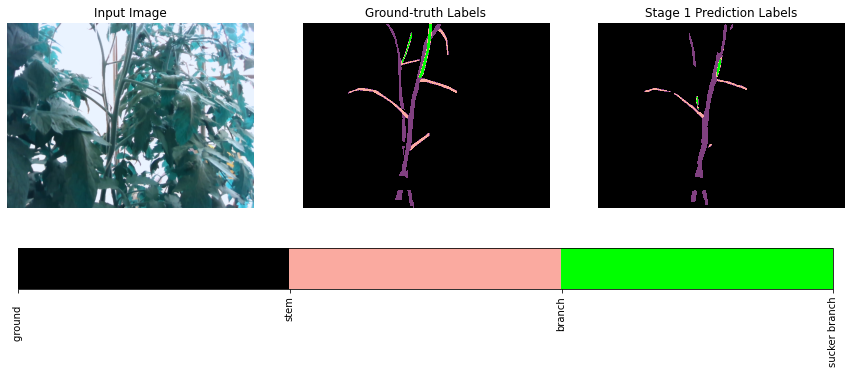

best val iou tensor(0.5263, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0650 mPA: 97.79% FPS: 602.0 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.6305: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [1/40] Loss: 0.1625 mPA: 97.37% FPS: 654.7 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 51.3   IOU1: 0.5612 : 100%|██████████| 41/41 [00:19<00:00,  2.09it/s]


idx: 169
Val Loss: 0.0797 FPS: 86.5 IOU: 0.5148


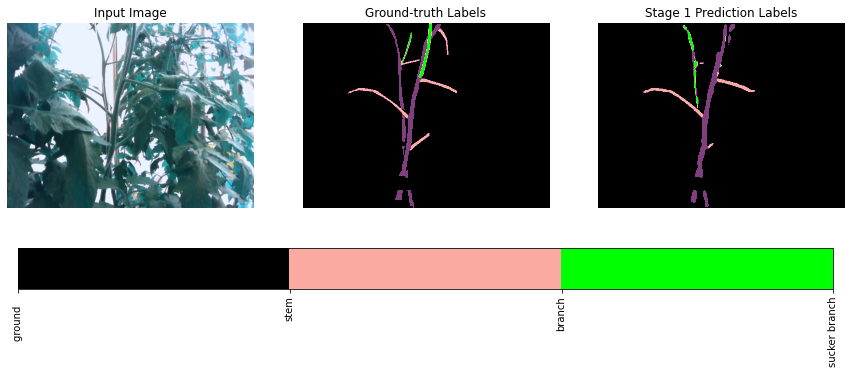

best val iou tensor(0.5612, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0546 mPA: 98.07% FPS: 601.5 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.6788: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [2/40] Loss: 0.1408 mPA: 97.76% FPS: 643.5 Lr: 0.0000000000 sucker_t: 73.9 sucker_f: 23.6   IOU1: 0.6107 : 100%|██████████| 41/41 [00:18<00:00,  2.20it/s]


idx: 169
Val Loss: 0.0724 FPS: 83.6 IOU: 0.5429


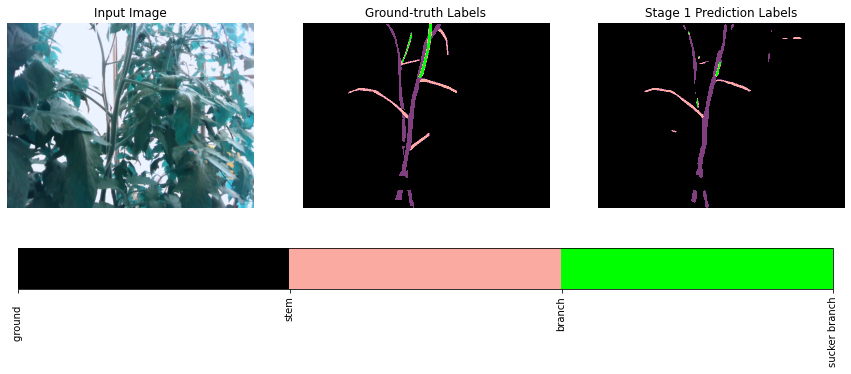

best val iou tensor(0.6107, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0474 mPA: 98.28% FPS: 604.2 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.7131: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [3/40] Loss: 0.1389 mPA: 97.80% FPS: 638.3 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 18.5   IOU1: 0.6155 : 100%|██████████| 41/41 [00:18<00:00,  2.22it/s]


idx: 169
Val Loss: 0.0802 FPS: 80.3 IOU: 0.5201


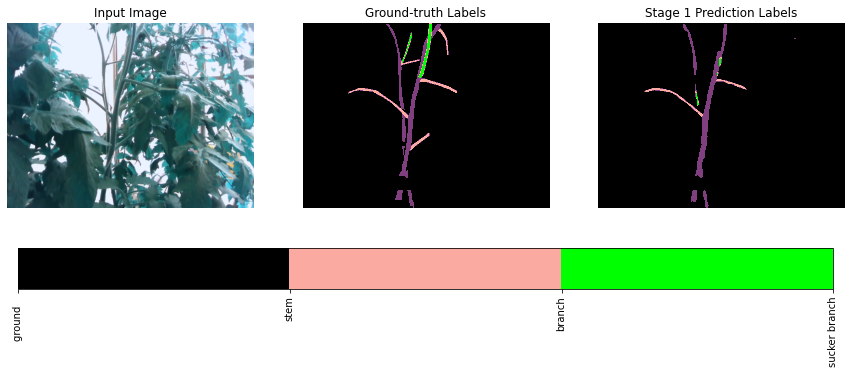

best val iou tensor(0.6155, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0415 mPA: 98.46% FPS: 601.9 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.7432: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [4/40] Loss: 0.1557 mPA: 97.78% FPS: 642.8 Lr: 0.0000000000 sucker_t: 67.2 sucker_f: 10.6   IOU1: 0.6101 : 100%|██████████| 41/41 [00:18<00:00,  2.20it/s]


idx: 169
Val Loss: 0.0879 FPS: 85.2 IOU: 0.5403


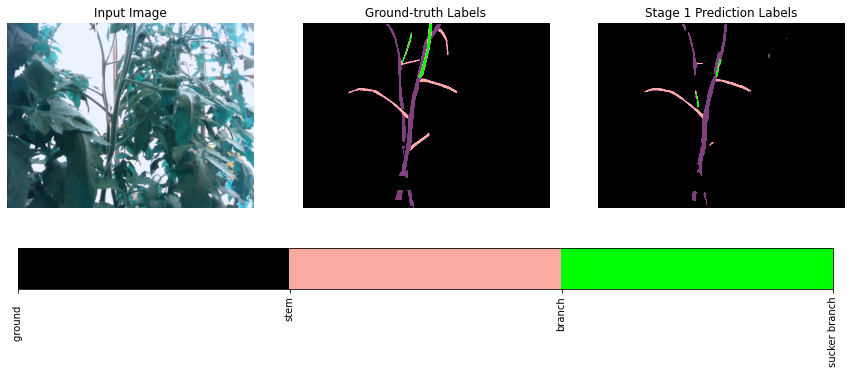

best val iou tensor(0.6155, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0398 mPA: 98.52% FPS: 601.8 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.7513: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [5/40] Loss: 0.1663 mPA: 97.77% FPS: 641.6 Lr: 0.0000000000 sucker_t: 71.7 sucker_f: 11.3   IOU1: 0.6196 : 100%|██████████| 41/41 [00:18<00:00,  2.22it/s]


idx: 169
Val Loss: 0.1053 FPS: 85.8 IOU: 0.4841


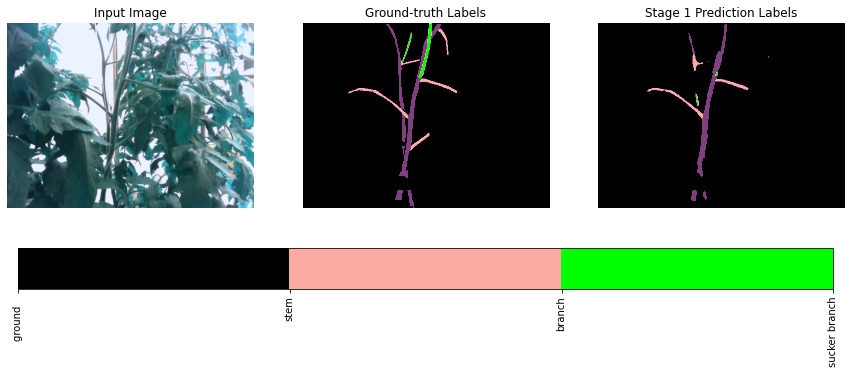

best val iou tensor(0.6196, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0339 mPA: 98.71% FPS: 615.4 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.7834: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [6/40] Loss: 0.1519 mPA: 97.81% FPS: 645.1 Lr: 0.0000000000 sucker_t: 73.0 sucker_f: 14.6   IOU1: 0.6285 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.0923 FPS: 80.6 IOU: 0.5248


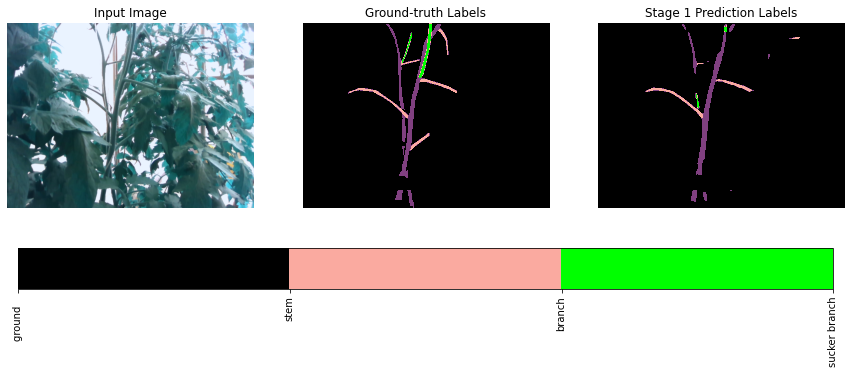

best val iou tensor(0.6285, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0314 mPA: 98.79% FPS: 606.0 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.7955: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [7/40] Loss: 0.1595 mPA: 97.69% FPS: 642.0 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 28.4   IOU1: 0.6133 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.0832 FPS: 84.5 IOU: 0.5614


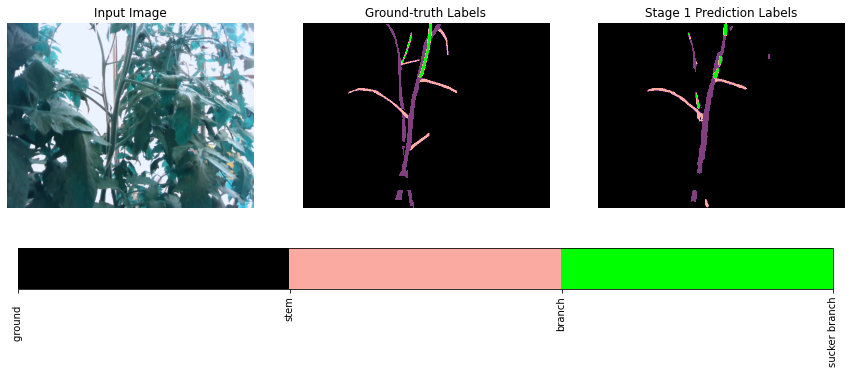

best val iou tensor(0.6285, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0293 mPA: 98.87% FPS: 602.3 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8073: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [8/40] Loss: 0.1594 mPA: 97.75% FPS: 649.1 Lr: 0.0000000000 sucker_t: 77.6 sucker_f: 29.0   IOU1: 0.6231 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1070 FPS: 79.9 IOU: 0.5516


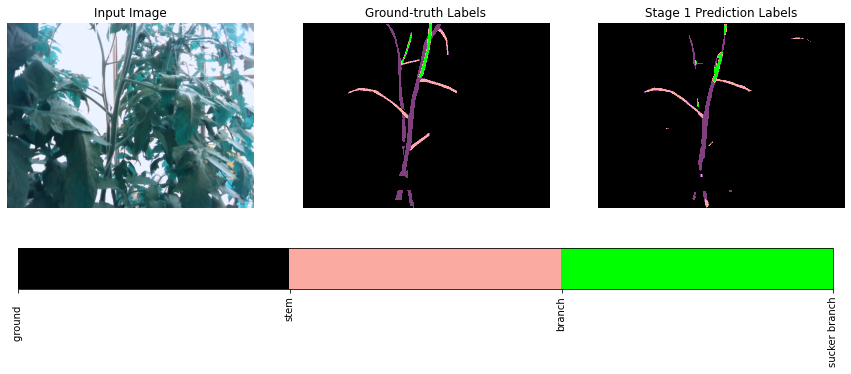

best val iou tensor(0.6285, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0272 mPA: 98.94% FPS: 571.6 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8180: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [9/40] Loss: 0.1599 mPA: 97.81% FPS: 639.3 Lr: 0.0000000000 sucker_t: 81.1 sucker_f: 23.0   IOU1: 0.6364 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.0962 FPS: 88.0 IOU: 0.5607


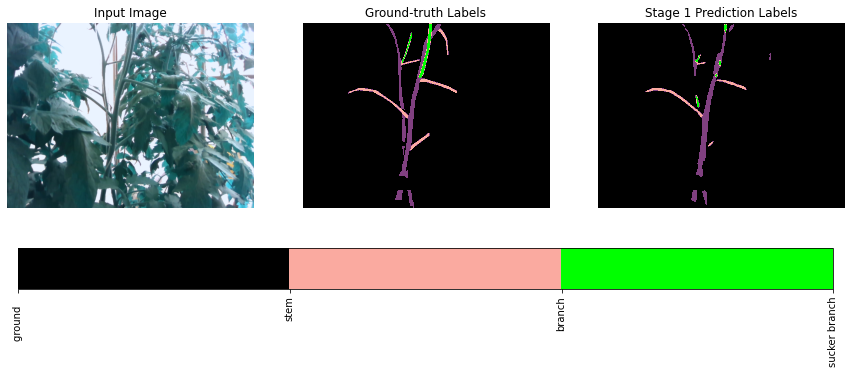

best val iou tensor(0.6364, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0256 mPA: 99.00% FPS: 598.8 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8268: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [10/40] Loss: 0.1712 mPA: 97.81% FPS: 628.6 Lr: 0.0000000000 sucker_t: 77.6 sucker_f: 19.1   IOU1: 0.6344 : 100%|██████████| 41/41 [00:18<00:00,  2.16it/s]


idx: 169
Val Loss: 0.0976 FPS: 82.8 IOU: 0.5466


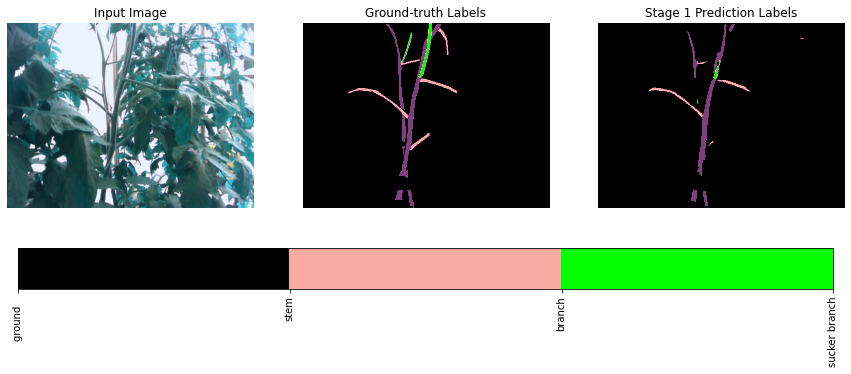

best val iou tensor(0.6364, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0242 mPA: 99.05% FPS: 591.6 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8362: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [11/40] Loss: 0.1688 mPA: 97.81% FPS: 651.0 Lr: 0.0000000000 sucker_t: 78.7 sucker_f: 20.3   IOU1: 0.6397 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.0931 FPS: 87.7 IOU: 0.6065


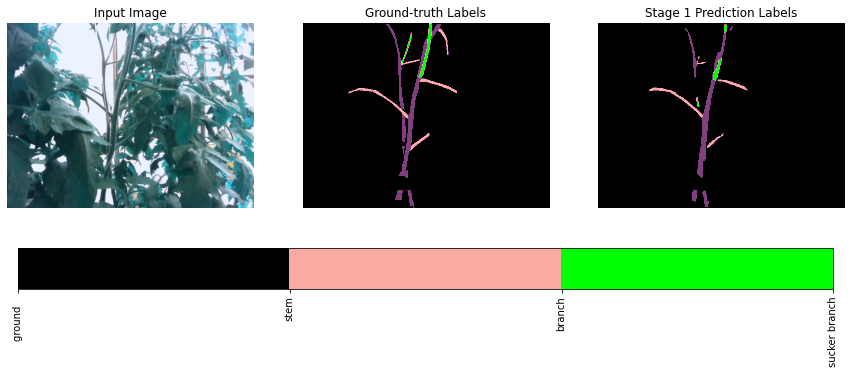

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0233 mPA: 99.08% FPS: 589.0 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8405: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [12/40] Loss: 0.1855 mPA: 97.77% FPS: 648.2 Lr: 0.0000000000 sucker_t: 75.2 sucker_f: 13.9   IOU1: 0.6301 : 100%|██████████| 41/41 [00:18<00:00,  2.17it/s]


idx: 169
Val Loss: 0.1229 FPS: 86.2 IOU: 0.5380


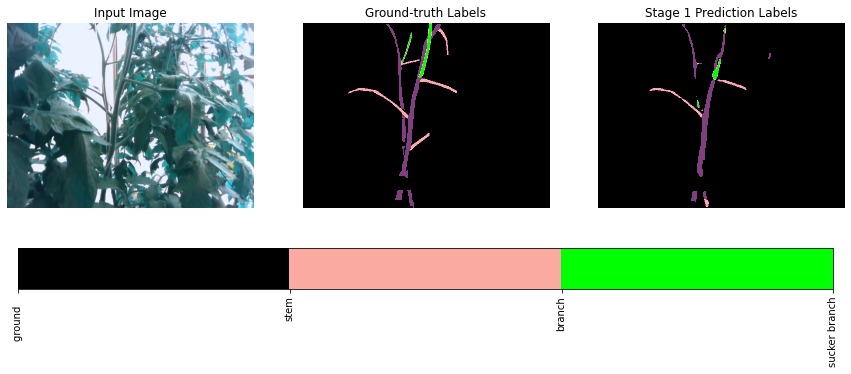

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0222 mPA: 99.12% FPS: 579.6 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8479: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [13/40] Loss: 0.1972 mPA: 97.85% FPS: 632.7 Lr: 0.0000000000 sucker_t: 75.9 sucker_f: 16.3   IOU1: 0.6338 : 100%|██████████| 41/41 [00:19<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1207 FPS: 80.6 IOU: 0.5518


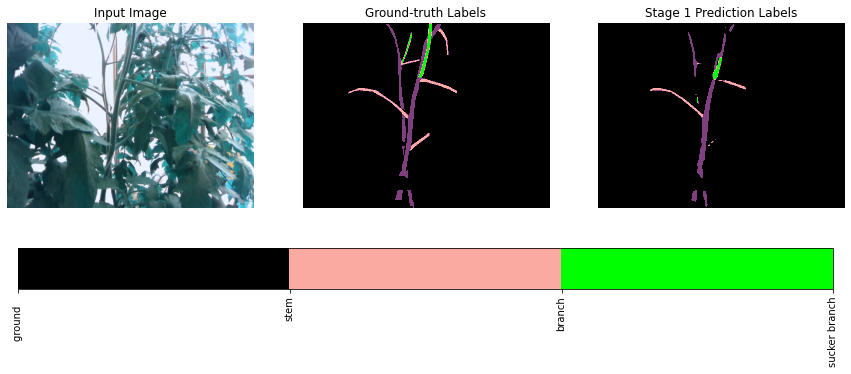

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0214 mPA: 99.15% FPS: 562.6 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8523: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [14/40] Loss: 0.1894 mPA: 97.81% FPS: 631.9 Lr: 0.0000000000 sucker_t: 75.6 sucker_f: 15.0   IOU1: 0.6348 : 100%|██████████| 41/41 [00:18<00:00,  2.16it/s]


idx: 169
Val Loss: 0.1202 FPS: 71.9 IOU: 0.5378


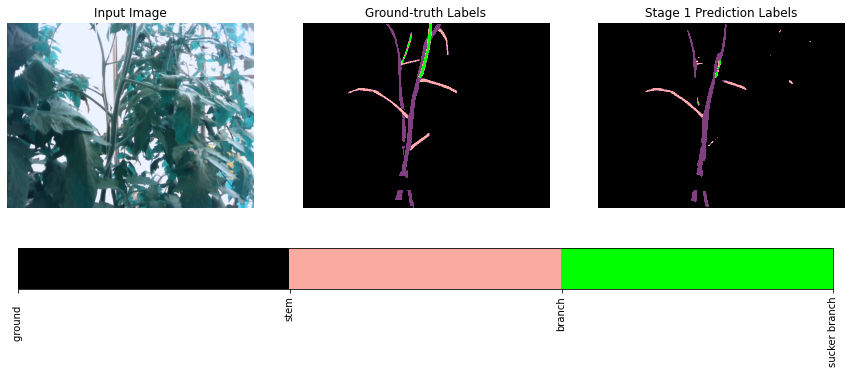

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0207 mPA: 99.18% FPS: 555.8 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8569: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [15/40] Loss: 0.2119 mPA: 97.79% FPS: 603.4 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 21.2   IOU1: 0.6313 : 100%|██████████| 41/41 [00:19<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1378 FPS: 87.2 IOU: 0.5452


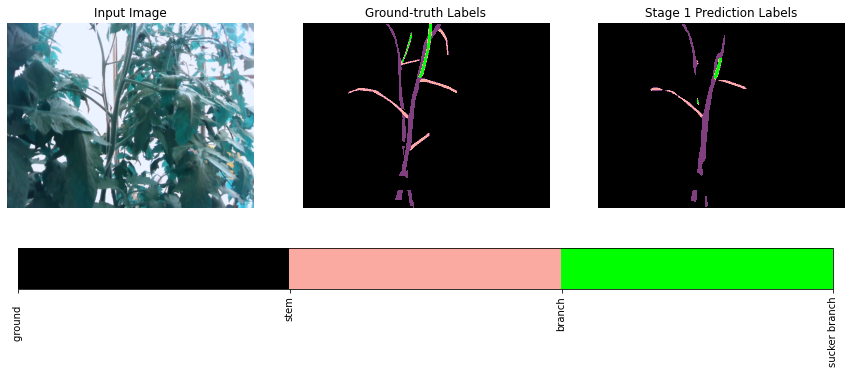

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0200 mPA: 99.21% FPS: 560.8 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8601: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [16/40] Loss: 0.2094 mPA: 97.81% FPS: 619.8 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 18.3   IOU1: 0.6379 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1237 FPS: 85.8 IOU: 0.5762


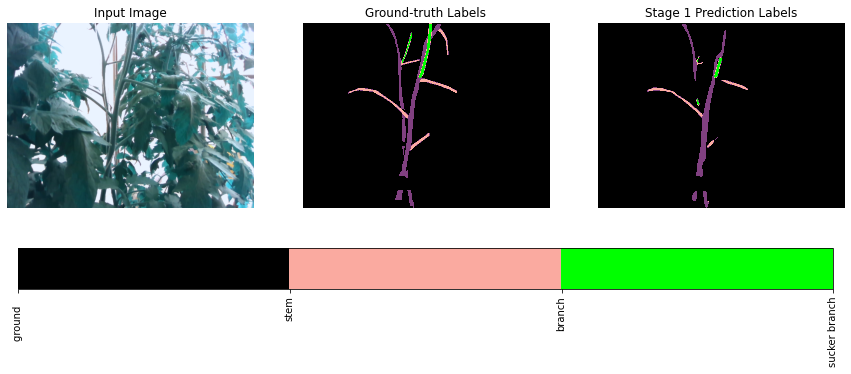

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0193 mPA: 99.23% FPS: 555.5 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8645: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [17/40] Loss: 0.2000 mPA: 97.80% FPS: 617.2 Lr: 0.0000000000 sucker_t: 77.6 sucker_f: 19.5   IOU1: 0.6372 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1226 FPS: 87.9 IOU: 0.5671


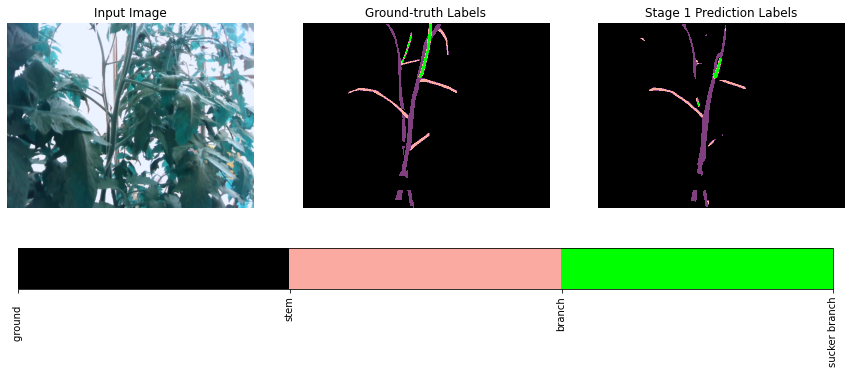

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0187 mPA: 99.26% FPS: 549.2 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8684: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [18/40] Loss: 0.2339 mPA: 97.76% FPS: 635.5 Lr: 0.0000000000 sucker_t: 77.2 sucker_f: 20.7   IOU1: 0.6304 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1418 FPS: 86.2 IOU: 0.5110


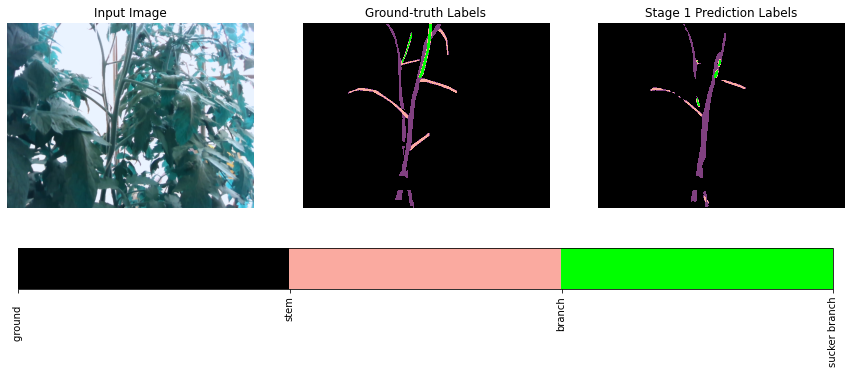

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0183 mPA: 99.27% FPS: 545.8 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8712: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [19/40] Loss: 0.2314 mPA: 97.81% FPS: 636.7 Lr: 0.0000000000 sucker_t: 78.0 sucker_f: 19.8   IOU1: 0.6340 : 100%|██████████| 41/41 [00:19<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1450 FPS: 69.3 IOU: 0.5436


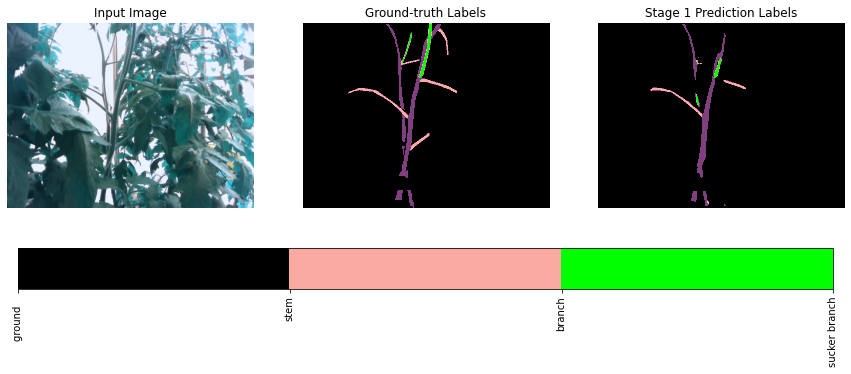

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0178 mPA: 99.29% FPS: 519.9 Lr: 0.0003205178 sucker: 0.0000 IOU1: 0.8738: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [20/40] Loss: 0.2334 mPA: 97.77% FPS: 591.2 Lr: 0.0000000000 sucker_t: 78.0 sucker_f: 17.7   IOU1: 0.6339 : 100%|██████████| 41/41 [00:19<00:00,  2.16it/s]


idx: 169
Val Loss: 0.1378 FPS: 85.4 IOU: 0.5419


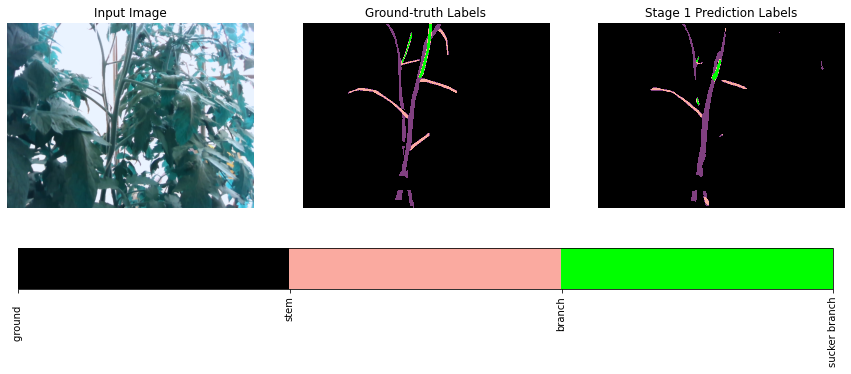

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0175 mPA: 99.30% FPS: 539.3 Lr: 0.0002906510 sucker: 0.0000 IOU1: 0.8764: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [21/40] Loss: 0.2383 mPA: 97.79% FPS: 631.9 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 22.1   IOU1: 0.6339 : 100%|██████████| 41/41 [00:19<00:00,  2.12it/s]


idx: 169
Val Loss: 0.1507 FPS: 58.1 IOU: 0.5199


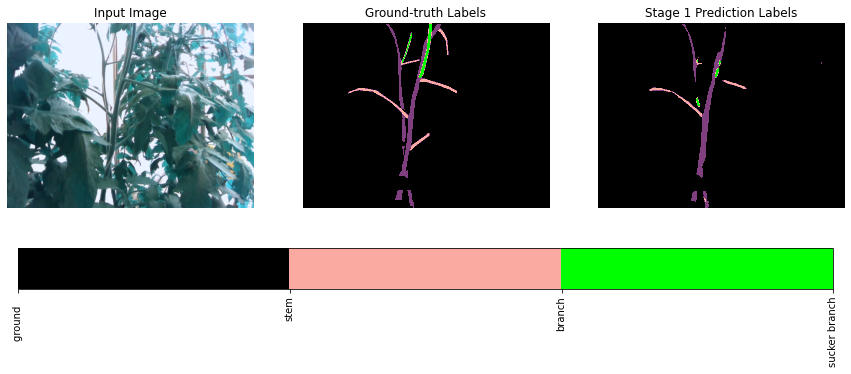

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0171 mPA: 99.32% FPS: 537.0 Lr: 0.0002635672 sucker: 0.0000 IOU1: 0.8785: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [22/40] Loss: 0.2272 mPA: 97.76% FPS: 587.6 Lr: 0.0000000000 sucker_t: 79.3 sucker_f: 19.3   IOU1: 0.6353 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1470 FPS: 64.3 IOU: 0.5493


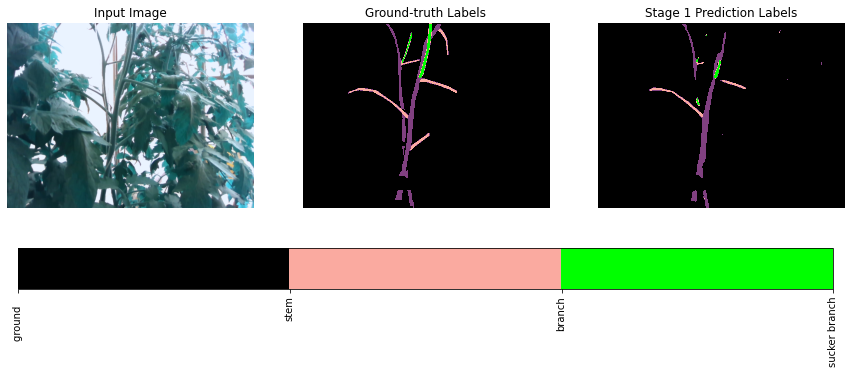

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0168 mPA: 99.33% FPS: 542.5 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.8804: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [23/40] Loss: 0.2377 mPA: 97.78% FPS: 602.8 Lr: 0.0000000000 sucker_t: 75.9 sucker_f: 14.9   IOU1: 0.6324 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1547 FPS: 63.4 IOU: 0.5250


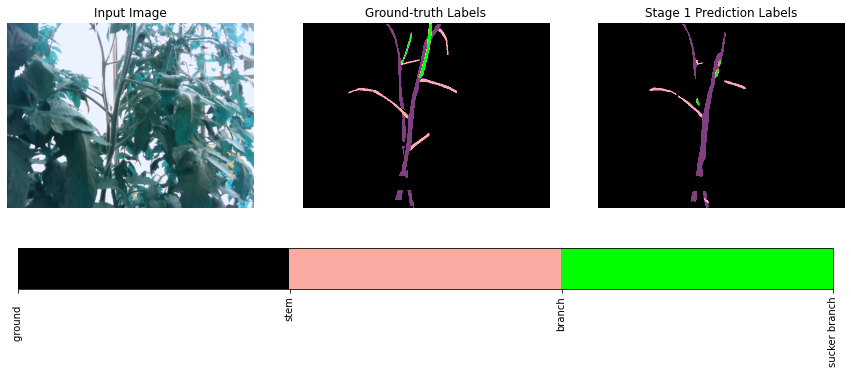

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0166 mPA: 99.34% FPS: 538.0 Lr: 0.0002167358 sucker: 0.0000 IOU1: 0.8816: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [24/40] Loss: 0.2322 mPA: 97.77% FPS: 628.7 Lr: 0.0000000000 sucker_t: 76.9 sucker_f: 16.7   IOU1: 0.6343 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1544 FPS: 77.2 IOU: 0.5384


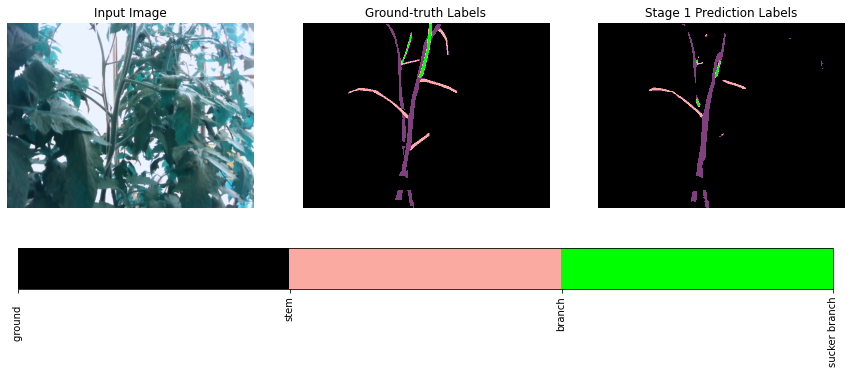

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [25/40] Loss: 0.0163 mPA: 99.35% FPS: 543.2 Lr: 0.0001965397 sucker: 0.0000 IOU1: 0.8835: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [25/40] Loss: 0.2380 mPA: 97.78% FPS: 603.6 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 18.1   IOU1: 0.6340 : 100%|██████████| 41/41 [00:19<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1534 FPS: 87.3 IOU: 0.5419


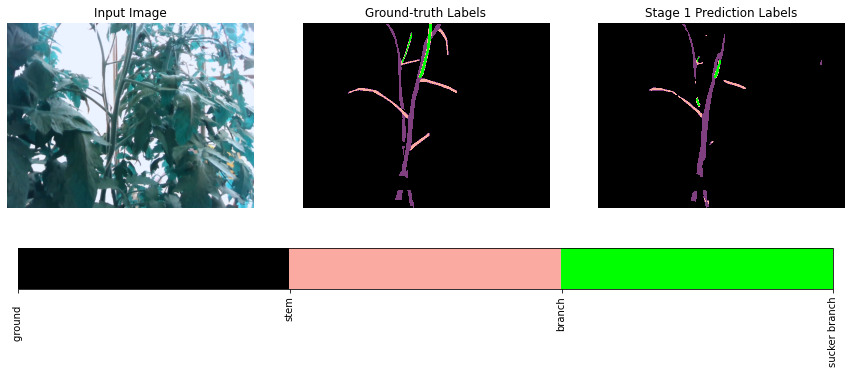

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [26/40] Loss: 0.0160 mPA: 99.36% FPS: 536.6 Lr: 0.0001782255 sucker: 0.0000 IOU1: 0.8851: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [26/40] Loss: 0.2499 mPA: 97.78% FPS: 578.8 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 18.4   IOU1: 0.6306 : 100%|██████████| 41/41 [00:19<00:00,  2.12it/s]


idx: 169
Val Loss: 0.1696 FPS: 63.9 IOU: 0.5270


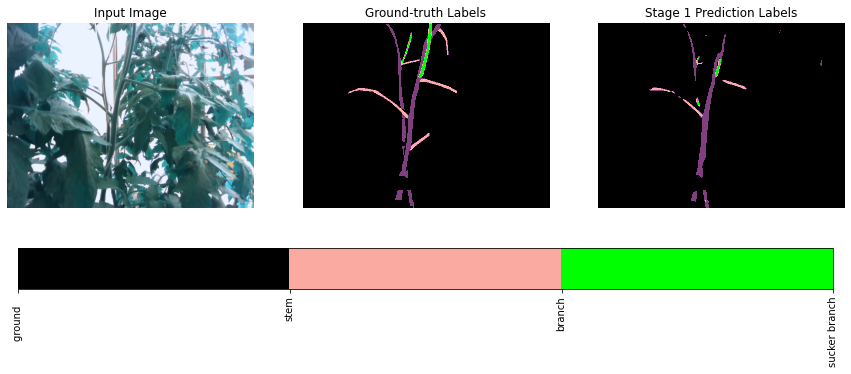

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [27/40] Loss: 0.0159 mPA: 99.37% FPS: 541.3 Lr: 0.0001616179 sucker: 0.0000 IOU1: 0.8864: 100%|██████████| 326/326 [03:28<00:00,  1.57it/s]


best_val


Train Epoch: [27/40] Loss: 0.2363 mPA: 97.77% FPS: 636.6 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 19.1   IOU1: 0.6315 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1551 FPS: 62.0 IOU: 0.5422


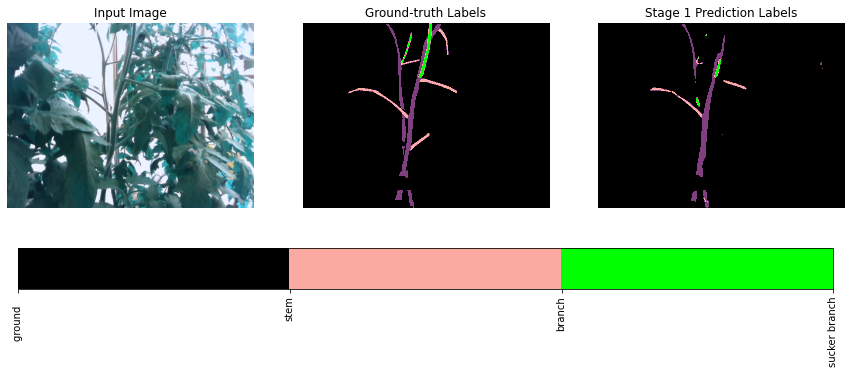

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [28/40] Loss: 0.0157 mPA: 99.37% FPS: 548.9 Lr: 0.0001465579 sucker: 0.0000 IOU1: 0.8874: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [28/40] Loss: 0.2476 mPA: 97.77% FPS: 600.1 Lr: 0.0000000000 sucker_t: 76.9 sucker_f: 18.4   IOU1: 0.6311 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1600 FPS: 81.2 IOU: 0.5277


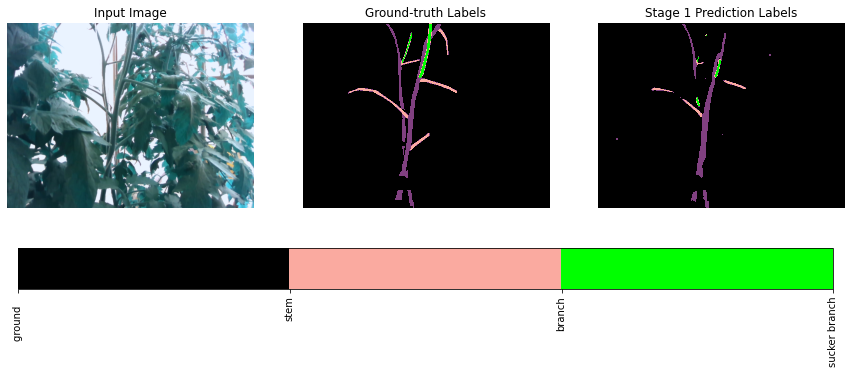

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [29/40] Loss: 0.0154 mPA: 99.38% FPS: 539.9 Lr: 0.0001329012 sucker: 0.0000 IOU1: 0.8890: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [29/40] Loss: 0.2494 mPA: 97.76% FPS: 625.8 Lr: 0.0000000000 sucker_t: 79.8 sucker_f: 20.1   IOU1: 0.6338 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1618 FPS: 60.7 IOU: 0.5329


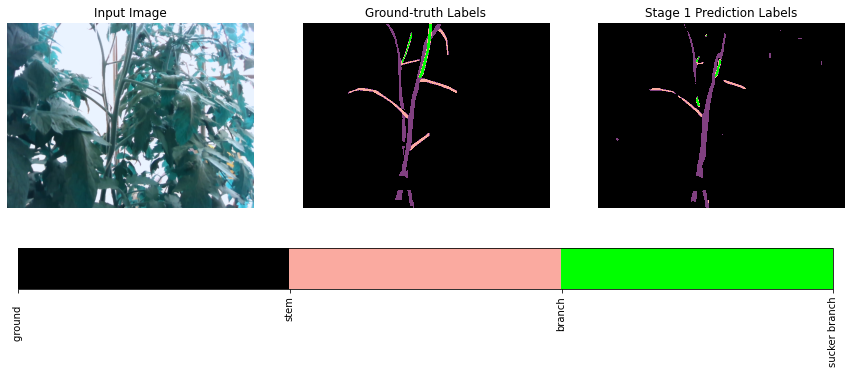

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [30/40] Loss: 0.0153 mPA: 99.39% FPS: 539.2 Lr: 0.0001205170 sucker: 0.0000 IOU1: 0.8902: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [30/40] Loss: 0.2555 mPA: 97.76% FPS: 601.7 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 19.2   IOU1: 0.6318 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1673 FPS: 73.8 IOU: 0.5362


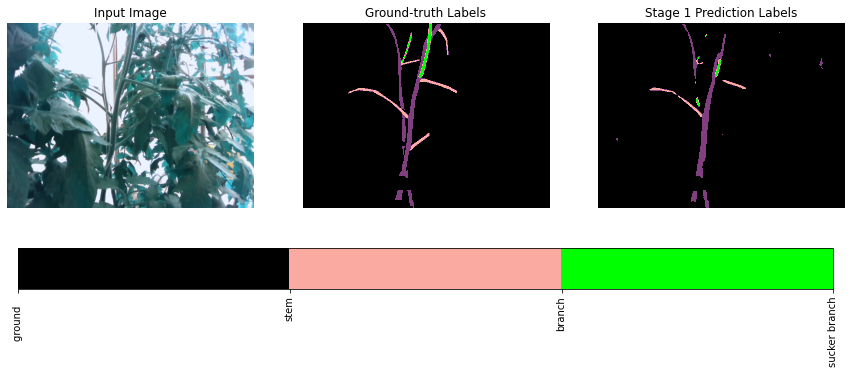

best val iou tensor(0.6397, device='cuda:0')


Train Epoch: [31/40] Loss: 0.0156 mPA: 99.38% FPS: 454.9 Lr: 0.0001200119 sucker: 0.0000 IOU1: 0.8954:   4%|▍         | 14/326 [00:10<03:53,  1.34it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(11)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_tomato_11.pth...


In [ ]:
trainer.show_all_predict()

idx: 169
Val Loss: 0.0931 FPS: 87.5 IOU: 0.6065


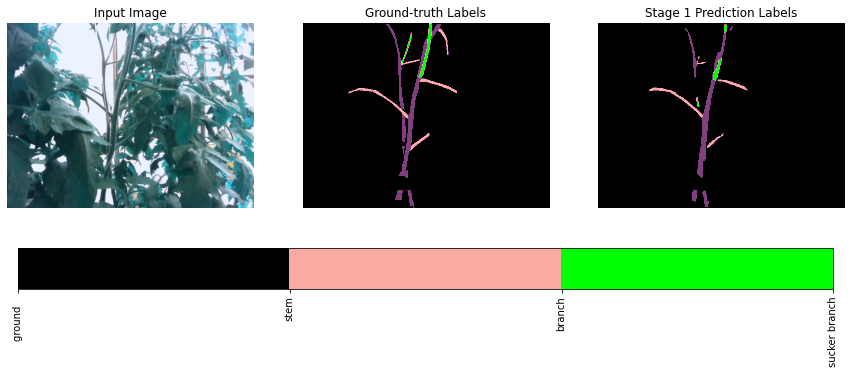

87.50895055288963

In [ ]:
trainer.random_val_predict(idx=169)

idx: 169
Val Loss: 0.0931 FPS: 81.0 IOU: 0.6065


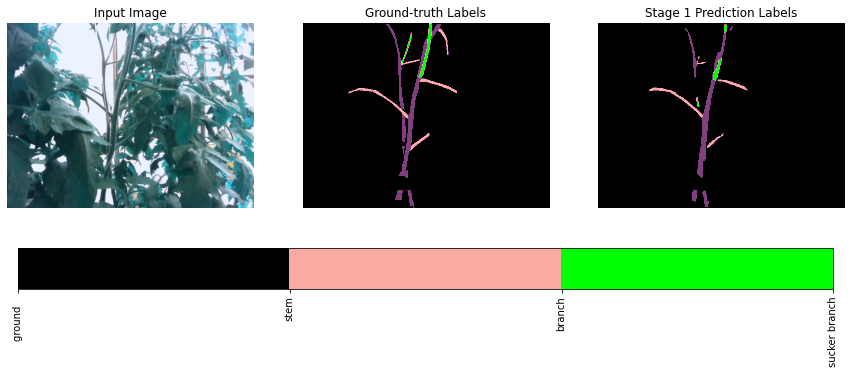

81.04152255820694

In [ ]:
trainer.random_val_predict(idx=169)

In [ ]:
trainer.train()

idx: 169
Val Loss: 0.0931 FPS: 75.2 IOU: 0.6065


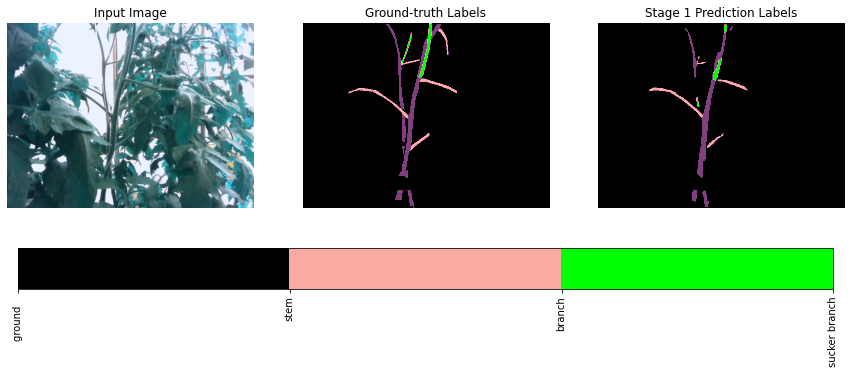

75.23145358014062

In [ ]:
trainer.random_val_predict(idx=169)

**DLightNet_depth_1**

In [ ]:
class DLightNet_depth_1(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=20, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=9, stride=1)
        self.conv1_3 = ConvBlock(in_channels=1, out_channels=3, stride=1)
        #  self.conv1_1 = ConvBlock(in_channels=3, out_channels=12, stride=1)
        # self.conv1_2 = ConvBlock(in_channels=3, out_channels=16, stride=1)
        # self.conv1_3 = ConvBlock(in_channels=1, out_channels=4, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)

    def forward(self, x):
        input = x[:,0:3,:,:]
        depth = x[:,3,:,:].unsqueeze(1)
      #  print('x1')
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
     #   print('x1')
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
     #   print('x1')
        x = self.s1_conv_final(x)
        x_f1 = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
       
       
        with torch.no_grad():
            x1 = self.s1_softmax(x_f1).detach()
            input1,depth1 = remove_easypixel(x1,input,depth,0.85,0.2 )
          
        
    #    print('b1')
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2_3 =  self.conv1_3(depth1)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 = torch.cat((xs2,xs2_3),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
    #    print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2

In [ ]:
trainer = Trainner( DLightNet_depth_1,'DLightNet_depth_1',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.summary()

In [ ]:
trainer.load_weight(save_path='/content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_9.pth')
#trainer.load_epoch(11)
trainer.eval()

Train Epoch: [0/40] Loss: 0.0437 mPA: 98.41% FPS: 887.6 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.7344: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [0/40] Loss: 0.1560 mPA: 97.65% FPS: 660.6 Lr: 0.0000000000 sucker_t: 70.7 sucker_f: 14.1   IOU1: 0.6124 : 100%|██████████| 41/41 [00:16<00:00,  2.48it/s]


idx: 169
Val Loss: 0.1106 FPS: 117.6 IOU: 0.5352


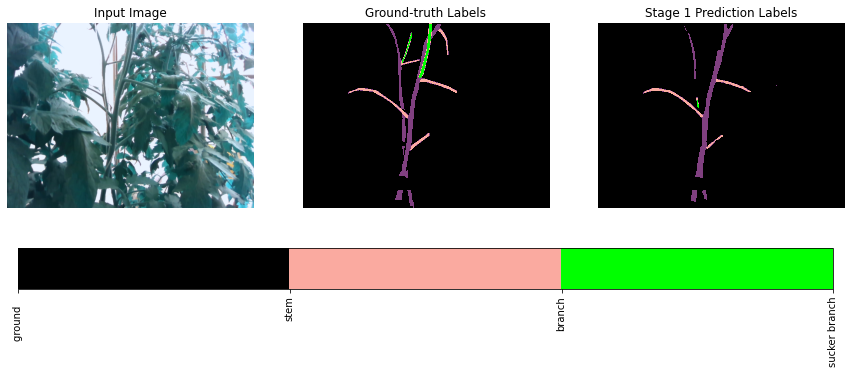

best val iou tensor(0.6124, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0329 mPA: 98.74% FPS: 884.0 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.7845: 100%|██████████| 326/326 [03:24<00:00,  1.60it/s]


best_val


Train Epoch: [1/40] Loss: 0.1670 mPA: 97.79% FPS: 966.6 Lr: 0.0000000000 sucker_t: 72.2 sucker_f: 15.4   IOU1: 0.6245 : 100%|██████████| 41/41 [00:16<00:00,  2.49it/s]


idx: 169
Val Loss: 0.1024 FPS: 128.2 IOU: 0.5367


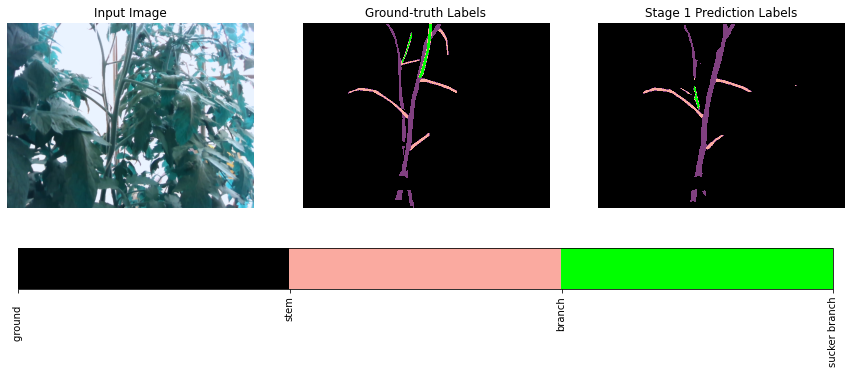

best val iou tensor(0.6245, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0298 mPA: 98.85% FPS: 883.2 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.8020: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [2/40] Loss: 0.1574 mPA: 97.75% FPS: 915.1 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 15.6   IOU1: 0.6420 : 100%|██████████| 41/41 [00:16<00:00,  2.49it/s]


idx: 169
Val Loss: 0.0729 FPS: 125.5 IOU: 0.5993


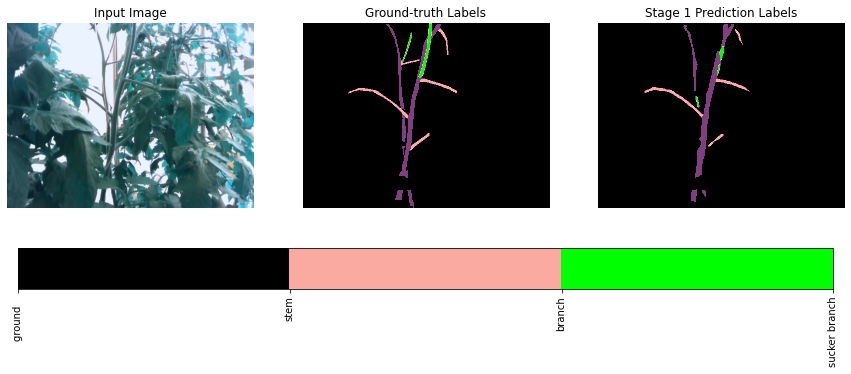

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0270 mPA: 98.94% FPS: 891.7 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.8188: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [3/40] Loss: 0.1787 mPA: 97.85% FPS: 998.2 Lr: 0.0000000000 sucker_t: 74.3 sucker_f: 12.6   IOU1: 0.6324 : 100%|██████████| 41/41 [00:16<00:00,  2.50it/s]


idx: 169
Val Loss: 0.1062 FPS: 118.9 IOU: 0.5067


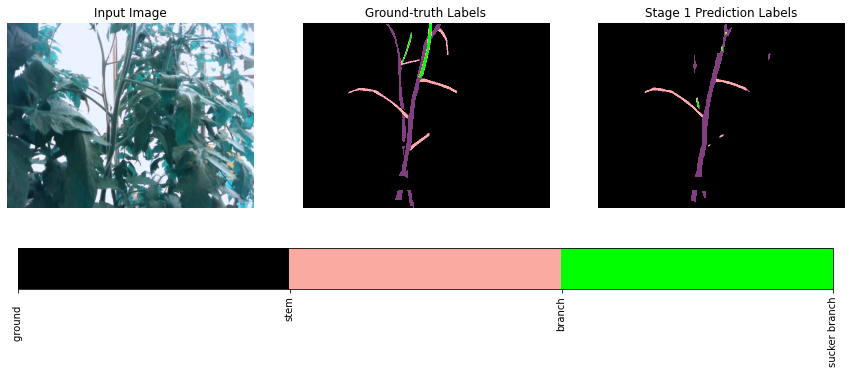

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0254 mPA: 99.00% FPS: 885.1 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.8290: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [4/40] Loss: 0.1788 mPA: 97.87% FPS: 937.2 Lr: 0.0000000000 sucker_t: 77.6 sucker_f: 15.8   IOU1: 0.6364 : 100%|██████████| 41/41 [00:16<00:00,  2.48it/s]


idx: 169
Val Loss: 0.1196 FPS: 130.1 IOU: 0.5525


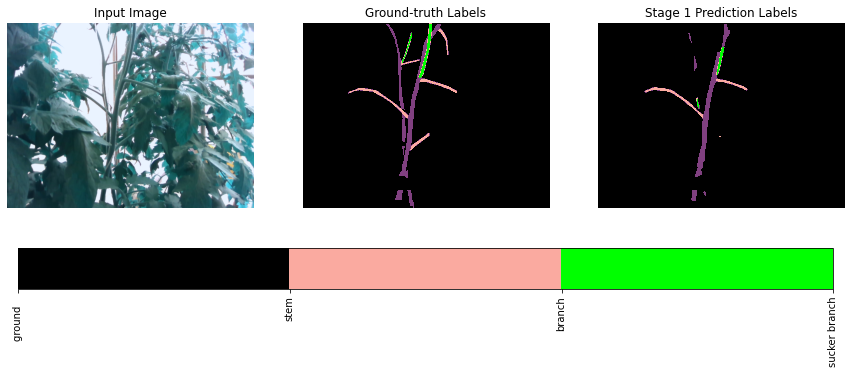

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0242 mPA: 99.04% FPS: 889.5 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.8350: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [5/40] Loss: 0.1559 mPA: 97.83% FPS: 926.7 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 17.4   IOU1: 0.6408 : 100%|██████████| 41/41 [00:16<00:00,  2.46it/s]


idx: 169
Val Loss: 0.1050 FPS: 129.3 IOU: 0.5659


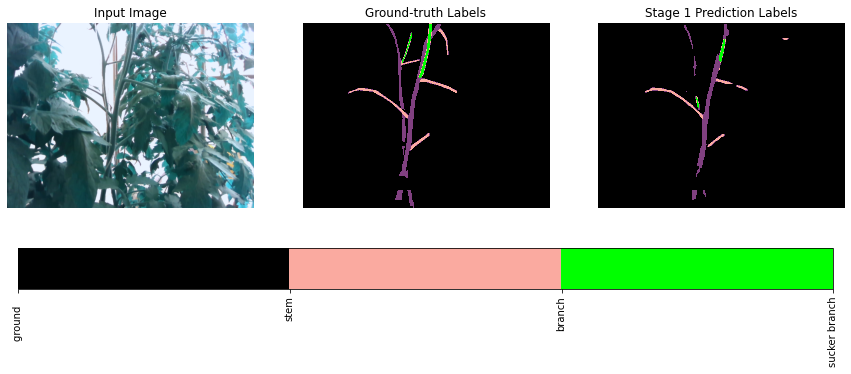

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0228 mPA: 99.10% FPS: 890.5 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.8425: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [6/40] Loss: 0.2051 mPA: 97.82% FPS: 891.5 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 20.8   IOU1: 0.6332 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1647 FPS: 132.0 IOU: 0.5201


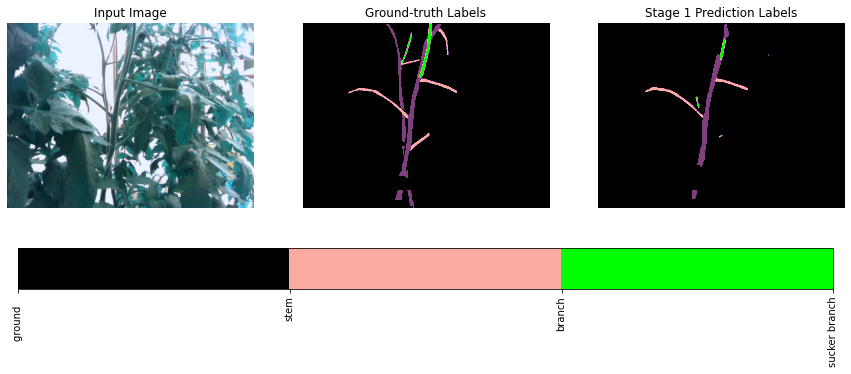

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0219 mPA: 99.13% FPS: 884.4 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.8477: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [7/40] Loss: 0.1980 mPA: 97.81% FPS: 968.6 Lr: 0.0000000000 sucker_t: 79.4 sucker_f: 24.4   IOU1: 0.6310 : 100%|██████████| 41/41 [00:16<00:00,  2.45it/s]


idx: 169
Val Loss: 0.1368 FPS: 120.0 IOU: 0.5459


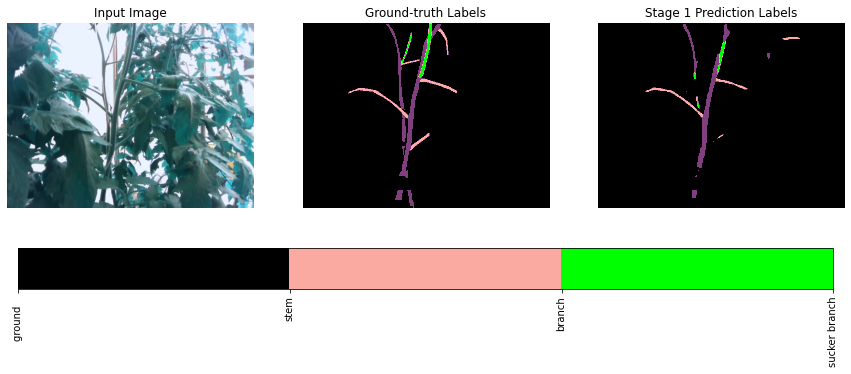

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0212 mPA: 99.16% FPS: 886.4 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8523: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [8/40] Loss: 0.1946 mPA: 97.87% FPS: 948.0 Lr: 0.0000000000 sucker_t: 78.1 sucker_f: 19.6   IOU1: 0.6379 : 100%|██████████| 41/41 [00:16<00:00,  2.45it/s]


idx: 169
Val Loss: 0.1405 FPS: 123.3 IOU: 0.5396


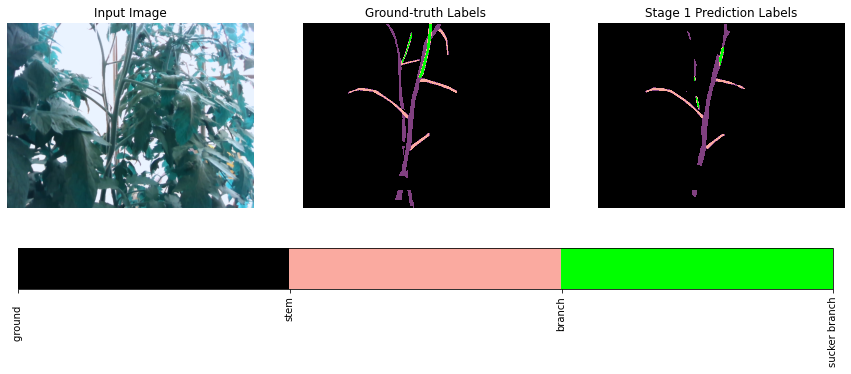

best val iou tensor(0.6420, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0199 mPA: 99.20% FPS: 881.7 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8598: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [9/40] Loss: 0.1857 mPA: 97.85% FPS: 971.3 Lr: 0.0000000000 sucker_t: 83.5 sucker_f: 22.7   IOU1: 0.6472 : 100%|██████████| 41/41 [00:16<00:00,  2.47it/s]


idx: 169
Val Loss: 0.1337 FPS: 128.0 IOU: 0.5797


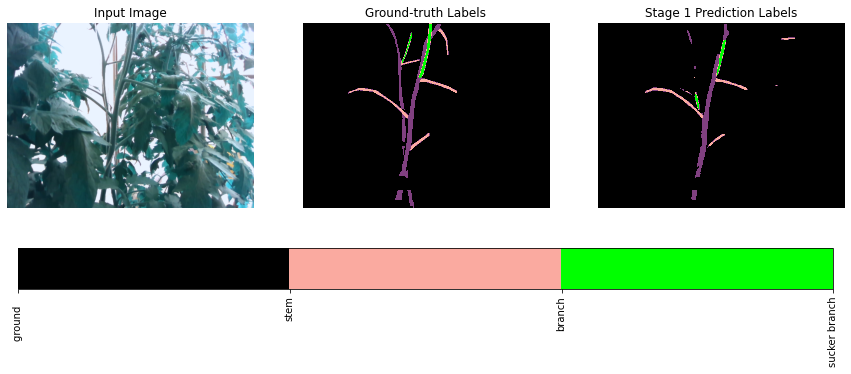

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0190 mPA: 99.24% FPS: 888.0 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8661: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [10/40] Loss: 0.2099 mPA: 97.87% FPS: 940.4 Lr: 0.0000000000 sucker_t: 76.1 sucker_f: 17.0   IOU1: 0.6367 : 100%|██████████| 41/41 [00:16<00:00,  2.46it/s]


idx: 169
Val Loss: 0.1604 FPS: 118.1 IOU: 0.4932


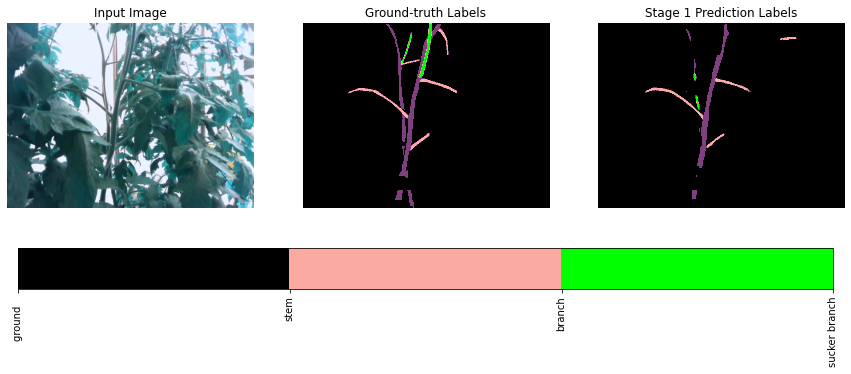

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0185 mPA: 99.26% FPS: 890.7 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8690: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [11/40] Loss: 0.2191 mPA: 97.83% FPS: 953.4 Lr: 0.0000000000 sucker_t: 77.0 sucker_f: 21.1   IOU1: 0.6384 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1608 FPS: 127.8 IOU: 0.5047


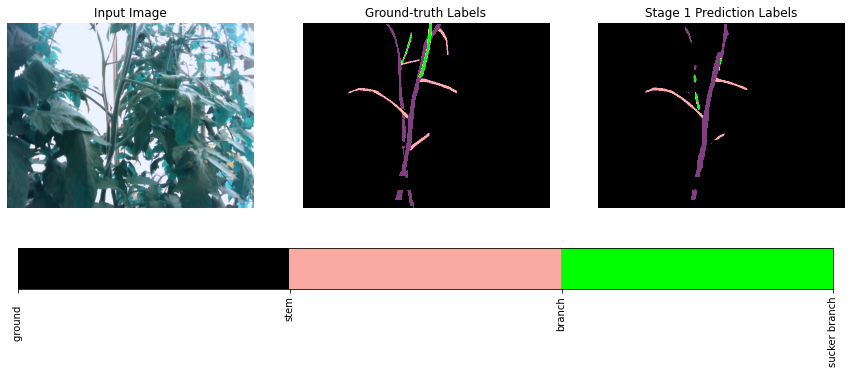

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0178 mPA: 99.28% FPS: 880.3 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8732: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [12/40] Loss: 0.2103 mPA: 97.85% FPS: 911.6 Lr: 0.0000000000 sucker_t: 76.1 sucker_f: 20.3   IOU1: 0.6370 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1465 FPS: 114.9 IOU: 0.5547


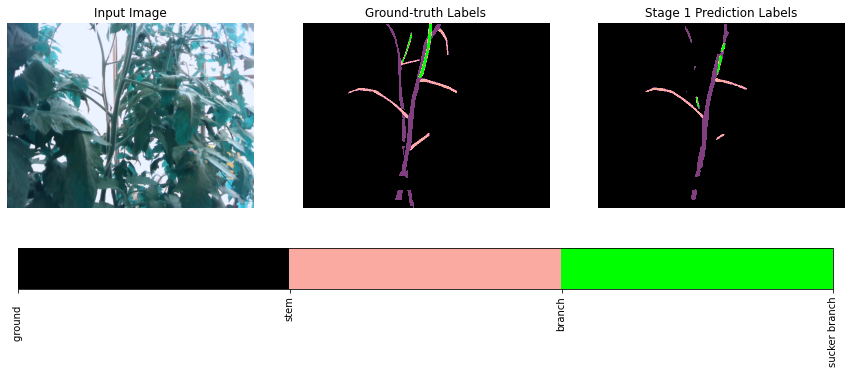

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0172 mPA: 99.31% FPS: 882.8 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8772: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [13/40] Loss: 0.2225 mPA: 97.78% FPS: 945.2 Lr: 0.0000000000 sucker_t: 79.4 sucker_f: 21.1   IOU1: 0.6345 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1428 FPS: 128.9 IOU: 0.5511


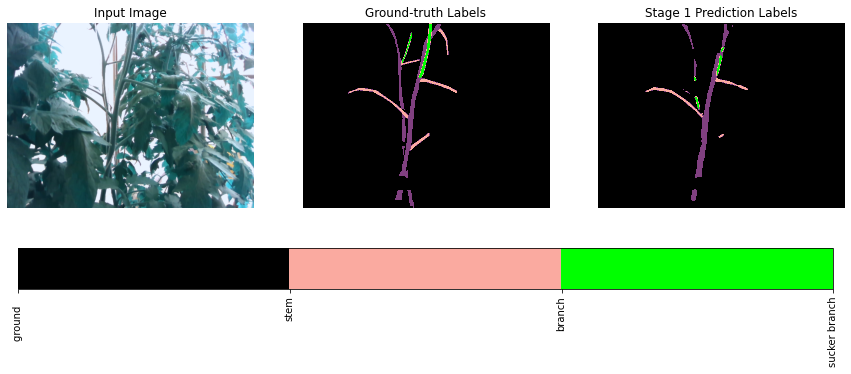

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0168 mPA: 99.32% FPS: 864.4 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8800: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [14/40] Loss: 0.2014 mPA: 97.85% FPS: 945.3 Lr: 0.0000000000 sucker_t: 81.7 sucker_f: 23.4   IOU1: 0.6437 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1337 FPS: 124.2 IOU: 0.5696


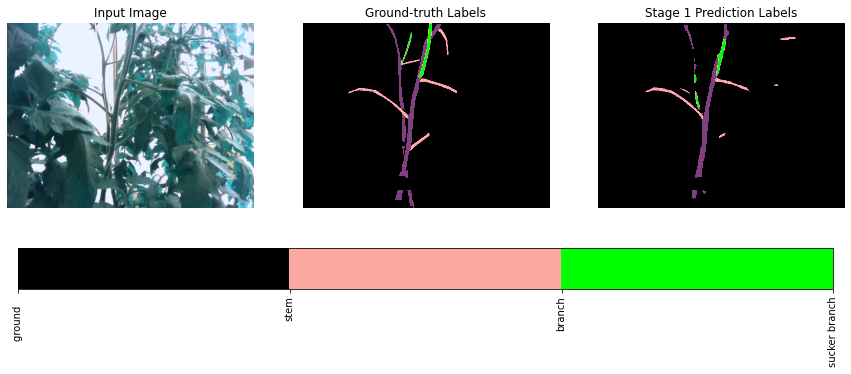

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0163 mPA: 99.34% FPS: 861.2 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8829: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [15/40] Loss: 0.2246 mPA: 97.83% FPS: 904.8 Lr: 0.0000000000 sucker_t: 81.7 sucker_f: 22.0   IOU1: 0.6412 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1618 FPS: 129.7 IOU: 0.5397


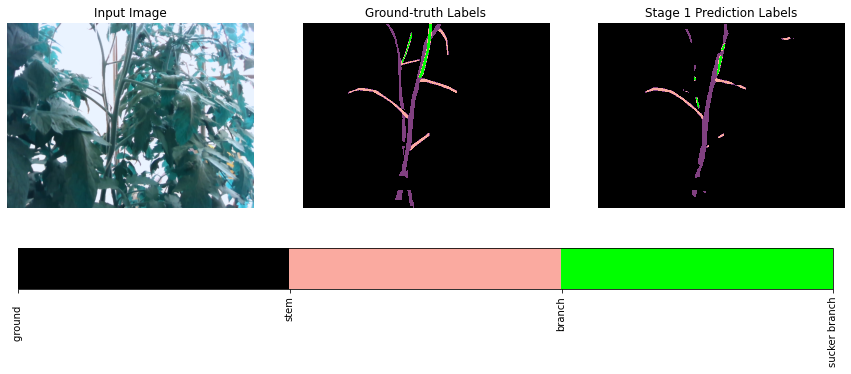

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0159 mPA: 99.36% FPS: 840.9 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8856: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [16/40] Loss: 0.2212 mPA: 97.83% FPS: 883.6 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 23.7   IOU1: 0.6405 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1502 FPS: 129.7 IOU: 0.5678


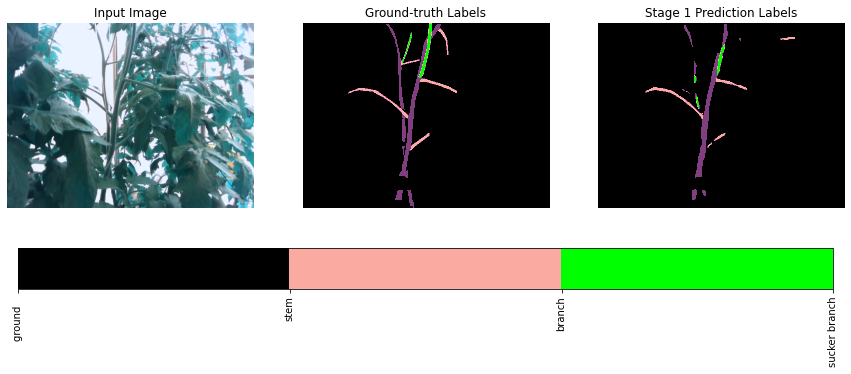

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0155 mPA: 99.37% FPS: 831.3 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8882: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [17/40] Loss: 0.2603 mPA: 97.81% FPS: 894.0 Lr: 0.0000000000 sucker_t: 79.6 sucker_f: 22.6   IOU1: 0.6373 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1665 FPS: 123.8 IOU: 0.5542


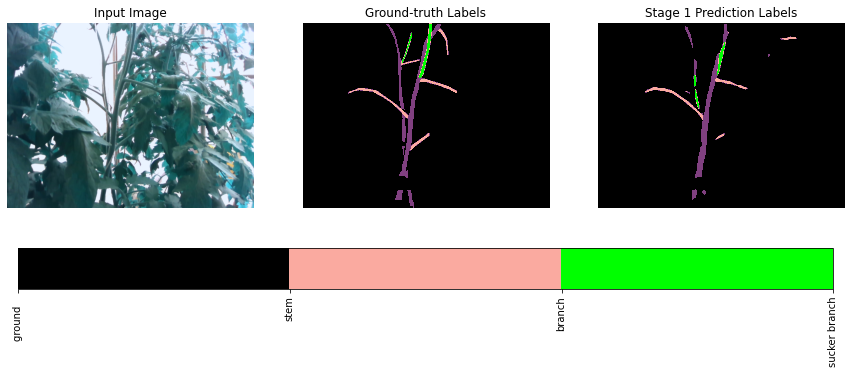

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0151 mPA: 99.39% FPS: 768.8 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8906: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [18/40] Loss: 0.2387 mPA: 97.83% FPS: 903.8 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 18.7   IOU1: 0.6368 : 100%|██████████| 41/41 [00:17<00:00,  2.41it/s]


idx: 169
Val Loss: 0.1639 FPS: 129.0 IOU: 0.5724


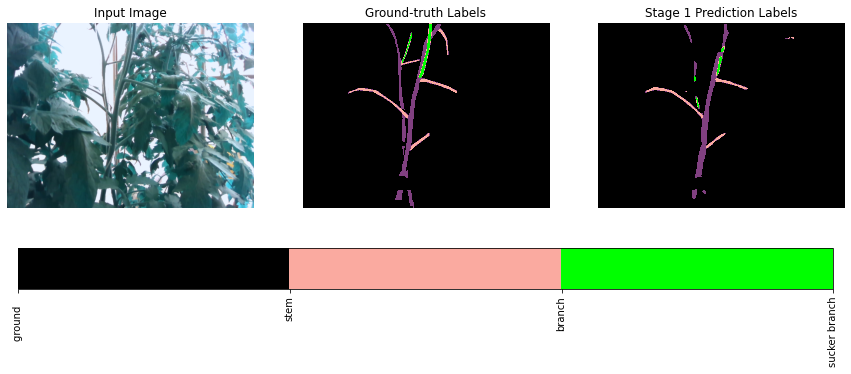

best val iou tensor(0.6472, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0148 mPA: 99.40% FPS: 811.0 Lr: 0.0003721736 sucker: 0.0000 IOU1: 0.8912:  47%|████▋     | 154/326 [01:38<01:49,  1.57it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

Train Epoch: [0/40] Loss: 0.1963 mPA: 95.70% FPS: 479.5 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.2742: 100%|██████████| 326/326 [01:42<00:00,  3.17it/s]


best_val


Train Epoch: [0/40] Loss: 0.2949 mPA: 95.94% FPS: 595.2 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.2958 : 100%|██████████| 41/41 [00:16<00:00,  2.48it/s]


idx: 169
Val Loss: 0.1396 FPS: 85.3 IOU: 0.2756


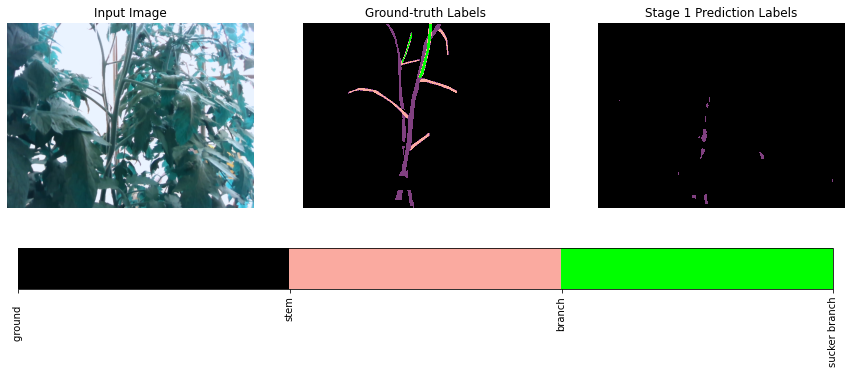

best val iou tensor(0.2958, device='cuda:0')


Train Epoch: [1/40] Loss: 0.1336 mPA: 96.14% FPS: 457.7 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.3283: 100%|██████████| 326/326 [01:41<00:00,  3.20it/s]


best_val


Train Epoch: [1/40] Loss: 0.3018 mPA: 95.74% FPS: 614.7 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.3463 : 100%|██████████| 41/41 [00:16<00:00,  2.53it/s]


idx: 169
Val Loss: 0.1387 FPS: 91.2 IOU: 0.3111


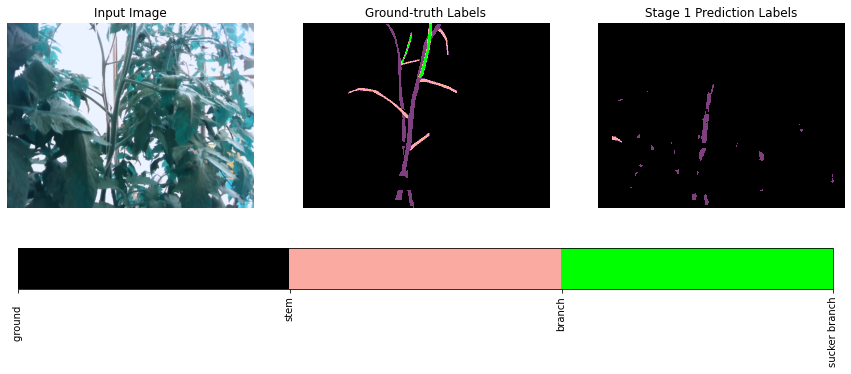

best val iou tensor(0.3463, device='cuda:0')


Train Epoch: [2/40] Loss: 0.1257 mPA: 96.30% FPS: 438.7 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.3533: 100%|██████████| 326/326 [01:43<00:00,  3.16it/s]


best_val


Train Epoch: [2/40] Loss: 0.2616 mPA: 96.22% FPS: 603.5 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.3359 : 100%|██████████| 41/41 [00:16<00:00,  2.49it/s]


idx: 169
Val Loss: 0.1230 FPS: 79.1 IOU: 0.3207


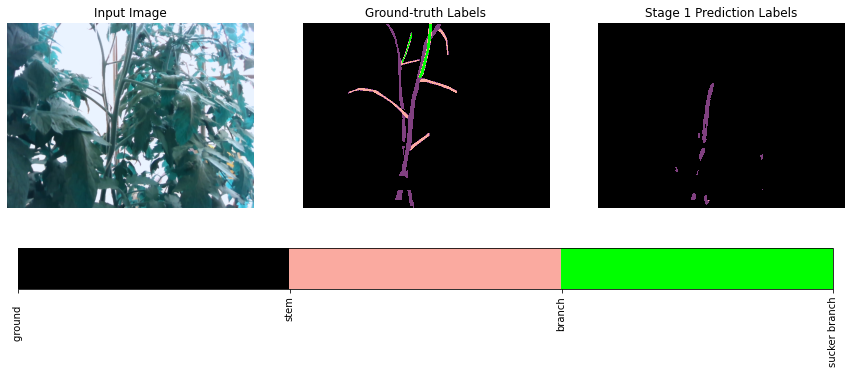

best val iou tensor(0.3463, device='cuda:0')


Train Epoch: [3/40] Loss: 0.1221 mPA: 96.38% FPS: 435.3 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.3630: 100%|██████████| 326/326 [01:44<00:00,  3.13it/s]


best_val


Train Epoch: [3/40] Loss: 0.2444 mPA: 96.40% FPS: 574.5 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.3551 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1146 FPS: 56.7 IOU: 0.3324


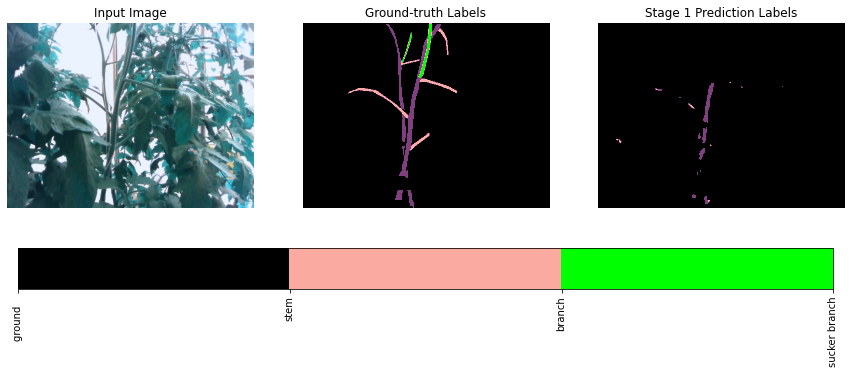

best val iou tensor(0.3551, device='cuda:0')


Train Epoch: [4/40] Loss: 0.1197 mPA: 96.42% FPS: 385.6 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.3686: 100%|██████████| 326/326 [01:51<00:00,  2.93it/s]


best_val


Train Epoch: [4/40] Loss: 0.2423 mPA: 96.41% FPS: 590.1 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.3528 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1025 FPS: 88.1 IOU: 0.3442


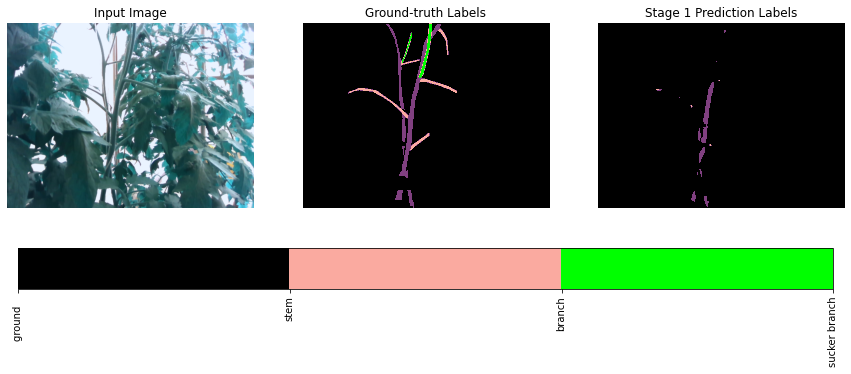

best val iou tensor(0.3551, device='cuda:0')


Train Epoch: [5/40] Loss: 0.1175 mPA: 96.47% FPS: 435.1 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.3733: 100%|██████████| 326/326 [01:47<00:00,  3.04it/s]


best_val


Train Epoch: [5/40] Loss: 0.2476 mPA: 96.27% FPS: 480.1 Lr: 0.0000000000 sucker_t: 1.3 sucker_f: 0.0   IOU1: 0.3718 : 100%|██████████| 41/41 [00:19<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1105 FPS: 84.6 IOU: 0.3569


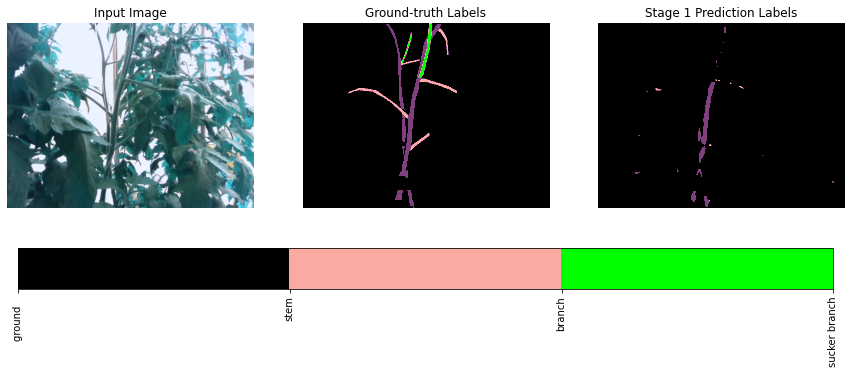

best val iou tensor(0.3718, device='cuda:0')


Train Epoch: [6/40] Loss: 0.1162 mPA: 96.50% FPS: 431.2 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.3773: 100%|██████████| 326/326 [01:46<00:00,  3.06it/s]


best_val


Train Epoch: [6/40] Loss: 0.2348 mPA: 96.49% FPS: 556.1 Lr: 0.0000000000 sucker_t: 10.9 sucker_f: 0.0   IOU1: 0.3715 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1064 FPS: 76.6 IOU: 0.3530


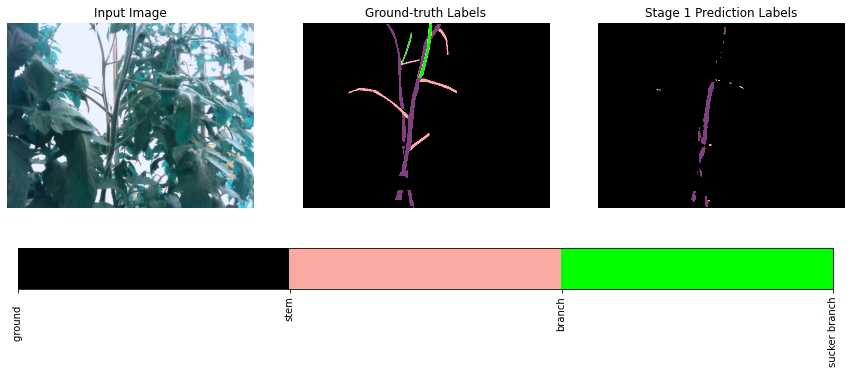

best val iou tensor(0.3718, device='cuda:0')


Train Epoch: [7/40] Loss: 0.1150 mPA: 96.53% FPS: 432.4 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.3814: 100%|██████████| 326/326 [01:45<00:00,  3.09it/s]


best_val


Train Epoch: [7/40] Loss: 0.2369 mPA: 96.48% FPS: 582.9 Lr: 0.0000000000 sucker_t: 30.0 sucker_f: 0.0   IOU1: 0.3672 : 100%|██████████| 41/41 [00:17<00:00,  2.31it/s]


idx: 169
Val Loss: 0.1011 FPS: 81.9 IOU: 0.3677


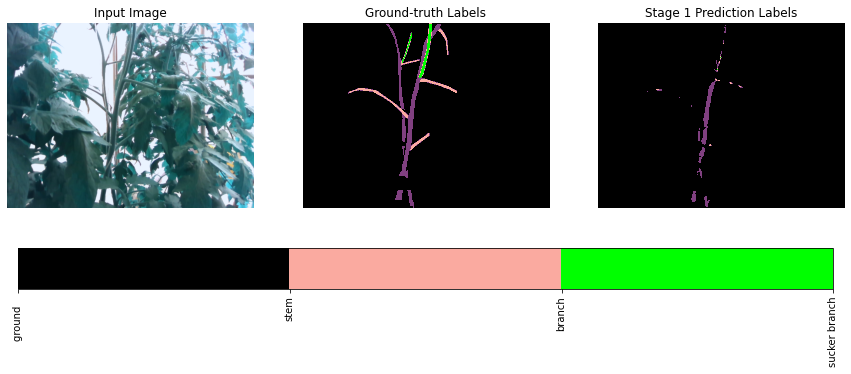

best val iou tensor(0.3718, device='cuda:0')


Train Epoch: [8/40] Loss: 0.1140 mPA: 96.55% FPS: 395.3 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.3857: 100%|██████████| 326/326 [01:53<00:00,  2.88it/s]


best_val


Train Epoch: [8/40] Loss: 0.2324 mPA: 96.51% FPS: 567.5 Lr: 0.0000000000 sucker_t: 30.2 sucker_f: 50.0   IOU1: 0.3782 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1027 FPS: 89.0 IOU: 0.3593


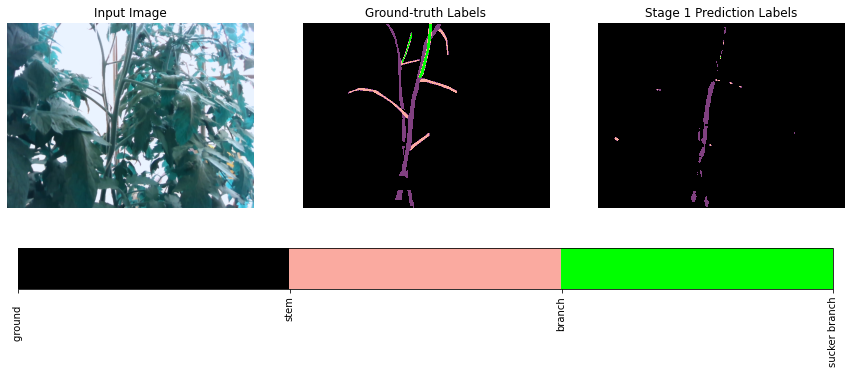

best val iou tensor(0.3782, device='cuda:0')


Train Epoch: [9/40] Loss: 0.1131 mPA: 96.58% FPS: 441.6 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.3905: 100%|██████████| 326/326 [01:44<00:00,  3.11it/s]


best_val


Train Epoch: [9/40] Loss: 0.2293 mPA: 96.55% FPS: 605.8 Lr: 0.0000000000 sucker_t: 47.2 sucker_f: 56.7   IOU1: 0.3812 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.0970 FPS: 62.0 IOU: 0.3899


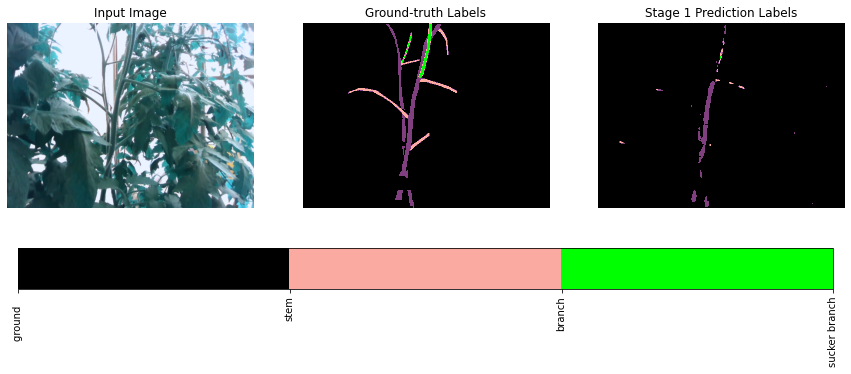

best val iou tensor(0.3812, device='cuda:0')


Train Epoch: [10/40] Loss: 0.1123 mPA: 96.60% FPS: 420.4 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.3961: 100%|██████████| 326/326 [01:47<00:00,  3.04it/s]


best_val


Train Epoch: [10/40] Loss: 0.2292 mPA: 96.56% FPS: 460.9 Lr: 0.0000000000 sucker_t: 47.2 sucker_f: 43.7   IOU1: 0.3804 : 100%|██████████| 41/41 [00:19<00:00,  2.13it/s]


idx: 169
Val Loss: 0.0985 FPS: 33.5 IOU: 0.3904


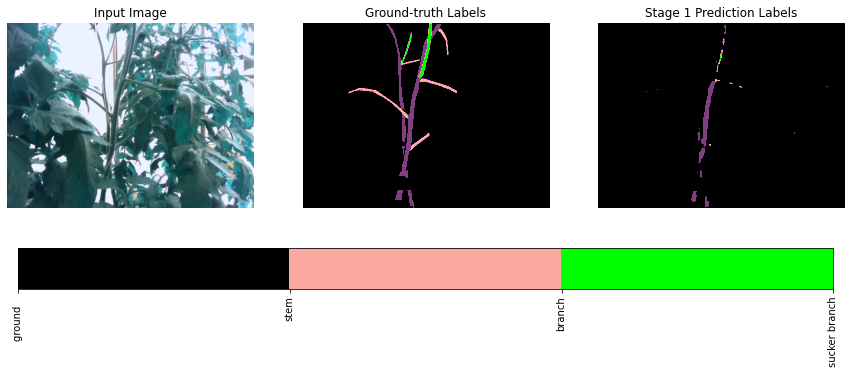

best val iou tensor(0.3812, device='cuda:0')


Train Epoch: [11/40] Loss: 0.1116 mPA: 96.61% FPS: 437.8 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.3996: 100%|██████████| 326/326 [01:45<00:00,  3.08it/s]


best_val


Train Epoch: [11/40] Loss: 0.2278 mPA: 96.57% FPS: 619.6 Lr: 0.0000000000 sucker_t: 53.1 sucker_f: 53.3   IOU1: 0.3860 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1010 FPS: 89.7 IOU: 0.3955


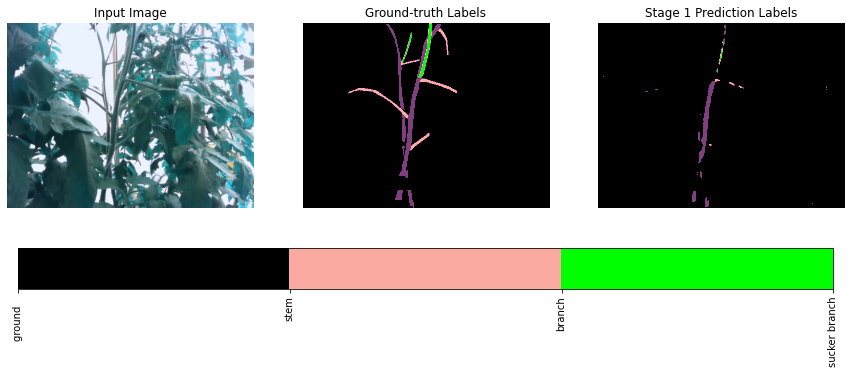

best val iou tensor(0.3860, device='cuda:0')


Train Epoch: [12/40] Loss: 0.1110 mPA: 96.63% FPS: 473.0 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.4023: 100%|██████████| 326/326 [01:43<00:00,  3.16it/s]


best_val


Train Epoch: [12/40] Loss: 0.2263 mPA: 96.60% FPS: 600.4 Lr: 0.0000000000 sucker_t: 53.9 sucker_f: 45.8   IOU1: 0.3847 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.0963 FPS: 80.5 IOU: 0.4106


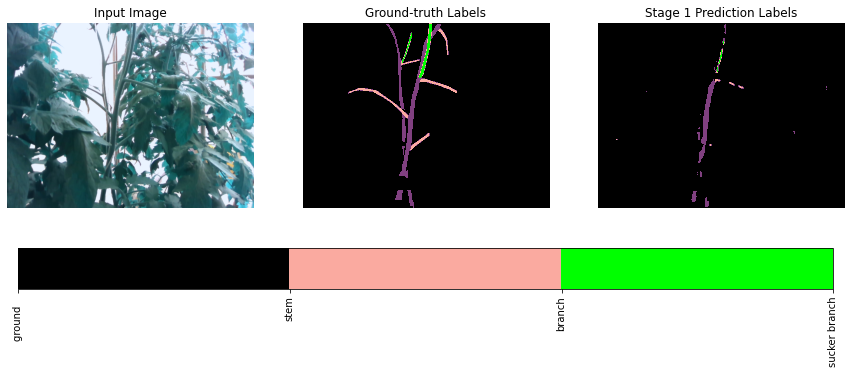

best val iou tensor(0.3860, device='cuda:0')


Train Epoch: [13/40] Loss: 0.1106 mPA: 96.64% FPS: 464.7 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.4047: 100%|██████████| 326/326 [01:43<00:00,  3.16it/s]


best_val


Train Epoch: [13/40] Loss: 0.2265 mPA: 96.59% FPS: 633.1 Lr: 0.0000000000 sucker_t: 61.5 sucker_f: 38.3   IOU1: 0.3952 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1020 FPS: 92.1 IOU: 0.4188


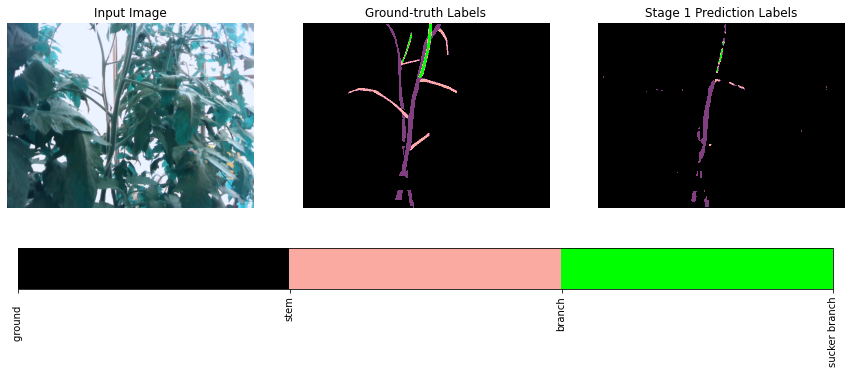

best val iou tensor(0.3952, device='cuda:0')


Train Epoch: [14/40] Loss: 0.1103 mPA: 96.65% FPS: 478.8 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.4072: 100%|██████████| 326/326 [01:42<00:00,  3.18it/s]


best_val


Train Epoch: [14/40] Loss: 0.2245 mPA: 96.60% FPS: 597.6 Lr: 0.0000000000 sucker_t: 59.6 sucker_f: 46.8   IOU1: 0.3922 : 100%|██████████| 41/41 [00:17<00:00,  2.39it/s]


idx: 169
Val Loss: 0.0990 FPS: 82.6 IOU: 0.4101


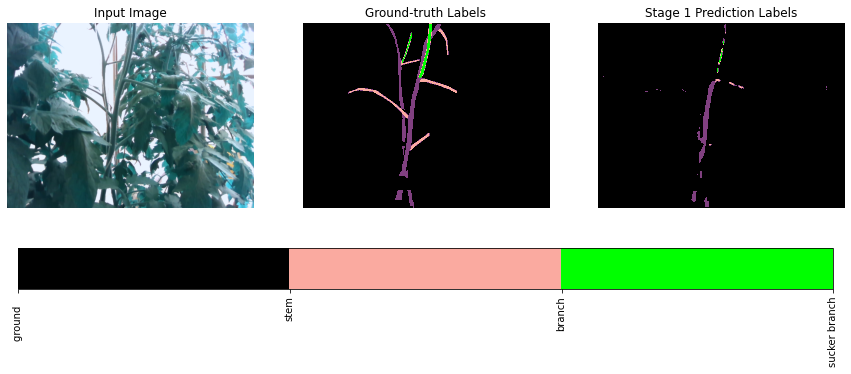

best val iou tensor(0.3952, device='cuda:0')


Train Epoch: [15/40] Loss: 0.1099 mPA: 96.66% FPS: 480.3 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.4093: 100%|██████████| 326/326 [01:42<00:00,  3.19it/s]


best_val


Train Epoch: [15/40] Loss: 0.2238 mPA: 96.62% FPS: 627.8 Lr: 0.0000000000 sucker_t: 60.2 sucker_f: 41.3   IOU1: 0.3913 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.0969 FPS: 90.0 IOU: 0.4264


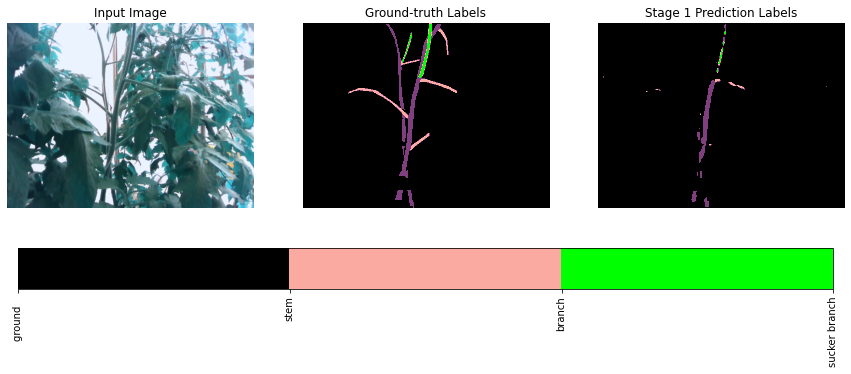

best val iou tensor(0.3952, device='cuda:0')


Train Epoch: [16/40] Loss: 0.1094 mPA: 96.67% FPS: 473.1 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.4106: 100%|██████████| 326/326 [01:42<00:00,  3.18it/s]


best_val


Train Epoch: [16/40] Loss: 0.2239 mPA: 96.62% FPS: 574.7 Lr: 0.0000000000 sucker_t: 59.8 sucker_f: 38.8   IOU1: 0.3912 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.0956 FPS: 86.5 IOU: 0.4242


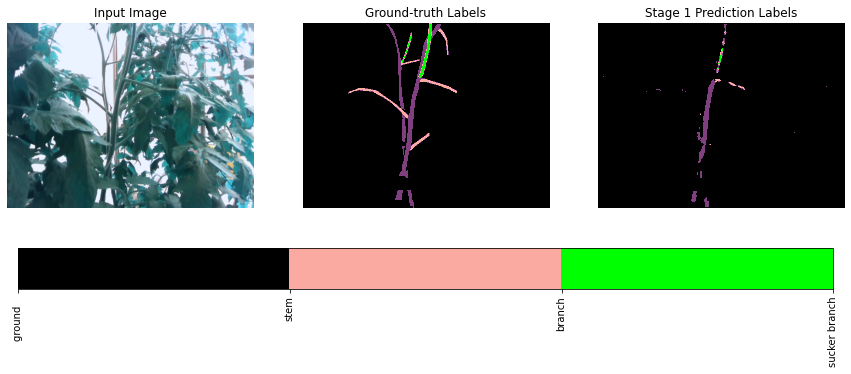

best val iou tensor(0.3952, device='cuda:0')


Train Epoch: [17/40] Loss: 0.1092 mPA: 96.67% FPS: 465.2 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.4123: 100%|██████████| 326/326 [01:43<00:00,  3.14it/s]


best_val


Train Epoch: [17/40] Loss: 0.2241 mPA: 96.61% FPS: 608.1 Lr: 0.0000000000 sucker_t: 63.5 sucker_f: 33.7   IOU1: 0.3999 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1003 FPS: 85.5 IOU: 0.4284


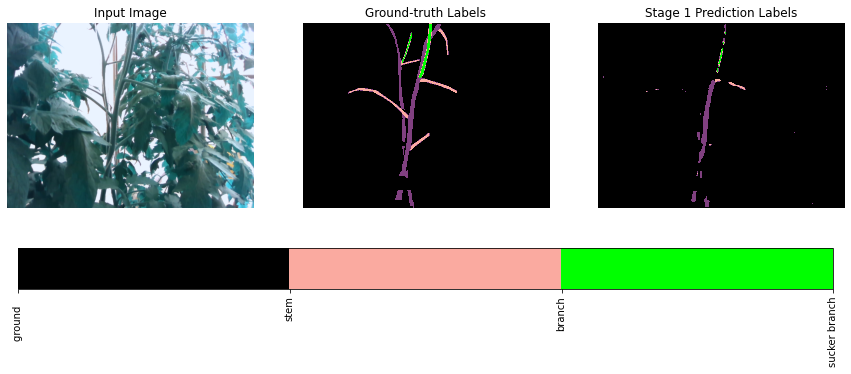

best val iou tensor(0.3999, device='cuda:0')


Train Epoch: [18/40] Loss: 0.1090 mPA: 96.68% FPS: 445.8 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.4135: 100%|██████████| 326/326 [01:44<00:00,  3.13it/s]


best_val


Train Epoch: [18/40] Loss: 0.2259 mPA: 96.60% FPS: 608.9 Lr: 0.0000000000 sucker_t: 59.4 sucker_f: 34.1   IOU1: 0.3951 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1025 FPS: 86.8 IOU: 0.4334


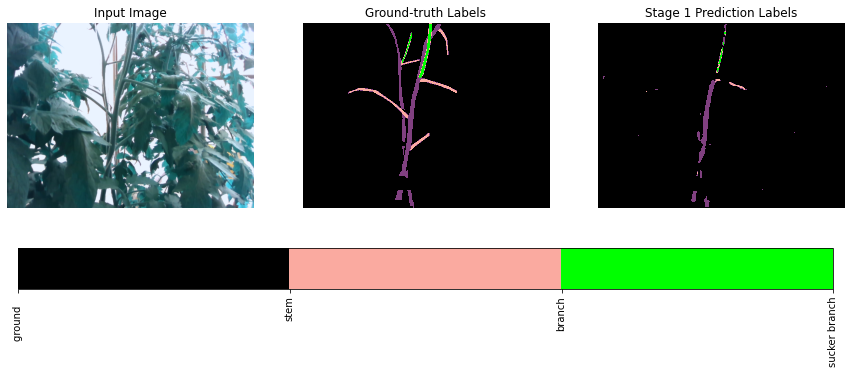

best val iou tensor(0.3999, device='cuda:0')


Train Epoch: [19/40] Loss: 0.1087 mPA: 96.69% FPS: 451.8 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.4148: 100%|██████████| 326/326 [01:44<00:00,  3.13it/s]


best_val


Train Epoch: [19/40] Loss: 0.2237 mPA: 96.63% FPS: 587.0 Lr: 0.0000000000 sucker_t: 63.0 sucker_f: 35.5   IOU1: 0.3939 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.0956 FPS: 65.5 IOU: 0.4273


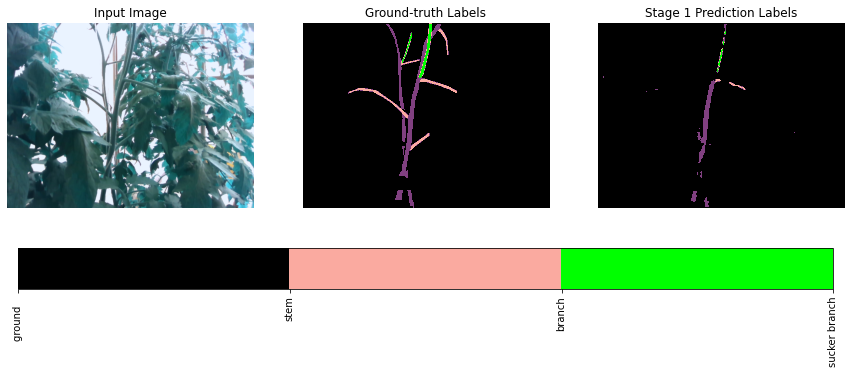

best val iou tensor(0.3999, device='cuda:0')


Train Epoch: [20/40] Loss: 0.1074 mPA: 96.72% FPS: 424.2 Lr: 0.0003463153 sucker: 0.0000 IOU1: 0.4175:  21%|██        | 68/326 [00:23<01:27,  2.95it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(15)

Train Epoch: [0/40] Loss: 0.1573 mPA: 96.38% FPS: 620.3 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.4265: 100%|██████████| 326/326 [03:28<00:00,  1.56it/s]


best_val


Train Epoch: [0/40] Loss: 0.1870 mPA: 97.09% FPS: 630.4 Lr: 0.0000000000 sucker_t: 42.4 sucker_f: 56.0   IOU1: 0.4800 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.0731 FPS: 63.4 IOU: 0.4942


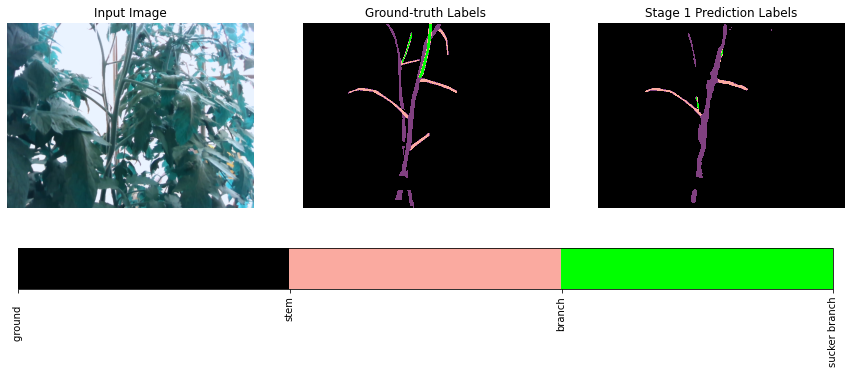

best val iou tensor(0.4800, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0775 mPA: 97.47% FPS: 622.9 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.5666: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [1/40] Loss: 0.1695 mPA: 97.19% FPS: 657.1 Lr: 0.0000000000 sucker_t: 58.5 sucker_f: 21.0   IOU1: 0.5533 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.1099 FPS: 90.9 IOU: 0.4590


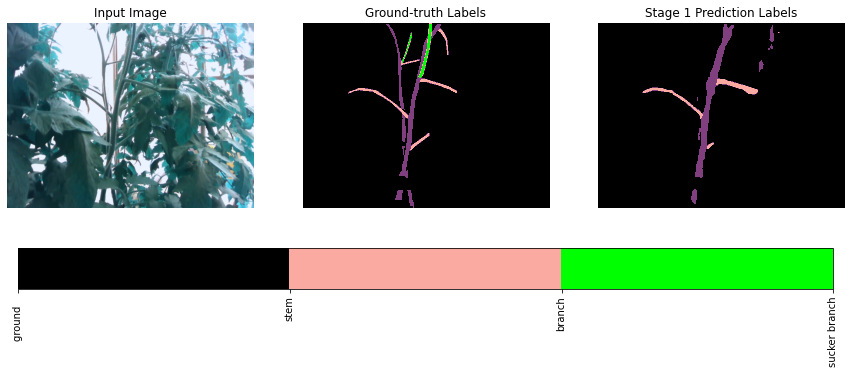

best val iou tensor(0.5533, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0641 mPA: 97.79% FPS: 617.8 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.6239: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [2/40] Loss: 0.1465 mPA: 97.55% FPS: 668.7 Lr: 0.0000000000 sucker_t: 80.9 sucker_f: 46.6   IOU1: 0.5858 : 100%|██████████| 41/41 [00:18<00:00,  2.18it/s]


idx: 169
Val Loss: 0.0802 FPS: 89.6 IOU: 0.5880


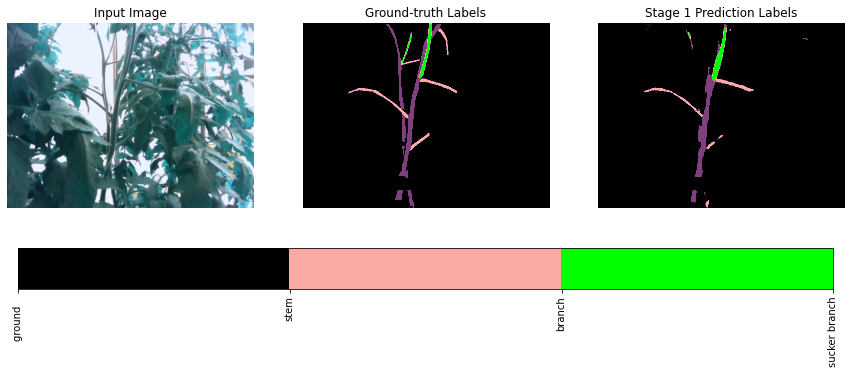

best val iou tensor(0.5858, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0537 mPA: 98.08% FPS: 619.6 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.6707: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [3/40] Loss: 0.1442 mPA: 97.73% FPS: 665.0 Lr: 0.0000000000 sucker_t: 61.9 sucker_f: 19.5   IOU1: 0.5907 : 100%|██████████| 41/41 [00:18<00:00,  2.28it/s]


idx: 169
Val Loss: 0.0896 FPS: 88.3 IOU: 0.4880


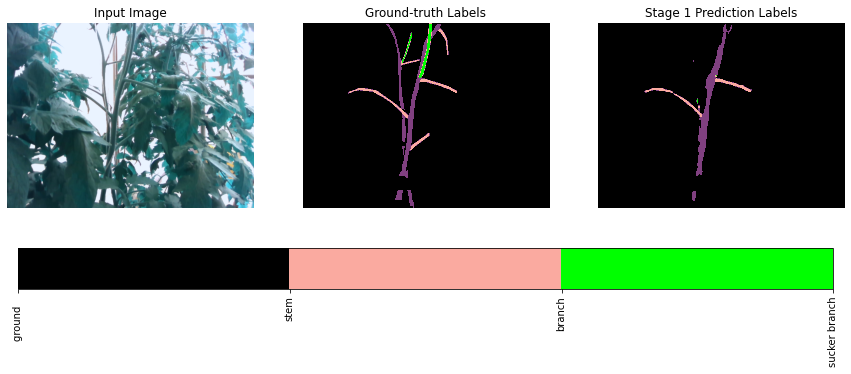

best val iou tensor(0.5907, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0458 mPA: 98.32% FPS: 626.0 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.7095: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [4/40] Loss: 0.1384 mPA: 97.74% FPS: 658.1 Lr: 0.0000000000 sucker_t: 67.6 sucker_f: 23.3   IOU1: 0.6033 : 100%|██████████| 41/41 [00:18<00:00,  2.25it/s]


idx: 169
Val Loss: 0.0716 FPS: 76.5 IOU: 0.5103


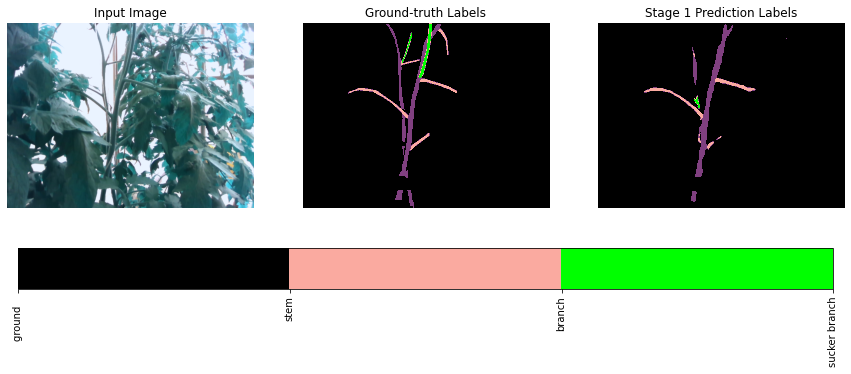

best val iou tensor(0.6033, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0404 mPA: 98.49% FPS: 626.4 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.7361: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [5/40] Loss: 0.1444 mPA: 97.61% FPS: 669.7 Lr: 0.0000000000 sucker_t: 71.9 sucker_f: 15.9   IOU1: 0.6178 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.0744 FPS: 88.8 IOU: 0.5447


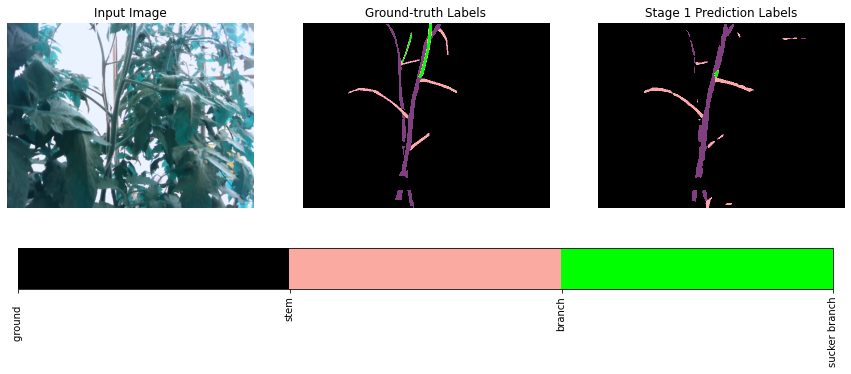

best val iou tensor(0.6178, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0363 mPA: 98.63% FPS: 621.3 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.7565: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [6/40] Loss: 0.1437 mPA: 97.82% FPS: 655.8 Lr: 0.0000000000 sucker_t: 65.9 sucker_f: 15.2   IOU1: 0.6194 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.0817 FPS: 91.7 IOU: 0.5195


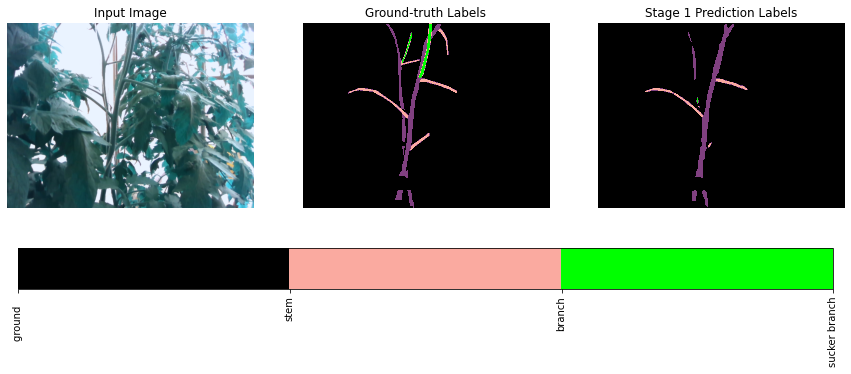

best val iou tensor(0.6194, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0330 mPA: 98.74% FPS: 619.5 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.7730: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [7/40] Loss: 0.1536 mPA: 97.81% FPS: 679.3 Lr: 0.0000000000 sucker_t: 68.3 sucker_f: 7.3   IOU1: 0.6206 : 100%|██████████| 41/41 [00:17<00:00,  2.28it/s]


idx: 169
Val Loss: 0.0860 FPS: 89.2 IOU: 0.5170


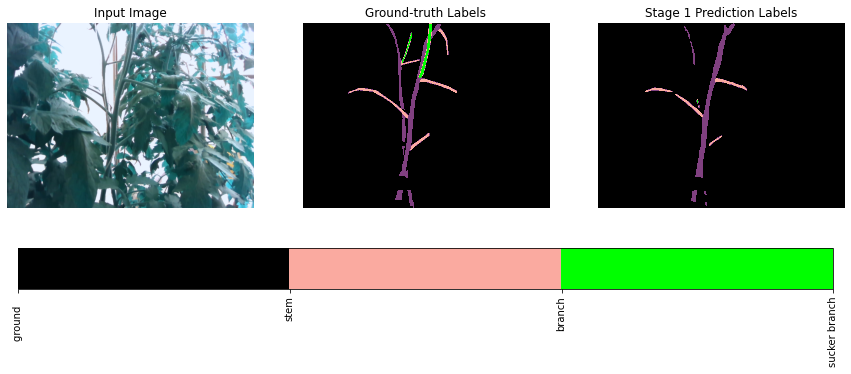

best val iou tensor(0.6206, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0301 mPA: 98.84% FPS: 612.6 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.7945: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [8/40] Loss: 0.1453 mPA: 97.85% FPS: 656.0 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 23.2   IOU1: 0.6371 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.0735 FPS: 88.5 IOU: 0.5854


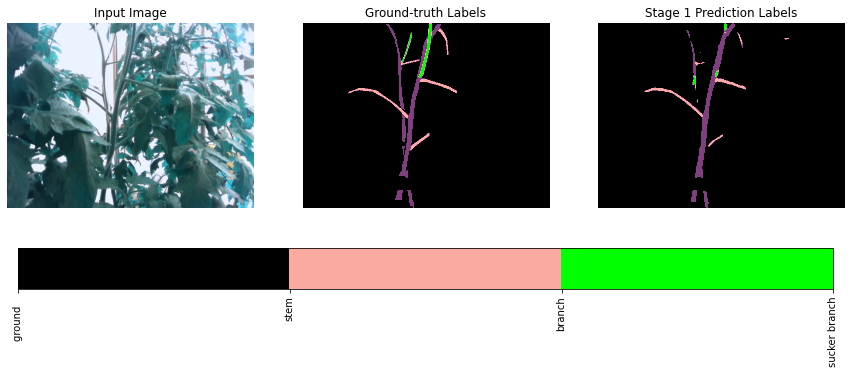

best val iou tensor(0.6371, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0277 mPA: 98.93% FPS: 613.2 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8124: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [9/40] Loss: 0.1567 mPA: 97.57% FPS: 663.2 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 26.1   IOU1: 0.6276 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.0804 FPS: 88.3 IOU: 0.5799


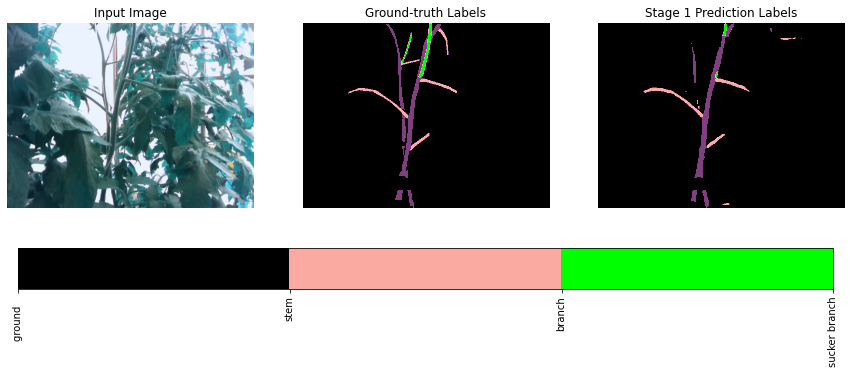

best val iou tensor(0.6371, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0263 mPA: 98.98% FPS: 613.2 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8207: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [10/40] Loss: 0.1656 mPA: 97.88% FPS: 651.2 Lr: 0.0000000000 sucker_t: 77.6 sucker_f: 18.6   IOU1: 0.6376 : 100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


idx: 169
Val Loss: 0.0858 FPS: 91.6 IOU: 0.5726


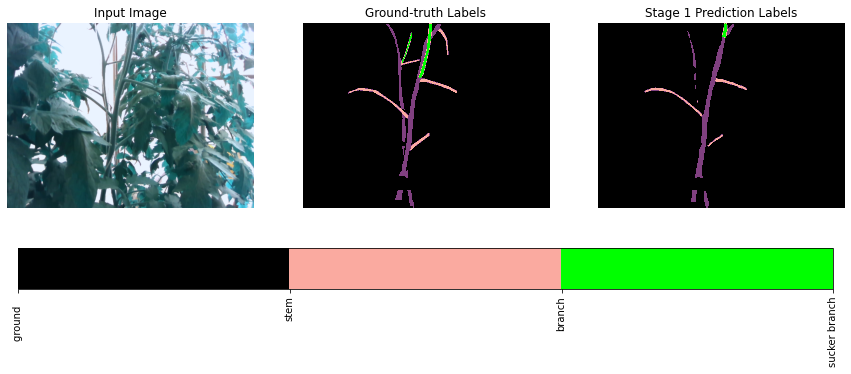

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0246 mPA: 99.04% FPS: 609.6 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8305: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [11/40] Loss: 0.1721 mPA: 97.86% FPS: 668.5 Lr: 0.0000000000 sucker_t: 78.1 sucker_f: 24.2   IOU1: 0.6284 : 100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


idx: 169
Val Loss: 0.0952 FPS: 92.7 IOU: 0.6063


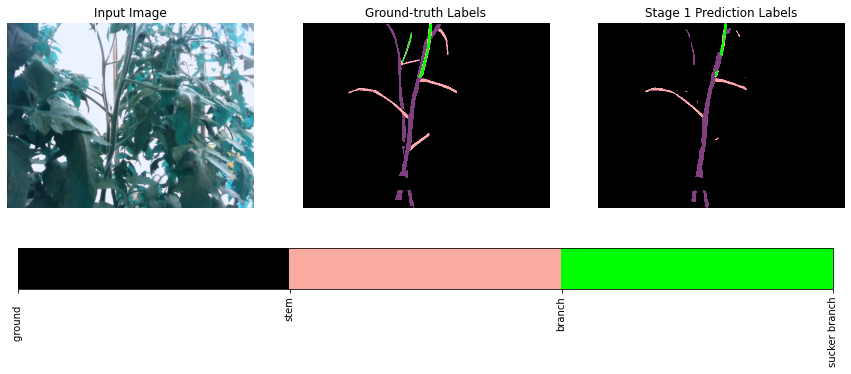

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0244 mPA: 99.05% FPS: 604.9 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8297: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [12/40] Loss: 0.1727 mPA: 97.88% FPS: 654.1 Lr: 0.0000000000 sucker_t: 73.7 sucker_f: 21.6   IOU1: 0.6331 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.1156 FPS: 89.4 IOU: 0.5007


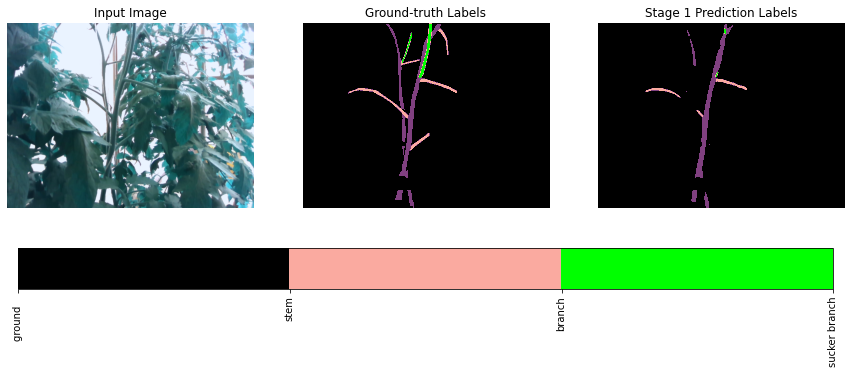

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0224 mPA: 99.12% FPS: 591.6 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8431: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [13/40] Loss: 0.1775 mPA: 97.80% FPS: 657.1 Lr: 0.0000000000 sucker_t: 71.9 sucker_f: 14.2   IOU1: 0.6308 : 100%|██████████| 41/41 [00:17<00:00,  2.28it/s]


idx: 169
Val Loss: 0.1012 FPS: 82.2 IOU: 0.5262


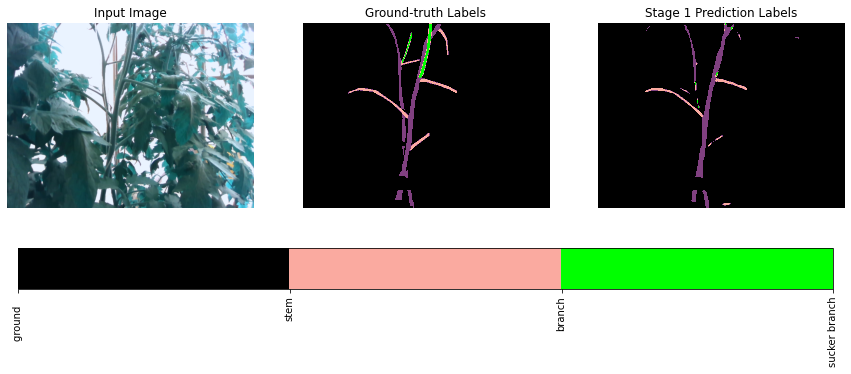

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0213 mPA: 99.16% FPS: 586.1 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8505: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [14/40] Loss: 0.1807 mPA: 97.86% FPS: 617.4 Lr: 0.0000000000 sucker_t: 75.0 sucker_f: 15.3   IOU1: 0.6372 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.1065 FPS: 92.2 IOU: 0.5490


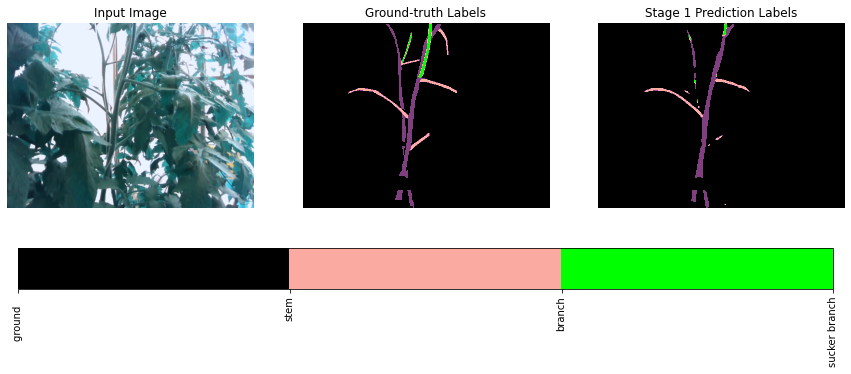

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0204 mPA: 99.20% FPS: 577.6 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8553: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [15/40] Loss: 0.1967 mPA: 97.85% FPS: 650.0 Lr: 0.0000000000 sucker_t: 79.4 sucker_f: 21.5   IOU1: 0.6370 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.1268 FPS: 86.7 IOU: 0.5301


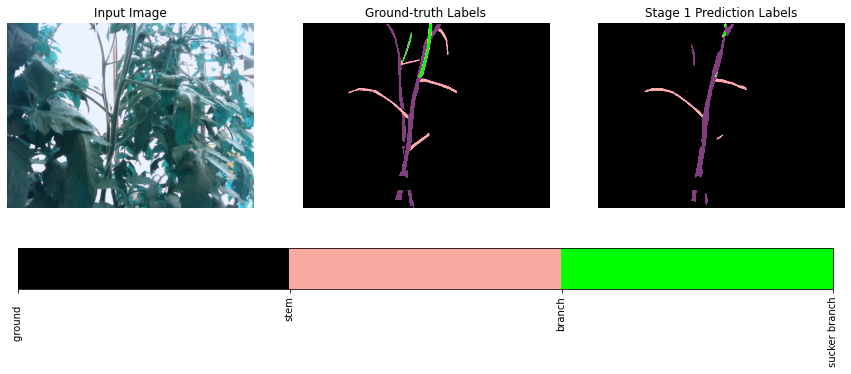

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0200 mPA: 99.21% FPS: 565.9 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8578: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [16/40] Loss: 0.1948 mPA: 97.77% FPS: 618.9 Lr: 0.0000000000 sucker_t: 76.3 sucker_f: 19.3   IOU1: 0.6373 : 100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


idx: 169
Val Loss: 0.1230 FPS: 82.9 IOU: 0.5123


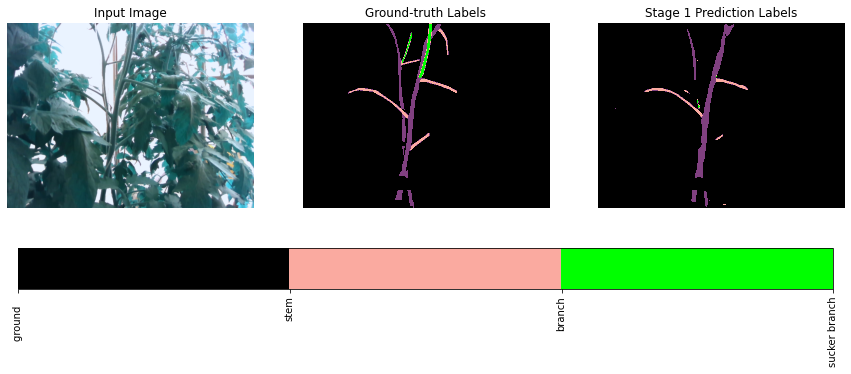

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0193 mPA: 99.24% FPS: 567.0 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8620: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [17/40] Loss: 0.1977 mPA: 97.84% FPS: 644.4 Lr: 0.0000000000 sucker_t: 76.3 sucker_f: 20.3   IOU1: 0.6348 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.1183 FPS: 66.9 IOU: 0.5397


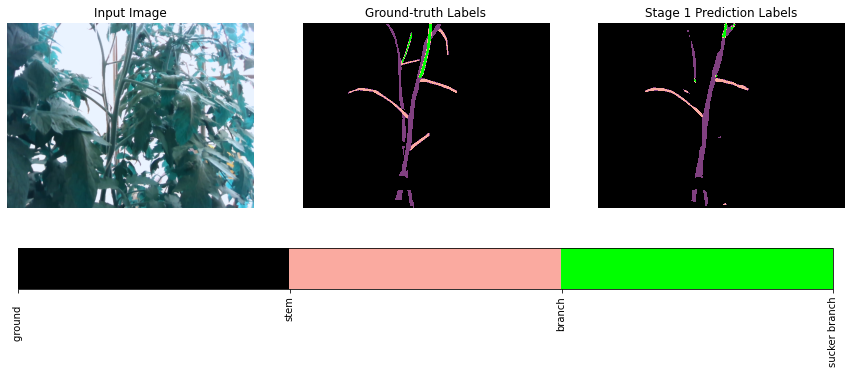

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0186 mPA: 99.26% FPS: 565.5 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8664: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [18/40] Loss: 0.2022 mPA: 97.84% FPS: 629.0 Lr: 0.0000000000 sucker_t: 73.5 sucker_f: 15.4   IOU1: 0.6316 : 100%|██████████| 41/41 [00:18<00:00,  2.22it/s]


idx: 169
Val Loss: 0.1342 FPS: 87.2 IOU: 0.5033


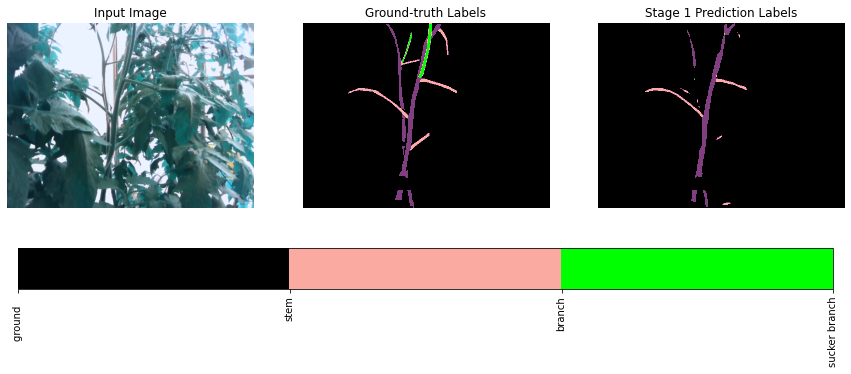

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0180 mPA: 99.29% FPS: 564.3 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8701: 100%|██████████| 326/326 [03:27<00:00,  1.57it/s]


best_val


Train Epoch: [19/40] Loss: 0.2011 mPA: 97.83% FPS: 649.8 Lr: 0.0000000000 sucker_t: 68.9 sucker_f: 13.7   IOU1: 0.6323 : 100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


idx: 169
Val Loss: 0.1260 FPS: 94.4 IOU: 0.5135


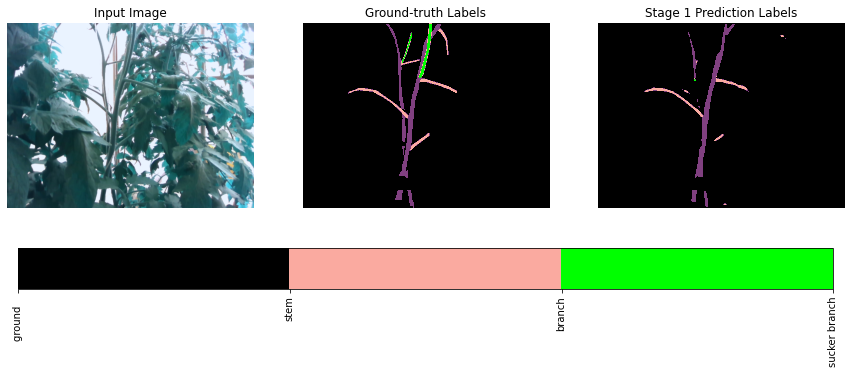

best val iou tensor(0.6376, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0173 mPA: 99.31% FPS: 564.3 Lr: 0.0003223503 sucker: 0.0000 IOU1: 0.8739:  94%|█████████▍| 307/326 [03:16<00:12,  1.56it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch()

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

DLIGHT with low stage1

In [ ]:
class DLightNet_depth_2(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=20, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=9, stride=1)
        self.conv1_3 = ConvBlock(in_channels=1, out_channels=3, stride=1)
        #  self.conv1_1 = ConvBlock(in_channels=3, out_channels=12, stride=1)
        # self.conv1_2 = ConvBlock(in_channels=3, out_channels=16, stride=1)
        # self.conv1_3 = ConvBlock(in_channels=1, out_channels=4, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)

    def forward(self, x):
        input = x[:,0:3,:,:]
        depth = x[:,3,:,:].unsqueeze(1)
      #  print('x1')
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
     #   print('x1')
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
     #   print('x1')
        x = self.s1_conv_final(x)
        x_f1 = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
       
       
        with torch.no_grad():
            x1 = self.s1_softmax(x_f1).detach()
            input1,depth1 = remove_easypixel(x1,input,depth,0.95,0.2 )
          
        
    #    print('b1')
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2_3 =  self.conv1_3(depth1)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 = torch.cat((xs2,xs2_3),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
    #    print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2
trainer = Trainner( DLightNet_depth_2,'DLightNet_depth_2',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer = Trainner( DLightNet_depth_2,'DLightNet_depth_2',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.load_weight(save_path='/content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_9.pth')
#trainer.load_epoch(11)
trainer.eval()

Train Epoch: [0/40] Loss: 0.0419 mPA: 98.45% FPS: 871.2 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.7406: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [0/40] Loss: 0.1653 mPA: 97.52% FPS: 952.9 Lr: 0.0000000000 sucker_t: 86.1 sucker_f: 45.2   IOU1: 0.5966 : 100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


idx: 169
Val Loss: 0.0756 FPS: 121.7 IOU: 0.6113


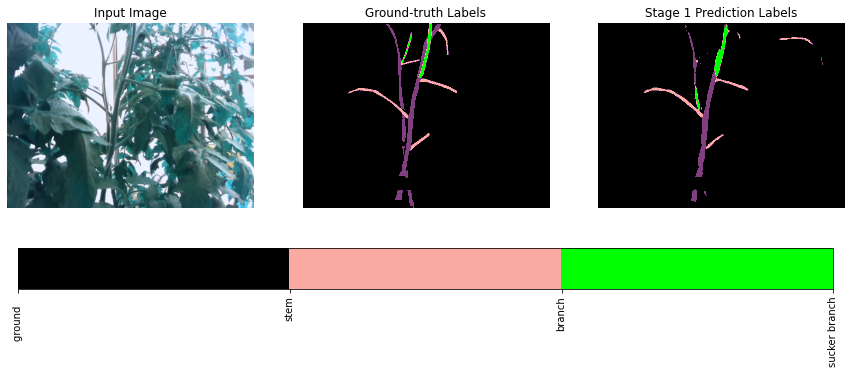

best val iou tensor(0.5966, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0324 mPA: 98.76% FPS: 877.7 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.7877: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [1/40] Loss: 0.1649 mPA: 97.56% FPS: 962.3 Lr: 0.0000000000 sucker_t: 78.0 sucker_f: 21.9   IOU1: 0.6206 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1049 FPS: 128.7 IOU: 0.5276


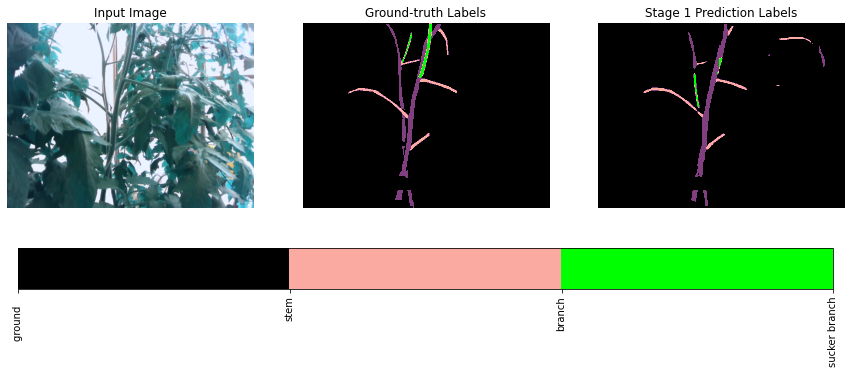

best val iou tensor(0.6206, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0307 mPA: 98.81% FPS: 884.9 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.7976: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [2/40] Loss: 0.1542 mPA: 97.76% FPS: 978.7 Lr: 0.0000000000 sucker_t: 81.5 sucker_f: 31.4   IOU1: 0.6197 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.0833 FPS: 118.4 IOU: 0.4883


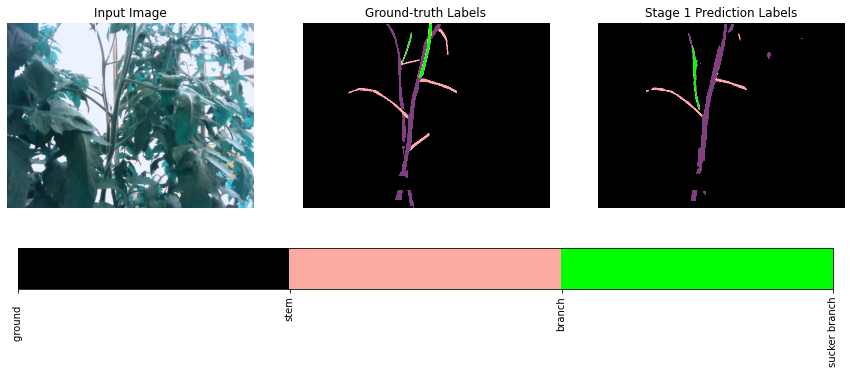

best val iou tensor(0.6206, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0274 mPA: 98.93% FPS: 886.8 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.8168: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [3/40] Loss: 0.1545 mPA: 97.84% FPS: 969.7 Lr: 0.0000000000 sucker_t: 73.1 sucker_f: 16.2   IOU1: 0.6291 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.0794 FPS: 128.9 IOU: 0.5609


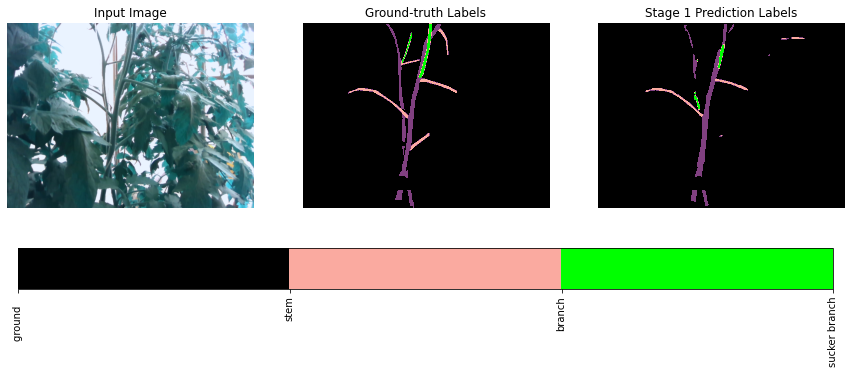

best val iou tensor(0.6291, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0256 mPA: 98.99% FPS: 881.1 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.8257: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [4/40] Loss: 0.1523 mPA: 97.72% FPS: 980.4 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 21.3   IOU1: 0.6322 : 100%|██████████| 41/41 [00:16<00:00,  2.42it/s]


idx: 169
Val Loss: 0.0760 FPS: 126.8 IOU: 0.5861


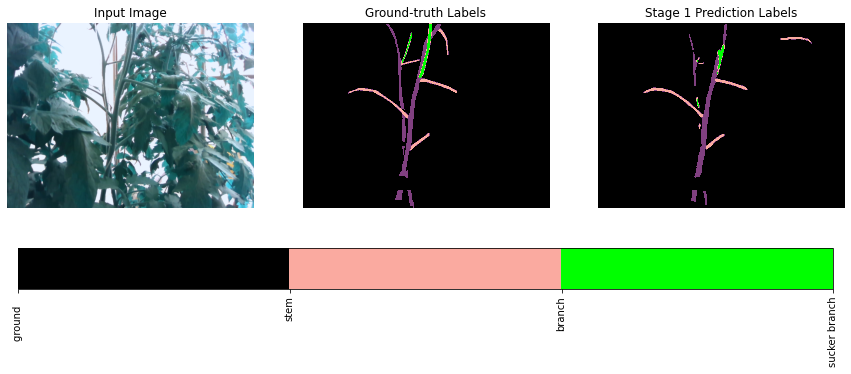

best val iou tensor(0.6322, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0240 mPA: 99.05% FPS: 898.1 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.8368: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [5/40] Loss: 0.1557 mPA: 97.77% FPS: 967.2 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 21.6   IOU1: 0.6408 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.0813 FPS: 131.6 IOU: 0.5671


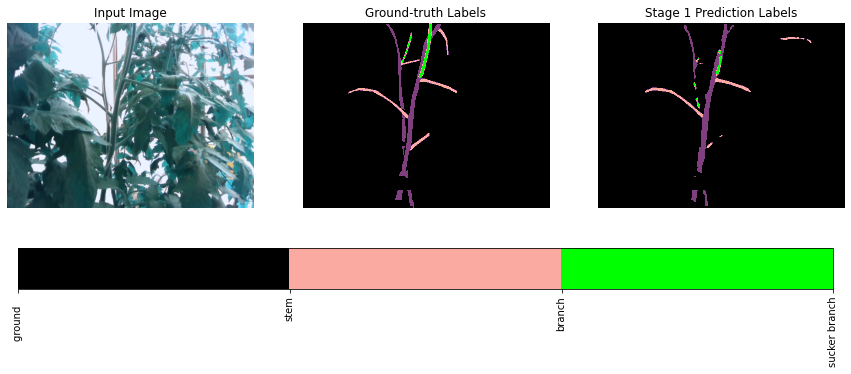

best val iou tensor(0.6408, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0229 mPA: 99.09% FPS: 889.6 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.8421: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [6/40] Loss: 0.1797 mPA: 97.85% FPS: 948.9 Lr: 0.0000000000 sucker_t: 79.8 sucker_f: 23.4   IOU1: 0.6451 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1076 FPS: 120.2 IOU: 0.5797


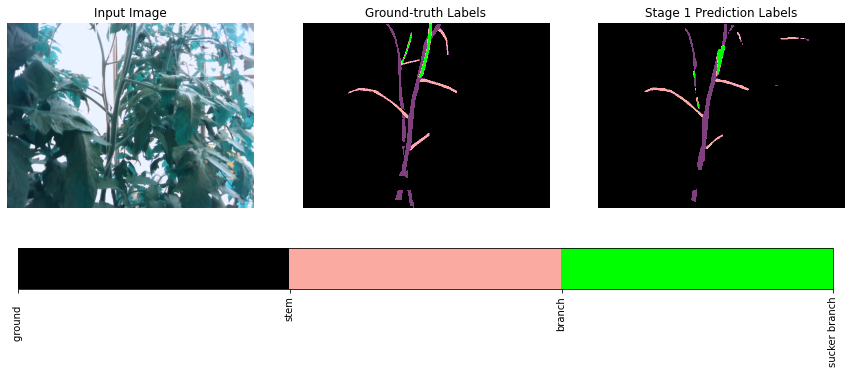

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0216 mPA: 99.14% FPS: 885.5 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.8505: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [7/40] Loss: 0.1855 mPA: 97.86% FPS: 938.5 Lr: 0.0000000000 sucker_t: 73.0 sucker_f: 15.7   IOU1: 0.6338 : 100%|██████████| 41/41 [00:17<00:00,  2.41it/s]


idx: 169
Val Loss: 0.1262 FPS: 130.6 IOU: 0.5319


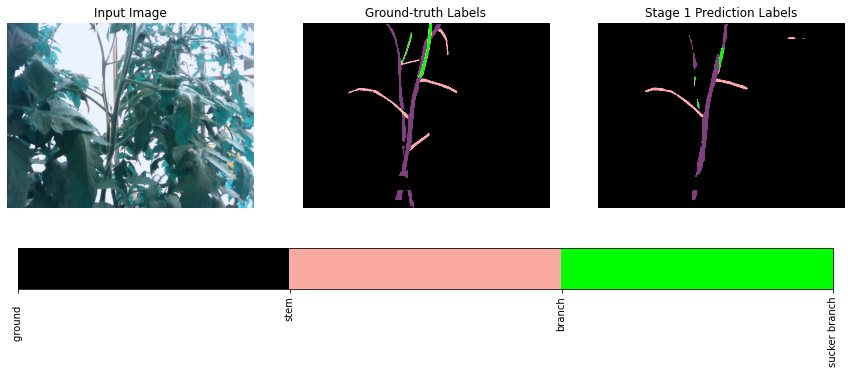

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0205 mPA: 99.18% FPS: 882.3 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8570: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [8/40] Loss: 0.1941 mPA: 97.89% FPS: 921.8 Lr: 0.0000000000 sucker_t: 75.9 sucker_f: 18.4   IOU1: 0.6426 : 100%|██████████| 41/41 [00:17<00:00,  2.41it/s]


idx: 169
Val Loss: 0.1296 FPS: 121.7 IOU: 0.5490


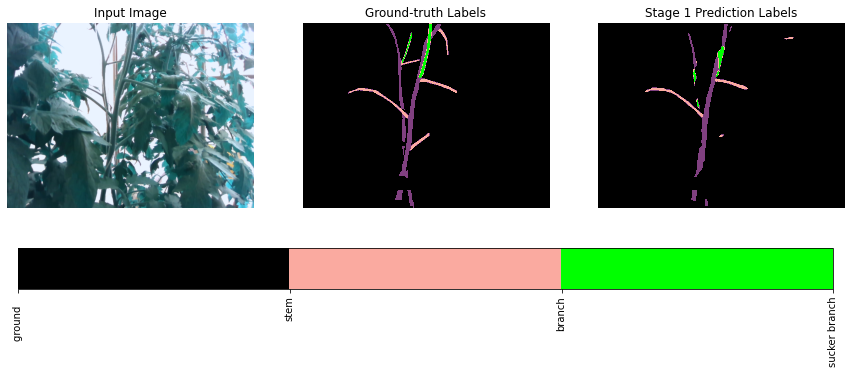

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0198 mPA: 99.21% FPS: 883.5 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8614: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [9/40] Loss: 0.1972 mPA: 97.82% FPS: 939.4 Lr: 0.0000000000 sucker_t: 77.8 sucker_f: 18.9   IOU1: 0.6408 : 100%|██████████| 41/41 [00:16<00:00,  2.41it/s]


idx: 169
Val Loss: 0.1168 FPS: 132.5 IOU: 0.5540


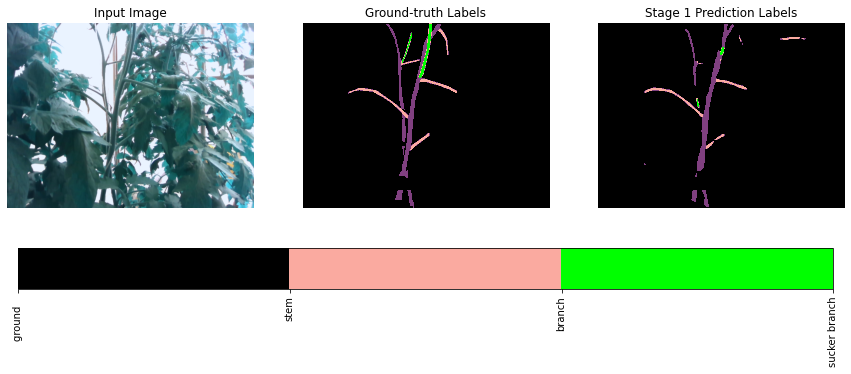

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0190 mPA: 99.24% FPS: 901.2 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8665: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [10/40] Loss: 0.2030 mPA: 97.86% FPS: 927.4 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 17.2   IOU1: 0.6339 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1555 FPS: 129.4 IOU: 0.5118


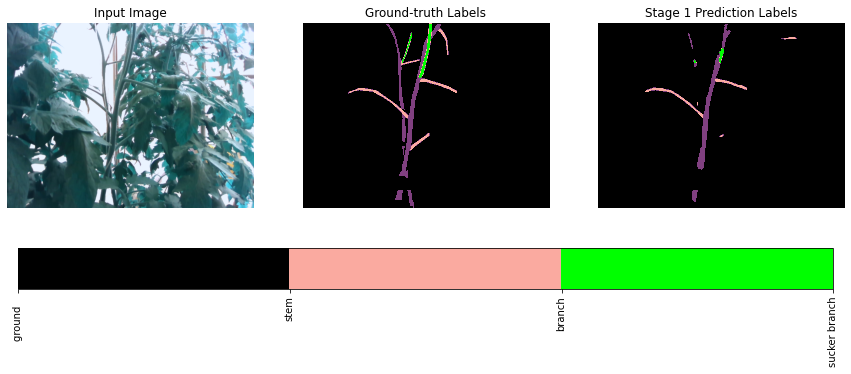

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0183 mPA: 99.27% FPS: 878.0 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8708: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [11/40] Loss: 0.2337 mPA: 97.87% FPS: 950.6 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 19.3   IOU1: 0.6377 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1475 FPS: 129.8 IOU: 0.5491


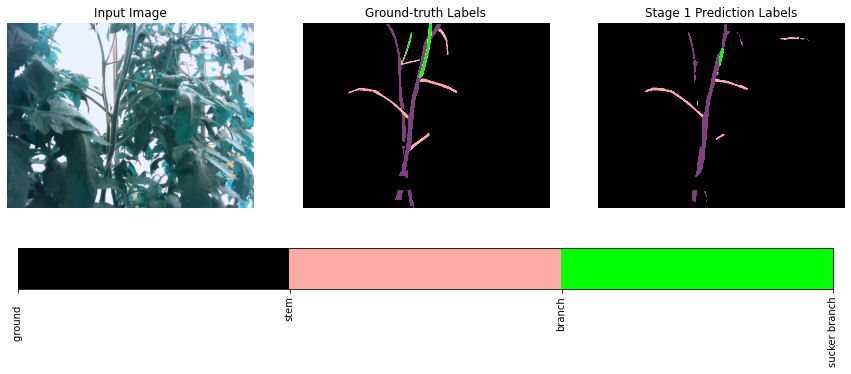

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0176 mPA: 99.29% FPS: 888.5 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8751: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [12/40] Loss: 0.1839 mPA: 97.86% FPS: 941.7 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 24.6   IOU1: 0.6413 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1168 FPS: 126.2 IOU: 0.5742


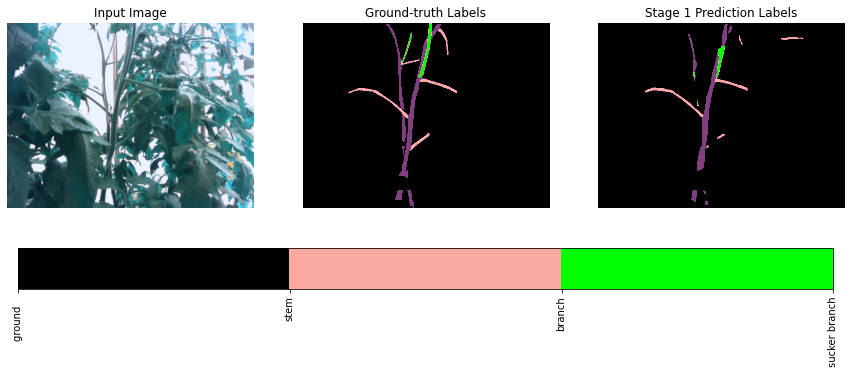

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0171 mPA: 99.31% FPS: 884.5 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8781: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [13/40] Loss: 0.2086 mPA: 97.81% FPS: 938.3 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 23.1   IOU1: 0.6415 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1230 FPS: 129.0 IOU: 0.5755


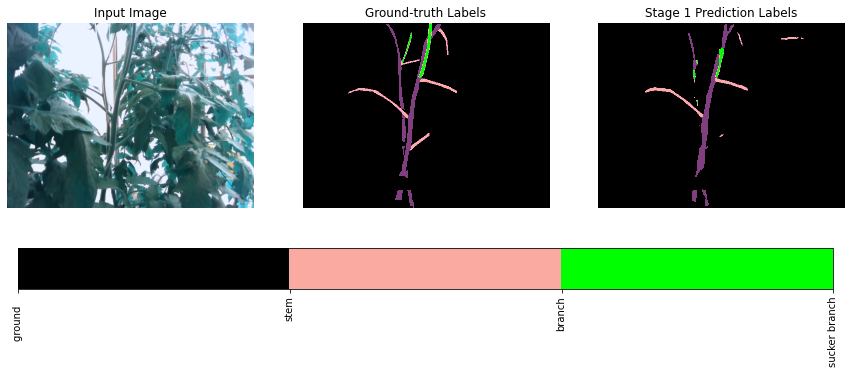

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0165 mPA: 99.33% FPS: 868.5 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8814: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [14/40] Loss: 0.2305 mPA: 97.85% FPS: 965.5 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 14.8   IOU1: 0.6375 : 100%|██████████| 41/41 [00:16<00:00,  2.41it/s]


idx: 169
Val Loss: 0.1636 FPS: 131.9 IOU: 0.5113


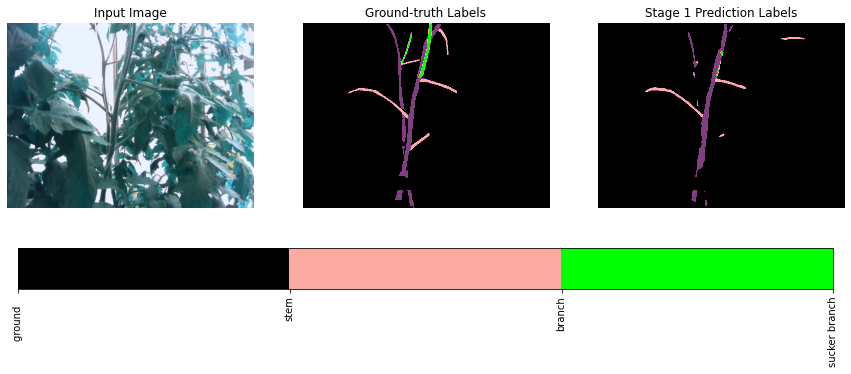

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0160 mPA: 99.35% FPS: 860.8 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8849: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [15/40] Loss: 0.2302 mPA: 97.86% FPS: 904.1 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 20.9   IOU1: 0.6365 : 100%|██████████| 41/41 [00:17<00:00,  2.39it/s]


idx: 169
Val Loss: 0.1553 FPS: 128.7 IOU: 0.5408


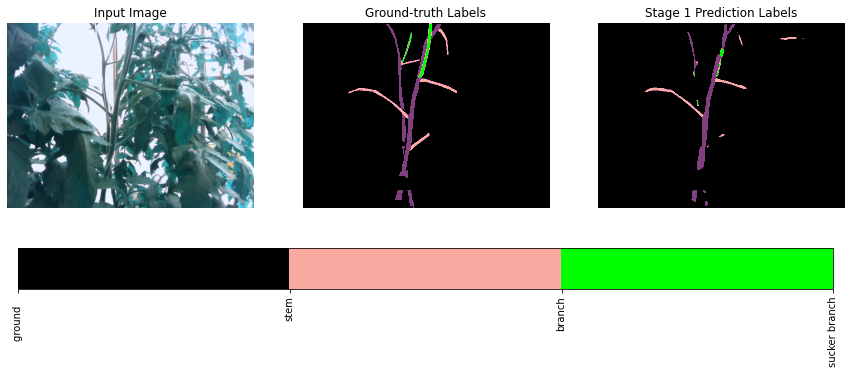

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0157 mPA: 99.37% FPS: 851.7 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8872: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [16/40] Loss: 0.2132 mPA: 97.83% FPS: 953.4 Lr: 0.0000000000 sucker_t: 76.9 sucker_f: 19.1   IOU1: 0.6407 : 100%|██████████| 41/41 [00:17<00:00,  2.39it/s]


idx: 169
Val Loss: 0.1483 FPS: 105.4 IOU: 0.5668


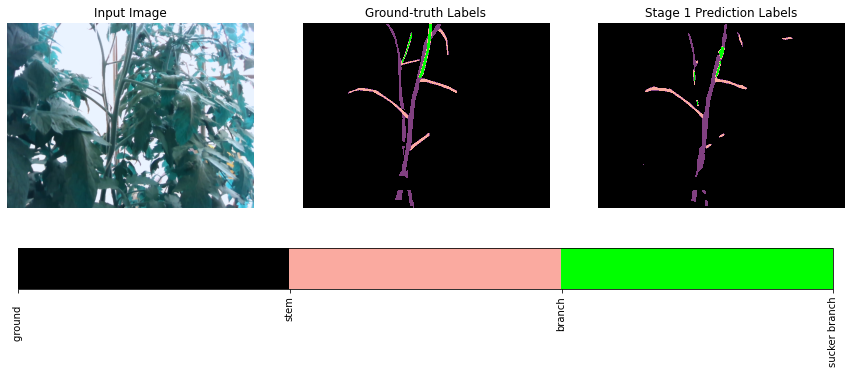

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0157 mPA: 99.37% FPS: 858.9 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8870: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [17/40] Loss: 0.2321 mPA: 97.82% FPS: 874.0 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 20.0   IOU1: 0.6378 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1401 FPS: 128.5 IOU: 0.5434


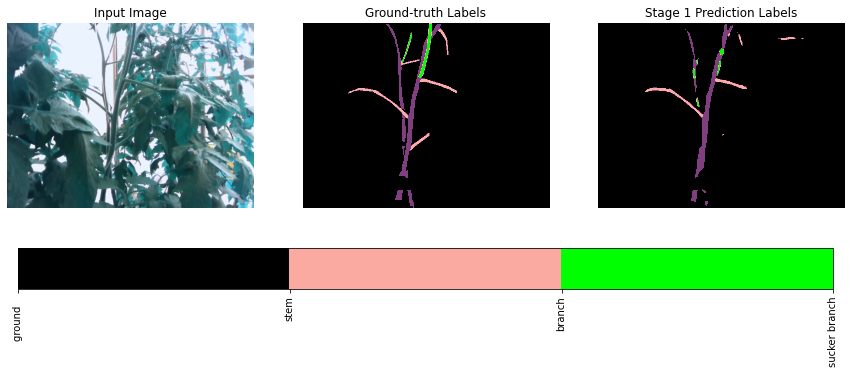

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0151 mPA: 99.39% FPS: 817.8 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8912: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [18/40] Loss: 0.2259 mPA: 97.85% FPS: 884.9 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 22.7   IOU1: 0.6360 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1531 FPS: 129.9 IOU: 0.5329


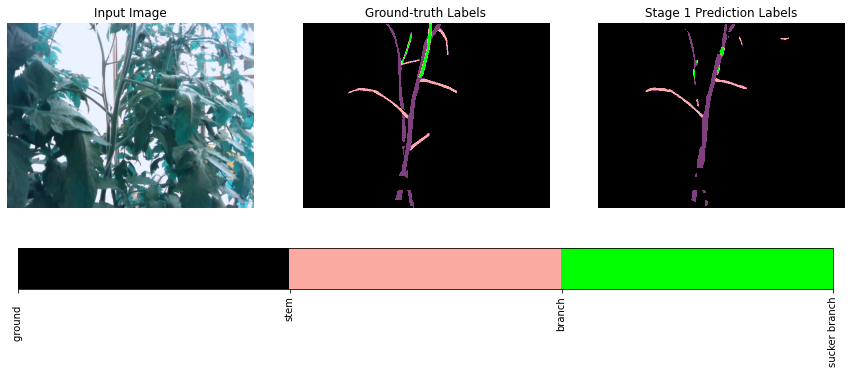

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0147 mPA: 99.40% FPS: 830.7 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8929: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [19/40] Loss: 0.2397 mPA: 97.84% FPS: 903.1 Lr: 0.0000000000 sucker_t: 75.2 sucker_f: 20.7   IOU1: 0.6342 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1673 FPS: 127.3 IOU: 0.5022


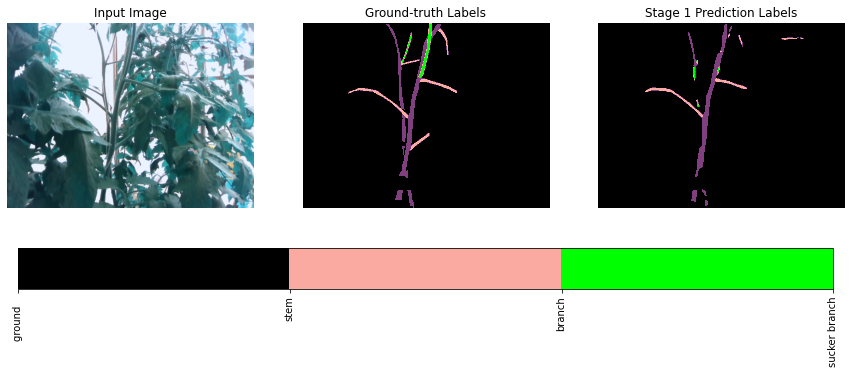

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0143 mPA: 99.42% FPS: 814.6 Lr: 0.0003205178 sucker: 0.0000 IOU1: 0.8959: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [20/40] Loss: 0.2439 mPA: 97.82% FPS: 917.0 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 17.8   IOU1: 0.6375 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1660 FPS: 125.4 IOU: 0.5293


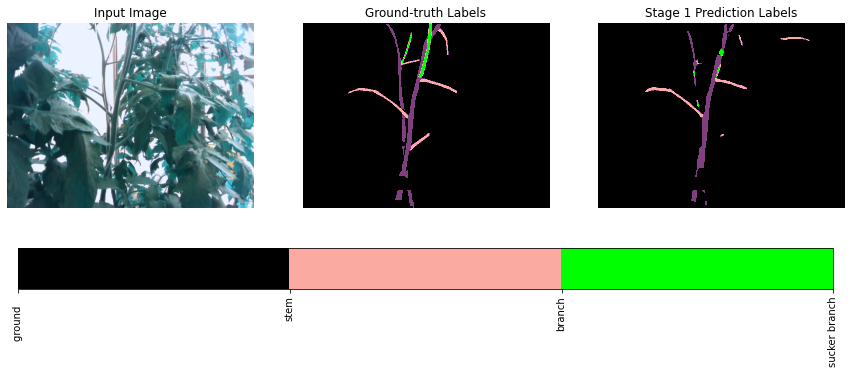

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0143 mPA: 99.42% FPS: 815.5 Lr: 0.0002906510 sucker: 0.0000 IOU1: 0.8965: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [21/40] Loss: 0.2392 mPA: 97.79% FPS: 870.8 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 18.8   IOU1: 0.6340 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1632 FPS: 117.5 IOU: 0.5196


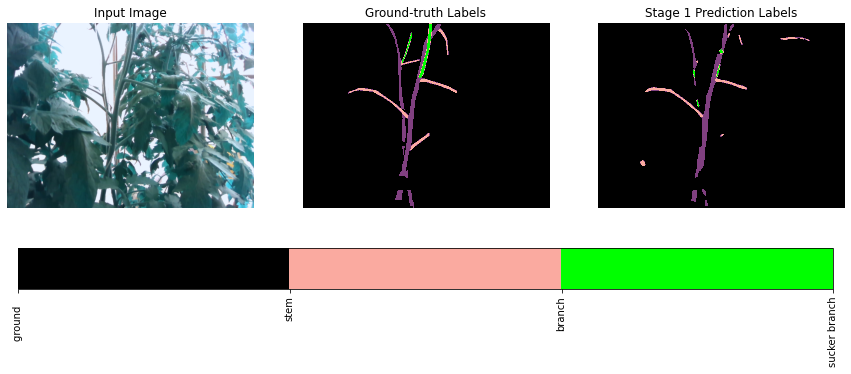

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0140 mPA: 99.43% FPS: 802.4 Lr: 0.0002635672 sucker: 0.0000 IOU1: 0.8980: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [22/40] Loss: 0.2543 mPA: 97.83% FPS: 930.5 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 19.8   IOU1: 0.6364 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1728 FPS: 134.3 IOU: 0.5168


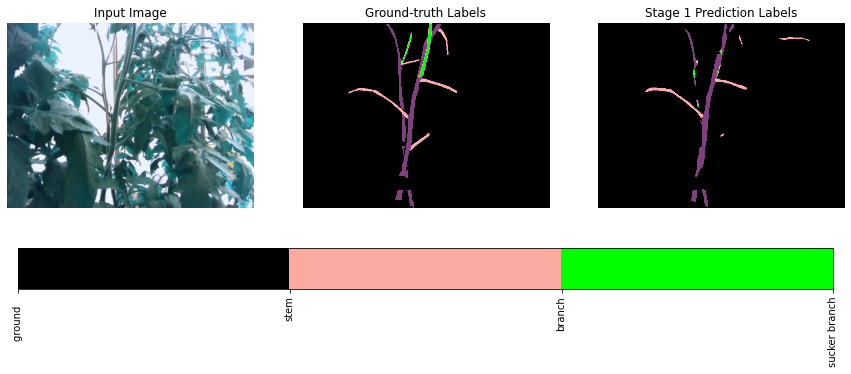

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0137 mPA: 99.45% FPS: 752.3 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.9003: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [23/40] Loss: 0.2559 mPA: 97.82% FPS: 881.3 Lr: 0.0000000000 sucker_t: 74.3 sucker_f: 19.1   IOU1: 0.6357 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1731 FPS: 129.1 IOU: 0.5117


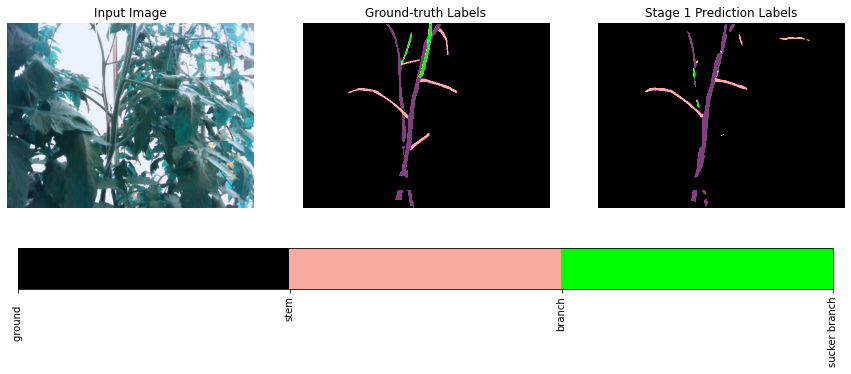

best val iou tensor(0.6451, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0135 mPA: 99.45% FPS: 766.7 Lr: 0.0002344614 sucker: 0.0000 IOU1: 0.8970:  20%|█▉        | 64/326 [00:41<02:49,  1.54it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(11)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_2_tomato_11.pth...


idx: 82
Val Loss: 0.2707 FPS: 132.1 IOU: 0.4391


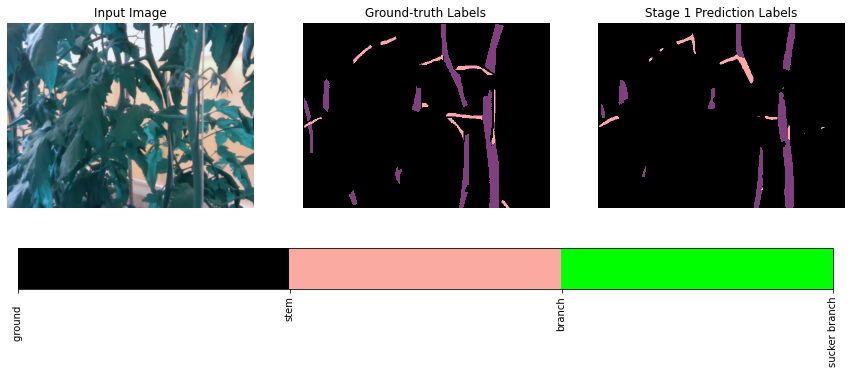

idx: 169
Val Loss: 0.1475 FPS: 117.6 IOU: 0.5491


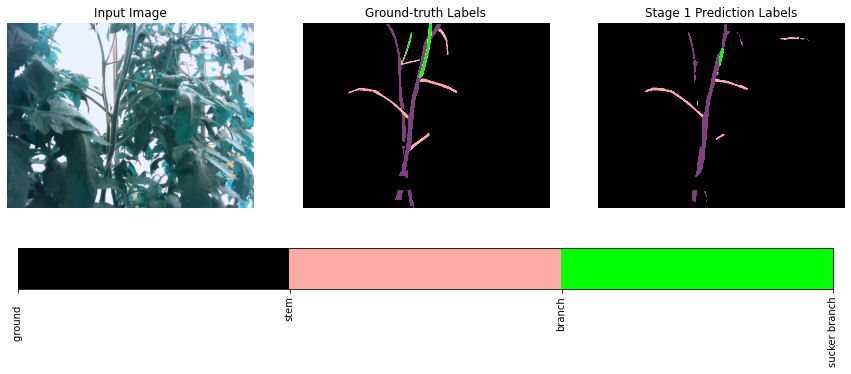

idx: 167
Val Loss: 0.1288 FPS: 129.6 IOU: 0.5977


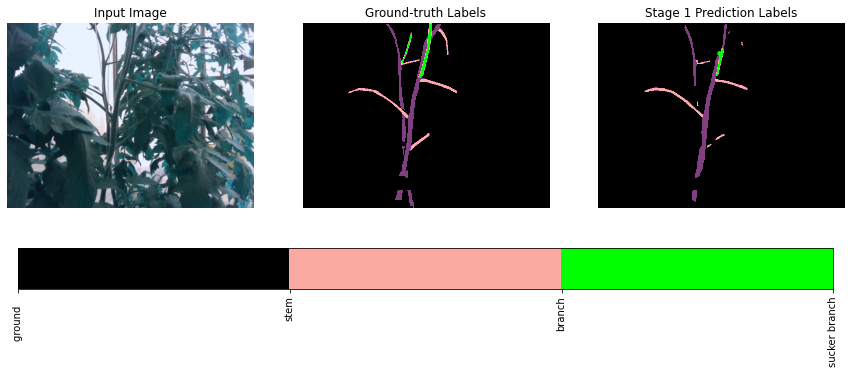

idx: 199
Val Loss: 0.1408 FPS: 116.7 IOU: 0.7262


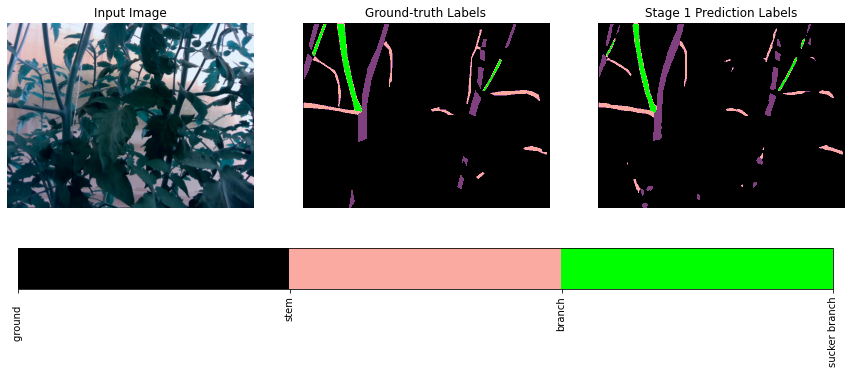

idx: 254
Val Loss: 0.0749 FPS: 129.8 IOU: 0.5950


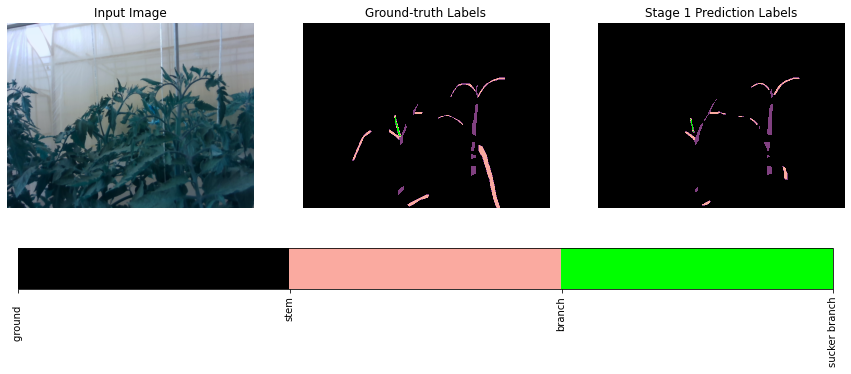

129.75017014168162

In [ ]:
trainer.random_val_predict(idx=82)
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

Test DLightnet with different rate to get hard region


In [ ]:
class DLightNet_depth_4(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=16, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=12, stride=1)
        self.conv1_3 = ConvBlock(in_channels=1, out_channels=4, stride=1)
        #  self.conv1_1 = ConvBlock(in_channels=3, out_channels=12, stride=1)
        # self.conv1_2 = ConvBlock(in_channels=3, out_channels=16, stride=1)
        # self.conv1_3 = ConvBlock(in_channels=1, out_channels=4, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)

    def forward(self, x):
        input = x[:,0:3,:,:]
        depth = x[:,3,:,:].unsqueeze(1)
      #  print('x1')
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
     #   print('x1')
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
     #   print('x1')
        x = self.s1_conv_final(x)
        x_f1 = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
       
       
        with torch.no_grad():
            x1 = self.s1_softmax(x_f1).detach()
            input1,depth1 = remove_easypixel(x1,input,depth,0.7,0.1)
          
        
    #    print('b1')
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2_3 =  self.conv1_3(depth1)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 = torch.cat((xs2,xs2_3),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
    #    print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2
trainer = Trainner( DLightNet_depth_4,'DLightNet_depth_4',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.load_weight(save_path='/content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_4.pth')
#trainer.load_epoch(11)
trainer.train()

Train Epoch: [0/40] Loss: 0.0485 mPA: 98.24% FPS: 648.2 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.7069: 100%|██████████| 326/326 [08:29<00:00,  1.56s/it]


best_val


Train Epoch: [0/40] Loss: 0.1465 mPA: 97.77% FPS: 794.9 Lr: 0.0000000000 sucker_t: 70.9 sucker_f: 19.3   IOU1: 0.6173 : 100%|██████████| 41/41 [01:48<00:00,  2.65s/it]


idx: 169
Val Loss: 0.0834 FPS: 62.2 IOU: 0.5249


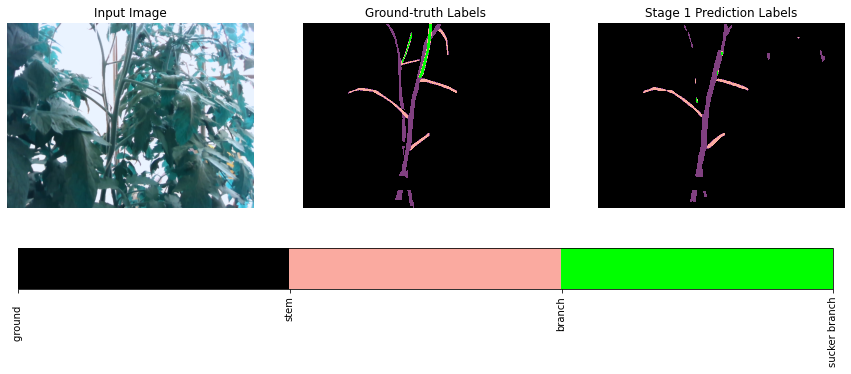

best val iou tensor(0.6173, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0393 mPA: 98.53% FPS: 617.7 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.7511: 100%|██████████| 326/326 [03:24<00:00,  1.60it/s]


best_val


Train Epoch: [1/40] Loss: 0.1548 mPA: 97.70% FPS: 674.7 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 31.1   IOU1: 0.6156 : 100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


idx: 169
Val Loss: 0.0806 FPS: 87.7 IOU: 0.6443


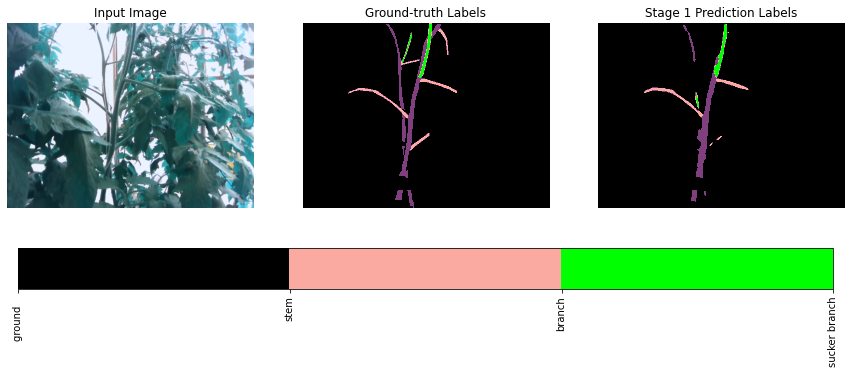

best val iou tensor(0.6173, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0350 mPA: 98.67% FPS: 613.6 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.7756: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [2/40] Loss: 0.1522 mPA: 97.75% FPS: 661.9 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 23.7   IOU1: 0.6223 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.0829 FPS: 92.3 IOU: 0.6236


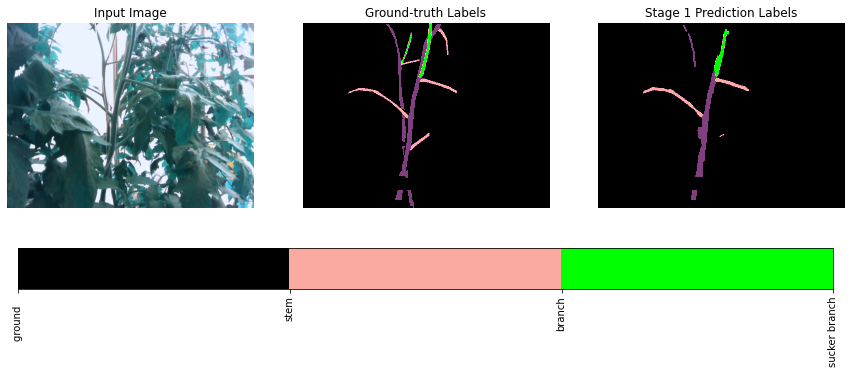

best val iou tensor(0.6223, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0316 mPA: 98.78% FPS: 613.9 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.7940: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [3/40] Loss: 0.1440 mPA: 97.75% FPS: 656.9 Lr: 0.0000000000 sucker_t: 82.6 sucker_f: 23.7   IOU1: 0.6404 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.0738 FPS: 94.0 IOU: 0.6329


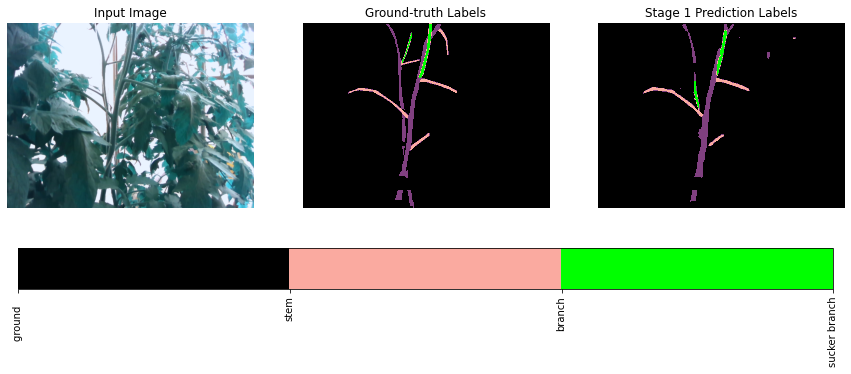

best val iou tensor(0.6404, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0303 mPA: 98.83% FPS: 613.5 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.7981: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [4/40] Loss: 0.1552 mPA: 97.82% FPS: 668.6 Lr: 0.0000000000 sucker_t: 82.0 sucker_f: 26.2   IOU1: 0.6353 : 100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


idx: 169
Val Loss: 0.0817 FPS: 92.3 IOU: 0.6105


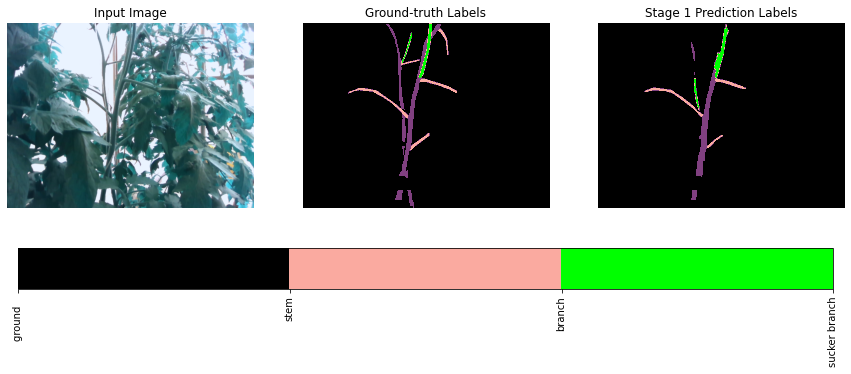

best val iou tensor(0.6404, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0275 mPA: 98.93% FPS: 615.5 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.8174: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [5/40] Loss: 0.1579 mPA: 97.91% FPS: 649.2 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 16.0   IOU1: 0.6397 : 100%|██████████| 41/41 [00:17<00:00,  2.31it/s]


idx: 169
Val Loss: 0.0871 FPS: 95.6 IOU: 0.6104


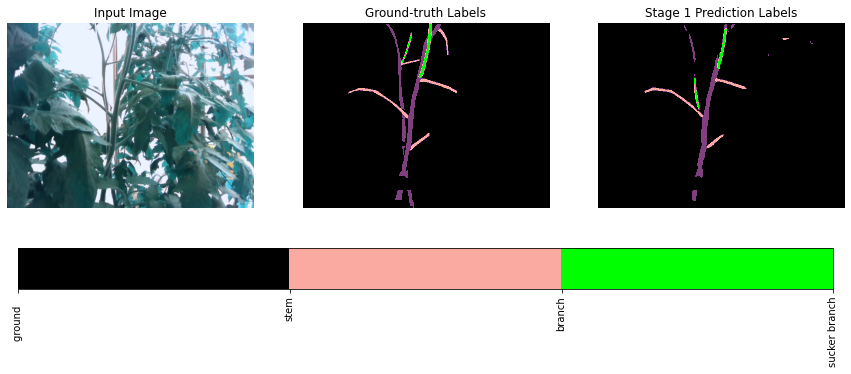

best val iou tensor(0.6404, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0254 mPA: 99.00% FPS: 613.2 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.8289: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [6/40] Loss: 0.1636 mPA: 97.84% FPS: 669.2 Lr: 0.0000000000 sucker_t: 80.7 sucker_f: 18.0   IOU1: 0.6466 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.0901 FPS: 91.2 IOU: 0.6172


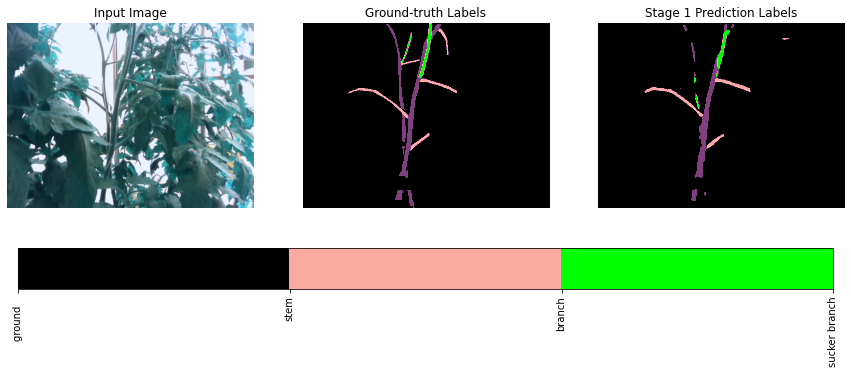

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0241 mPA: 99.05% FPS: 614.1 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.8358: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [7/40] Loss: 0.1763 mPA: 97.89% FPS: 666.6 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 14.3   IOU1: 0.6394 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1191 FPS: 81.4 IOU: 0.5914


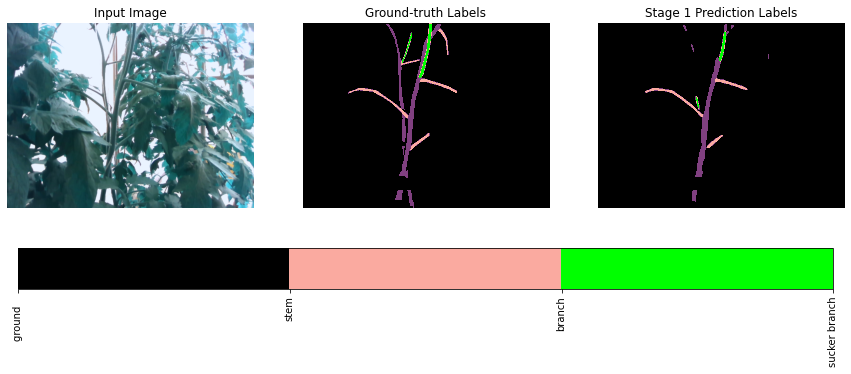

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0227 mPA: 99.10% FPS: 616.0 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8442: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [8/40] Loss: 0.1742 mPA: 97.84% FPS: 662.7 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 16.6   IOU1: 0.6457 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1118 FPS: 91.2 IOU: 0.6197


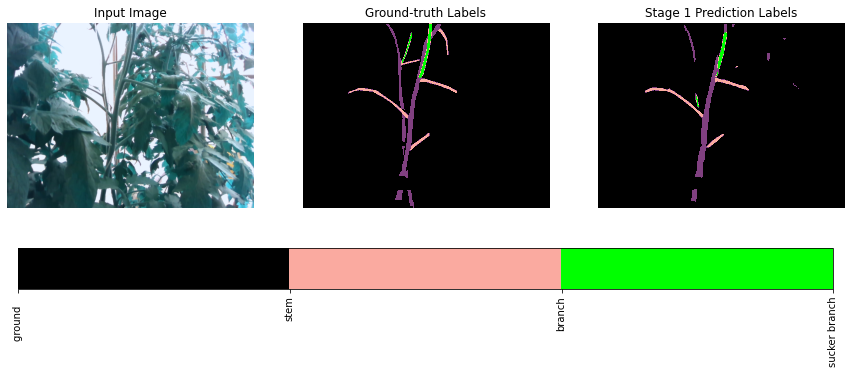

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0217 mPA: 99.14% FPS: 614.4 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8502: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [9/40] Loss: 0.1871 mPA: 97.85% FPS: 651.2 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 15.8   IOU1: 0.6380 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1260 FPS: 94.4 IOU: 0.5911


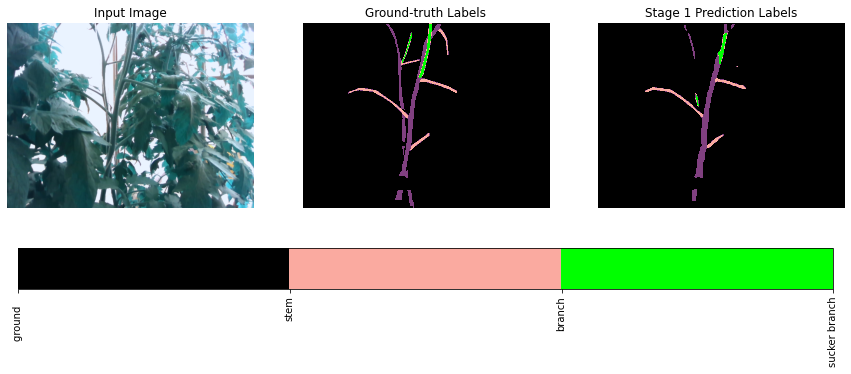

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0209 mPA: 99.17% FPS: 611.5 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8544: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [10/40] Loss: 0.1816 mPA: 97.84% FPS: 651.5 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 18.4   IOU1: 0.6443 : 100%|██████████| 41/41 [00:17<00:00,  2.31it/s]


idx: 169
Val Loss: 0.1219 FPS: 91.4 IOU: 0.5952


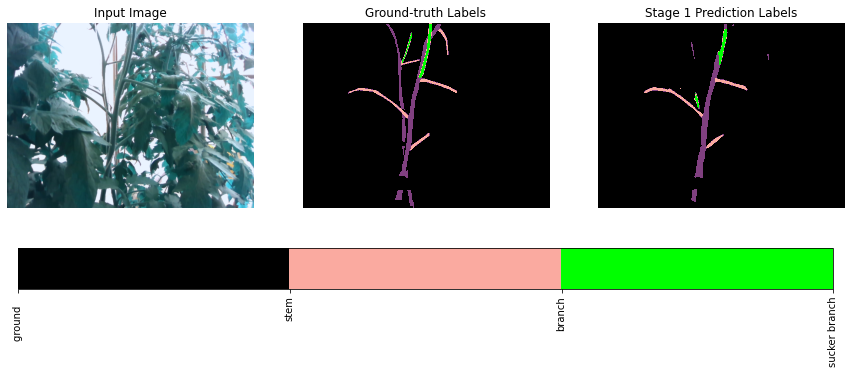

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0212 mPA: 99.16% FPS: 604.3 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8539: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [11/40] Loss: 0.1892 mPA: 97.83% FPS: 650.7 Lr: 0.0000000000 sucker_t: 74.8 sucker_f: 17.8   IOU1: 0.6350 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1194 FPS: 89.9 IOU: 0.6007


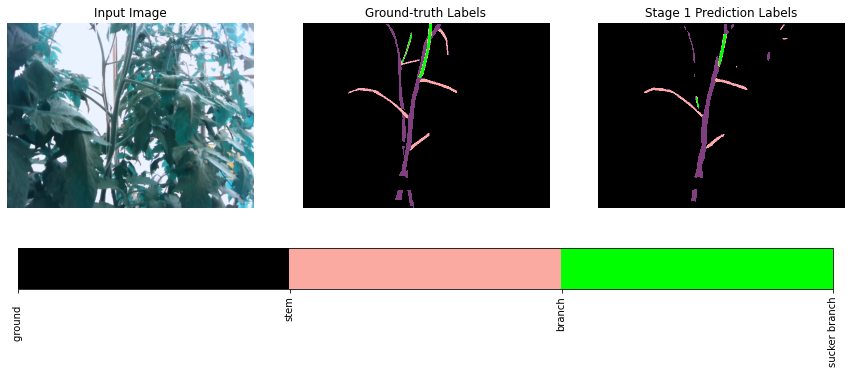

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0194 mPA: 99.22% FPS: 596.6 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8633: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [12/40] Loss: 0.2040 mPA: 97.82% FPS: 633.0 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 19.7   IOU1: 0.6398 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1209 FPS: 90.0 IOU: 0.6040


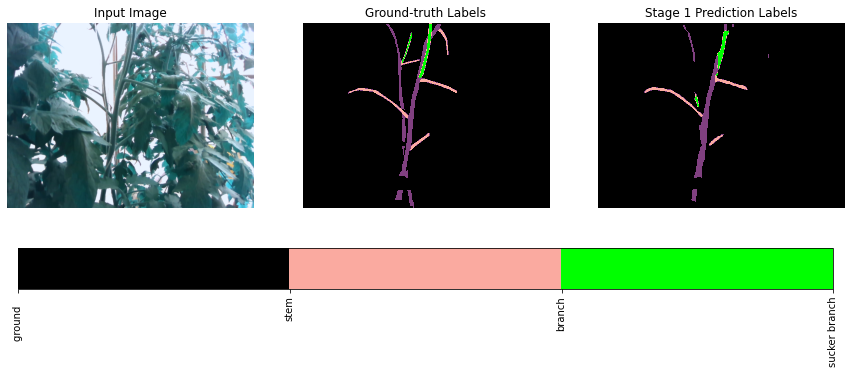

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0185 mPA: 99.26% FPS: 590.5 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8694: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [13/40] Loss: 0.1975 mPA: 97.84% FPS: 642.5 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 19.2   IOU1: 0.6428 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.1224 FPS: 85.4 IOU: 0.6250


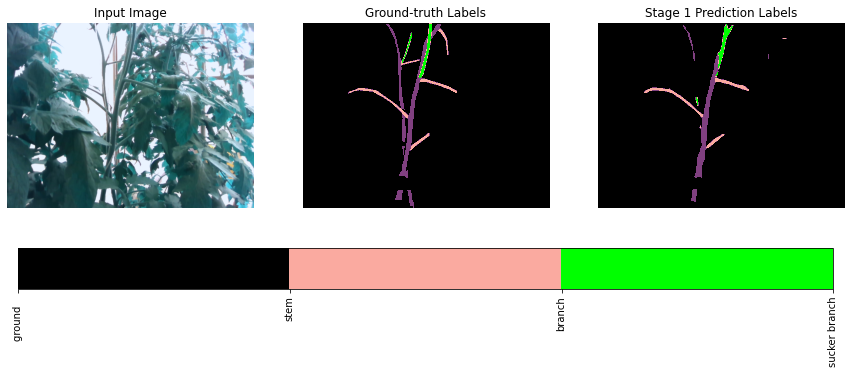

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0178 mPA: 99.28% FPS: 576.3 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8735: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [14/40] Loss: 0.2282 mPA: 97.84% FPS: 637.7 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 16.3   IOU1: 0.6335 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1543 FPS: 91.1 IOU: 0.6055


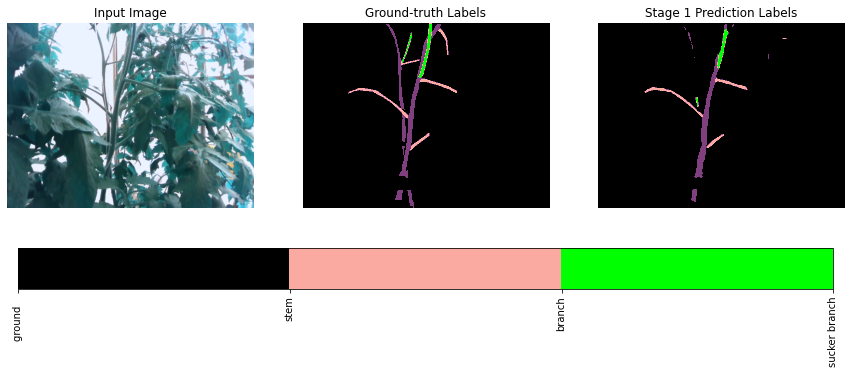

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0174 mPA: 99.30% FPS: 576.1 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8764: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [15/40] Loss: 0.2163 mPA: 97.81% FPS: 630.7 Lr: 0.0000000000 sucker_t: 75.0 sucker_f: 17.9   IOU1: 0.6384 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1485 FPS: 88.9 IOU: 0.6136


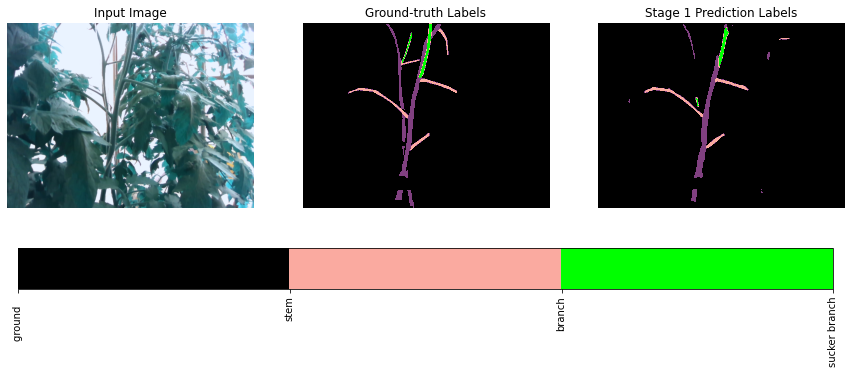

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0169 mPA: 99.32% FPS: 568.6 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8789: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [16/40] Loss: 0.2291 mPA: 97.83% FPS: 606.0 Lr: 0.0000000000 sucker_t: 76.3 sucker_f: 22.1   IOU1: 0.6339 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.1555 FPS: 93.3 IOU: 0.6058


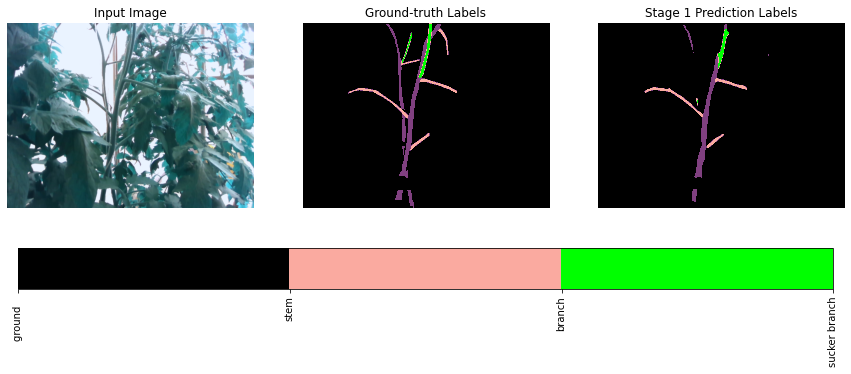

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0166 mPA: 99.33% FPS: 571.4 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8813: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [17/40] Loss: 0.2094 mPA: 97.79% FPS: 652.9 Lr: 0.0000000000 sucker_t: 80.2 sucker_f: 17.7   IOU1: 0.6405 : 100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


idx: 169
Val Loss: 0.1342 FPS: 94.5 IOU: 0.6035


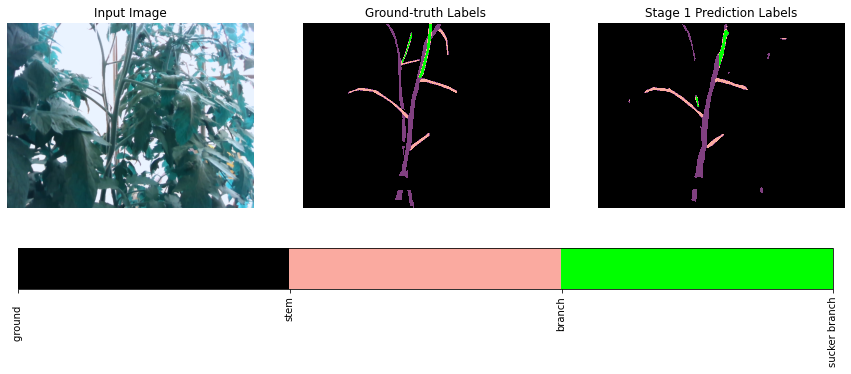

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0161 mPA: 99.35% FPS: 570.2 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8843: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [18/40] Loss: 0.2062 mPA: 97.81% FPS: 617.0 Lr: 0.0000000000 sucker_t: 80.6 sucker_f: 21.9   IOU1: 0.6410 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1438 FPS: 87.5 IOU: 0.6278


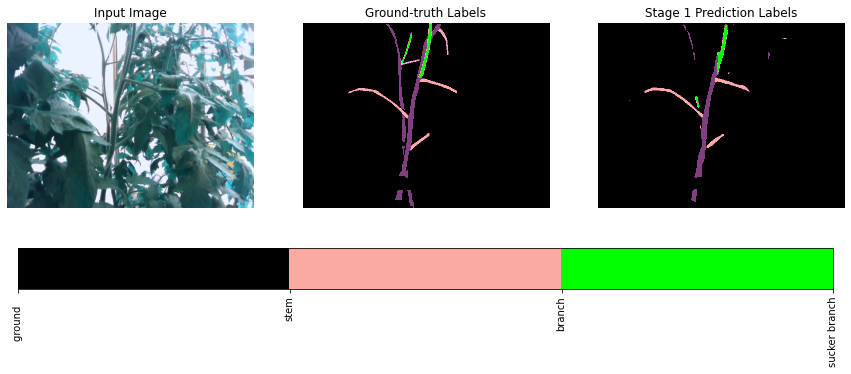

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0158 mPA: 99.36% FPS: 556.4 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8864: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [19/40] Loss: 0.2388 mPA: 97.82% FPS: 606.2 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 18.8   IOU1: 0.6367 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1673 FPS: 86.9 IOU: 0.6144


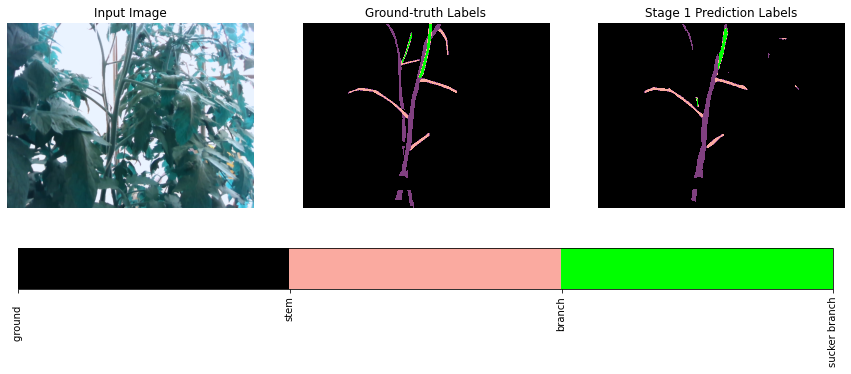

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0154 mPA: 99.38% FPS: 555.8 Lr: 0.0003205178 sucker: 0.0000 IOU1: 0.8886: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [20/40] Loss: 0.2263 mPA: 97.81% FPS: 615.6 Lr: 0.0000000000 sucker_t: 78.1 sucker_f: 19.3   IOU1: 0.6399 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1484 FPS: 84.9 IOU: 0.6049


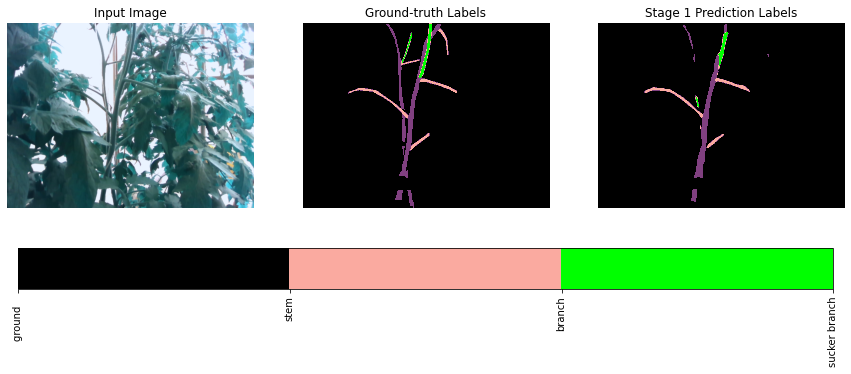

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0152 mPA: 99.39% FPS: 563.2 Lr: 0.0002906510 sucker: 0.0000 IOU1: 0.8903: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [21/40] Loss: 0.2339 mPA: 97.79% FPS: 616.8 Lr: 0.0000000000 sucker_t: 78.0 sucker_f: 18.9   IOU1: 0.6372 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1551 FPS: 85.8 IOU: 0.6071


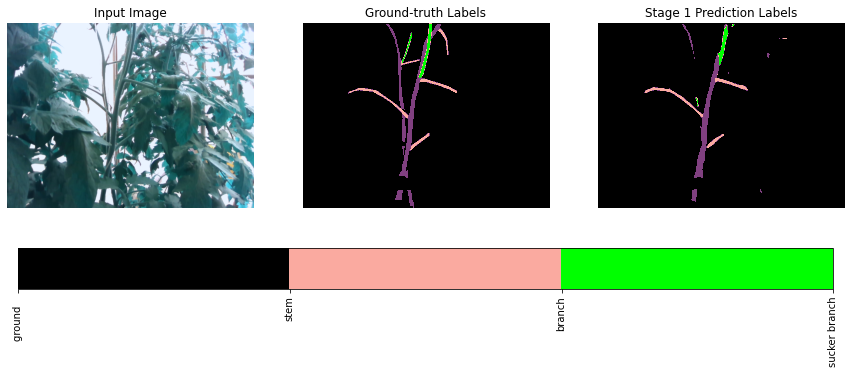

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0149 mPA: 99.40% FPS: 552.4 Lr: 0.0002635672 sucker: 0.0000 IOU1: 0.8924: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [22/40] Loss: 0.2424 mPA: 97.81% FPS: 612.2 Lr: 0.0000000000 sucker_t: 77.0 sucker_f: 19.4   IOU1: 0.6359 : 100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


idx: 169
Val Loss: 0.1660 FPS: 86.7 IOU: 0.6002


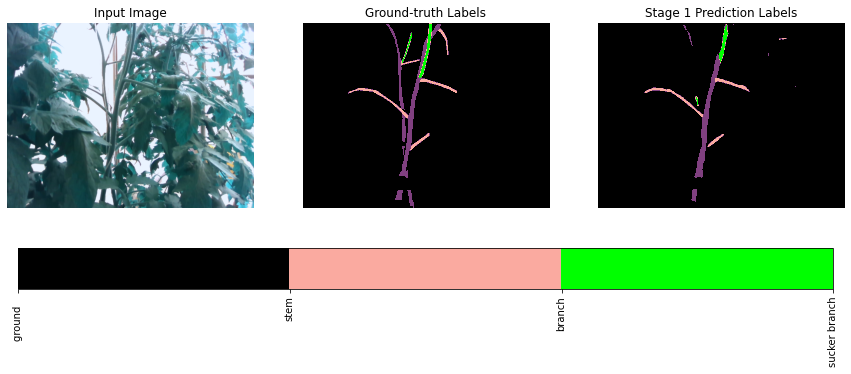

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0147 mPA: 99.41% FPS: 547.4 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.8935: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [23/40] Loss: 0.2447 mPA: 97.79% FPS: 607.4 Lr: 0.0000000000 sucker_t: 77.0 sucker_f: 18.2   IOU1: 0.6359 : 100%|██████████| 41/41 [00:18<00:00,  2.22it/s]


idx: 169
Val Loss: 0.1616 FPS: 89.7 IOU: 0.5900


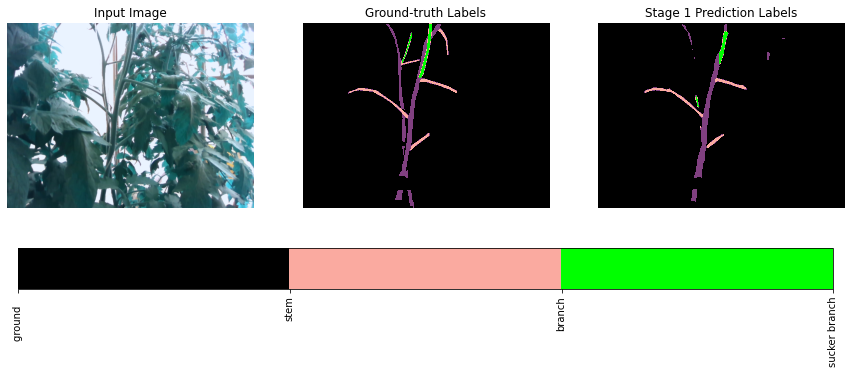

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0146 mPA: 99.41% FPS: 543.8 Lr: 0.0002167358 sucker: 0.0000 IOU1: 0.8941: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [24/40] Loss: 0.2532 mPA: 97.79% FPS: 597.6 Lr: 0.0000000000 sucker_t: 76.7 sucker_f: 17.3   IOU1: 0.6360 : 100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


idx: 169
Val Loss: 0.1764 FPS: 86.2 IOU: 0.6010


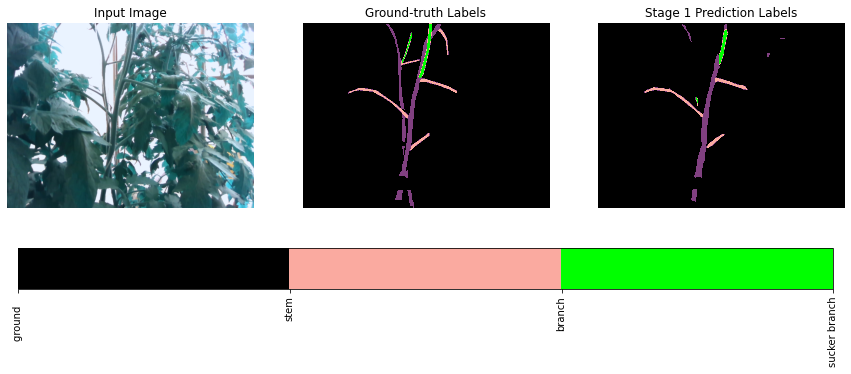

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [25/40] Loss: 0.0143 mPA: 99.42% FPS: 552.9 Lr: 0.0001965397 sucker: 0.0000 IOU1: 0.8961: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [25/40] Loss: 0.2507 mPA: 97.79% FPS: 622.8 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 19.9   IOU1: 0.6373 : 100%|██████████| 41/41 [00:17<00:00,  2.28it/s]


idx: 169
Val Loss: 0.1636 FPS: 86.0 IOU: 0.6014


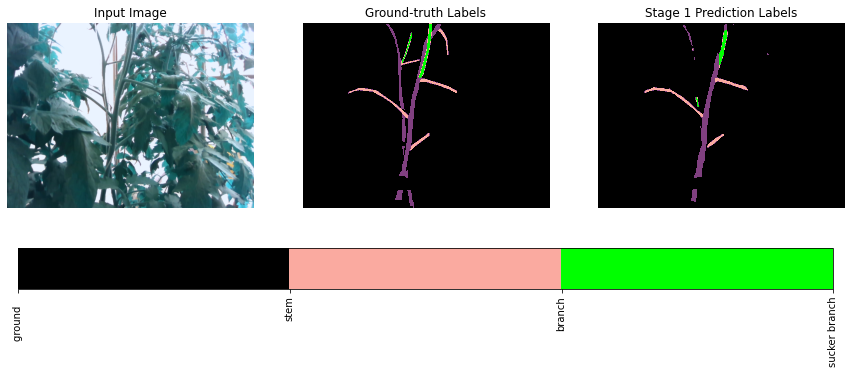

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [26/40] Loss: 0.0141 mPA: 99.43% FPS: 548.7 Lr: 0.0001782255 sucker: 0.0000 IOU1: 0.8973: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [26/40] Loss: 0.2503 mPA: 97.80% FPS: 615.5 Lr: 0.0000000000 sucker_t: 77.0 sucker_f: 18.5   IOU1: 0.6336 : 100%|██████████| 41/41 [00:18<00:00,  2.23it/s]


idx: 169
Val Loss: 0.1744 FPS: 91.7 IOU: 0.5983


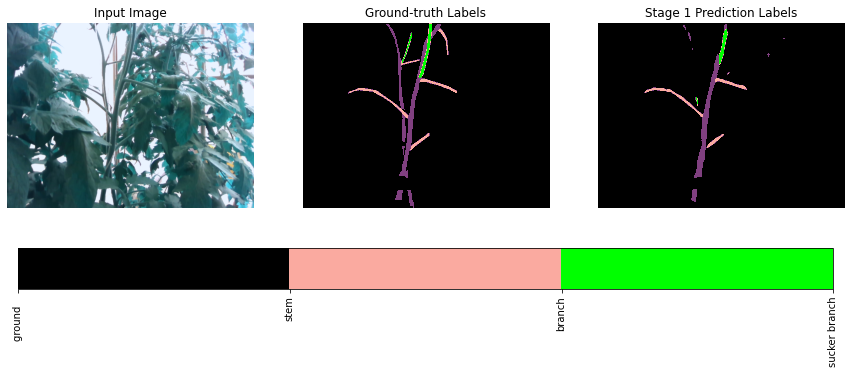

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [27/40] Loss: 0.0140 mPA: 99.44% FPS: 549.5 Lr: 0.0001616179 sucker: 0.0000 IOU1: 0.8982: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [27/40] Loss: 0.2574 mPA: 97.80% FPS: 639.6 Lr: 0.0000000000 sucker_t: 77.0 sucker_f: 18.1   IOU1: 0.6352 : 100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


idx: 169
Val Loss: 0.1749 FPS: 88.2 IOU: 0.6075


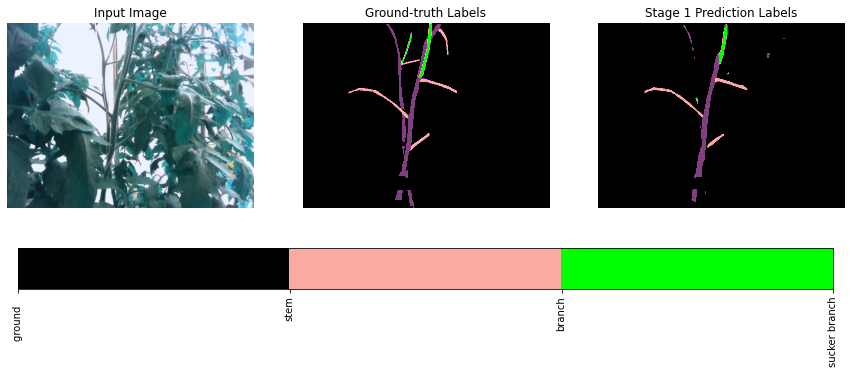

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [28/40] Loss: 0.0138 mPA: 99.44% FPS: 552.0 Lr: 0.0001465579 sucker: 0.0000 IOU1: 0.8991: 100%|██████████| 326/326 [03:26<00:00,  1.58it/s]


best_val


Train Epoch: [28/40] Loss: 0.2596 mPA: 97.78% FPS: 626.8 Lr: 0.0000000000 sucker_t: 75.9 sucker_f: 17.4   IOU1: 0.6330 : 100%|██████████| 41/41 [00:17<00:00,  2.29it/s]


idx: 169
Val Loss: 0.1911 FPS: 91.0 IOU: 0.5935


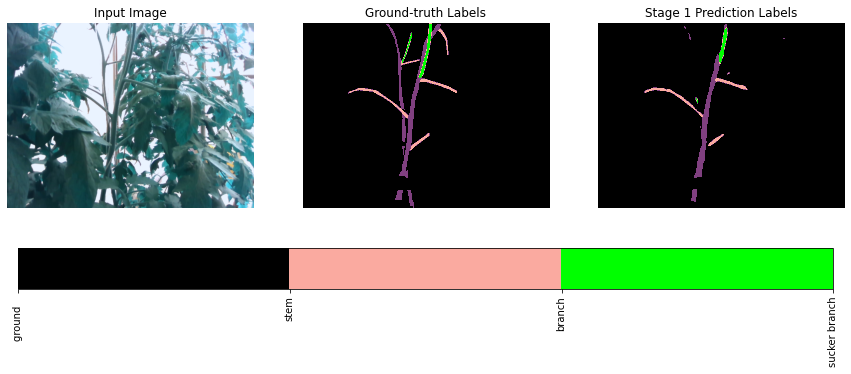

best val iou tensor(0.6466, device='cuda:0')


Train Epoch: [29/40] Loss: 0.0137 mPA: 99.44% FPS: 491.5 Lr: 0.0001458998 sucker: 0.0000 IOU1: 0.9020:   5%|▍         | 15/326 [00:11<03:49,  1.36it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train() #Train Epoch: [8/40] Loss: 0.1742 mPA: 97.84% FPS: 662.7 Lr: 0.0000000000 sucker_t: 78.5 sucker_f: 16.6   IOU1: 0.6457 :
#och: [13/40] Loss: 0.1975 mPA: 97.84% FPS: 642.5 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 19.2   IOU1: 0.6428 
#[17/40] Loss: 0.2094 mPA: 97.79% FPS: 652.9 Lr: 0.0000000000 sucker_t: 80.2 sucker_f: 17.7   IOU1: 0.6405 :
#[6/40] Loss: 0.1636 mPA: 97.84% FPS: 669.2 Lr: 0.0000000000 sucker_t: 80.7 sucker_f: 18.0   IOU1: 0.6466 

In [ ]:
trainer.load_epoch(8)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_4_tomato_8.pth...


idx: 169
Val Loss: 0.1116 FPS: 76.6 IOU: 0.6176


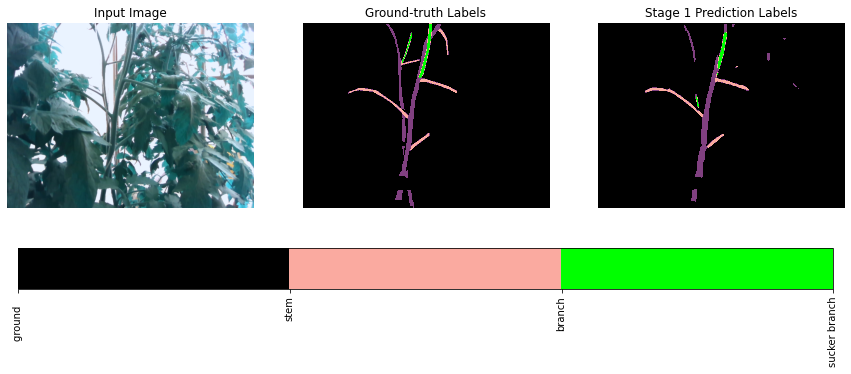

idx: 168
Val Loss: 0.1070 FPS: 83.4 IOU: 0.6352


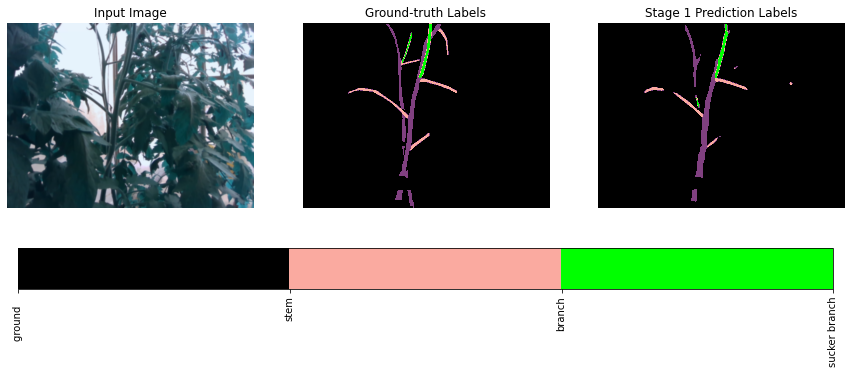

idx: 167
Val Loss: 0.0981 FPS: 85.0 IOU: 0.6399


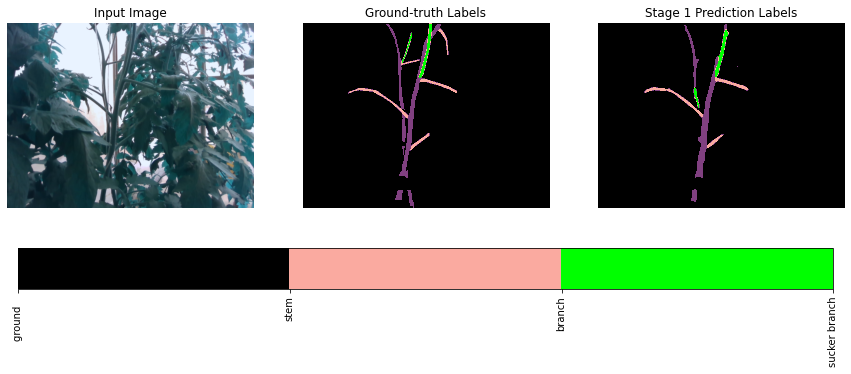

idx: 165
Val Loss: 0.1341 FPS: 83.7 IOU: 0.5501


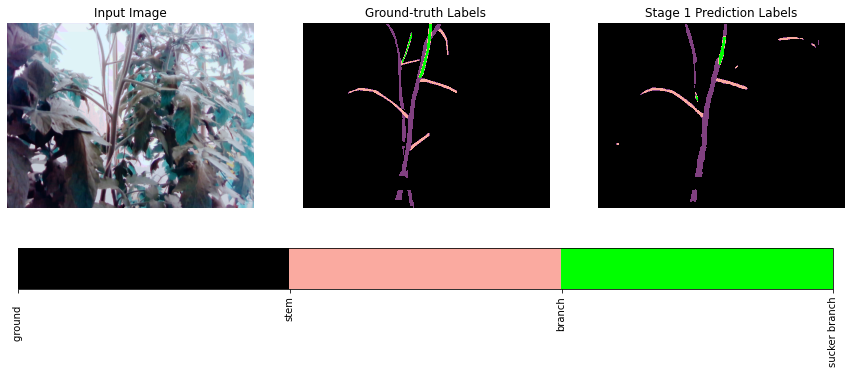

idx: 199
Val Loss: 0.1102 FPS: 87.3 IOU: 0.7353


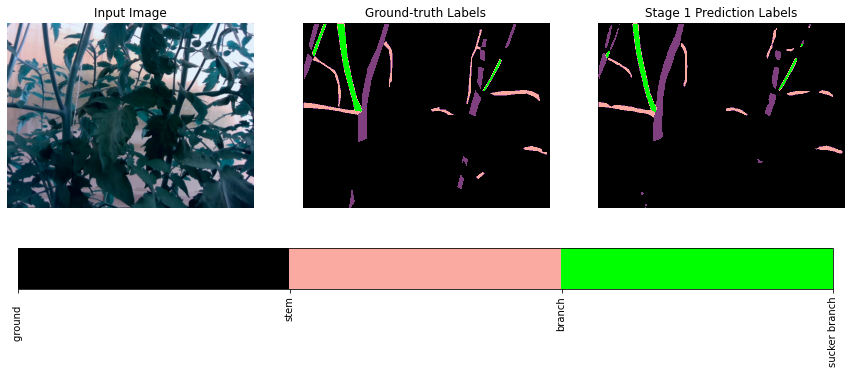

idx: 254
Val Loss: 0.0543 FPS: 88.5 IOU: 0.6781


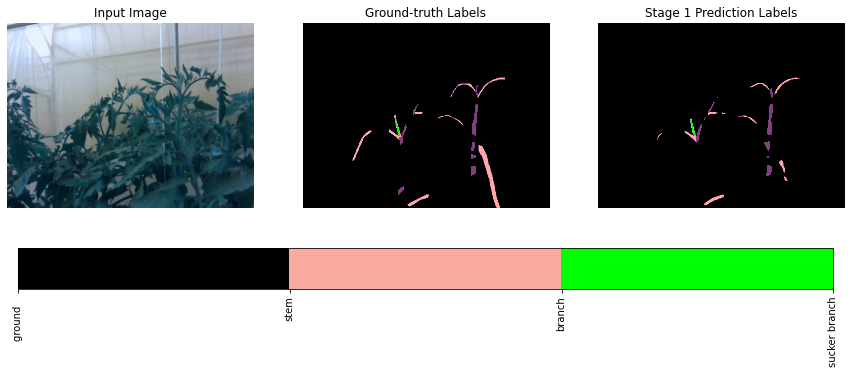

88.54533555700986

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=168)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=165)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.load_epoch(13)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_4_tomato_13.pth...


idx: 169
Val Loss: 0.1229 FPS: 82.4 IOU: 0.6253


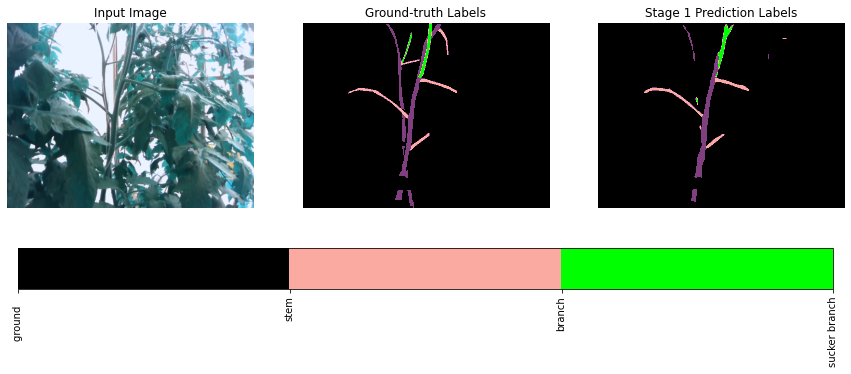

idx: 168
Val Loss: 0.1207 FPS: 86.6 IOU: 0.6298


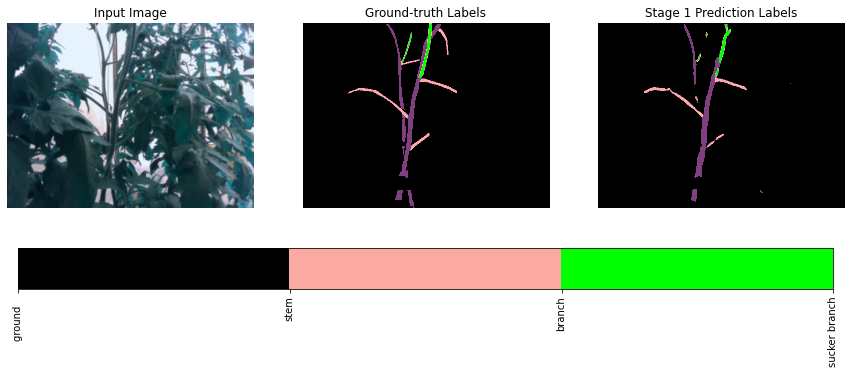

idx: 167
Val Loss: 0.1161 FPS: 67.9 IOU: 0.6538


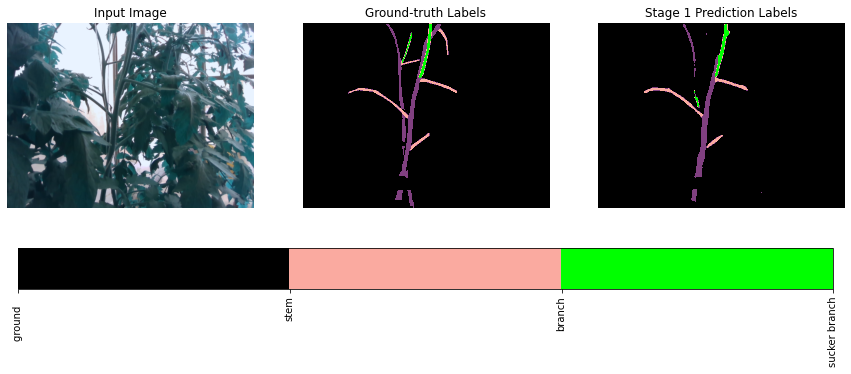

idx: 165
Val Loss: 0.1344 FPS: 92.3 IOU: 0.5475


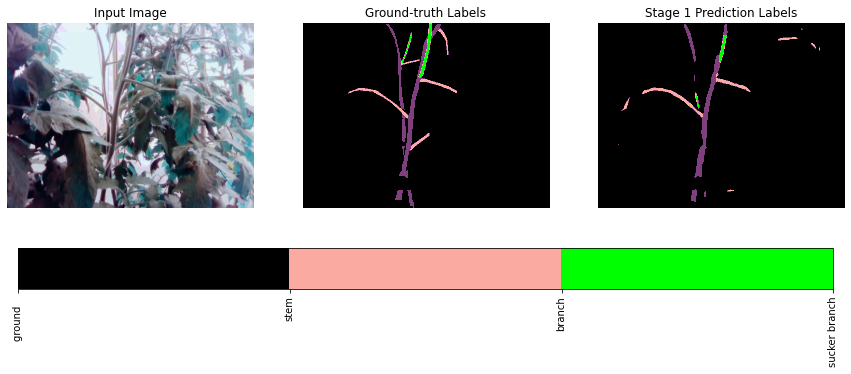

idx: 199
Val Loss: 0.1305 FPS: 79.6 IOU: 0.7441


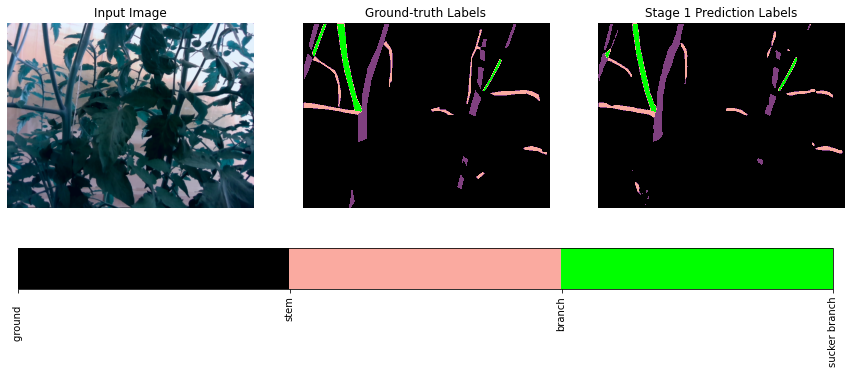

idx: 254
Val Loss: 0.0578 FPS: 84.8 IOU: 0.6827


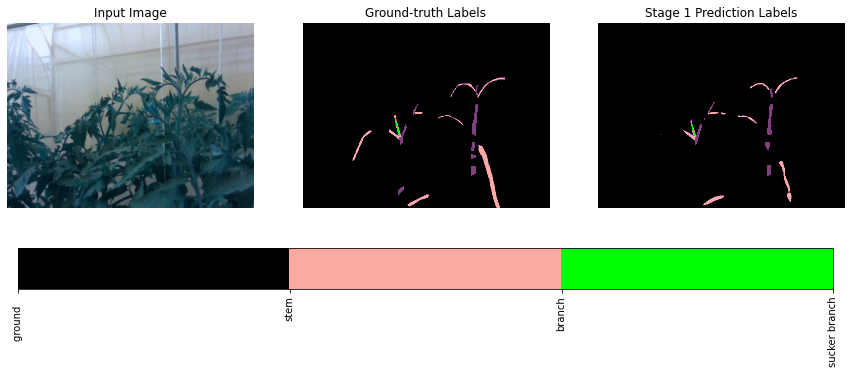

84.77451693750506

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=168)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=165)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.load_epoch(17)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_4_tomato_17.pth...


idx: 169
Val Loss: 0.1338 FPS: 82.8 IOU: 0.6059


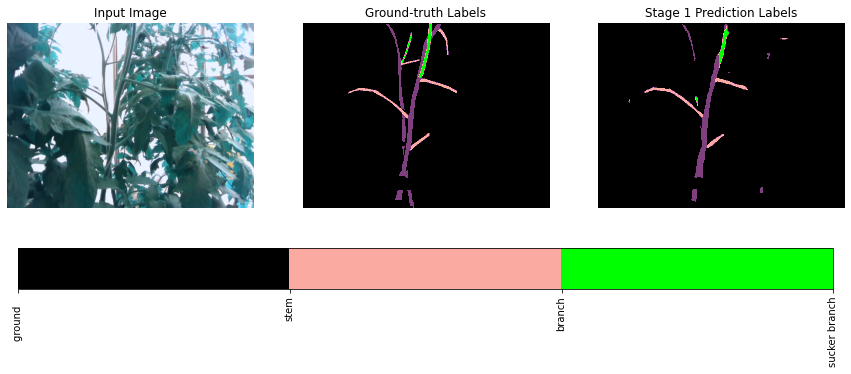

idx: 168
Val Loss: 0.1353 FPS: 87.6 IOU: 0.6043


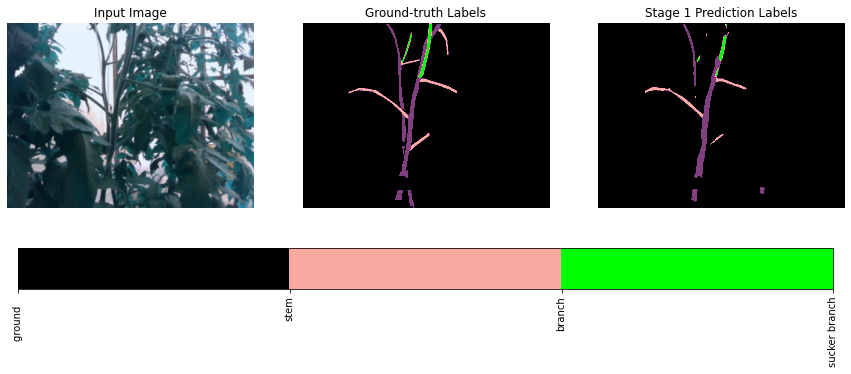

idx: 167
Val Loss: 0.1243 FPS: 91.1 IOU: 0.6310


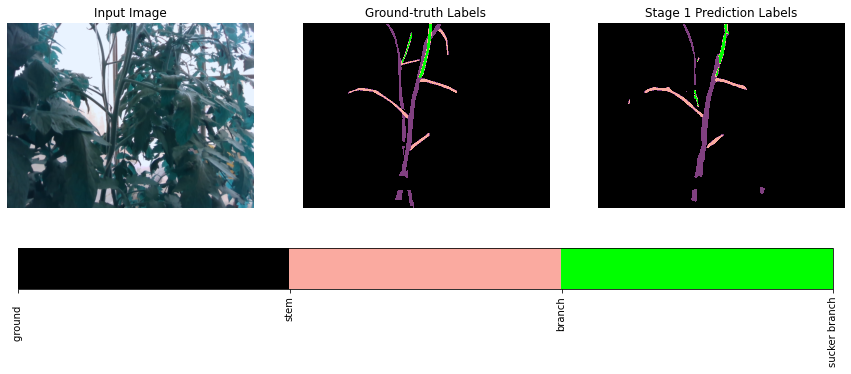

idx: 165
Val Loss: 0.1430 FPS: 87.7 IOU: 0.5349


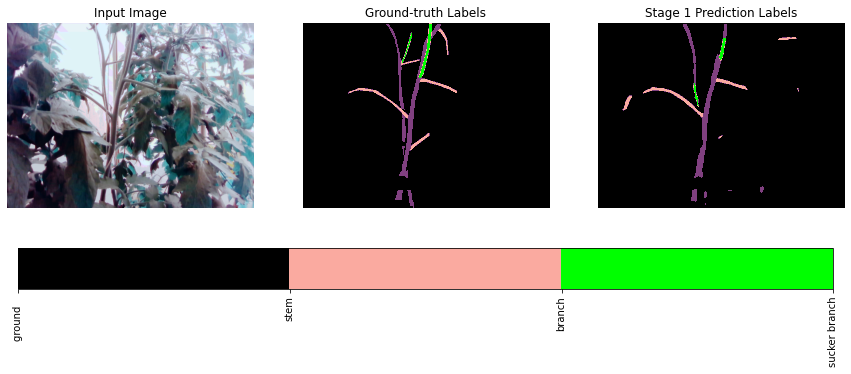

idx: 199
Val Loss: 0.1396 FPS: 83.6 IOU: 0.7495


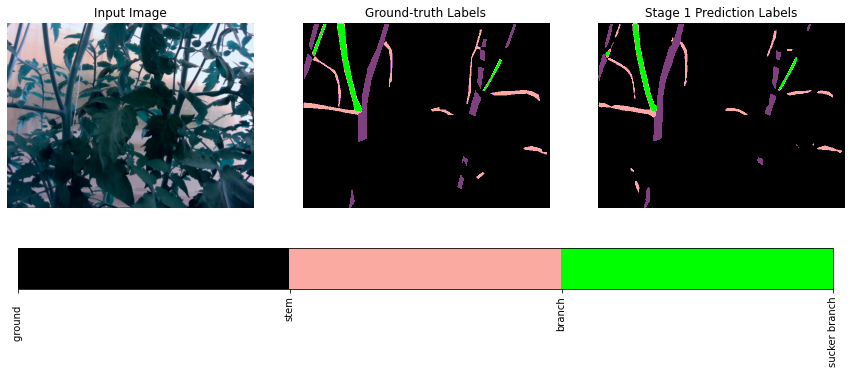

idx: 254
Val Loss: 0.0464 FPS: 85.2 IOU: 0.6958


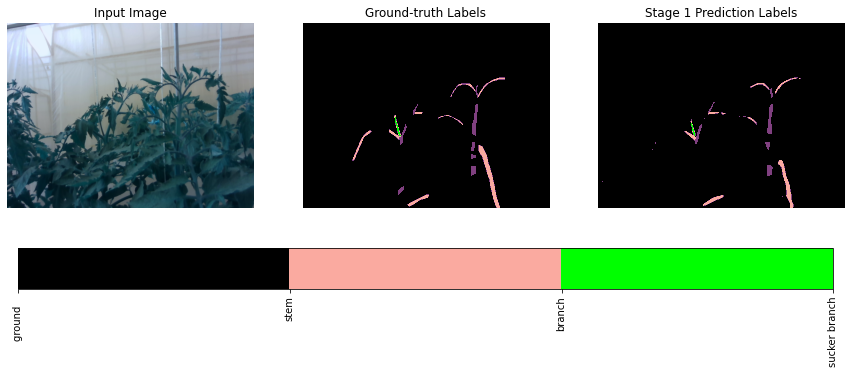

85.2119783836496

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=168)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=165)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.load_epoch(6)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_4_tomato_6.pth...


idx: 169
Val Loss: 0.0903 FPS: 82.0 IOU: 0.6173


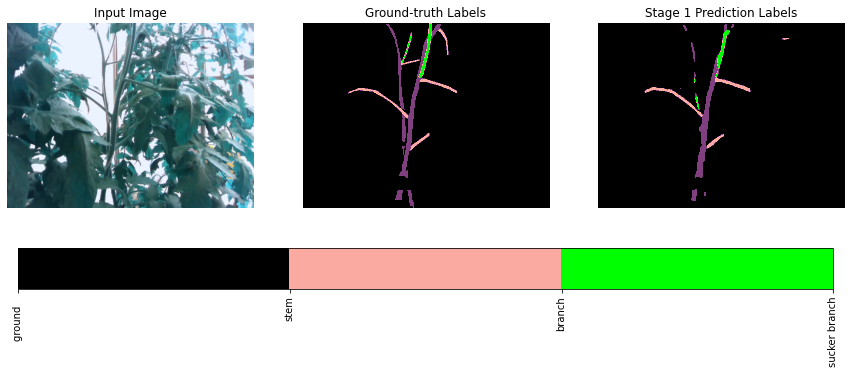

idx: 168
Val Loss: 0.0906 FPS: 87.5 IOU: 0.6342


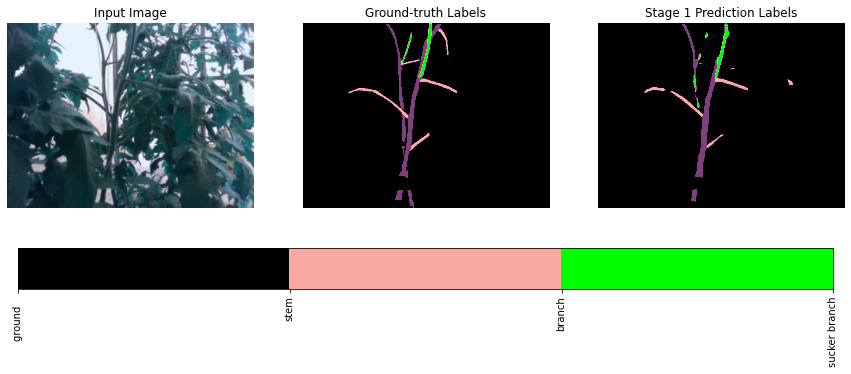

idx: 167
Val Loss: 0.0865 FPS: 76.4 IOU: 0.6325


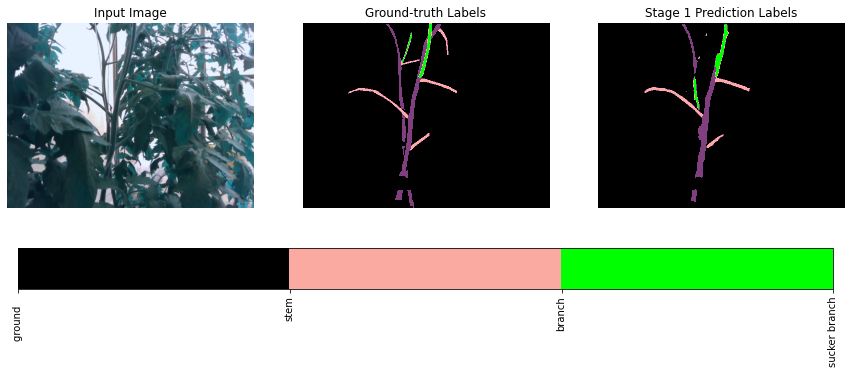

idx: 165
Val Loss: 0.1142 FPS: 87.7 IOU: 0.5652


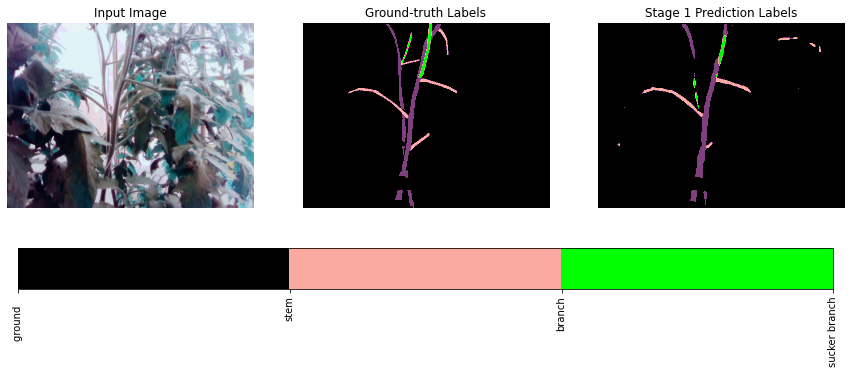

idx: 199
Val Loss: 0.0984 FPS: 88.1 IOU: 0.7374


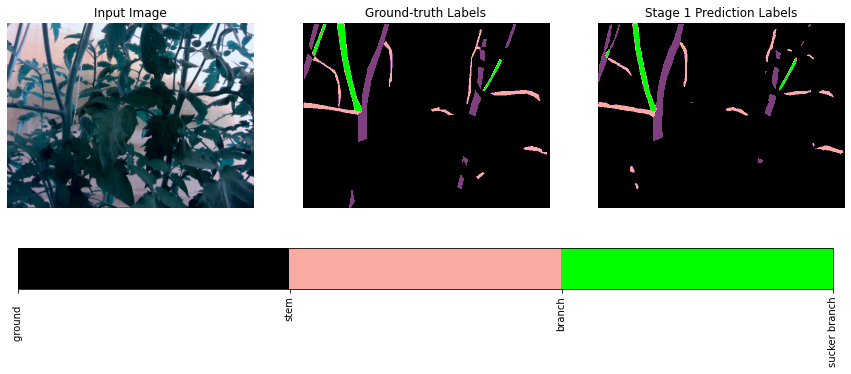

idx: 254
Val Loss: 0.0747 FPS: 88.1 IOU: 0.6448


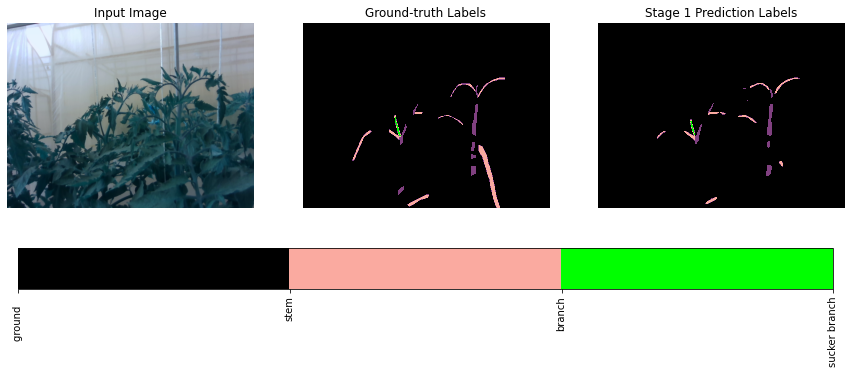

88.07122459264237

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=168)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=165)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

**DLightnet3**

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_depth_4_tomato_13.pth...


In [ ]:
class DLightNet_depth_3(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=20, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=9, stride=1)
        self.conv1_3 = ConvBlock(in_channels=1, out_channels=3, stride=1)
        #  self.conv1_1 = ConvBlock(in_channels=3, out_channels=12, stride=1)
        # self.conv1_2 = ConvBlock(in_channels=3, out_channels=16, stride=1)
        # self.conv1_3 = ConvBlock(in_channels=1, out_channels=4, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)

    def forward(self, x):
        input = x[:,0:3,:,:]
        depth = x[:,3,:,:].unsqueeze(1)
      #  print('x1')
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
     #   print('x1')
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
     #   print('x1')
        x = self.s1_conv_final(x)
        x_f1 = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
       
       
        with torch.no_grad():
            x1 = self.s1_softmax(x_f1).detach()
            input1,depth1 = remove_easypixel(x1,input,depth,0.75,0.1)
          
        
    #    print('b1')
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2_3 =  self.conv1_3(depth1)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 = torch.cat((xs2,xs2_3),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
    #    print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2
trainer = Trainner( DLightNet_depth_3,'DLightNet_depth_3',12,isdepth=True,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.load_weight(save_path='/content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_4.pth')
#trainer.load_epoch(11)
trainer.train()

Train Epoch: [0/40] Loss: 0.0469 mPA: 98.29% FPS: 889.2 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.7138: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [0/40] Loss: 0.1451 mPA: 97.67% FPS: 949.3 Lr: 0.0000000000 sucker_t: 79.8 sucker_f: 23.4   IOU1: 0.6221 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.0851 FPS: 84.1 IOU: 0.6319


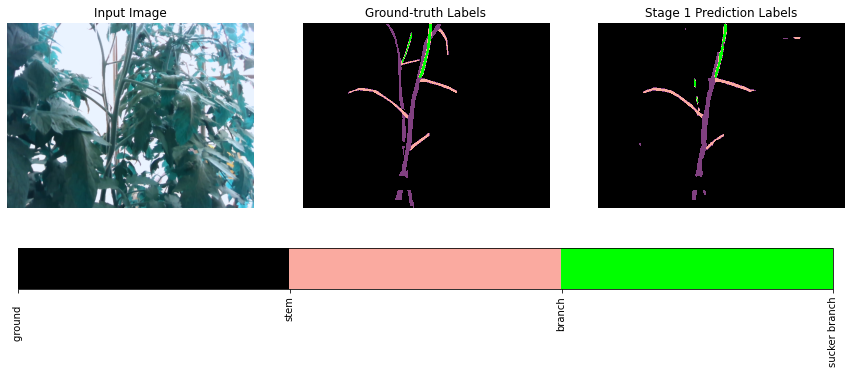

best val iou tensor(0.6221, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0388 mPA: 98.54% FPS: 886.4 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.7535: 100%|██████████| 326/326 [03:24<00:00,  1.60it/s]


best_val


Train Epoch: [1/40] Loss: 0.1505 mPA: 97.75% FPS: 950.3 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 14.3   IOU1: 0.6234 : 100%|██████████| 41/41 [00:16<00:00,  2.45it/s]


idx: 169
Val Loss: 0.0903 FPS: 127.2 IOU: 0.4882


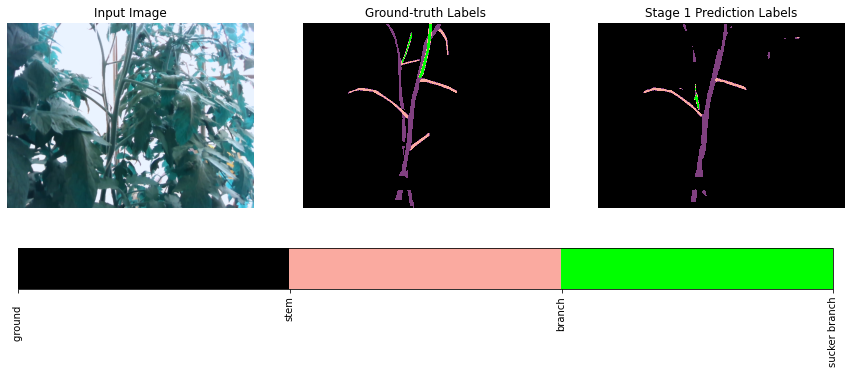

best val iou tensor(0.6234, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0347 mPA: 98.68% FPS: 887.1 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.7756: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [2/40] Loss: 0.1521 mPA: 97.53% FPS: 933.9 Lr: 0.0000000000 sucker_t: 75.6 sucker_f: 12.1   IOU1: 0.6107 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1045 FPS: 114.9 IOU: 0.4999


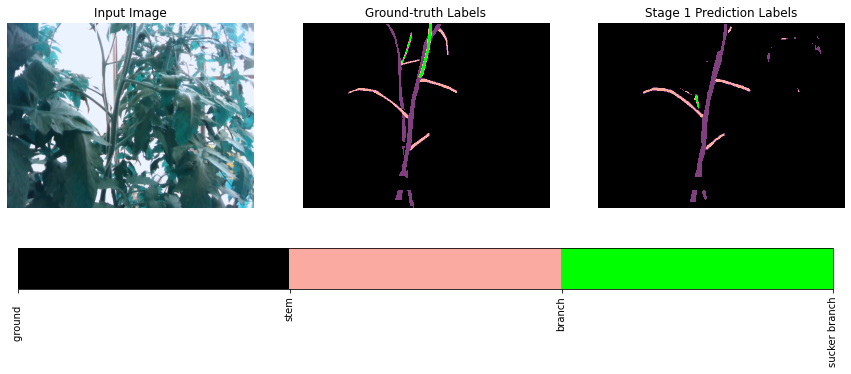

best val iou tensor(0.6234, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0326 mPA: 98.75% FPS: 873.7 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.7878: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [3/40] Loss: 0.1470 mPA: 97.69% FPS: 955.7 Lr: 0.0000000000 sucker_t: 81.7 sucker_f: 29.9   IOU1: 0.6290 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.0960 FPS: 117.9 IOU: 0.5300


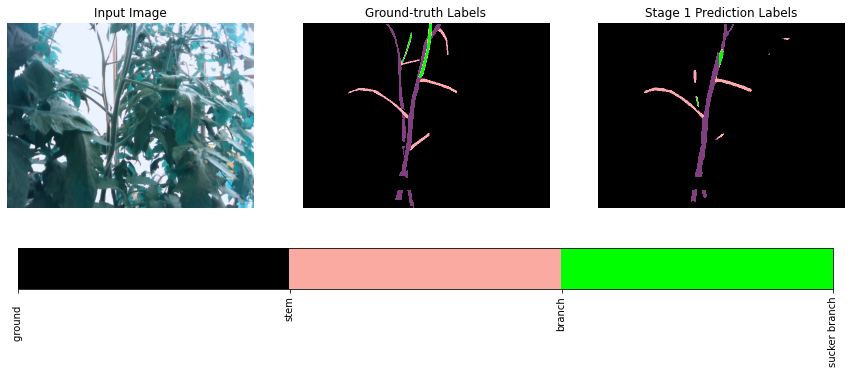

best val iou tensor(0.6290, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0293 mPA: 98.87% FPS: 877.6 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.8073: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [4/40] Loss: 0.1657 mPA: 97.86% FPS: 979.5 Lr: 0.0000000000 sucker_t: 79.3 sucker_f: 21.3   IOU1: 0.6413 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1250 FPS: 119.6 IOU: 0.6021


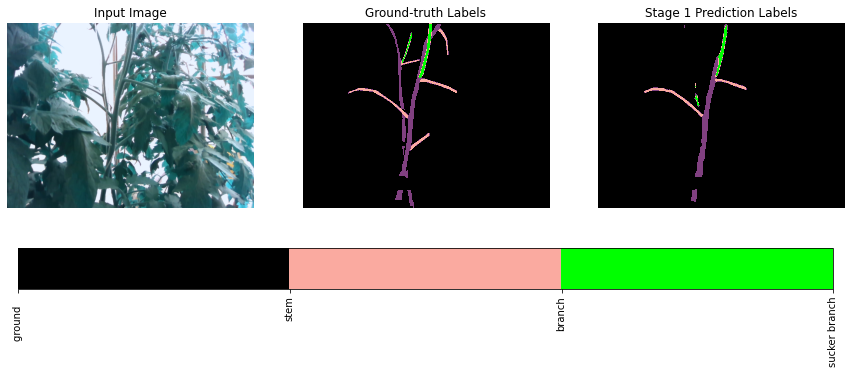

best val iou tensor(0.6413, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0274 mPA: 98.93% FPS: 878.7 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.8180: 100%|██████████| 326/326 [03:24<00:00,  1.59it/s]


best_val


Train Epoch: [5/40] Loss: 0.1607 mPA: 97.85% FPS: 961.2 Lr: 0.0000000000 sucker_t: 76.3 sucker_f: 16.2   IOU1: 0.6305 : 100%|██████████| 41/41 [00:16<00:00,  2.43it/s]


idx: 169
Val Loss: 0.1130 FPS: 123.4 IOU: 0.5400


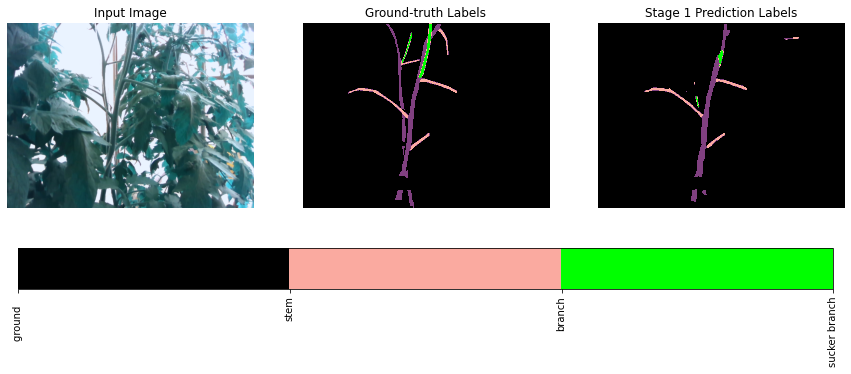

best val iou tensor(0.6413, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0255 mPA: 99.00% FPS: 883.3 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.8277: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [6/40] Loss: 0.1670 mPA: 97.83% FPS: 954.8 Lr: 0.0000000000 sucker_t: 74.4 sucker_f: 13.9   IOU1: 0.6403 : 100%|██████████| 41/41 [00:16<00:00,  2.45it/s]


idx: 169
Val Loss: 0.1193 FPS: 128.8 IOU: 0.5667


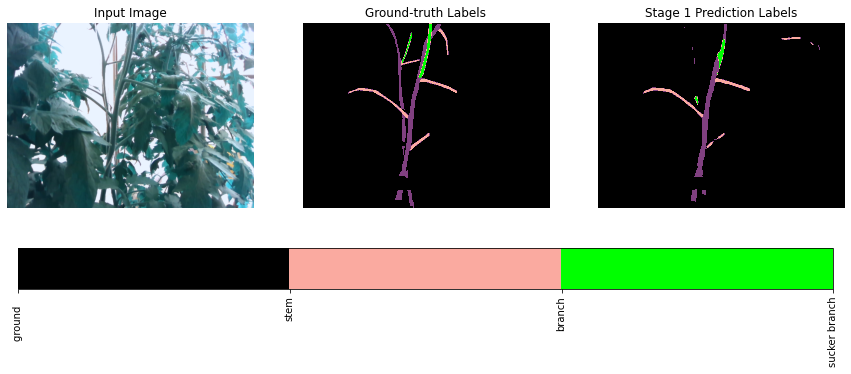

best val iou tensor(0.6413, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0239 mPA: 99.05% FPS: 883.5 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.8370: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [7/40] Loss: 0.1733 mPA: 97.85% FPS: 911.1 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 20.2   IOU1: 0.6396 : 100%|██████████| 41/41 [00:17<00:00,  2.41it/s]


idx: 169
Val Loss: 0.0987 FPS: 112.8 IOU: 0.5847


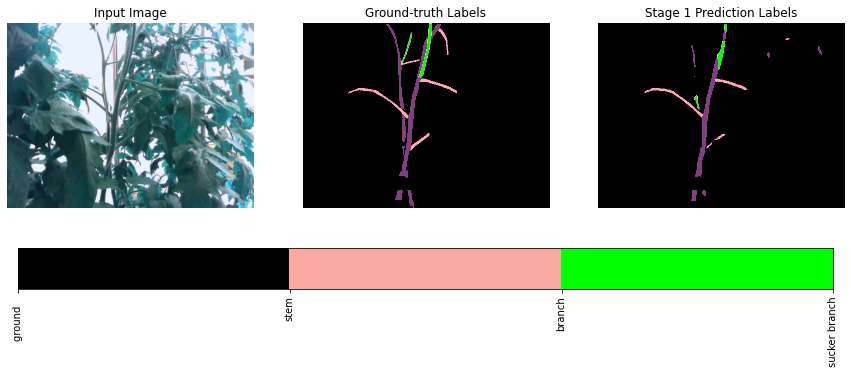

best val iou tensor(0.6413, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0233 mPA: 99.07% FPS: 882.3 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8398: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [8/40] Loss: 0.1800 mPA: 97.76% FPS: 938.2 Lr: 0.0000000000 sucker_t: 79.3 sucker_f: 25.4   IOU1: 0.6338 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1075 FPS: 129.8 IOU: 0.5804


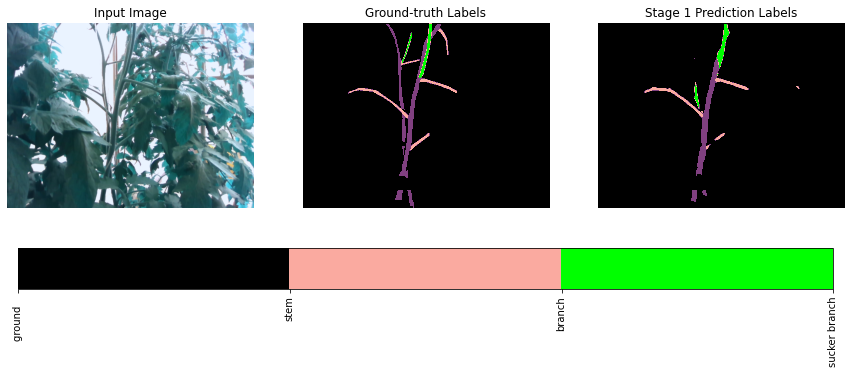

best val iou tensor(0.6413, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0218 mPA: 99.13% FPS: 879.7 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8496: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [9/40] Loss: 0.1826 mPA: 97.83% FPS: 941.5 Lr: 0.0000000000 sucker_t: 79.3 sucker_f: 17.4   IOU1: 0.6423 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1206 FPS: 131.1 IOU: 0.5471


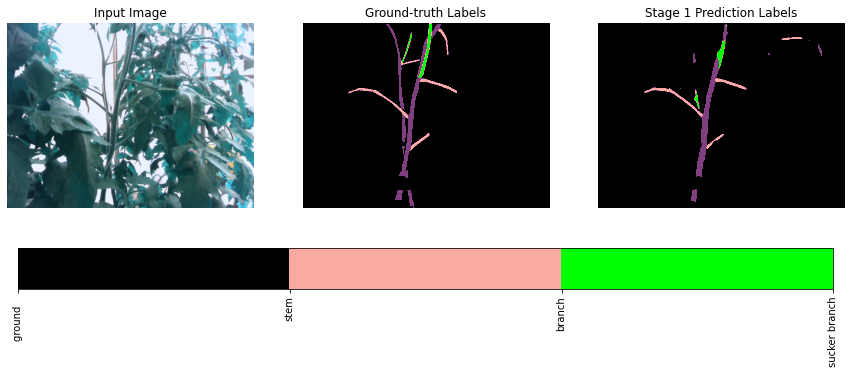

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0206 mPA: 99.18% FPS: 875.8 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8567: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [10/40] Loss: 0.1806 mPA: 97.87% FPS: 931.0 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 15.5   IOU1: 0.6400 : 100%|██████████| 41/41 [00:16<00:00,  2.42it/s]


idx: 169
Val Loss: 0.1273 FPS: 127.6 IOU: 0.5771


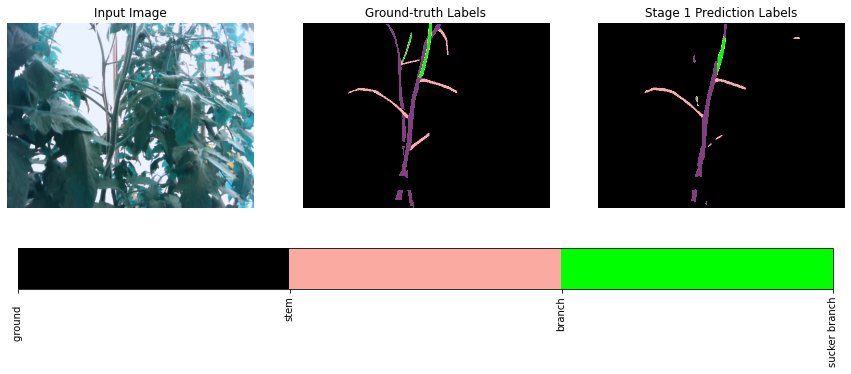

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0200 mPA: 99.20% FPS: 876.9 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8604: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [11/40] Loss: 0.2083 mPA: 97.86% FPS: 949.2 Lr: 0.0000000000 sucker_t: 79.6 sucker_f: 22.8   IOU1: 0.6361 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1284 FPS: 123.7 IOU: 0.5747


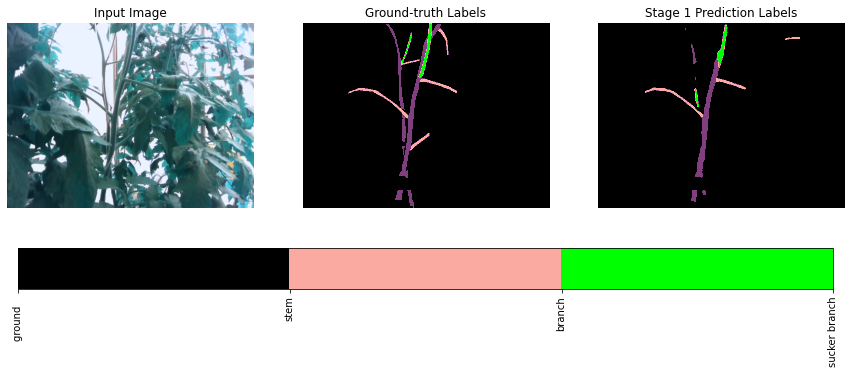

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0192 mPA: 99.23% FPS: 884.3 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8655: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [12/40] Loss: 0.1778 mPA: 97.80% FPS: 959.3 Lr: 0.0000000000 sucker_t: 82.8 sucker_f: 20.9   IOU1: 0.6399 : 100%|██████████| 41/41 [00:17<00:00,  2.39it/s]


idx: 169
Val Loss: 0.1067 FPS: 109.4 IOU: 0.6001


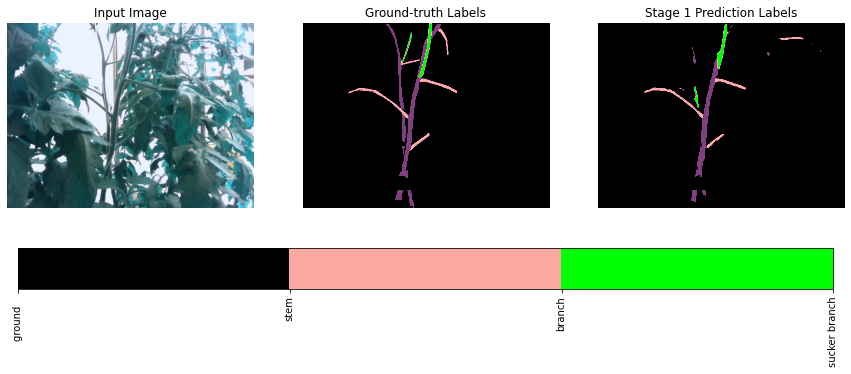

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0184 mPA: 99.26% FPS: 876.3 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8697: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [13/40] Loss: 0.2150 mPA: 97.86% FPS: 958.2 Lr: 0.0000000000 sucker_t: 76.9 sucker_f: 19.6   IOU1: 0.6375 : 100%|██████████| 41/41 [00:16<00:00,  2.42it/s]


idx: 169
Val Loss: 0.1498 FPS: 126.1 IOU: 0.6007


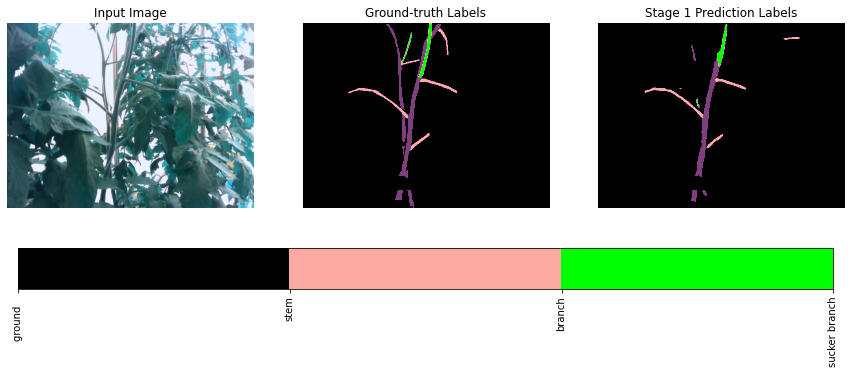

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0179 mPA: 99.28% FPS: 871.5 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8730: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [14/40] Loss: 0.2102 mPA: 97.83% FPS: 936.0 Lr: 0.0000000000 sucker_t: 78.9 sucker_f: 15.8   IOU1: 0.6379 : 100%|██████████| 41/41 [00:16<00:00,  2.42it/s]


idx: 169
Val Loss: 0.1442 FPS: 107.7 IOU: 0.5449


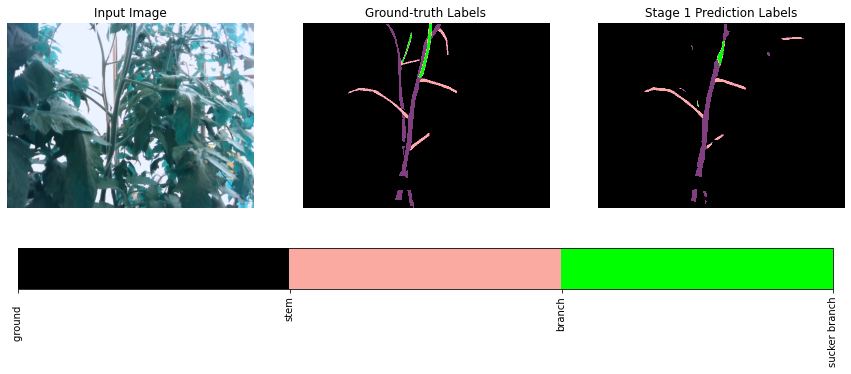

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0174 mPA: 99.30% FPS: 853.0 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8763: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [15/40] Loss: 0.2080 mPA: 97.83% FPS: 921.7 Lr: 0.0000000000 sucker_t: 77.8 sucker_f: 17.6   IOU1: 0.6396 : 100%|██████████| 41/41 [00:17<00:00,  2.40it/s]


idx: 169
Val Loss: 0.1529 FPS: 124.6 IOU: 0.5943


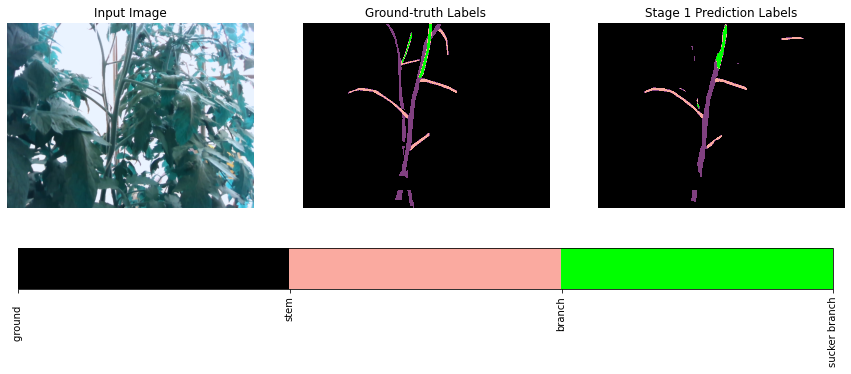

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0168 mPA: 99.32% FPS: 851.9 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8797: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [16/40] Loss: 0.2270 mPA: 97.84% FPS: 880.8 Lr: 0.0000000000 sucker_t: 78.0 sucker_f: 17.3   IOU1: 0.6368 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1501 FPS: 127.0 IOU: 0.5798


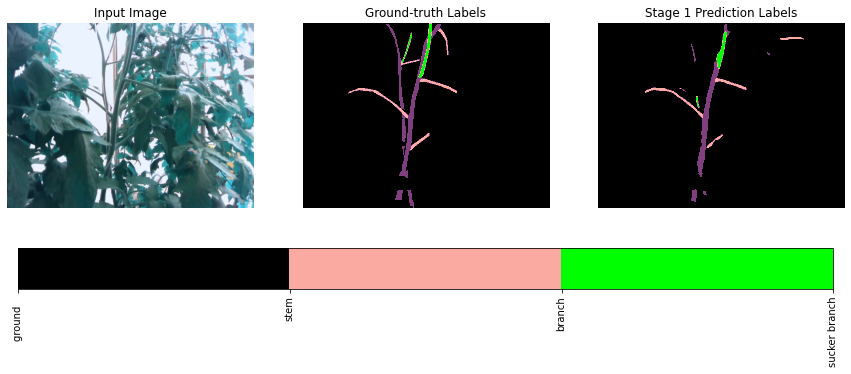

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0164 mPA: 99.34% FPS: 836.9 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8823: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [17/40] Loss: 0.2341 mPA: 97.83% FPS: 909.0 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 19.0   IOU1: 0.6376 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1730 FPS: 109.1 IOU: 0.5939


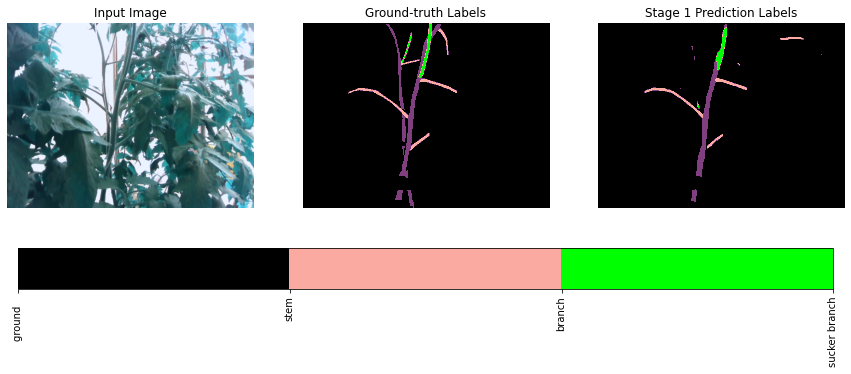

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0160 mPA: 99.35% FPS: 836.6 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8847: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [18/40] Loss: 0.2151 mPA: 97.82% FPS: 862.4 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 17.0   IOU1: 0.6370 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1633 FPS: 129.4 IOU: 0.5993


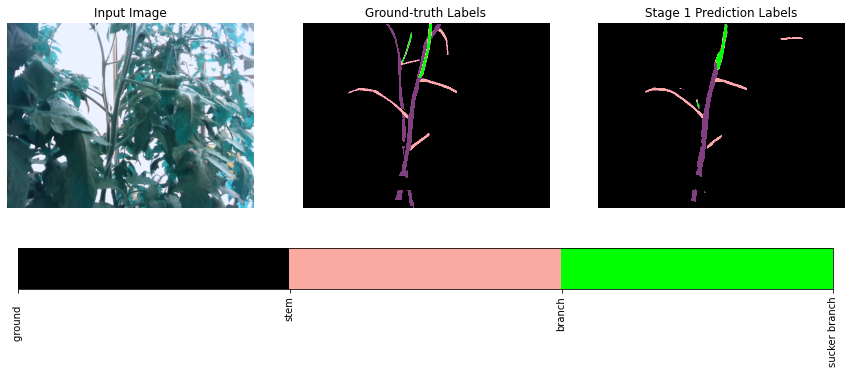

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0157 mPA: 99.37% FPS: 817.4 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8871: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [19/40] Loss: 0.2400 mPA: 97.81% FPS: 853.9 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 18.5   IOU1: 0.6359 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1683 FPS: 122.9 IOU: 0.5751


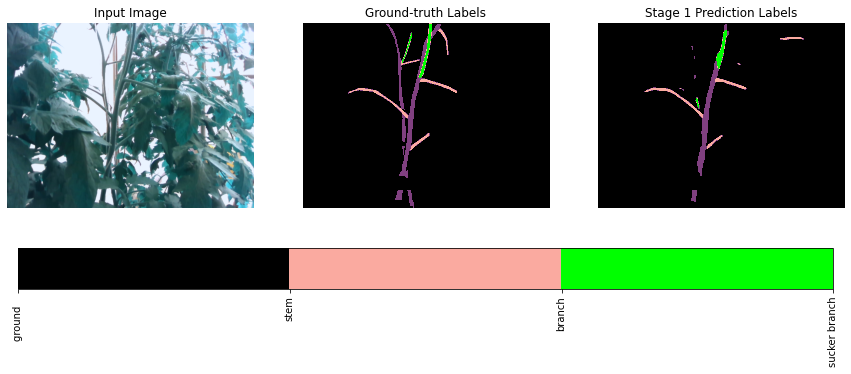

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0154 mPA: 99.38% FPS: 814.7 Lr: 0.0003205178 sucker: 0.0000 IOU1: 0.8889: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [20/40] Loss: 0.2249 mPA: 97.82% FPS: 928.2 Lr: 0.0000000000 sucker_t: 75.6 sucker_f: 20.7   IOU1: 0.6326 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1431 FPS: 121.0 IOU: 0.5987


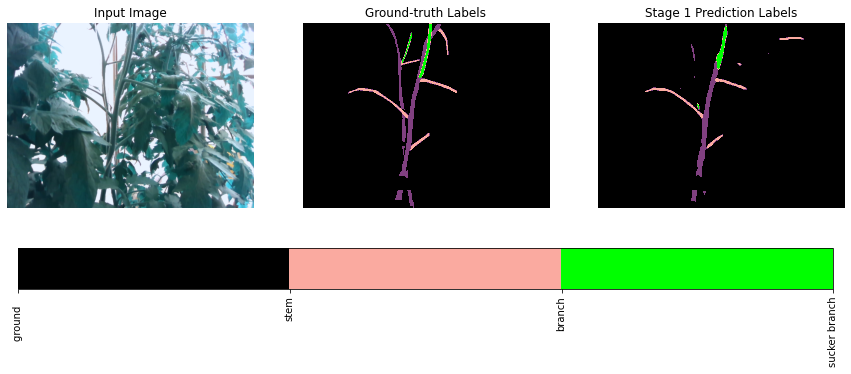

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0151 mPA: 99.39% FPS: 794.5 Lr: 0.0002906510 sucker: 0.0000 IOU1: 0.8906: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [21/40] Loss: 0.2436 mPA: 97.81% FPS: 873.9 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 19.6   IOU1: 0.6347 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1553 FPS: 98.6 IOU: 0.5880


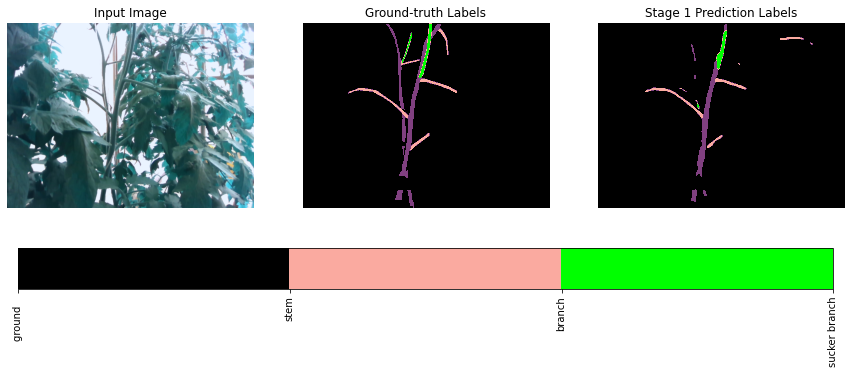

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0149 mPA: 99.40% FPS: 788.0 Lr: 0.0002635672 sucker: 0.0000 IOU1: 0.8921: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [22/40] Loss: 0.2501 mPA: 97.82% FPS: 905.1 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 17.4   IOU1: 0.6301 : 100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


idx: 169
Val Loss: 0.1577 FPS: 127.4 IOU: 0.5951


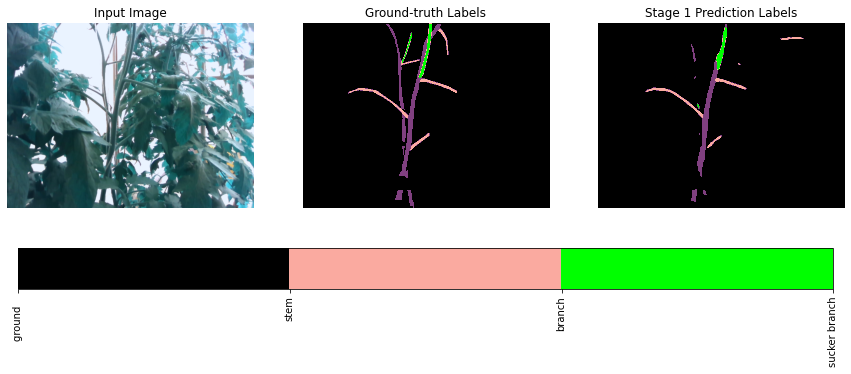

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0146 mPA: 99.41% FPS: 802.5 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.8945: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [23/40] Loss: 0.2469 mPA: 97.82% FPS: 918.4 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 18.5   IOU1: 0.6328 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1664 FPS: 128.0 IOU: 0.5953


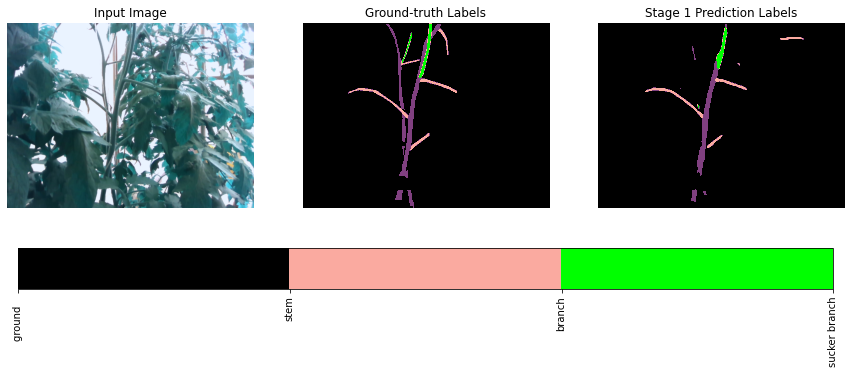

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0145 mPA: 99.42% FPS: 796.4 Lr: 0.0002167358 sucker: 0.0000 IOU1: 0.8953: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [24/40] Loss: 0.2460 mPA: 97.81% FPS: 919.4 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 19.1   IOU1: 0.6327 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1766 FPS: 110.3 IOU: 0.5833


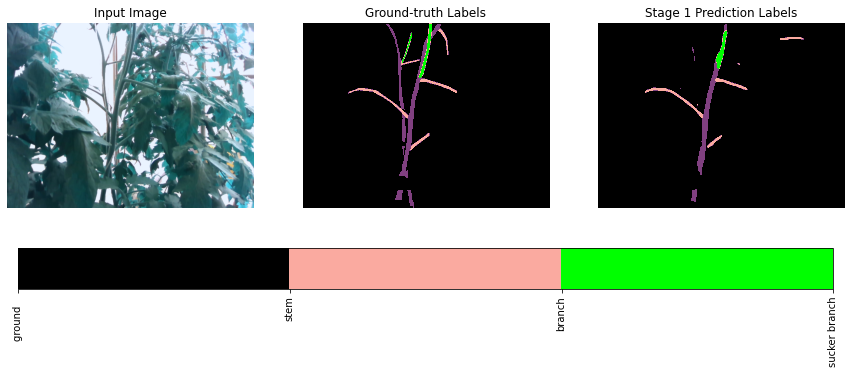

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [25/40] Loss: 0.0143 mPA: 99.42% FPS: 790.0 Lr: 0.0001965397 sucker: 0.0000 IOU1: 0.8966: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [25/40] Loss: 0.2616 mPA: 97.81% FPS: 901.9 Lr: 0.0000000000 sucker_t: 74.4 sucker_f: 20.5   IOU1: 0.6313 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1656 FPS: 112.9 IOU: 0.5869


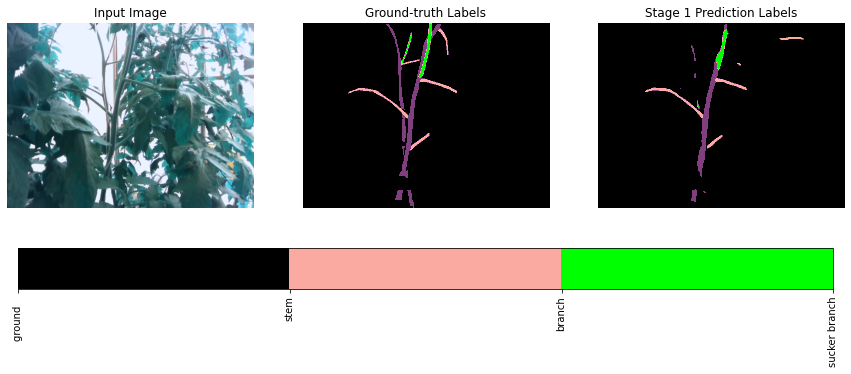

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [26/40] Loss: 0.0141 mPA: 99.43% FPS: 792.7 Lr: 0.0001782255 sucker: 0.0000 IOU1: 0.8977: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [26/40] Loss: 0.2473 mPA: 97.80% FPS: 902.2 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 20.9   IOU1: 0.6315 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1644 FPS: 121.2 IOU: 0.5932


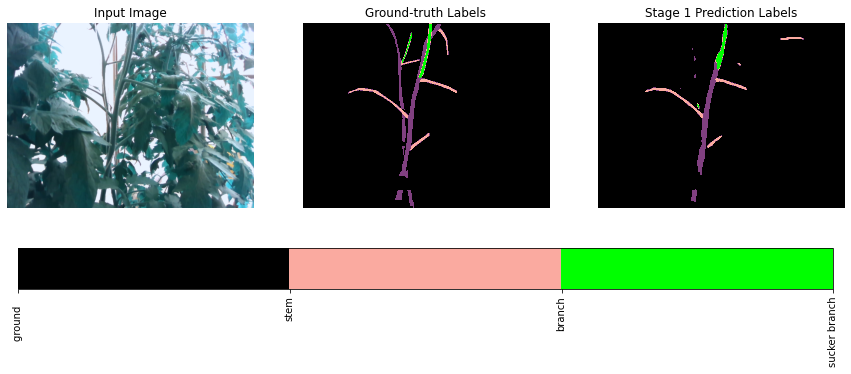

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [27/40] Loss: 0.0140 mPA: 99.43% FPS: 795.0 Lr: 0.0001616179 sucker: 0.0000 IOU1: 0.8981: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [27/40] Loss: 0.2451 mPA: 97.78% FPS: 937.3 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 19.6   IOU1: 0.6319 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1581 FPS: 115.4 IOU: 0.5856


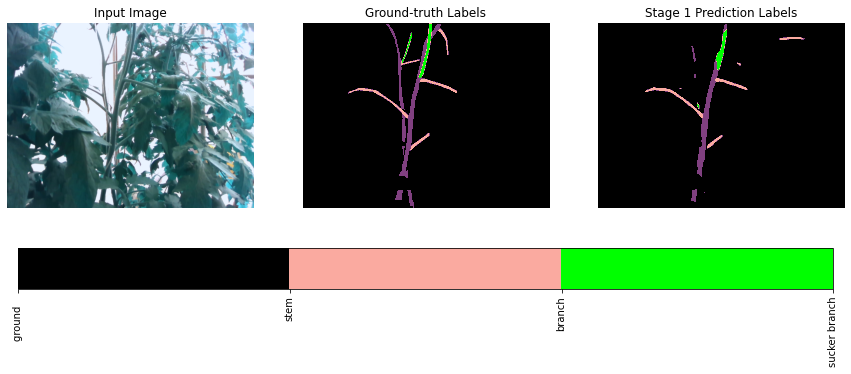

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [28/40] Loss: 0.0138 mPA: 99.44% FPS: 791.1 Lr: 0.0001465579 sucker: 0.0000 IOU1: 0.8992: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [28/40] Loss: 0.2656 mPA: 97.80% FPS: 876.8 Lr: 0.0000000000 sucker_t: 74.3 sucker_f: 18.2   IOU1: 0.6305 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1753 FPS: 84.6 IOU: 0.5944


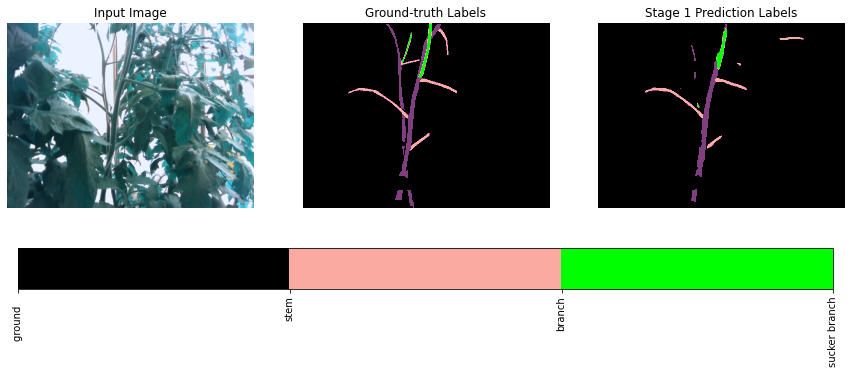

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [29/40] Loss: 0.0136 mPA: 99.45% FPS: 785.9 Lr: 0.0001329012 sucker: 0.0000 IOU1: 0.9007: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [29/40] Loss: 0.2591 mPA: 97.79% FPS: 885.9 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 20.3   IOU1: 0.6294 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1614 FPS: 119.7 IOU: 0.5940


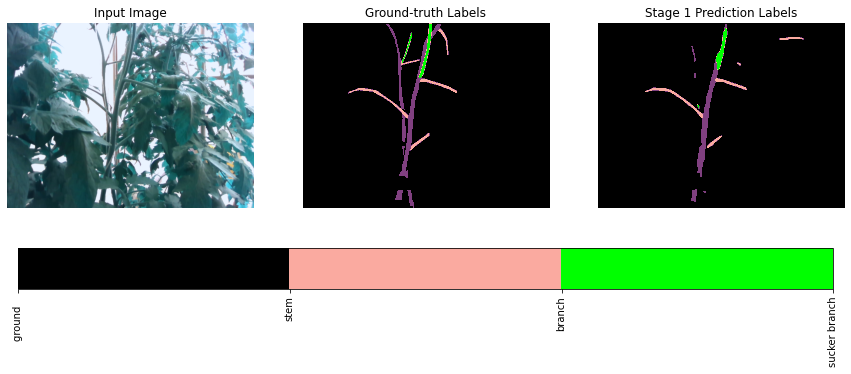

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [30/40] Loss: 0.0136 mPA: 99.45% FPS: 786.2 Lr: 0.0001205170 sucker: 0.0000 IOU1: 0.9010: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [30/40] Loss: 0.2606 mPA: 97.78% FPS: 884.5 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 19.8   IOU1: 0.6298 : 100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


idx: 169
Val Loss: 0.1599 FPS: 112.2 IOU: 0.5893


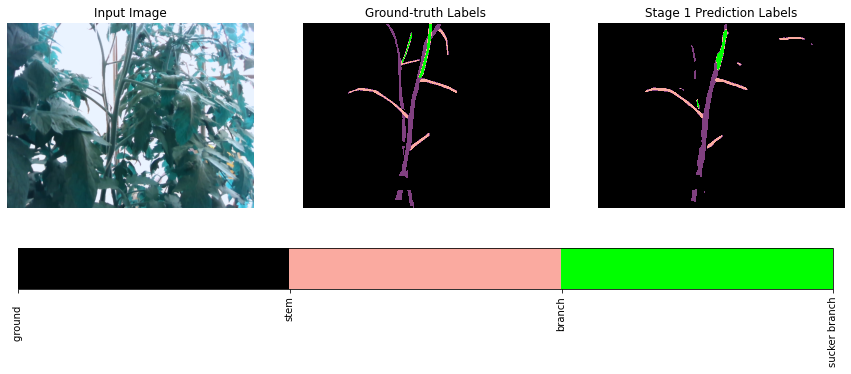

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [31/40] Loss: 0.0135 mPA: 99.46% FPS: 786.1 Lr: 0.0001092869 sucker: 0.0000 IOU1: 0.9012: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [31/40] Loss: 0.2753 mPA: 97.79% FPS: 883.3 Lr: 0.0000000000 sucker_t: 74.4 sucker_f: 19.5   IOU1: 0.6285 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1665 FPS: 114.4 IOU: 0.5902


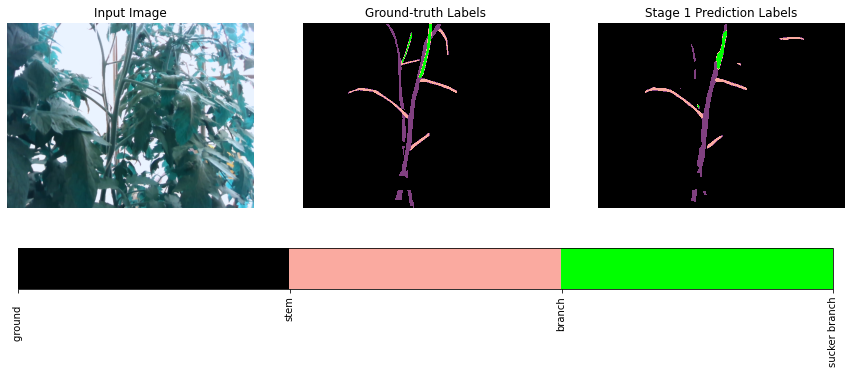

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [32/40] Loss: 0.0134 mPA: 99.46% FPS: 727.5 Lr: 0.0000991032 sucker: 0.0000 IOU1: 0.9018: 100%|██████████| 326/326 [03:25<00:00,  1.58it/s]


best_val


Train Epoch: [32/40] Loss: 0.2710 mPA: 97.80% FPS: 881.2 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 19.2   IOU1: 0.6288 : 100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


idx: 169
Val Loss: 0.1788 FPS: 121.4 IOU: 0.5891


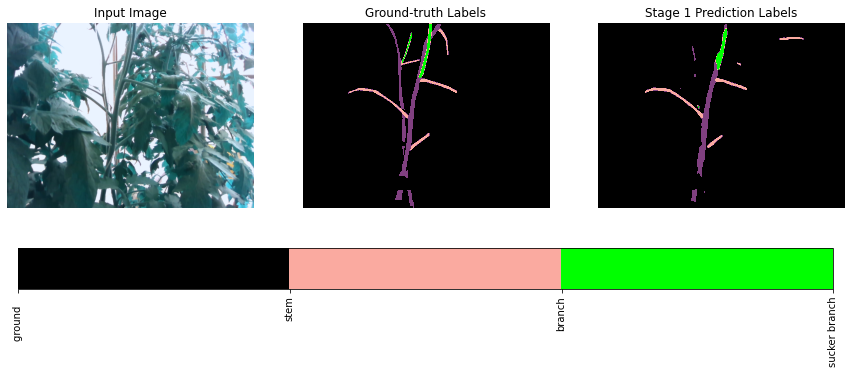

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [33/40] Loss: 0.0133 mPA: 99.46% FPS: 790.2 Lr: 0.0000898685 sucker: 0.0000 IOU1: 0.9029: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [33/40] Loss: 0.2674 mPA: 97.78% FPS: 866.1 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 19.8   IOU1: 0.6294 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1670 FPS: 113.8 IOU: 0.5894


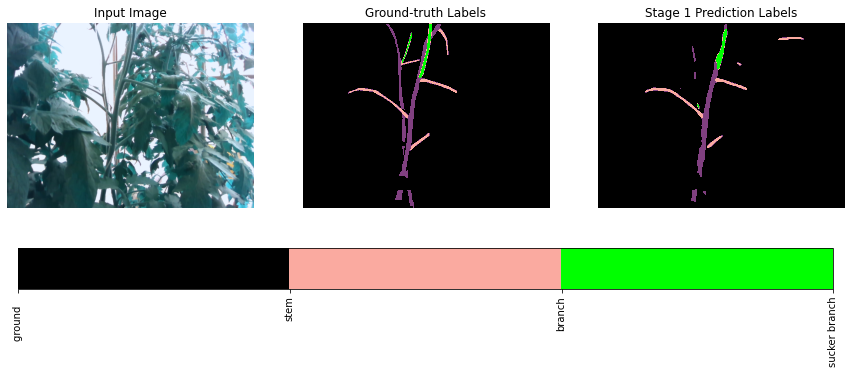

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [34/40] Loss: 0.0132 mPA: 99.47% FPS: 785.0 Lr: 0.0000814942 sucker: 0.0000 IOU1: 0.9035: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [34/40] Loss: 0.2670 mPA: 97.79% FPS: 900.5 Lr: 0.0000000000 sucker_t: 74.4 sucker_f: 19.0   IOU1: 0.6278 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1589 FPS: 108.5 IOU: 0.5925


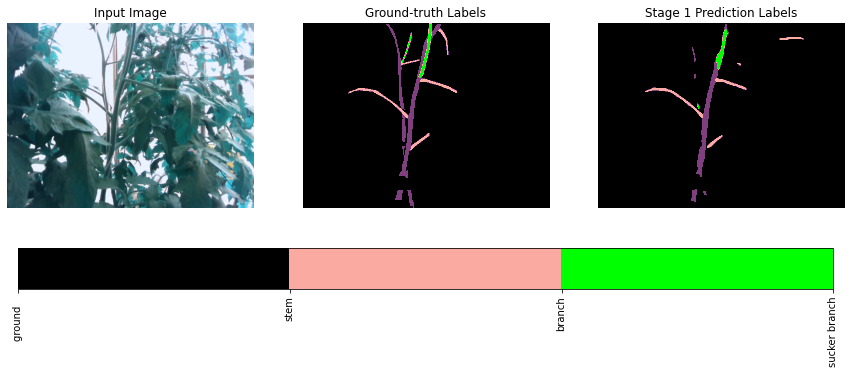

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [35/40] Loss: 0.0132 mPA: 99.47% FPS: 776.2 Lr: 0.0000739004 sucker: 0.0000 IOU1: 0.9037: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [35/40] Loss: 0.2736 mPA: 97.79% FPS: 905.0 Lr: 0.0000000000 sucker_t: 75.2 sucker_f: 19.2   IOU1: 0.6289 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1690 FPS: 100.3 IOU: 0.5919


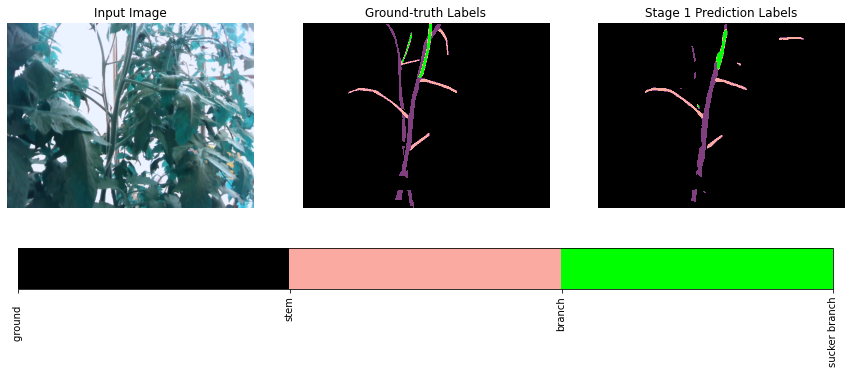

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [36/40] Loss: 0.0131 mPA: 99.47% FPS: 773.4 Lr: 0.0000670141 sucker: 0.0000 IOU1: 0.9041: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [36/40] Loss: 0.2714 mPA: 97.78% FPS: 886.2 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 18.4   IOU1: 0.6282 : 100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


idx: 169
Val Loss: 0.1727 FPS: 123.2 IOU: 0.5894


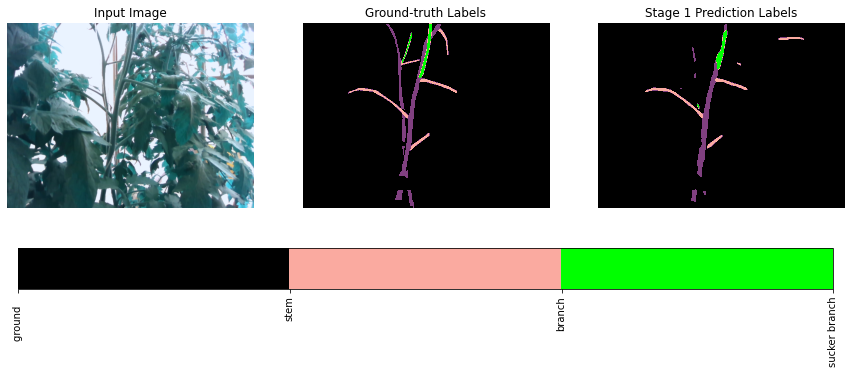

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [37/40] Loss: 0.0130 mPA: 99.47% FPS: 784.1 Lr: 0.0000607695 sucker: 0.0000 IOU1: 0.9046: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [37/40] Loss: 0.2670 mPA: 97.78% FPS: 856.1 Lr: 0.0000000000 sucker_t: 75.2 sucker_f: 18.4   IOU1: 0.6294 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1658 FPS: 92.5 IOU: 0.5901


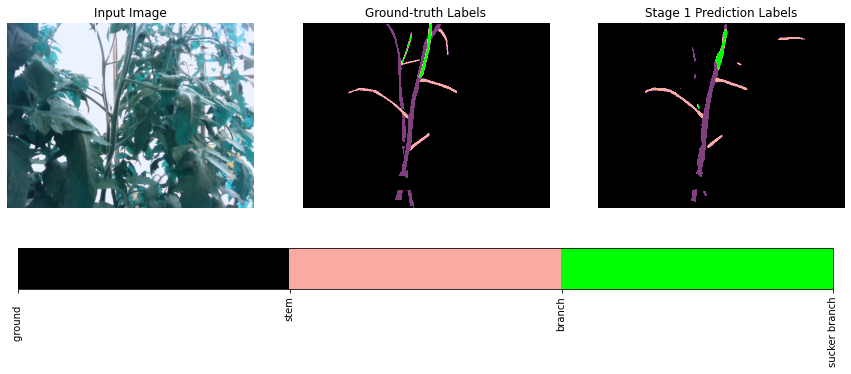

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [38/40] Loss: 0.0130 mPA: 99.48% FPS: 787.5 Lr: 0.0000551068 sucker: 0.0000 IOU1: 0.9048: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [38/40] Loss: 0.2756 mPA: 97.78% FPS: 911.0 Lr: 0.0000000000 sucker_t: 74.6 sucker_f: 19.1   IOU1: 0.6284 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1773 FPS: 97.5 IOU: 0.5862


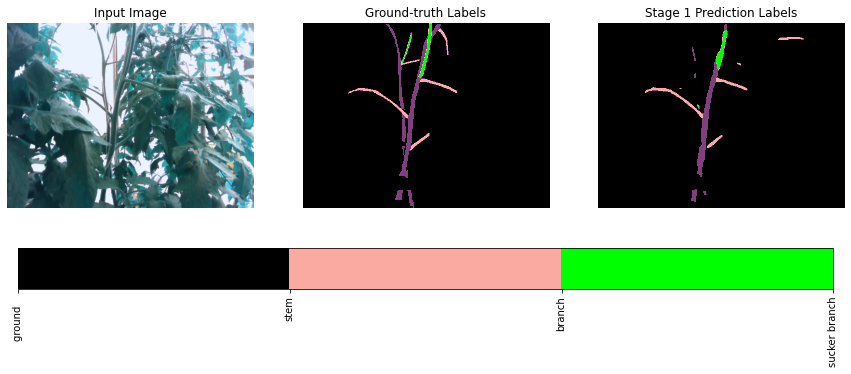

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [39/40] Loss: 0.0129 mPA: 99.48% FPS: 795.1 Lr: 0.0000499718 sucker: 0.0000 IOU1: 0.9052: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [39/40] Loss: 0.2732 mPA: 97.78% FPS: 871.0 Lr: 0.0000000000 sucker_t: 75.4 sucker_f: 19.2   IOU1: 0.6281 : 100%|██████████| 41/41 [00:17<00:00,  2.37it/s]


idx: 169
Val Loss: 0.1767 FPS: 127.4 IOU: 0.5906


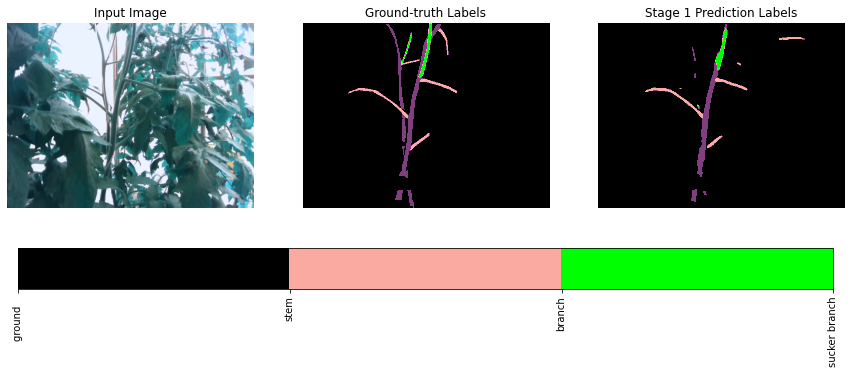

best val iou tensor(0.6423, device='cuda:0')


Train Epoch: [40/40] Loss: 0.0128 mPA: 99.48% FPS: 784.1 Lr: 0.0000453153 sucker: 0.0000 IOU1: 0.9058: 100%|██████████| 326/326 [03:25<00:00,  1.59it/s]


best_val


Train Epoch: [40/40] Loss: 0.2740 mPA: 97.78% FPS: 830.6 Lr: 0.0000000000 sucker_t: 73.3 sucker_f: 18.6   IOU1: 0.6276 : 100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


idx: 169
Val Loss: 0.1729 FPS: 91.9 IOU: 0.5863


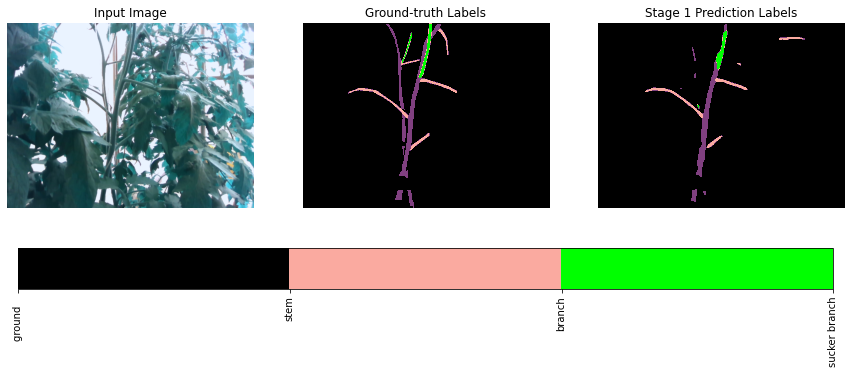

best val iou tensor(0.6423, device='cuda:0')


In [ ]:
trainer.train()

**DLIGHTNET NODEPTH**

Train Epoch: [12/40] Loss: 0.1855 mPA: 97.87% FPS: 1071.7 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 15.1   IOU1: 0.6391 
Train Epoch: [11/40] Loss: 0.1640 mPA: 97.83% FPS: 1110.1 Lr: 0.0000000000 sucker_t: 82.2 sucker_f: 23.0   IOU1: 0.6412 

In [ ]:


class DLightNe_nodepth(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.s1_xconv1 = ConvBlock(in_channels=in_channels, out_channels=in_channels, stride=1)
        self.s1_dsconv1 = _DSConv(dw_channels=3,out_channels=32,stride=2)
        self.s1_dsconv2 = _DSConv(dw_channels=32,out_channels=64,stride=2)
        self.s1_dwconv3 = _DSConv(dw_channels=64,out_channels=96,stride=1)
        self.s1_dsconv3 = _DSConv(dw_channels=96,out_channels=32,stride=1)
        self.scale_factor = 4
        self.s1_softmax = nn.Softmax(dim=1)
        self.s1_drop_out = nn.Dropout(p=0.1)
        self.s1_conv_final = nn.Conv2d(32, num_classes, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=18, stride=1)
        self.conv1_2 = ConvBlock(in_channels=3, out_channels=14, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)
    def forward(self, input):
        x = self.s1_xconv1(input)
        x = self.s1_dsconv1(x)
        x = self.s1_dsconv2(x)
        x = self.s1_dwconv3(x)
        x = self.s1_dsconv3(x)
        x = self.s1_conv_final(x)
        x_f1 = F.interpolate(input=x, scale_factor=4, mode='bilinear', align_corners=True)
        with torch.no_grad():
          x1 = self.s1_softmax(x_f1).detach()
          input1= remove_easypixel_rgb(x1,input,0.85,0.2 )
          
#    print('b1')
        xs2_1 =  self.conv1_1(input1)
        xs2_2 =  self.conv1_2(input)
        xs2 = torch.cat((xs2_1,xs2_2),1)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
 #       print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2

In [ ]:
trainer = Trainner( DLightNe_nodepth,'DLightNet_nodepth',12,isdepth=False,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.summary()

In [ ]:
trainer.train()

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_11.pth...


Train Epoch: [0/40] Loss: 0.1640 mPA: 97.83% FPS: 1110.1 Lr: 0.0000000000 sucker_t: 82.2 sucker_f: 23.0   IOU1: 0.6412 : 100%|██████████| 41/41 [00:15<00:00,  2.59it/s]


idx: 169
Val Loss: 0.1028 FPS: 127.0 IOU: 0.5852


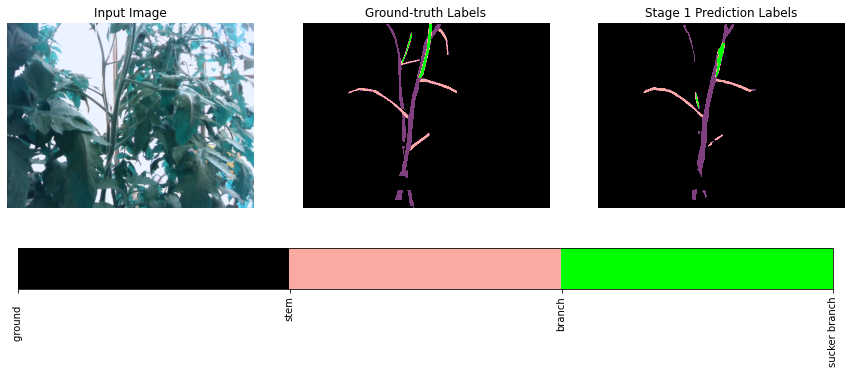

best val iou tensor(0.6412, device='cuda:0')


(0.16398273853927242, 97.83170705782314)

In [ ]:
trainer.load_weight(save_path='/content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_11.pth')
#trainer.load_epoch(11)
trainer.eval()

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_12.pth...


Train Epoch: [0/40] Loss: 0.1855 mPA: 97.87% FPS: 1071.7 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 15.1   IOU1: 0.6391 : 100%|██████████| 41/41 [00:15<00:00,  2.62it/s]


idx: 169
Val Loss: 0.1302 FPS: 131.7 IOU: 0.5608


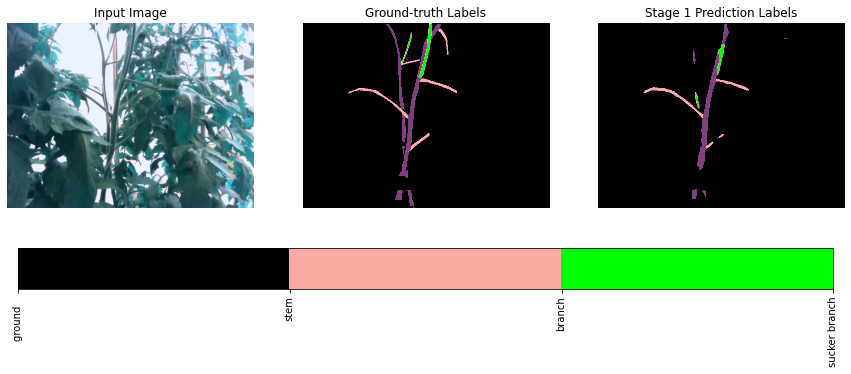

best val iou tensor(0.6391, device='cuda:0')


(0.18546895147586356, 97.87207961309522)

In [ ]:
trainer.load_epoch(12)
trainer.eval()

In [ ]:
trainer.load_epoch(13)

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_13.pth...


Train Epoch: [0/40] Loss: 0.1914 mPA: 97.84% FPS: 1131.8 Lr: 0.0000000000 sucker_t: 80.9 sucker_f: 26.9   IOU1: 0.6376 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.1283 FPS: 128.0 IOU: 0.5603


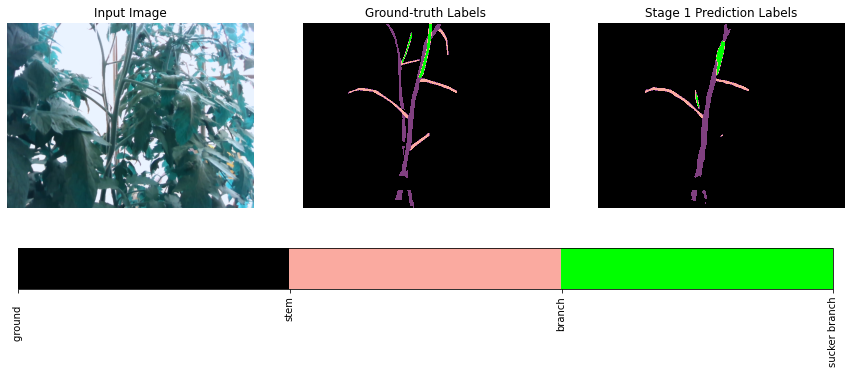

best val iou tensor(0.6391, device='cuda:0')


(0.19136472399137458, 97.83912959715138)

In [ ]:
trainer.eval()

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_nodepth_tomato_14.pth...


Train Epoch: [0/40] Loss: 0.1888 mPA: 97.81% FPS: 1091.1 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 25.6   IOU1: 0.6364 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.1374 FPS: 125.9 IOU: 0.5262


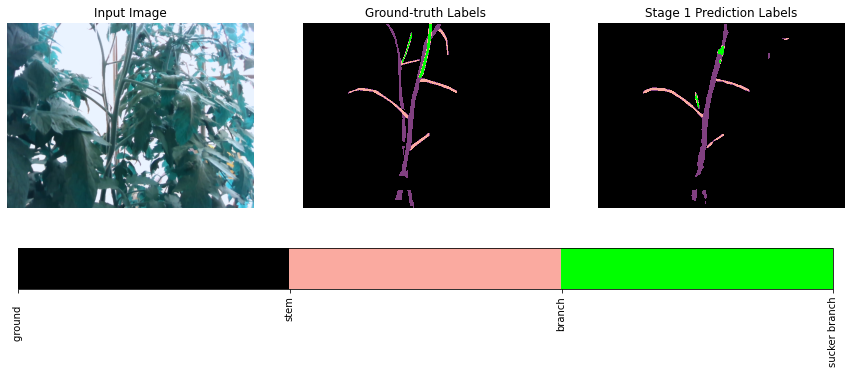

best val iou tensor(0.6391, device='cuda:0')


(0.1888148075767926, 97.80861766581633)

In [ ]:
trainer.load_epoch(14)
trainer.eval()

In [ ]:
trainer.load_epoch()

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.show_all_predict()

**DLIGHTNET ONE STAGE**
#rain Epoch: [17/40] Loss: 0.2061 mPA: 97.81% FPS: 869.3 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 17.1   IOU1: 0.6341 : 100%

In [ ]:

class DLightNet_onestage(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
       
        self.conv1_1 = ConvBlock(in_channels=3, out_channels=32, stride=1)
        self.conv2 = ConvBlock(in_channels=32, out_channels=32, stride=2)
   #     self.dsconv1 = _DSfeature1(dw_channels=32,out_channels=48,stride=2) #ConvBlock(in_channels=32, out_channels=48, stride=2)
        self.dsconv1 = ConvBlock(in_channels=32, out_channels=64, stride=2)
        self.dsconv111 = ConvBlock(in_channels=64, out_channels=64, stride=1)
        
        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 96, 1, 5),
                                         Bottleneck(96, 96, 1, 4))
     #   self.dsconvb1 = _DSfeature_s(out_channels=96,dw_channels=96,stride=1)
        self.dsconvb2 = _DSfeature_s1(out_channels=96,dw_channels=128,stride=1)
        self.dSfeature = _DSfeature_s(out_channels=128,dw_channels=256,stride=1)
        self.dSfeature_d = _DSfeature_d(out_channels=256,dw_channels=96,stride=1)

        self.ppm = PPMModule(96, 96)
        self.dsconv2 = _DSConv(dw_channels=96,out_channels=128,stride=1)
     #   self.dsconv2 = _DSfeature3(dw_channels=96,out_channels=128,stride=1,groups = 32)
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.dwconv = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

        self.classifier = Classifier(num_classes, scale_factor=4)
    def forward(self, input):
        xs2 =  self.conv1_1(input)
        xs2 =  self.conv2(xs2)
        xs2 =  self.dsconv1(xs2)
        xs21 =  self.dsconv111(xs2)
       # x2 = torch.add(xs11,xs2) #co the doi add
 #       print('b2')
        x2 = self.first_block(xs21)
      #  x2 = self.dsconvb1 (x2)
        x2 = self.dsconvb2 (x2)
        x2 = self.dSfeature (x2)
  #      print('b3')
        x2 = self.dSfeature_d (x2)
        x2 = self.ppm(x2)
        x2 =  self.dsconv2(x2)
        
        x3 = F.interpolate(input=x2, scale_factor=2, mode='bilinear',
                                     align_corners=True)
        x3 = self.dwconv(x3)
        x3 = self.conv_low_res(x3)
        x = self.conv_high_res(xs2) #co the doi ket noi voi cai dau tien
        x = torch.add(x, x3)
        x = self.relu(x)
        
        x_f2 = self.classifier(x)

        return x_f2

In [ ]:
trainer = Trainner( DLightNet_onestage,'DLightNet_onestage',12,isdepth=False,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.summary()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 480, 640]             864
       BatchNorm2d-2         [-1, 32, 480, 640]              64
              ReLU-3         [-1, 32, 480, 640]               0
         ConvBlock-4         [-1, 32, 480, 640]               0
            Conv2d-5         [-1, 32, 240, 320]           9,216
       BatchNorm2d-6         [-1, 32, 240, 320]              64
              ReLU-7         [-1, 32, 240, 320]               0
         ConvBlock-8         [-1, 32, 240, 320]               0
            Conv2d-9         [-1, 64, 120, 160]          18,432
      BatchNorm2d-10         [-1, 64, 120, 160]             128
             ReLU-11         [-1, 64, 120, 160]               0
        ConvBlock-12         [-1, 64, 120, 160]               0
           Conv2d-13         [-1, 64, 120, 160]          36,864
      BatchNorm2d-14         [-1, 64, 1

In [ ]:
from prettytable import PrettyTable

def count_parameters(model):
    table = PrettyTable(["Modules", "Parameters"])
    total_params = 0
    for name, parameter in model.named_parameters():
        if not parameter.requires_grad: continue
        param = parameter.numel()
        table.add_row([name, param])
        total_params+=param
    print(table)
    print(f"Total Trainable Params: {total_params}")
    return total_params
    
count_parameters(trainer.model)

+-----------------------------+------------+
|           Modules           | Parameters |
+-----------------------------+------------+
|     conv1_1.conv.weight     |    864     |
|      conv1_1.bn.weight      |     32     |
|       conv1_1.bn.bias       |     32     |
|      conv2.conv.weight      |    9216    |
|       conv2.bn.weight       |     32     |
|        conv2.bn.bias        |     32     |
|     dsconv1.conv.weight     |   18432    |
|      dsconv1.bn.weight      |     64     |
|       dsconv1.bn.bias       |     64     |
|    dsconv111.conv.weight    |   36864    |
|     dsconv111.bn.weight     |     64     |
|      dsconv111.bn.bias      |     64     |
| first_block.0.conv.0.weight |   24576    |
| first_block.0.conv.1.weight |    384     |
|  first_block.0.conv.1.bias  |    384     |
| first_block.0.conv.3.weight |    3456    |
| first_block.0.conv.4.weight |    384     |
|  first_block.0.conv.4.bias  |    384     |
| first_block.0.conv.6.weight |   24576    |
| first_bl

690596

In [ ]:
def sizemodel(model):
  mem_params = sum([param.nelement()*param.element_size() for param in model.parameters()])
  mem_bufs = sum([buf.nelement()*buf.element_size() for buf in model.buffers()])
  mem = mem_params + mem_bufs # in bytes
  print('mem size:',mem)
sizemodel(trainer.model)

mem size: 2810312


Train Epoch: [0/40] Loss: 0.1698 mPA: 96.28% FPS: 799.8 Lr: 0.0022670424 sucker: 0.0000 IOU1: 0.3555: 100%|██████████| 326/326 [03:09<00:00,  1.72it/s]


best_val


Train Epoch: [0/40] Loss: 0.1910 mPA: 96.94% FPS: 883.5 Lr: 0.0000000000 sucker_t: 0.0 sucker_f: 0.0   IOU1: 0.4339 : 100%|██████████| 41/41 [00:14<00:00,  2.87it/s]


idx: 169
Val Loss: 0.0870 FPS: 116.6 IOU: 0.4206


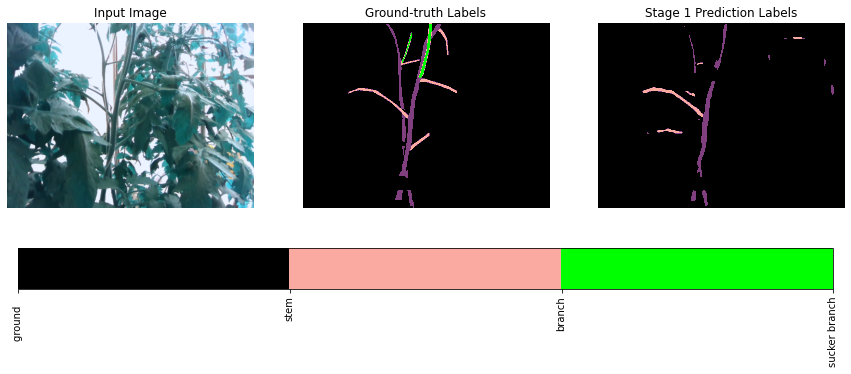

best val iou tensor(0.4339, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0736 mPA: 97.54% FPS: 815.1 Lr: 0.0020557924 sucker: 0.0000 IOU1: 0.5594: 100%|██████████| 326/326 [03:05<00:00,  1.76it/s]


best_val


Train Epoch: [1/40] Loss: 0.1502 mPA: 97.49% FPS: 915.5 Lr: 0.0000000000 sucker_t: 49.4 sucker_f: 20.3   IOU1: 0.5576 : 100%|██████████| 41/41 [00:15<00:00,  2.70it/s]


idx: 169
Val Loss: 0.0763 FPS: 109.9 IOU: 0.4615


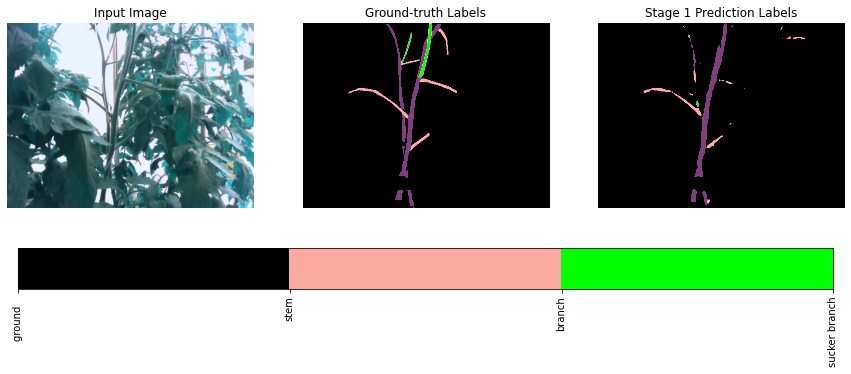

best val iou tensor(0.5576, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0566 mPA: 98.01% FPS: 816.4 Lr: 0.0018642274 sucker: 0.0000 IOU1: 0.6607: 100%|██████████| 326/326 [03:05<00:00,  1.75it/s]


best_val


Train Epoch: [2/40] Loss: 0.1522 mPA: 97.62% FPS: 931.8 Lr: 0.0000000000 sucker_t: 70.0 sucker_f: 39.8   IOU1: 0.5786 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.0663 FPS: 123.8 IOU: 0.4897


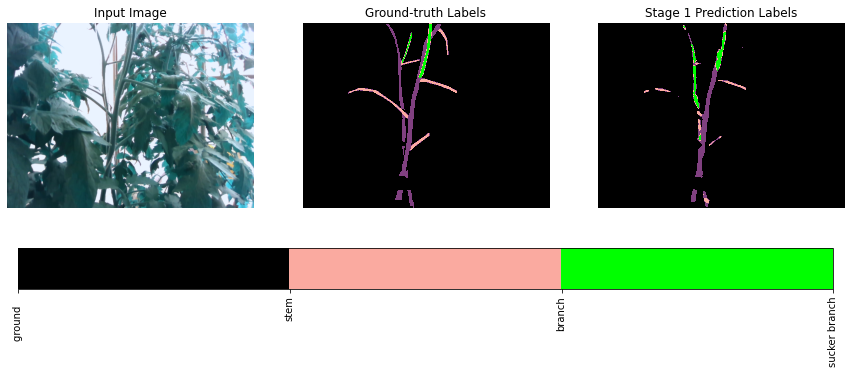

best val iou tensor(0.5786, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0474 mPA: 98.29% FPS: 822.1 Lr: 0.0016905130 sucker: 0.0000 IOU1: 0.7083: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [3/40] Loss: 0.1434 mPA: 97.80% FPS: 908.9 Lr: 0.0000000000 sucker_t: 69.8 sucker_f: 18.0   IOU1: 0.6136 : 100%|██████████| 41/41 [00:15<00:00,  2.67it/s]


idx: 169
Val Loss: 0.0749 FPS: 115.6 IOU: 0.5096


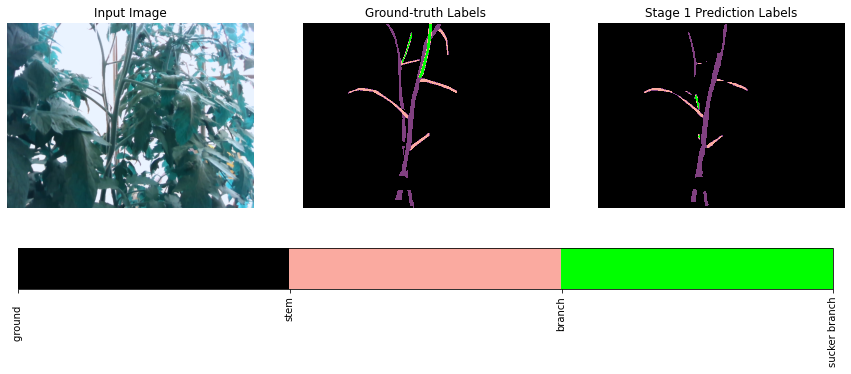

best val iou tensor(0.6136, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0414 mPA: 98.48% FPS: 812.7 Lr: 0.0015329858 sucker: 0.0000 IOU1: 0.7394: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [4/40] Loss: 0.1431 mPA: 97.74% FPS: 897.9 Lr: 0.0000000000 sucker_t: 74.1 sucker_f: 22.6   IOU1: 0.6243 : 100%|██████████| 41/41 [00:15<00:00,  2.63it/s]


idx: 169
Val Loss: 0.0565 FPS: 119.2 IOU: 0.5932


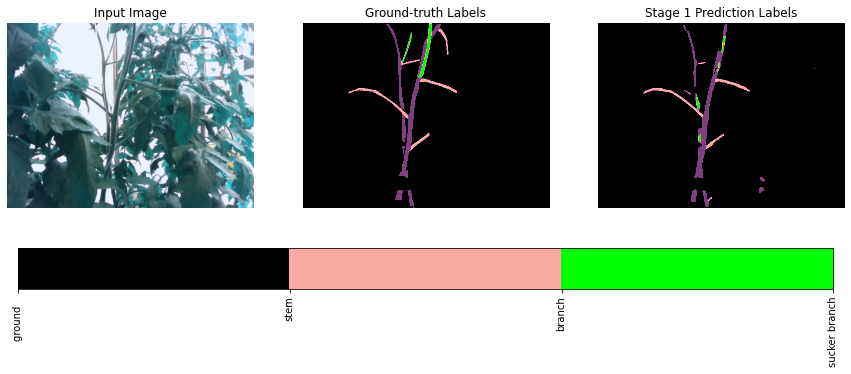

best val iou tensor(0.6243, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0362 mPA: 98.65% FPS: 811.8 Lr: 0.0013901375 sucker: 0.0000 IOU1: 0.7674: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [5/40] Loss: 0.1428 mPA: 97.76% FPS: 917.0 Lr: 0.0000000000 sucker_t: 78.3 sucker_f: 24.5   IOU1: 0.6240 : 100%|██████████| 41/41 [00:15<00:00,  2.61it/s]


idx: 169
Val Loss: 0.0763 FPS: 119.4 IOU: 0.5133


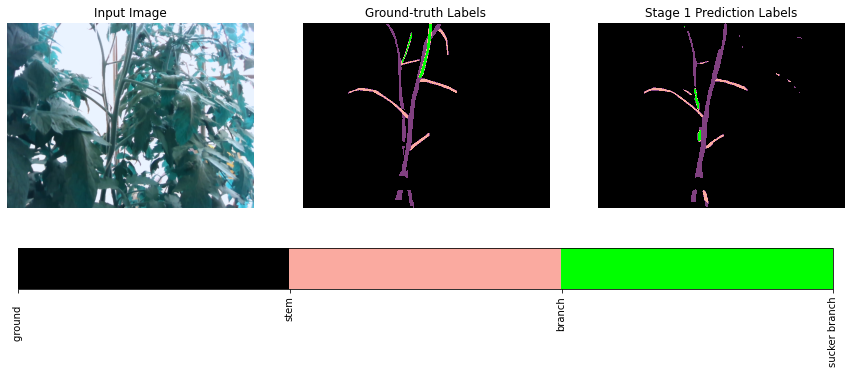

best val iou tensor(0.6243, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0324 mPA: 98.78% FPS: 805.8 Lr: 0.0012606003 sucker: 0.0000 IOU1: 0.7875: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [6/40] Loss: 0.1466 mPA: 97.78% FPS: 908.9 Lr: 0.0000000000 sucker_t: 73.5 sucker_f: 23.3   IOU1: 0.6272 : 100%|██████████| 41/41 [00:15<00:00,  2.62it/s]


idx: 169
Val Loss: 0.0695 FPS: 120.5 IOU: 0.5464


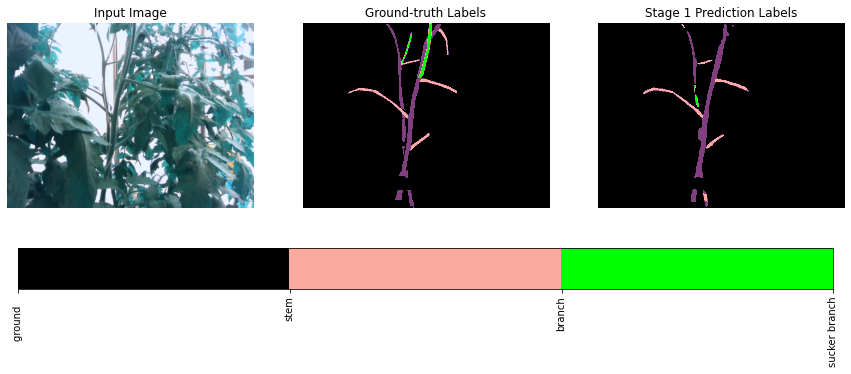

best val iou tensor(0.6272, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0293 mPA: 98.88% FPS: 810.9 Lr: 0.0011431337 sucker: 0.0000 IOU1: 0.8059: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [7/40] Loss: 0.1624 mPA: 97.80% FPS: 922.4 Lr: 0.0000000000 sucker_t: 73.7 sucker_f: 23.7   IOU1: 0.6245 : 100%|██████████| 41/41 [00:15<00:00,  2.63it/s]


idx: 169
Val Loss: 0.0720 FPS: 121.8 IOU: 0.5556


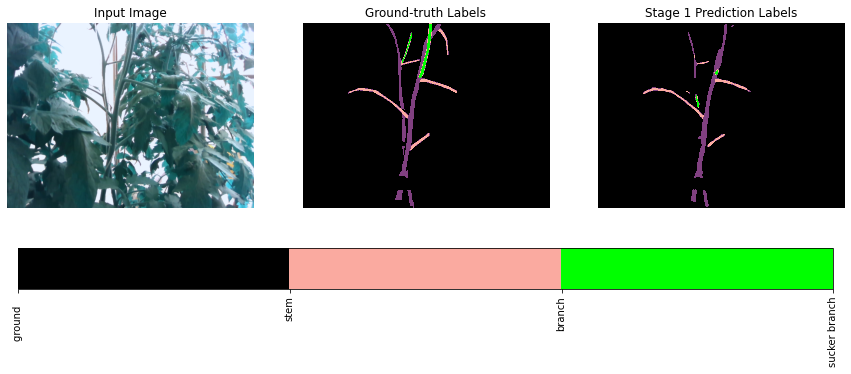

best val iou tensor(0.6272, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0271 mPA: 98.96% FPS: 799.8 Lr: 0.0010366130 sucker: 0.0000 IOU1: 0.8183: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [8/40] Loss: 0.1699 mPA: 97.84% FPS: 904.4 Lr: 0.0000000000 sucker_t: 75.2 sucker_f: 24.7   IOU1: 0.6211 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.0864 FPS: 123.9 IOU: 0.5473


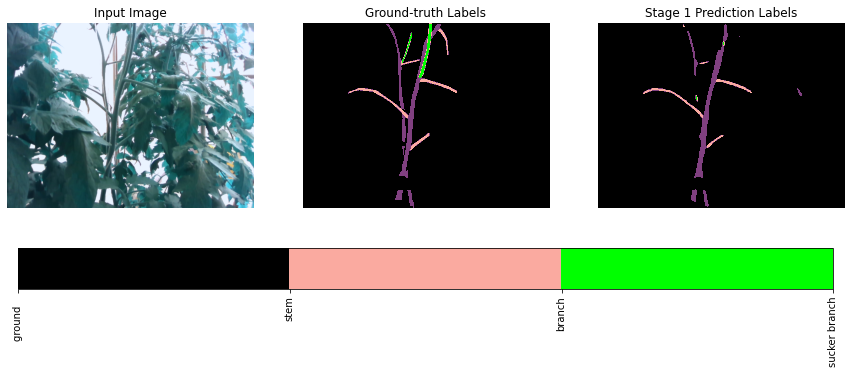

best val iou tensor(0.6272, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0257 mPA: 99.01% FPS: 805.0 Lr: 0.0009400182 sucker: 0.0000 IOU1: 0.8269: 100%|██████████| 326/326 [03:06<00:00,  1.74it/s]


best_val


Train Epoch: [9/40] Loss: 0.1620 mPA: 97.75% FPS: 906.8 Lr: 0.0000000000 sucker_t: 79.6 sucker_f: 24.2   IOU1: 0.6302 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.0739 FPS: 118.2 IOU: 0.5588


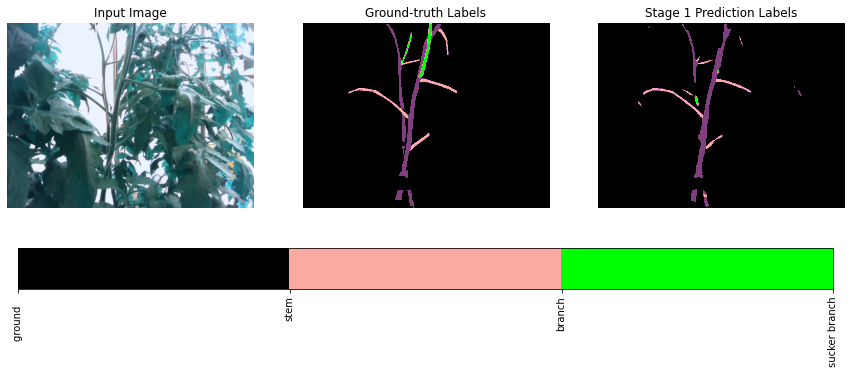

best val iou tensor(0.6302, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0239 mPA: 99.07% FPS: 790.6 Lr: 0.0008524245 sucker: 0.0000 IOU1: 0.8361: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [10/40] Loss: 0.1814 mPA: 97.84% FPS: 891.6 Lr: 0.0000000000 sucker_t: 72.4 sucker_f: 17.3   IOU1: 0.6328 : 100%|██████████| 41/41 [00:15<00:00,  2.64it/s]


idx: 169
Val Loss: 0.1060 FPS: 124.3 IOU: 0.5534


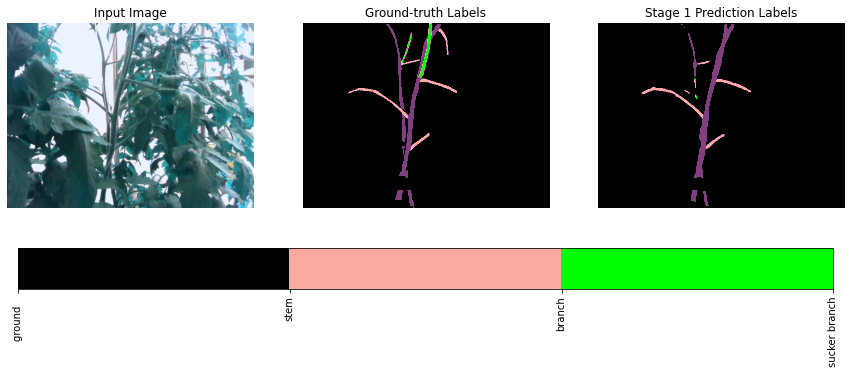

best val iou tensor(0.6328, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0228 mPA: 99.11% FPS: 787.7 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8420: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [11/40] Loss: 0.1916 mPA: 97.84% FPS: 885.3 Lr: 0.0000000000 sucker_t: 70.0 sucker_f: 10.5   IOU1: 0.6245 : 100%|██████████| 41/41 [00:15<00:00,  2.66it/s]


idx: 169
Val Loss: 0.1088 FPS: 121.7 IOU: 0.5449


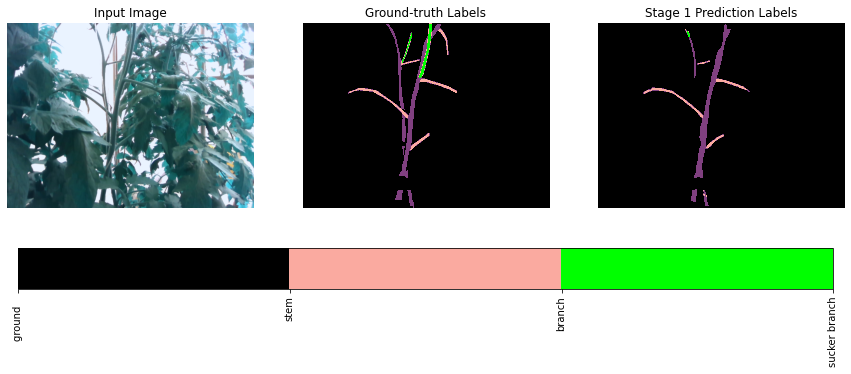

best val iou tensor(0.6328, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0215 mPA: 99.16% FPS: 762.9 Lr: 0.0007009631 sucker: 0.0000 IOU1: 0.8507: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [12/40] Loss: 0.1856 mPA: 97.79% FPS: 895.2 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 20.9   IOU1: 0.6307 : 100%|██████████| 41/41 [00:15<00:00,  2.64it/s]


idx: 169
Val Loss: 0.1117 FPS: 116.5 IOU: 0.5272


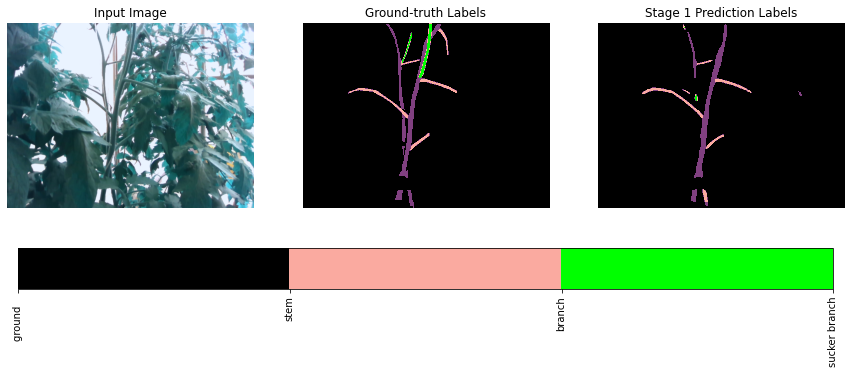

best val iou tensor(0.6328, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0203 mPA: 99.20% FPS: 761.2 Lr: 0.0006356452 sucker: 0.0000 IOU1: 0.8586: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [13/40] Loss: 0.1871 mPA: 97.79% FPS: 895.5 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 20.6   IOU1: 0.6315 : 100%|██████████| 41/41 [00:15<00:00,  2.64it/s]


idx: 169
Val Loss: 0.1088 FPS: 113.8 IOU: 0.5366


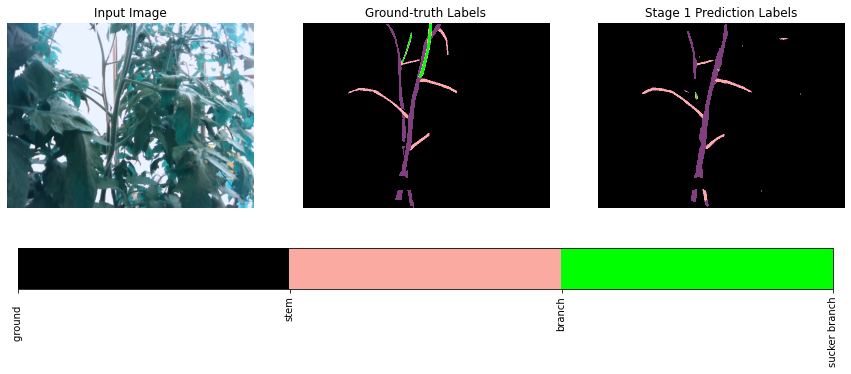

best val iou tensor(0.6328, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0195 mPA: 99.23% FPS: 751.0 Lr: 0.0005764139 sucker: 0.0000 IOU1: 0.8632: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [14/40] Loss: 0.1902 mPA: 97.77% FPS: 877.7 Lr: 0.0000000000 sucker_t: 72.0 sucker_f: 14.7   IOU1: 0.6237 : 100%|██████████| 41/41 [00:15<00:00,  2.65it/s]


idx: 169
Val Loss: 0.1171 FPS: 120.4 IOU: 0.5254


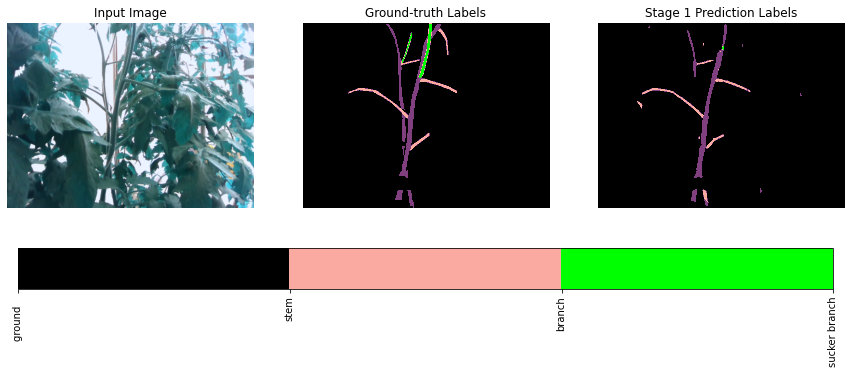

best val iou tensor(0.6328, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0185 mPA: 99.27% FPS: 749.7 Lr: 0.0005227019 sucker: 0.0000 IOU1: 0.8697: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [15/40] Loss: 0.2110 mPA: 97.85% FPS: 873.7 Lr: 0.0000000000 sucker_t: 75.7 sucker_f: 17.2   IOU1: 0.6335 : 100%|██████████| 41/41 [00:15<00:00,  2.66it/s]


idx: 169
Val Loss: 0.1178 FPS: 121.3 IOU: 0.5498


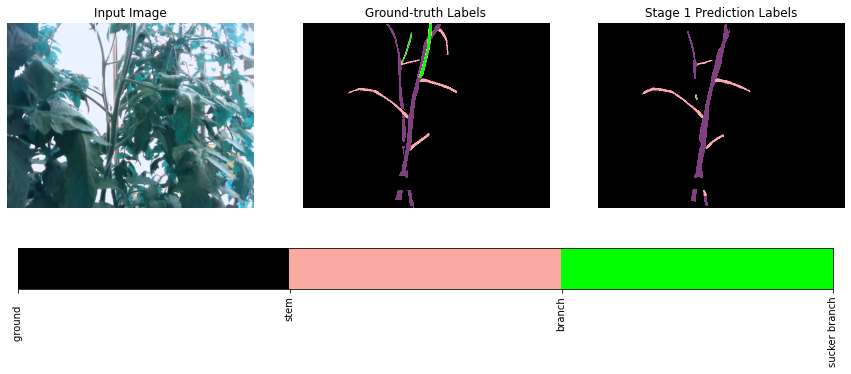

best val iou tensor(0.6335, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0179 mPA: 99.30% FPS: 752.3 Lr: 0.0004739949 sucker: 0.0000 IOU1: 0.8740: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [16/40] Loss: 0.2025 mPA: 97.76% FPS: 886.4 Lr: 0.0000000000 sucker_t: 80.9 sucker_f: 18.9   IOU1: 0.6340 : 100%|██████████| 41/41 [00:15<00:00,  2.65it/s]


idx: 169
Val Loss: 0.1136 FPS: 122.0 IOU: 0.5503


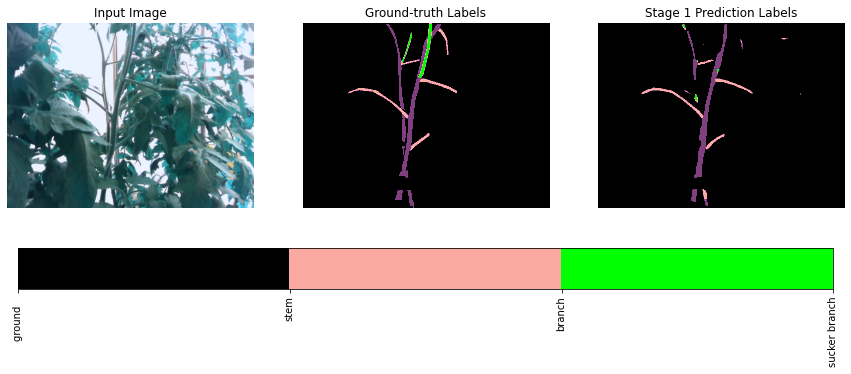

best val iou tensor(0.6340, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0174 mPA: 99.31% FPS: 754.7 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8766: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [17/40] Loss: 0.2061 mPA: 97.81% FPS: 869.3 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 17.1   IOU1: 0.6341 : 100%|██████████| 41/41 [00:15<00:00,  2.61it/s]


idx: 169
Val Loss: 0.1260 FPS: 102.9 IOU: 0.5368


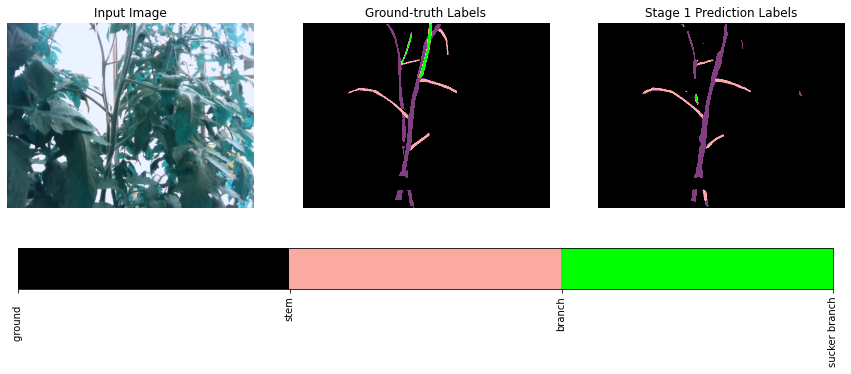

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0168 mPA: 99.34% FPS: 747.9 Lr: 0.0003897741 sucker: 0.0000 IOU1: 0.8807: 100%|██████████| 326/326 [03:06<00:00,  1.74it/s]


best_val


Train Epoch: [18/40] Loss: 0.2100 mPA: 97.80% FPS: 829.4 Lr: 0.0000000000 sucker_t: 73.9 sucker_f: 23.2   IOU1: 0.6292 : 100%|██████████| 41/41 [00:15<00:00,  2.60it/s]


idx: 169
Val Loss: 0.1115 FPS: 114.3 IOU: 0.5348


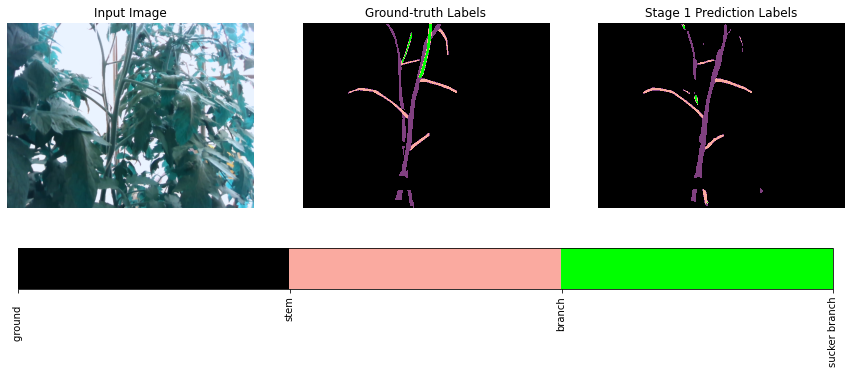

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0166 mPA: 99.34% FPS: 744.3 Lr: 0.0003534537 sucker: 0.0000 IOU1: 0.8808: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [19/40] Loss: 0.2246 mPA: 97.80% FPS: 862.8 Lr: 0.0000000000 sucker_t: 79.1 sucker_f: 22.7   IOU1: 0.6317 : 100%|██████████| 41/41 [00:15<00:00,  2.62it/s]


idx: 169
Val Loss: 0.1318 FPS: 120.9 IOU: 0.5363


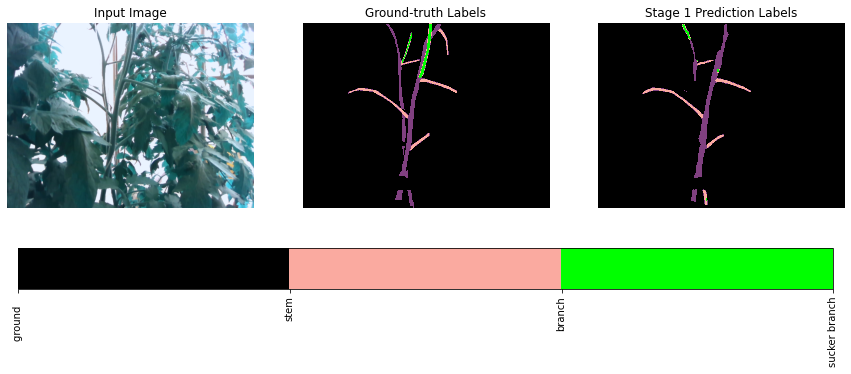

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0160 mPA: 99.37% FPS: 751.2 Lr: 0.0003205178 sucker: 0.0000 IOU1: 0.8852: 100%|██████████| 326/326 [03:06<00:00,  1.74it/s]


best_val


Train Epoch: [20/40] Loss: 0.2224 mPA: 97.81% FPS: 888.6 Lr: 0.0000000000 sucker_t: 79.4 sucker_f: 20.1   IOU1: 0.6331 : 100%|██████████| 41/41 [00:16<00:00,  2.56it/s]


idx: 169
Val Loss: 0.1189 FPS: 114.2 IOU: 0.5466


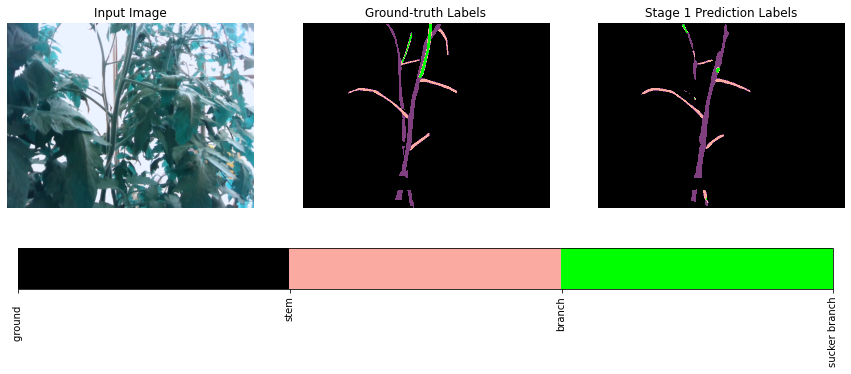

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0154 mPA: 99.39% FPS: 747.0 Lr: 0.0002906510 sucker: 0.0000 IOU1: 0.8894: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [21/40] Loss: 0.2289 mPA: 97.80% FPS: 841.5 Lr: 0.0000000000 sucker_t: 78.7 sucker_f: 23.7   IOU1: 0.6294 : 100%|██████████| 41/41 [00:15<00:00,  2.63it/s]


idx: 169
Val Loss: 0.1123 FPS: 82.9 IOU: 0.5366


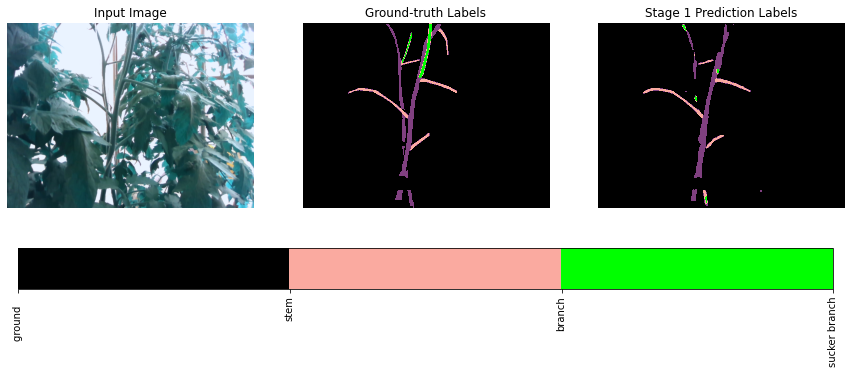

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0151 mPA: 99.40% FPS: 750.0 Lr: 0.0002635672 sucker: 0.0000 IOU1: 0.8907: 100%|██████████| 326/326 [03:06<00:00,  1.75it/s]


best_val


Train Epoch: [22/40] Loss: 0.2350 mPA: 97.81% FPS: 875.6 Lr: 0.0000000000 sucker_t: 77.4 sucker_f: 16.0   IOU1: 0.6325 : 100%|██████████| 41/41 [00:15<00:00,  2.64it/s]


idx: 169
Val Loss: 0.1518 FPS: 120.4 IOU: 0.5270


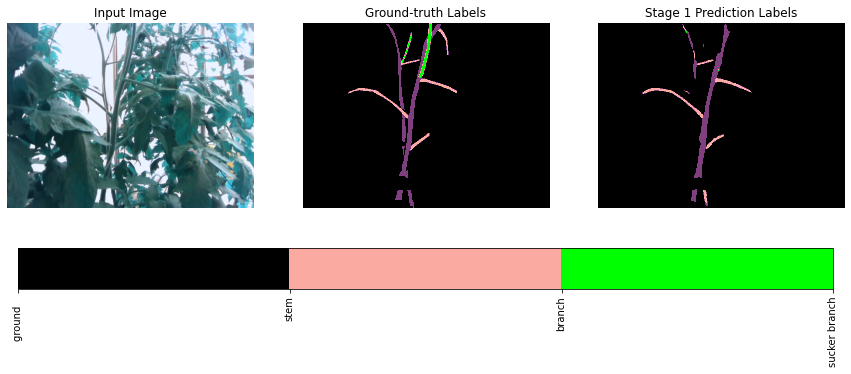

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0147 mPA: 99.41% FPS: 754.0 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.8934: 100%|██████████| 326/326 [03:06<00:00,  1.74it/s]


best_val


Train Epoch: [23/40] Loss: 0.2448 mPA: 97.77% FPS: 871.8 Lr: 0.0000000000 sucker_t: 79.6 sucker_f: 20.2   IOU1: 0.6299 : 100%|██████████| 41/41 [00:15<00:00,  2.64it/s]


idx: 169
Val Loss: 0.1466 FPS: 120.1 IOU: 0.5426


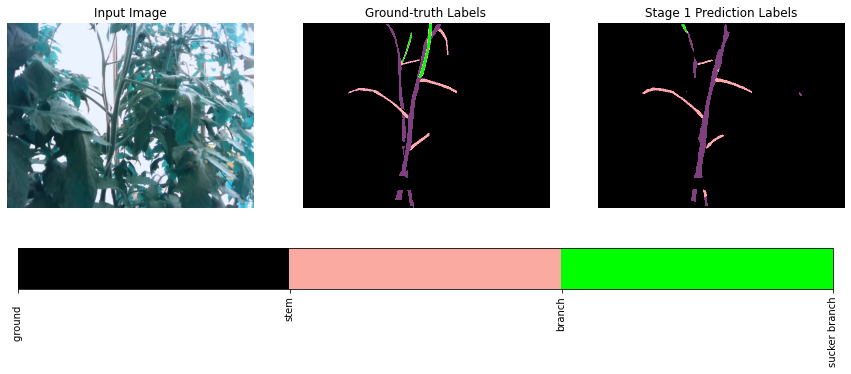

best val iou tensor(0.6341, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0155 mPA: 99.39% FPS: 701.7 Lr: 0.0002374348 sucker: 0.0000 IOU1: 0.8931:   7%|▋         | 22/326 [00:14<03:13,  1.57it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(17) #rain Epoch: [17/40] Loss: 0.2061 mPA: 97.81% FPS: 869.3 Lr: 0.0000000000 sucker_t: 76.5 sucker_f: 17.1   IOU1: 0.6341 : 100%

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/DLightNet_onestage_tomato_17.pth...


idx: 169
Val Loss: 0.1260 FPS: 115.8 IOU: 0.5368


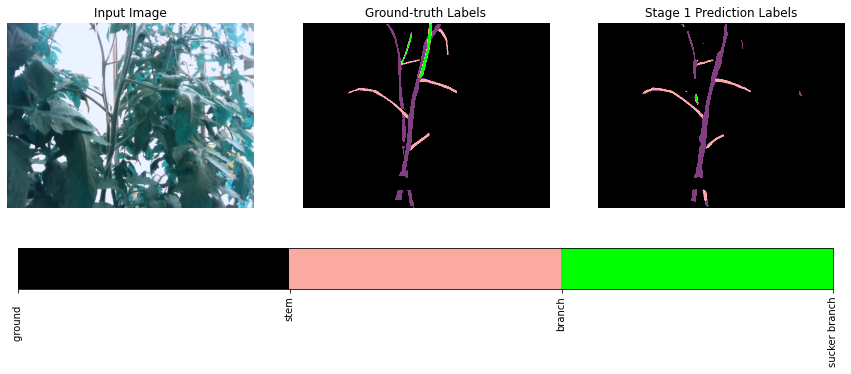

idx: 167
Val Loss: 0.1152 FPS: 119.8 IOU: 0.5564


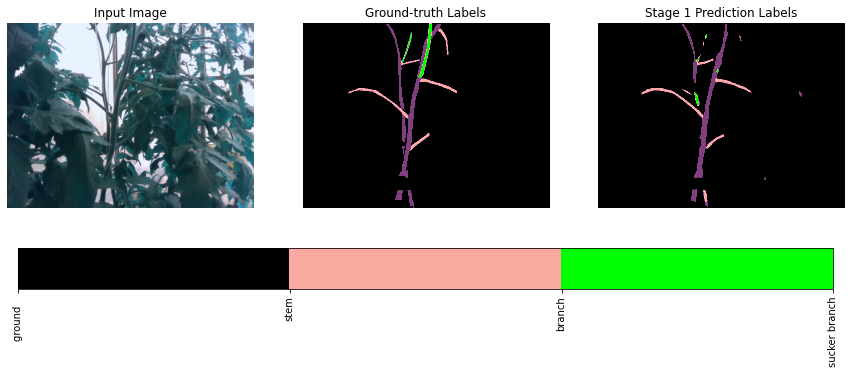

idx: 199
Val Loss: 0.1093 FPS: 120.8 IOU: 0.7271


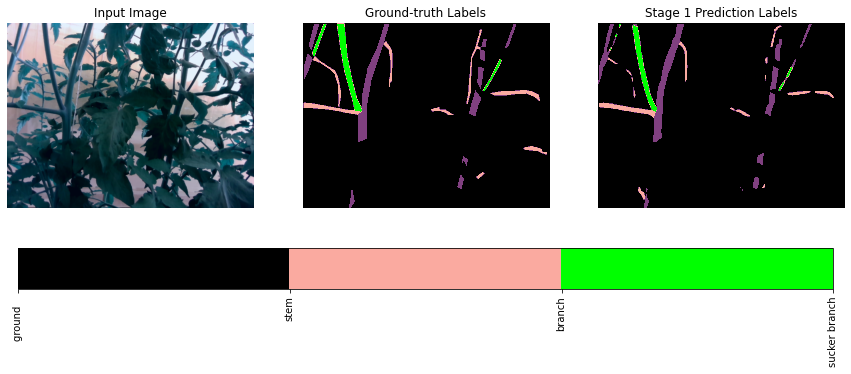

idx: 254
Val Loss: 0.0660 FPS: 110.6 IOU: 0.6408


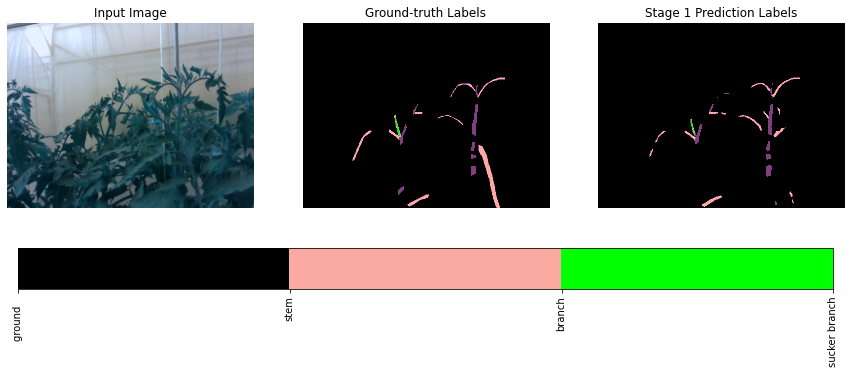

110.64721555385549

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.show_all_predict()

**FAST -SCNN**   # Train Epoch: [13/40] Loss: 0.2233 mPA: 97.33% FPS: 1284.2 Lr: 0.0000000000 sucker_t: 57.2 sucker_f: 24.1   IOU1: 0.5565 

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F


class LearningToDownSample(nn.Module):
    def __init__(self, in_channels):
        super().__init__()

        self.conv = ConvBlock(in_channels=in_channels, out_channels=32, stride=2)
        self.dsconv1 = nn.Sequential(
            # depthwise convolution
            nn.Conv2d(32, 32, kernel_size=3, stride=2, padding=1, dilation=1, groups=32, bias=False),
            nn.BatchNorm2d(32),
            # pointwise convolution
            nn.Conv2d(32, 48, kernel_size=1, stride=1, padding=0, dilation=1, groups=1, bias=False),
            nn.BatchNorm2d(48),
            nn.ReLU(inplace=True))
        self.dsconv2 = nn.Sequential(
            nn.Conv2d(48, 48, kernel_size=3, stride=2, padding=1, dilation=1, groups=48, bias=False),
            nn.BatchNorm2d(48),
            nn.Conv2d(48, 64, kernel_size=1, stride=1, padding=0, dilation=1, groups=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True))

    def forward(self, x):
        x = self.conv(x)
        x = self.dsconv1(x)
        x = self.dsconv2(x)
        return x


class GlobalFeatureExtractor(nn.Module):
    def __init__(self):
        super().__init__()

        self.first_block = nn.Sequential(Bottleneck(64, 64, 2, 6),
                                         Bottleneck(64, 64, 1, 6),
                                         Bottleneck(64, 64, 1, 6))
        self.second_block = nn.Sequential(Bottleneck(64, 96, 2, 6),
                                          Bottleneck(96, 96, 1, 6),
                                          Bottleneck(96, 96, 1, 6))
        self.third_block = nn.Sequential(Bottleneck(96, 128, 1, 6),
                                         Bottleneck(128, 128, 1, 6),
                                         Bottleneck(128, 128, 1, 6))
        self.ppm = PPMModule(128, 128)

    def forward(self, x):
        x = self.first_block(x)
        x = self.second_block(x)
        x = self.third_block(x)
        x = self.ppm(x)
        return x


class FeatureFusion(nn.Module):
    def __init__(self, scale_factor):
        super().__init__()

        self.scale_factor = scale_factor
        self.conv_high_res = nn.Conv2d(64, 128, kernel_size=1, stride=1, padding=0, bias=True)

        self.dwconv = ConvBlock(in_channels=128, out_channels=128, stride=1, padding=scale_factor,
                                dilation=scale_factor, groups=128)
        self.conv_low_res = nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, bias=True)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, high_res_input, low_res_input):
        low_res_input = F.interpolate(input=low_res_input, scale_factor=self.scale_factor, mode='bilinear',
                                      align_corners=True)
        low_res_input = self.dwconv(low_res_input)
        low_res_input = self.conv_low_res(low_res_input)

        high_res_input = self.conv_high_res(high_res_input)
        x = torch.add(high_res_input, low_res_input)
        return self.relu(x)


class Classifier(nn.Module):
    def __init__(self, num_classes, scale_factor):
        super().__init__()

        self.scale_factor = scale_factor
        self.dsconv1 = nn.Sequential(
            # depthwise convolution
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, dilation=1, groups=128, bias=False),
            nn.BatchNorm2d(128),
            # pointwise convolution
            nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, dilation=1, groups=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True))
        self.dsconv2 = nn.Sequential(
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, dilation=1, groups=128, bias=False),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 128, kernel_size=1, stride=1, padding=0, dilation=1, groups=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True))
        self.drop_out = nn.Dropout(p=0.1)
        self.conv = nn.Conv2d(128, num_classes, kernel_size=1, stride=1, padding=0, bias=True)

    def forward(self, x):
        x = self.dsconv1(x)
        x = self.dsconv2(x)
        x = self.drop_out(x)
        x = self.conv(x)
        x = F.interpolate(input=x, scale_factor=self.scale_factor, mode='bilinear', align_corners=True)
        return x


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padding=1, dilation=1, groups=1):
        super().__init__()

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding,
                              dilation=dilation, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, input):
        x = self.conv(input)
        return self.relu(self.bn(x))


class Bottleneck(nn.Module):
    def __init__(self, in_channels, out_channels, stride, expand_ratio):
        super().__init__()

        hidden_dim = in_channels * expand_ratio
        self.use_res_connect = stride == 1 and in_channels == out_channels

        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, hidden_dim, 1, 1, 0, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(inplace=True),
            # depthwise convolution
            nn.Conv2d(hidden_dim, hidden_dim, 3, stride, 1, groups=hidden_dim, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(inplace=True),
            # pw-linear
            nn.Conv2d(hidden_dim, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels))

    def forward(self, x):
        if self.use_res_connect:
            return x + self.conv(x)
        else:
            return self.conv(x)


class PPMModule(nn.Module):
    def __init__(self, in_channels, out_channels, sizes=(1, 2, 3, 6)):
        super().__init__()

        inter_channels = in_channels // len(sizes)
        assert in_channels % len(sizes) == 0

        self.stages = nn.ModuleList([self._make_stage(in_channels, inter_channels, size) for size in sizes])
        self.conv = ConvBlock(in_channels * 2, out_channels, kernel_size=1, stride=1, padding=0)

    def _make_stage(self, in_channels, inter_channels, size):
        prior = nn.AdaptiveAvgPool2d(output_size=(size, size))
        conv = ConvBlock(in_channels, inter_channels, kernel_size=1, stride=1, padding=0)
        return nn.Sequential(prior, conv)

    def forward(self, feats):
        h, w = feats.size(2), feats.size(3)
        priors = [F.interpolate(input=stage(feats), size=(h, w), mode='bilinear',
                                align_corners=True) for stage in self.stages] + [feats]
        bottle = self.conv(torch.cat(priors, dim=1))
        return bottle

class FastSCNN2(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()

        self.learning_to_down_sample = LearningToDownSample(in_channels)
        self.global_feature_extractor = GlobalFeatureExtractor()
        self.feature_fusion = FeatureFusion(scale_factor=4)
        self.classifier = Classifier(num_classes, scale_factor=8)

    def forward(self, x):
        shared = self.learning_to_down_sample(x)
        x = self.global_feature_extractor(shared)
        x = self.feature_fusion(shared, x)
        x = self.classifier(x)
        return x


In [ ]:
trainer = Trainner( FastSCNN2,'FastSCNN2',18,isdepth=False,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


In [ ]:
trainer.summary()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 240, 320]             864
       BatchNorm2d-2         [-1, 32, 240, 320]              64
              ReLU-3         [-1, 32, 240, 320]               0
         ConvBlock-4         [-1, 32, 240, 320]               0
            Conv2d-5         [-1, 32, 120, 160]             288
       BatchNorm2d-6         [-1, 32, 120, 160]              64
            Conv2d-7         [-1, 48, 120, 160]           1,536
       BatchNorm2d-8         [-1, 48, 120, 160]              96
              ReLU-9         [-1, 48, 120, 160]               0
           Conv2d-10           [-1, 48, 60, 80]             432
      BatchNorm2d-11           [-1, 48, 60, 80]              96
           Conv2d-12           [-1, 64, 60, 80]           3,072
      BatchNorm2d-13           [-1, 64, 60, 80]             128
             ReLU-14           [-1, 64,

In [ ]:
from prettytable import PrettyTable

def count_parameters(model):
    table = PrettyTable(["Modules", "Parameters"])
    total_params = 0
    for name, parameter in model.named_parameters():
        if not parameter.requires_grad: continue
        param = parameter.numel()
        table.add_row([name, param])
        total_params+=param
    print(table)
    print(f"Total Trainable Params: {total_params}")
    return total_params
    
count_parameters(trainer.model)

+-------------------------------------------------------+------------+
|                        Modules                        | Parameters |
+-------------------------------------------------------+------------+
|        learning_to_down_sample.conv.conv.weight       |    864     |
|         learning_to_down_sample.conv.bn.weight        |     32     |
|          learning_to_down_sample.conv.bn.bias         |     32     |
|        learning_to_down_sample.dsconv1.0.weight       |    288     |
|        learning_to_down_sample.dsconv1.1.weight       |     32     |
|         learning_to_down_sample.dsconv1.1.bias        |     32     |
|        learning_to_down_sample.dsconv1.2.weight       |    1536    |
|        learning_to_down_sample.dsconv1.3.weight       |     48     |
|         learning_to_down_sample.dsconv1.3.bias        |     48     |
|        learning_to_down_sample.dsconv2.0.weight       |    432     |
|        learning_to_down_sample.dsconv2.1.weight       |     48     |
|     

1135604

In [ ]:
def sizemodel(model):
  mem_params = sum([param.nelement()*param.element_size() for param in model.parameters()])
  mem_bufs = sum([buf.nelement()*buf.element_size() for buf in model.buffers()])
  mem = mem_params + mem_bufs # in bytes
  print('mem size:',mem)
sizemodel(trainer.model)

mem size: 4635424


Train Epoch: [0/40] Loss: 0.1516 mPA: 96.22% FPS: 905.0 Lr: 0.0023417088 sucker: 0.0000 IOU1: 0.3485: 100%|██████████| 218/218 [01:06<00:00,  3.28it/s]


best_val


Train Epoch: [0/40] Loss: 0.2316 mPA: 96.61% FPS: 1248.0 Lr: 0.0000000000 sucker_t: 22.8 sucker_f: 50.7   IOU1: 0.4077 : 100%|██████████| 28/28 [00:12<00:00,  2.20it/s]


idx: 169
Val Loss: 0.1166 FPS: 92.2 IOU: 0.3426


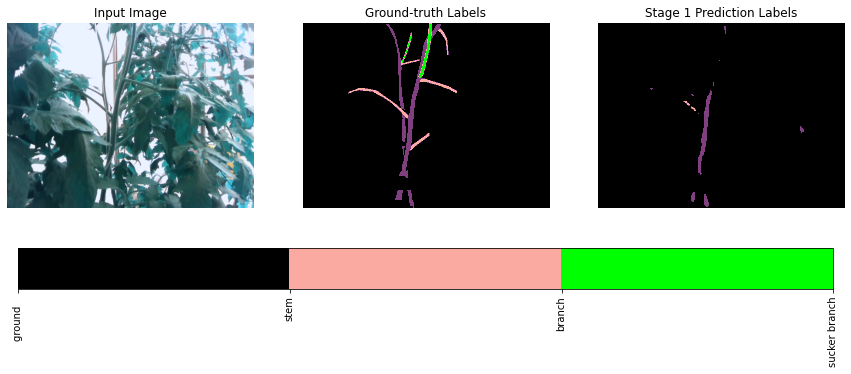

best val iou tensor(0.4077, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0889 mPA: 97.17% FPS: 953.0 Lr: 0.0021934400 sucker: 0.0000 IOU1: 0.4965: 100%|██████████| 218/218 [01:01<00:00,  3.53it/s]


best_val


Train Epoch: [1/40] Loss: 0.2081 mPA: 97.00% FPS: 1283.9 Lr: 0.0000000000 sucker_t: 31.7 sucker_f: 35.3   IOU1: 0.4586 : 100%|██████████| 28/28 [00:12<00:00,  2.24it/s]


idx: 169
Val Loss: 0.0947 FPS: 120.8 IOU: 0.3990


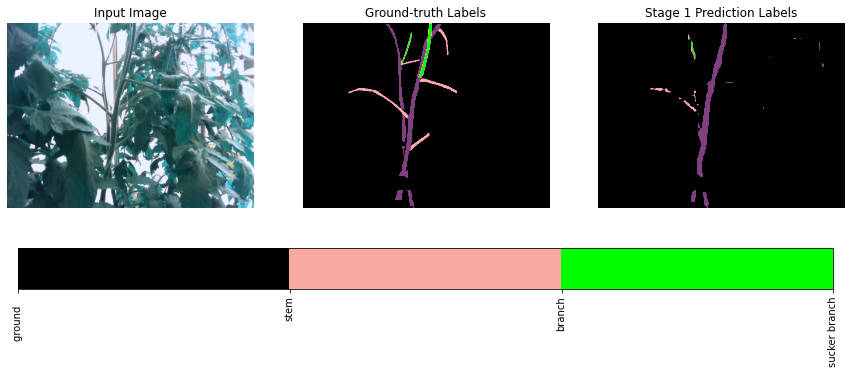

best val iou tensor(0.4586, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0746 mPA: 97.49% FPS: 934.4 Lr: 0.0020545591 sucker: 0.0000 IOU1: 0.5695: 100%|██████████| 218/218 [01:01<00:00,  3.52it/s]


best_val


Train Epoch: [2/40] Loss: 0.1866 mPA: 97.15% FPS: 1266.3 Lr: 0.0000000000 sucker_t: 39.6 sucker_f: 37.5   IOU1: 0.4990 : 100%|██████████| 28/28 [00:12<00:00,  2.22it/s]


idx: 169
Val Loss: 0.1108 FPS: 117.6 IOU: 0.4030


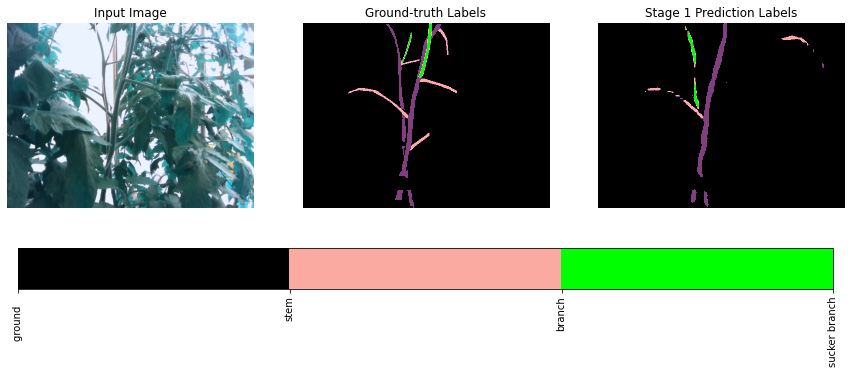

best val iou tensor(0.4990, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0619 mPA: 97.82% FPS: 951.0 Lr: 0.0019244717 sucker: 0.0000 IOU1: 0.6301: 100%|██████████| 218/218 [01:02<00:00,  3.50it/s]


best_val


Train Epoch: [3/40] Loss: 0.1802 mPA: 97.23% FPS: 1265.0 Lr: 0.0000000000 sucker_t: 47.4 sucker_f: 34.0   IOU1: 0.5226 : 100%|██████████| 28/28 [00:12<00:00,  2.21it/s]


idx: 169
Val Loss: 0.1179 FPS: 126.6 IOU: 0.4141


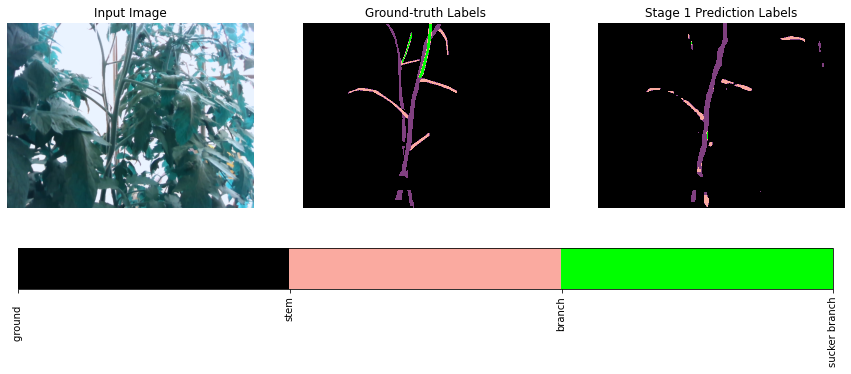

best val iou tensor(0.5226, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0545 mPA: 98.02% FPS: 951.2 Lr: 0.0018026209 sucker: 0.0000 IOU1: 0.6689: 100%|██████████| 218/218 [01:02<00:00,  3.50it/s]


best_val


Train Epoch: [4/40] Loss: 0.1771 mPA: 97.29% FPS: 1280.7 Lr: 0.0000000000 sucker_t: 48.9 sucker_f: 24.3   IOU1: 0.5381 : 100%|██████████| 28/28 [00:13<00:00,  2.10it/s]


idx: 169
Val Loss: 0.1061 FPS: 121.2 IOU: 0.4356


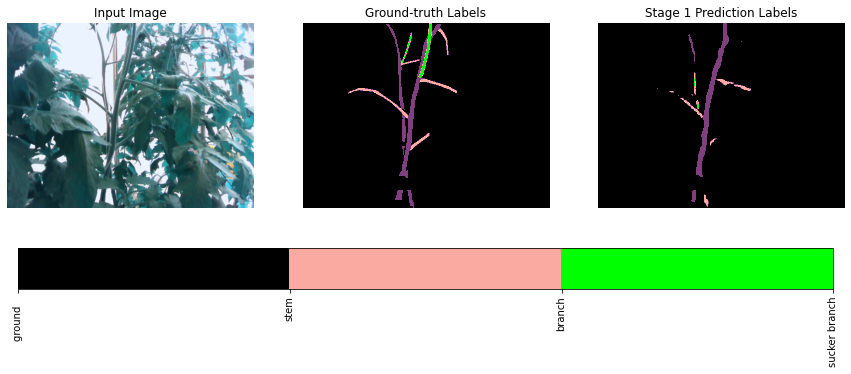

best val iou tensor(0.5381, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0481 mPA: 98.21% FPS: 961.2 Lr: 0.0016884853 sucker: 0.0000 IOU1: 0.7011: 100%|██████████| 218/218 [01:04<00:00,  3.39it/s]


best_val


Train Epoch: [5/40] Loss: 0.1827 mPA: 97.30% FPS: 1299.2 Lr: 0.0000000000 sucker_t: 48.9 sucker_f: 34.7   IOU1: 0.5316 : 100%|██████████| 28/28 [00:13<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1035 FPS: 123.2 IOU: 0.4612


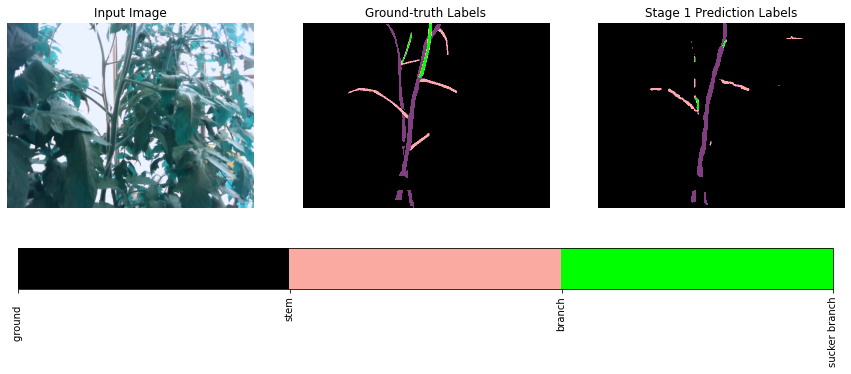

best val iou tensor(0.5381, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0446 mPA: 98.31% FPS: 979.0 Lr: 0.0015815764 sucker: 0.0000 IOU1: 0.7187: 100%|██████████| 218/218 [01:03<00:00,  3.44it/s]


best_val


Train Epoch: [6/40] Loss: 0.2017 mPA: 97.35% FPS: 1288.8 Lr: 0.0000000000 sucker_t: 55.0 sucker_f: 30.8   IOU1: 0.5407 : 100%|██████████| 28/28 [00:12<00:00,  2.18it/s]


idx: 169
Val Loss: 0.1221 FPS: 125.0 IOU: 0.4028


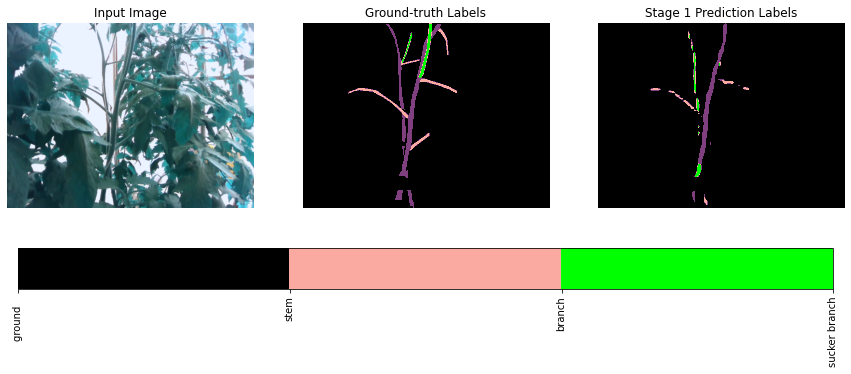

best val iou tensor(0.5407, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0399 mPA: 98.46% FPS: 974.5 Lr: 0.0014814365 sucker: 0.0000 IOU1: 0.7432: 100%|██████████| 218/218 [01:03<00:00,  3.42it/s]


best_val


Train Epoch: [7/40] Loss: 0.2018 mPA: 97.34% FPS: 1289.1 Lr: 0.0000000000 sucker_t: 56.1 sucker_f: 21.4   IOU1: 0.5478 : 100%|██████████| 28/28 [00:12<00:00,  2.17it/s]


idx: 169
Val Loss: 0.1378 FPS: 124.4 IOU: 0.4145


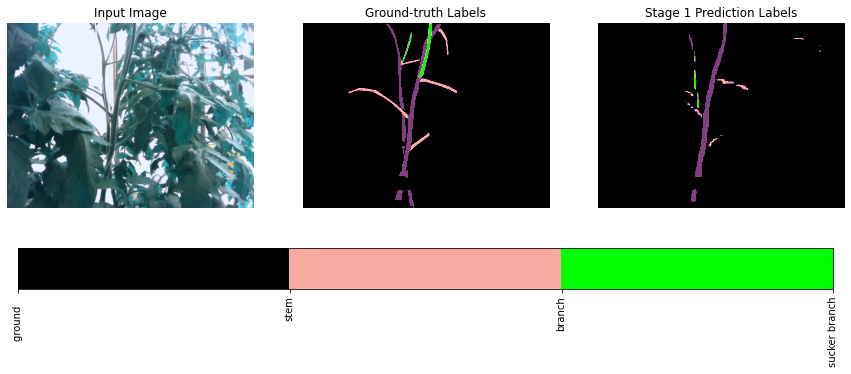

best val iou tensor(0.5478, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0374 mPA: 98.55% FPS: 965.1 Lr: 0.0013876372 sucker: 0.0000 IOU1: 0.7543: 100%|██████████| 218/218 [01:04<00:00,  3.40it/s]


best_val


Train Epoch: [8/40] Loss: 0.1962 mPA: 97.40% FPS: 1249.5 Lr: 0.0000000000 sucker_t: 56.5 sucker_f: 27.8   IOU1: 0.5548 : 100%|██████████| 28/28 [00:12<00:00,  2.20it/s]


idx: 169
Val Loss: 0.1267 FPS: 107.0 IOU: 0.4075


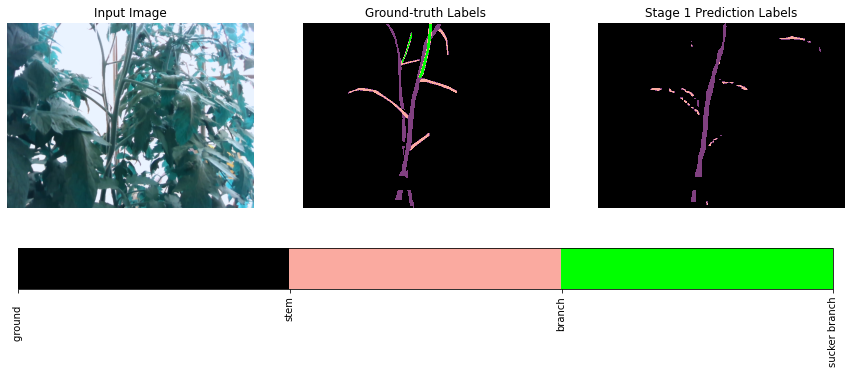

best val iou tensor(0.5548, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0344 mPA: 98.65% FPS: 981.7 Lr: 0.0012997769 sucker: 0.0000 IOU1: 0.7732: 100%|██████████| 218/218 [01:03<00:00,  3.45it/s]


best_val


Train Epoch: [9/40] Loss: 0.1950 mPA: 97.21% FPS: 1289.6 Lr: 0.0000000000 sucker_t: 60.2 sucker_f: 31.8   IOU1: 0.5555 : 100%|██████████| 28/28 [00:13<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1244 FPS: 123.2 IOU: 0.4450


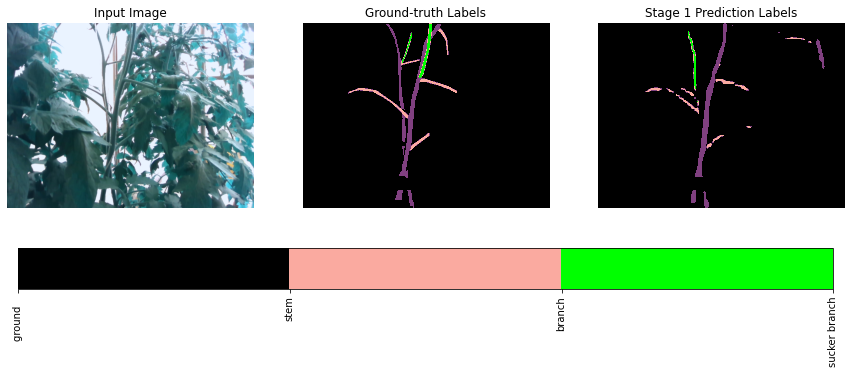

best val iou tensor(0.5555, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0322 mPA: 98.72% FPS: 987.0 Lr: 0.0012174796 sucker: 0.0000 IOU1: 0.7838: 100%|██████████| 218/218 [01:03<00:00,  3.45it/s]


best_val


Train Epoch: [10/40] Loss: 0.2011 mPA: 97.37% FPS: 1231.1 Lr: 0.0000000000 sucker_t: 57.6 sucker_f: 31.2   IOU1: 0.5493 : 100%|██████████| 28/28 [00:12<00:00,  2.17it/s]


idx: 169
Val Loss: 0.1406 FPS: 121.1 IOU: 0.4253


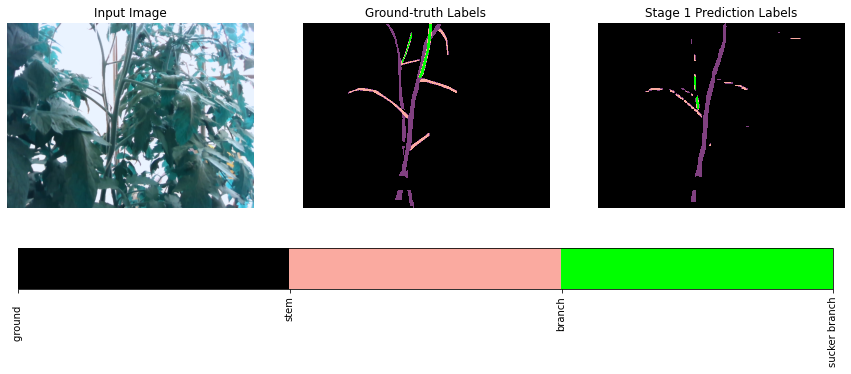

best val iou tensor(0.5555, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0305 mPA: 98.78% FPS: 956.4 Lr: 0.0011403931 sucker: 0.0000 IOU1: 0.7933: 100%|██████████| 218/218 [01:04<00:00,  3.38it/s]


best_val


Train Epoch: [11/40] Loss: 0.2232 mPA: 97.29% FPS: 1290.7 Lr: 0.0000000000 sucker_t: 54.4 sucker_f: 27.6   IOU1: 0.5443 : 100%|██████████| 28/28 [00:12<00:00,  2.20it/s]


idx: 169
Val Loss: 0.1351 FPS: 125.6 IOU: 0.4436


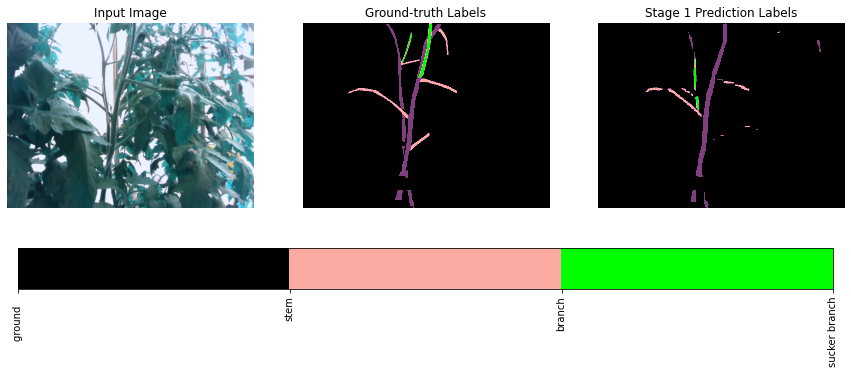

best val iou tensor(0.5555, device='cuda:0')


Train Epoch: [12/40] Loss: 0.0292 mPA: 98.83% FPS: 962.3 Lr: 0.0010681874 sucker: 0.0000 IOU1: 0.8009: 100%|██████████| 218/218 [01:04<00:00,  3.40it/s]


best_val


Train Epoch: [12/40] Loss: 0.2281 mPA: 97.32% FPS: 1263.1 Lr: 0.0000000000 sucker_t: 53.3 sucker_f: 19.9   IOU1: 0.5509 : 100%|██████████| 28/28 [00:12<00:00,  2.18it/s]


idx: 169
Val Loss: 0.1496 FPS: 120.1 IOU: 0.4408


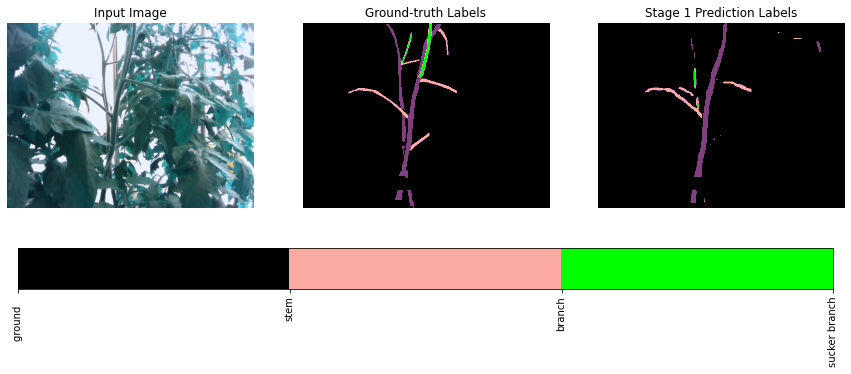

best val iou tensor(0.5555, device='cuda:0')


Train Epoch: [13/40] Loss: 0.0277 mPA: 98.88% FPS: 964.9 Lr: 0.0010005535 sucker: 0.0000 IOU1: 0.8085: 100%|██████████| 218/218 [01:04<00:00,  3.36it/s]


best_val


Train Epoch: [13/40] Loss: 0.2233 mPA: 97.33% FPS: 1284.2 Lr: 0.0000000000 sucker_t: 57.2 sucker_f: 24.1   IOU1: 0.5565 : 100%|██████████| 28/28 [00:13<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1647 FPS: 125.5 IOU: 0.4395


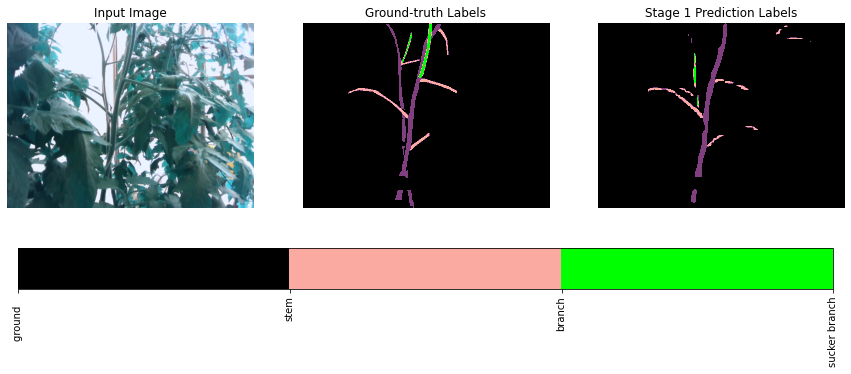

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [14/40] Loss: 0.0267 mPA: 98.92% FPS: 949.7 Lr: 0.0009372020 sucker: 0.0000 IOU1: 0.8141: 100%|██████████| 218/218 [01:05<00:00,  3.34it/s]


best_val


Train Epoch: [14/40] Loss: 0.2462 mPA: 97.36% FPS: 1243.9 Lr: 0.0000000000 sucker_t: 53.0 sucker_f: 21.2   IOU1: 0.5489 : 100%|██████████| 28/28 [00:13<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1443 FPS: 117.0 IOU: 0.4390


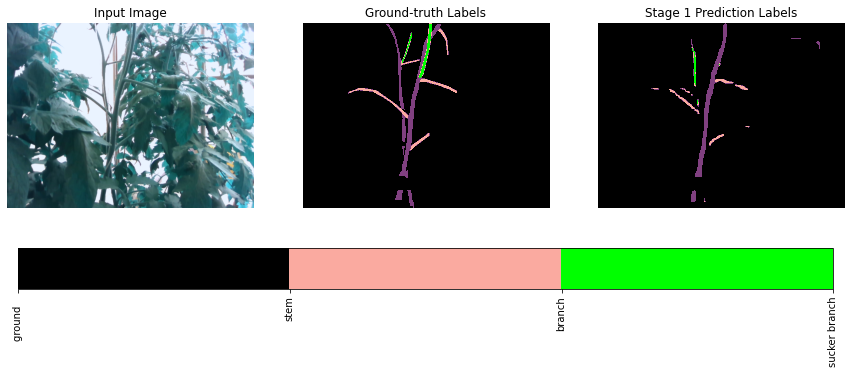

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [15/40] Loss: 0.0257 mPA: 98.96% FPS: 928.8 Lr: 0.0008778617 sucker: 0.0000 IOU1: 0.8204: 100%|██████████| 218/218 [01:05<00:00,  3.32it/s]


best_val


Train Epoch: [15/40] Loss: 0.2328 mPA: 97.29% FPS: 1254.6 Lr: 0.0000000000 sucker_t: 55.2 sucker_f: 29.9   IOU1: 0.5543 : 100%|██████████| 28/28 [00:13<00:00,  2.13it/s]


idx: 169
Val Loss: 0.1653 FPS: 112.0 IOU: 0.4355


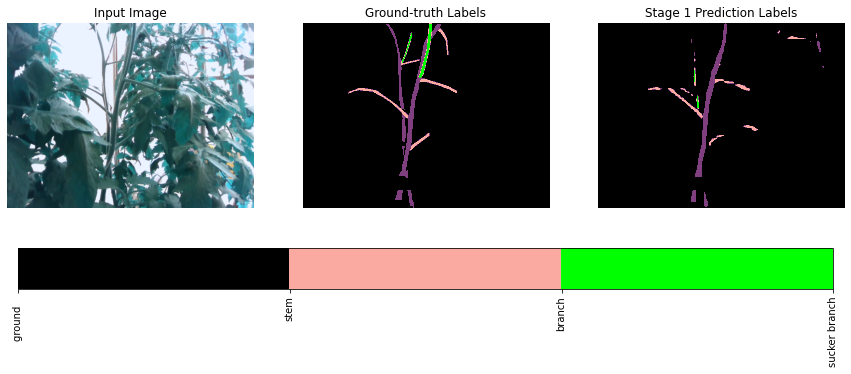

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [16/40] Loss: 0.0247 mPA: 98.99% FPS: 934.1 Lr: 0.0008222786 sucker: 0.0000 IOU1: 0.8260: 100%|██████████| 218/218 [01:04<00:00,  3.36it/s]


best_val


Train Epoch: [16/40] Loss: 0.2565 mPA: 97.33% FPS: 1252.6 Lr: 0.0000000000 sucker_t: 49.8 sucker_f: 24.7   IOU1: 0.5504 : 100%|██████████| 28/28 [00:13<00:00,  2.11it/s]


idx: 169
Val Loss: 0.1727 FPS: 114.8 IOU: 0.4284


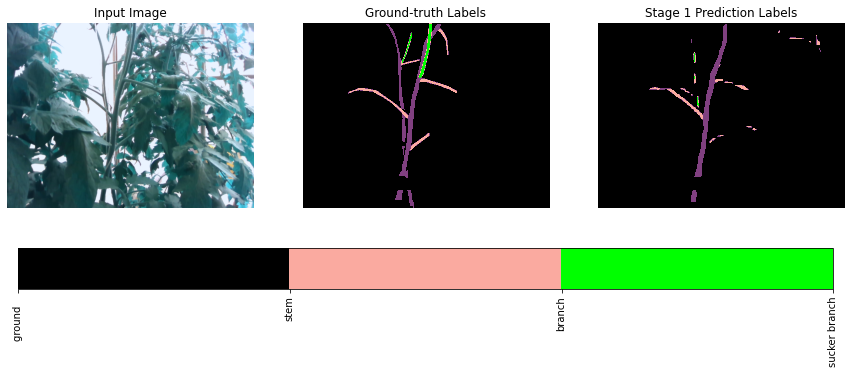

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [17/40] Loss: 0.0239 mPA: 99.02% FPS: 925.2 Lr: 0.0007702148 sucker: 0.0000 IOU1: 0.8300: 100%|██████████| 218/218 [01:04<00:00,  3.38it/s]


best_val


Train Epoch: [17/40] Loss: 0.2515 mPA: 97.30% FPS: 1295.0 Lr: 0.0000000000 sucker_t: 53.3 sucker_f: 29.6   IOU1: 0.5487 : 100%|██████████| 28/28 [00:12<00:00,  2.21it/s]


idx: 169
Val Loss: 0.1661 FPS: 122.6 IOU: 0.4424


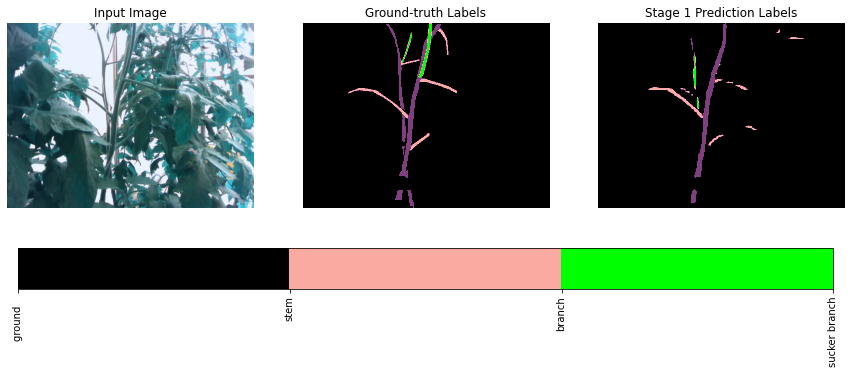

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [18/40] Loss: 0.0232 mPA: 99.05% FPS: 930.9 Lr: 0.0007214475 sucker: 0.0000 IOU1: 0.8345: 100%|██████████| 218/218 [01:05<00:00,  3.34it/s]


best_val


Train Epoch: [18/40] Loss: 0.2520 mPA: 97.33% FPS: 1206.9 Lr: 0.0000000000 sucker_t: 57.0 sucker_f: 25.9   IOU1: 0.5470 : 100%|██████████| 28/28 [00:13<00:00,  2.11it/s]


idx: 169
Val Loss: 0.1778 FPS: 123.0 IOU: 0.4296


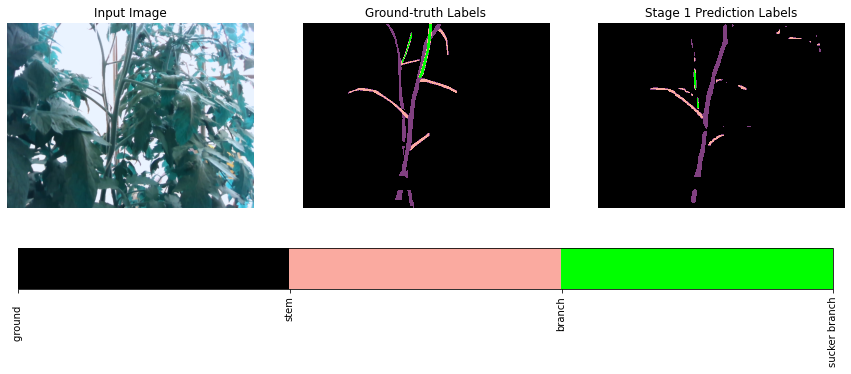

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [19/40] Loss: 0.0225 mPA: 99.08% FPS: 899.9 Lr: 0.0006757680 sucker: 0.0000 IOU1: 0.8387: 100%|██████████| 218/218 [01:06<00:00,  3.29it/s]


best_val


Train Epoch: [19/40] Loss: 0.2814 mPA: 97.29% FPS: 1204.4 Lr: 0.0000000000 sucker_t: 52.0 sucker_f: 22.5   IOU1: 0.5482 : 100%|██████████| 28/28 [00:12<00:00,  2.16it/s]


idx: 169
Val Loss: 0.1918 FPS: 109.1 IOU: 0.4274


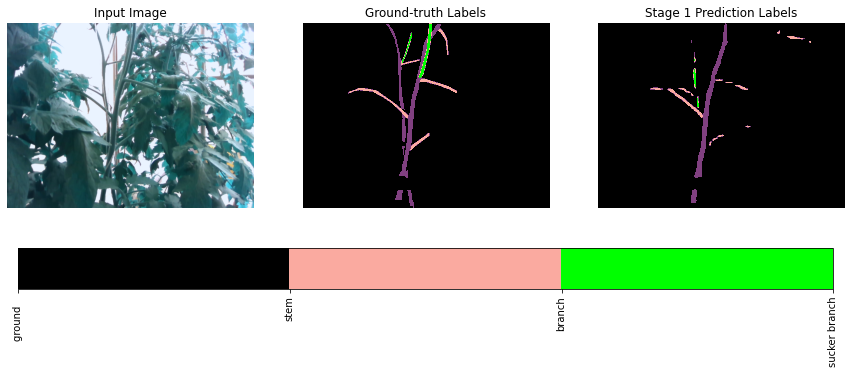

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [20/40] Loss: 0.0219 mPA: 99.10% FPS: 935.7 Lr: 0.0006329807 sucker: 0.0000 IOU1: 0.8426: 100%|██████████| 218/218 [01:06<00:00,  3.30it/s]


best_val


Train Epoch: [20/40] Loss: 0.2793 mPA: 97.29% FPS: 1245.3 Lr: 0.0000000000 sucker_t: 52.6 sucker_f: 23.3   IOU1: 0.5474 : 100%|██████████| 28/28 [00:13<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1759 FPS: 118.6 IOU: 0.4308


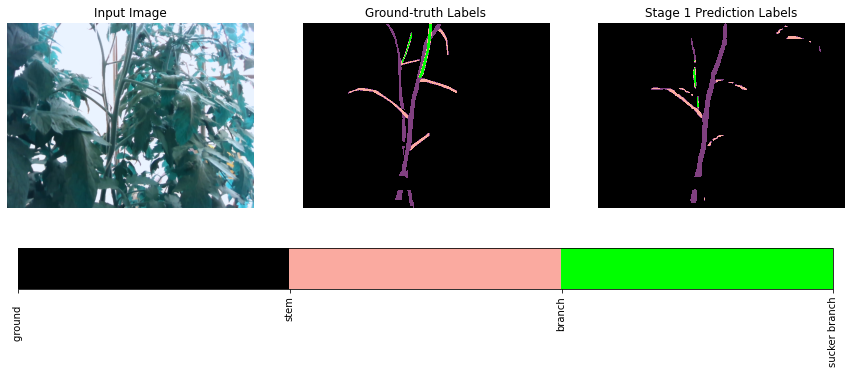

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [21/40] Loss: 0.0212 mPA: 99.13% FPS: 911.9 Lr: 0.0005929026 sucker: 0.0000 IOU1: 0.8466: 100%|██████████| 218/218 [01:06<00:00,  3.28it/s]


best_val


Train Epoch: [21/40] Loss: 0.2871 mPA: 97.33% FPS: 1200.9 Lr: 0.0000000000 sucker_t: 50.6 sucker_f: 24.9   IOU1: 0.5475 : 100%|██████████| 28/28 [00:12<00:00,  2.17it/s]


idx: 169
Val Loss: 0.1903 FPS: 111.8 IOU: 0.4325


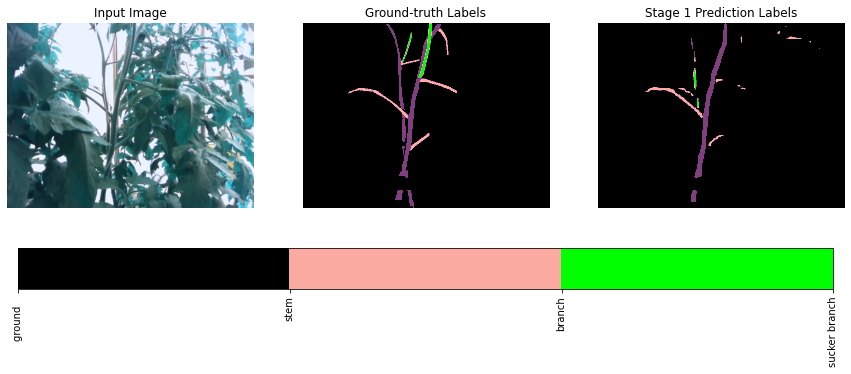

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [22/40] Loss: 0.0208 mPA: 99.14% FPS: 907.2 Lr: 0.0005553621 sucker: 0.0000 IOU1: 0.8495: 100%|██████████| 218/218 [01:06<00:00,  3.27it/s]


best_val


Train Epoch: [22/40] Loss: 0.2864 mPA: 97.28% FPS: 1239.1 Lr: 0.0000000000 sucker_t: 53.1 sucker_f: 23.9   IOU1: 0.5512 : 100%|██████████| 28/28 [00:13<00:00,  2.14it/s]


idx: 169
Val Loss: 0.1910 FPS: 116.0 IOU: 0.4272


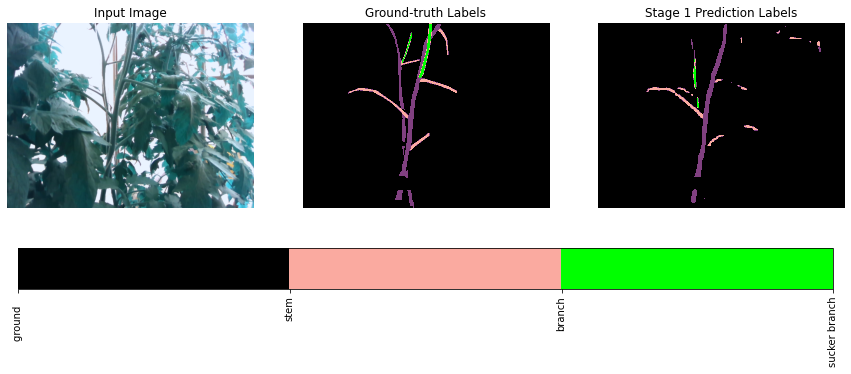

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [23/40] Loss: 0.0203 mPA: 99.16% FPS: 936.9 Lr: 0.0005201985 sucker: 0.0000 IOU1: 0.8519: 100%|██████████| 218/218 [01:06<00:00,  3.26it/s]


best_val


Train Epoch: [23/40] Loss: 0.2828 mPA: 97.28% FPS: 1219.0 Lr: 0.0000000000 sucker_t: 49.6 sucker_f: 24.5   IOU1: 0.5486 : 100%|██████████| 28/28 [00:12<00:00,  2.16it/s]


idx: 169
Val Loss: 0.1936 FPS: 120.5 IOU: 0.4482


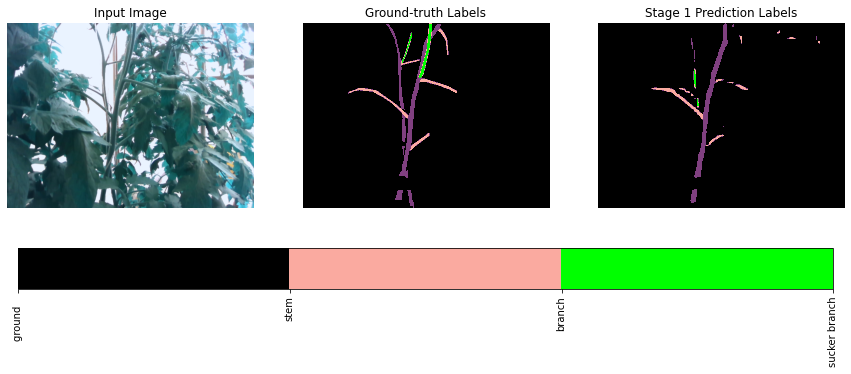

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [24/40] Loss: 0.0199 mPA: 99.18% FPS: 925.9 Lr: 0.0004872614 sucker: 0.0000 IOU1: 0.8546: 100%|██████████| 218/218 [01:07<00:00,  3.25it/s]


best_val


Train Epoch: [24/40] Loss: 0.2987 mPA: 97.28% FPS: 1279.6 Lr: 0.0000000000 sucker_t: 50.6 sucker_f: 24.5   IOU1: 0.5471 : 100%|██████████| 28/28 [00:13<00:00,  2.15it/s]


idx: 169
Val Loss: 0.1958 FPS: 109.9 IOU: 0.4376


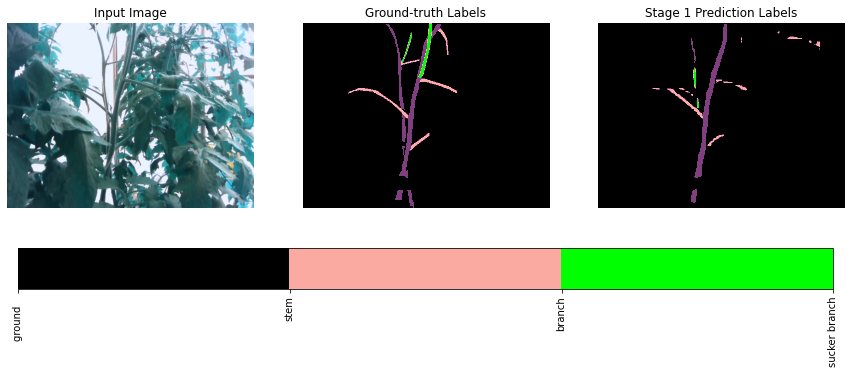

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [25/40] Loss: 0.0195 mPA: 99.20% FPS: 910.0 Lr: 0.0004564097 sucker: 0.0000 IOU1: 0.8572: 100%|██████████| 218/218 [01:07<00:00,  3.24it/s]


best_val


Train Epoch: [25/40] Loss: 0.2982 mPA: 97.30% FPS: 1193.5 Lr: 0.0000000000 sucker_t: 48.9 sucker_f: 25.7   IOU1: 0.5457 : 100%|██████████| 28/28 [00:12<00:00,  2.19it/s]


idx: 169
Val Loss: 0.1937 FPS: 131.1 IOU: 0.4307


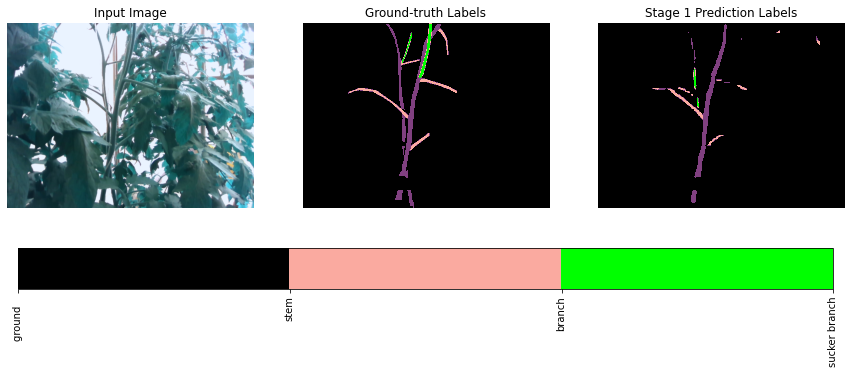

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [26/40] Loss: 0.0191 mPA: 99.21% FPS: 914.6 Lr: 0.0004275115 sucker: 0.0000 IOU1: 0.8598: 100%|██████████| 218/218 [01:06<00:00,  3.26it/s]


best_val


Train Epoch: [26/40] Loss: 0.2912 mPA: 97.25% FPS: 1222.5 Lr: 0.0000000000 sucker_t: 48.9 sucker_f: 30.4   IOU1: 0.5476 : 100%|██████████| 28/28 [00:13<00:00,  2.10it/s]


idx: 169
Val Loss: 0.2046 FPS: 112.9 IOU: 0.4417


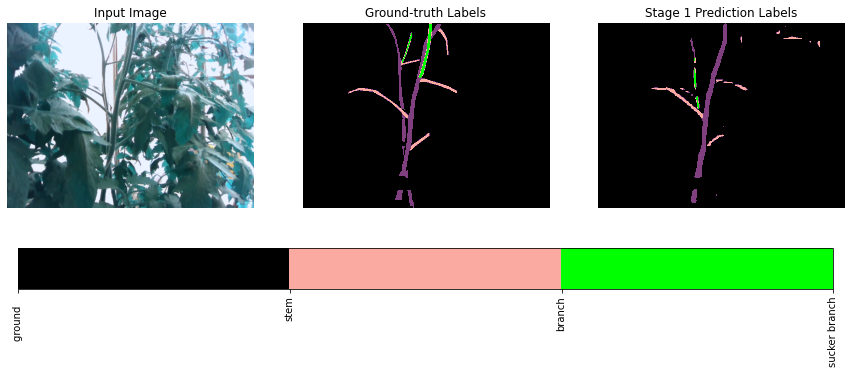

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [27/40] Loss: 0.0187 mPA: 99.23% FPS: 907.4 Lr: 0.0004004429 sucker: 0.0000 IOU1: 0.8617: 100%|██████████| 218/218 [01:07<00:00,  3.25it/s]


best_val


Train Epoch: [27/40] Loss: 0.3042 mPA: 97.28% FPS: 1256.1 Lr: 0.0000000000 sucker_t: 50.4 sucker_f: 25.3   IOU1: 0.5457 : 100%|██████████| 28/28 [00:12<00:00,  2.19it/s]


idx: 169
Val Loss: 0.2082 FPS: 101.5 IOU: 0.4388


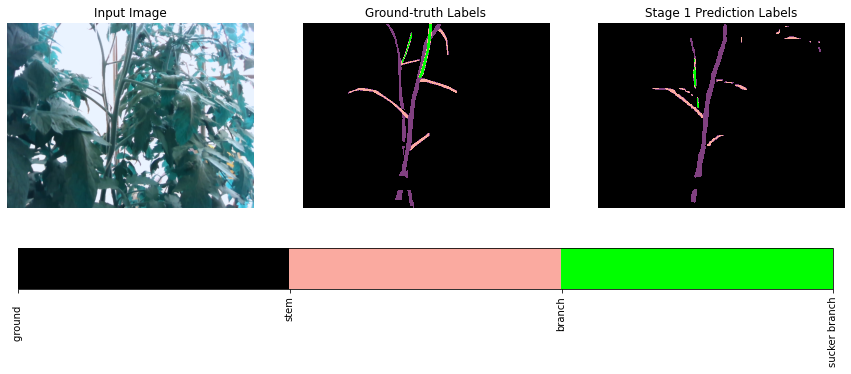

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [28/40] Loss: 0.0185 mPA: 99.23% FPS: 918.0 Lr: 0.0003750883 sucker: 0.0000 IOU1: 0.8629: 100%|██████████| 218/218 [01:07<00:00,  3.24it/s]


best_val


Train Epoch: [28/40] Loss: 0.3083 mPA: 97.24% FPS: 1248.6 Lr: 0.0000000000 sucker_t: 50.0 sucker_f: 23.5   IOU1: 0.5460 : 100%|██████████| 28/28 [00:12<00:00,  2.20it/s]


idx: 169
Val Loss: 0.2062 FPS: 122.7 IOU: 0.4413


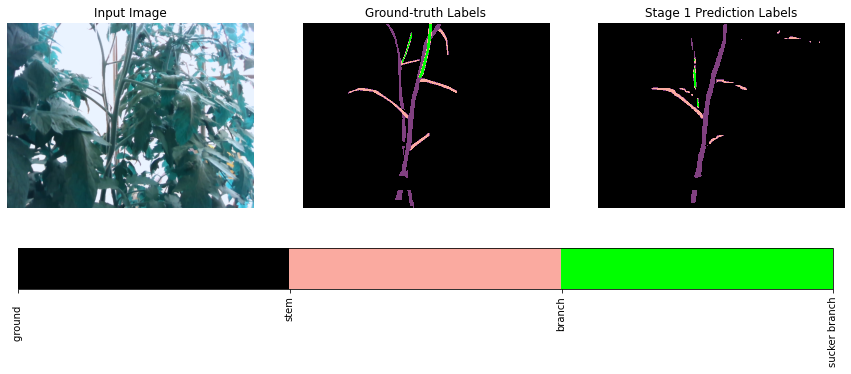

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [29/40] Loss: 0.0181 mPA: 99.25% FPS: 902.2 Lr: 0.0003513390 sucker: 0.0000 IOU1: 0.8658: 100%|██████████| 218/218 [01:07<00:00,  3.22it/s]


best_val


Train Epoch: [29/40] Loss: 0.3200 mPA: 97.25% FPS: 1247.8 Lr: 0.0000000000 sucker_t: 48.5 sucker_f: 28.3   IOU1: 0.5427 : 100%|██████████| 28/28 [00:13<00:00,  2.12it/s]


idx: 169
Val Loss: 0.2062 FPS: 126.6 IOU: 0.4397


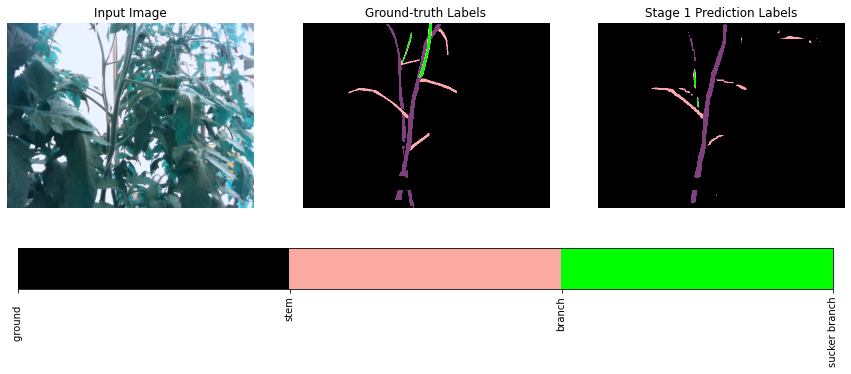

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [30/40] Loss: 0.0180 mPA: 99.25% FPS: 910.9 Lr: 0.0003290935 sucker: 0.0000 IOU1: 0.8664: 100%|██████████| 218/218 [01:07<00:00,  3.21it/s]


best_val


Train Epoch: [30/40] Loss: 0.3214 mPA: 97.27% FPS: 1169.0 Lr: 0.0000000000 sucker_t: 50.2 sucker_f: 26.9   IOU1: 0.5433 : 100%|██████████| 28/28 [00:13<00:00,  2.12it/s]


idx: 169
Val Loss: 0.2296 FPS: 122.2 IOU: 0.4334


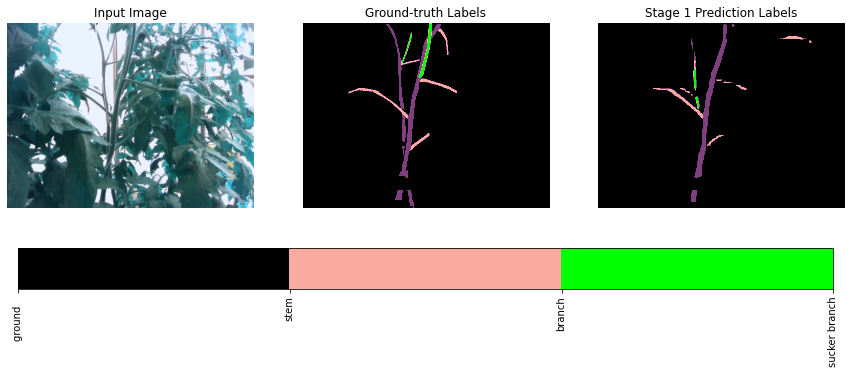

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [31/40] Loss: 0.0176 mPA: 99.27% FPS: 887.6 Lr: 0.0003082564 sucker: 0.0000 IOU1: 0.8691: 100%|██████████| 218/218 [01:08<00:00,  3.20it/s]


best_val


Train Epoch: [31/40] Loss: 0.3243 mPA: 97.28% FPS: 1170.0 Lr: 0.0000000000 sucker_t: 47.6 sucker_f: 26.9   IOU1: 0.5464 : 100%|██████████| 28/28 [00:12<00:00,  2.18it/s]


idx: 169
Val Loss: 0.2270 FPS: 126.4 IOU: 0.4352


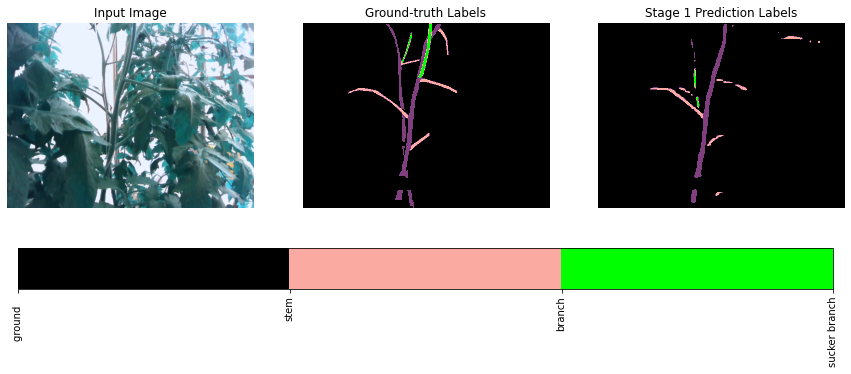

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [32/40] Loss: 0.0174 mPA: 99.28% FPS: 865.2 Lr: 0.0002887387 sucker: 0.0000 IOU1: 0.8701: 100%|██████████| 218/218 [01:08<00:00,  3.19it/s]


best_val


Train Epoch: [32/40] Loss: 0.3352 mPA: 97.25% FPS: 1210.2 Lr: 0.0000000000 sucker_t: 53.1 sucker_f: 27.0   IOU1: 0.5432 : 100%|██████████| 28/28 [00:12<00:00,  2.16it/s]


idx: 169
Val Loss: 0.2192 FPS: 87.6 IOU: 0.4326


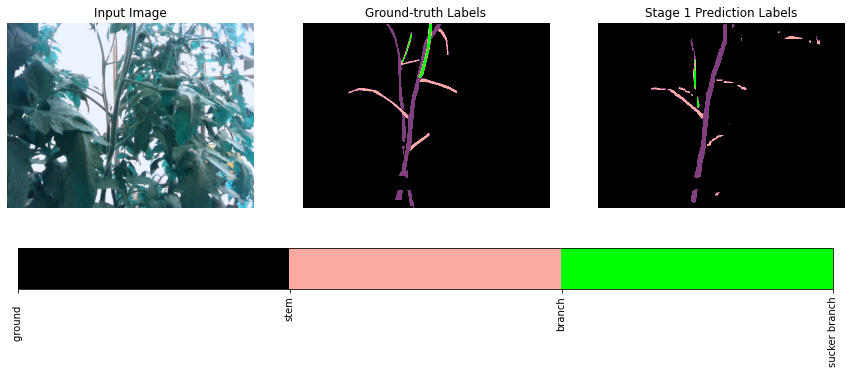

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [33/40] Loss: 0.0171 mPA: 99.29% FPS: 909.1 Lr: 0.0002704568 sucker: 0.0000 IOU1: 0.8716: 100%|██████████| 218/218 [01:07<00:00,  3.22it/s]


best_val


Train Epoch: [33/40] Loss: 0.3412 mPA: 97.27% FPS: 1203.6 Lr: 0.0000000000 sucker_t: 50.2 sucker_f: 23.8   IOU1: 0.5429 : 100%|██████████| 28/28 [00:12<00:00,  2.19it/s]


idx: 169
Val Loss: 0.2296 FPS: 115.8 IOU: 0.4363


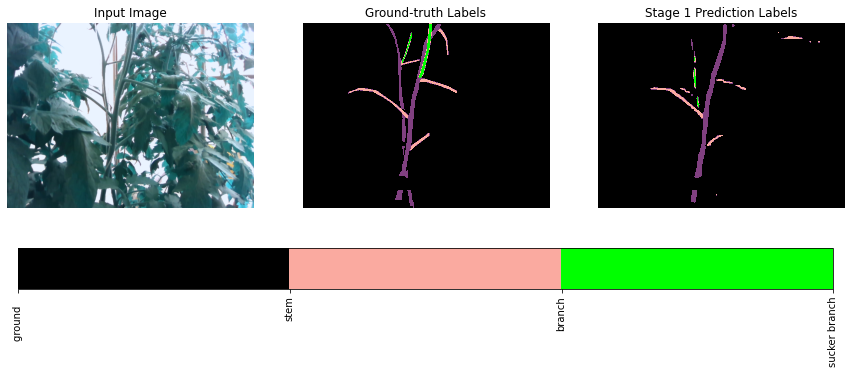

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [34/40] Loss: 0.0169 mPA: 99.30% FPS: 896.7 Lr: 0.0002533324 sucker: 0.0000 IOU1: 0.8734: 100%|██████████| 218/218 [01:07<00:00,  3.22it/s]


best_val


Train Epoch: [34/40] Loss: 0.3382 mPA: 97.24% FPS: 1303.2 Lr: 0.0000000000 sucker_t: 47.4 sucker_f: 25.4   IOU1: 0.5422 : 100%|██████████| 28/28 [00:12<00:00,  2.19it/s]


idx: 169
Val Loss: 0.2278 FPS: 95.8 IOU: 0.4426


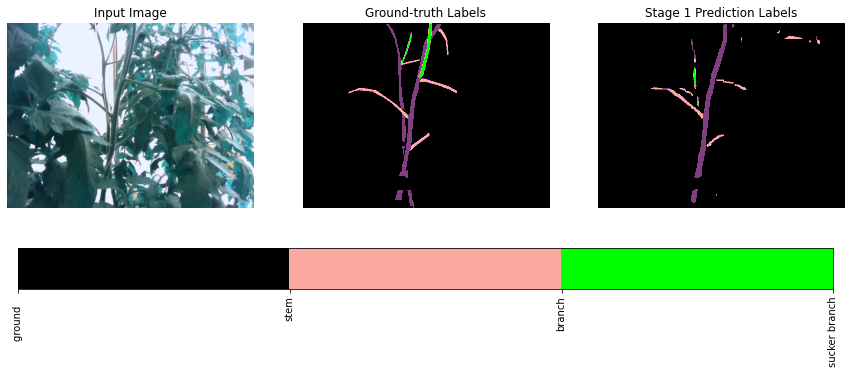

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [35/40] Loss: 0.0167 mPA: 99.31% FPS: 917.7 Lr: 0.0002372923 sucker: 0.0000 IOU1: 0.8749: 100%|██████████| 218/218 [01:09<00:00,  3.15it/s]


best_val


Train Epoch: [35/40] Loss: 0.3503 mPA: 97.25% FPS: 1094.8 Lr: 0.0000000000 sucker_t: 52.4 sucker_f: 27.8   IOU1: 0.5442 : 100%|██████████| 28/28 [00:13<00:00,  2.13it/s]


idx: 169
Val Loss: 0.2293 FPS: 120.2 IOU: 0.4379


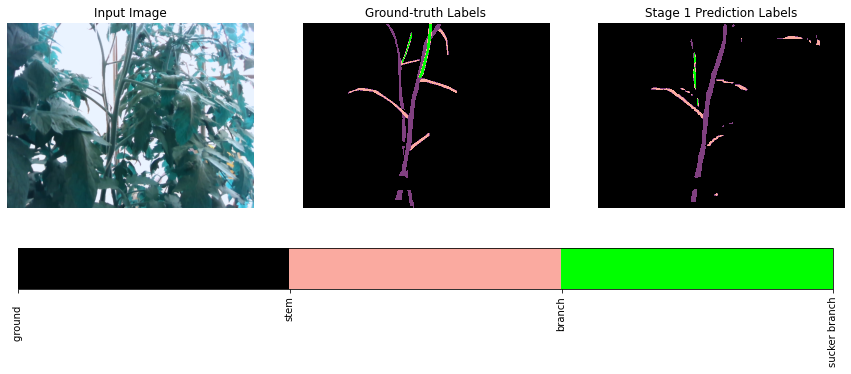

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [36/40] Loss: 0.0166 mPA: 99.31% FPS: 934.8 Lr: 0.0002222678 sucker: 0.0000 IOU1: 0.8761: 100%|██████████| 218/218 [01:08<00:00,  3.16it/s]


best_val


Train Epoch: [36/40] Loss: 0.3530 mPA: 97.25% FPS: 1265.5 Lr: 0.0000000000 sucker_t: 49.1 sucker_f: 22.8   IOU1: 0.5412 : 100%|██████████| 28/28 [00:12<00:00,  2.16it/s]


idx: 169
Val Loss: 0.2326 FPS: 102.3 IOU: 0.4351


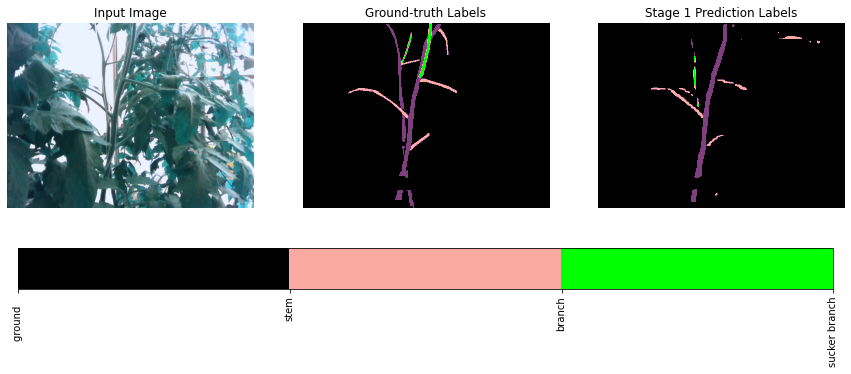

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [37/40] Loss: 0.0164 mPA: 99.32% FPS: 885.8 Lr: 0.0002081946 sucker: 0.0000 IOU1: 0.8771: 100%|██████████| 218/218 [01:09<00:00,  3.13it/s]


best_val


Train Epoch: [37/40] Loss: 0.3669 mPA: 97.24% FPS: 1131.5 Lr: 0.0000000000 sucker_t: 48.7 sucker_f: 27.5   IOU1: 0.5410 : 100%|██████████| 28/28 [00:13<00:00,  2.11it/s]


idx: 169
Val Loss: 0.2373 FPS: 109.2 IOU: 0.4362


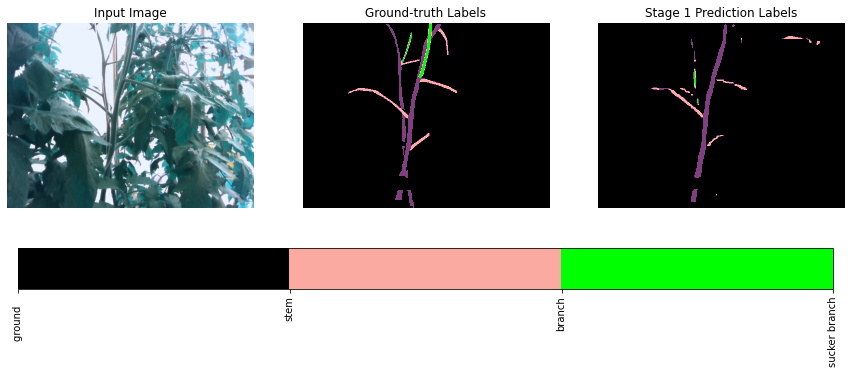

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [38/40] Loss: 0.0162 mPA: 99.33% FPS: 889.9 Lr: 0.0001950124 sucker: 0.0000 IOU1: 0.8780: 100%|██████████| 218/218 [01:09<00:00,  3.12it/s]


best_val


Train Epoch: [38/40] Loss: 0.3638 mPA: 97.24% FPS: 1218.2 Lr: 0.0000000000 sucker_t: 47.8 sucker_f: 26.1   IOU1: 0.5383 : 100%|██████████| 28/28 [00:13<00:00,  2.14it/s]


idx: 169
Val Loss: 0.2459 FPS: 95.2 IOU: 0.4342


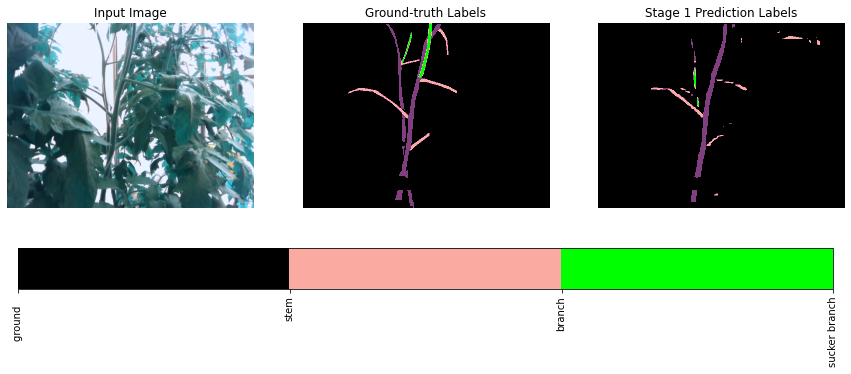

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [39/40] Loss: 0.0160 mPA: 99.33% FPS: 899.3 Lr: 0.0001826649 sucker: 0.0000 IOU1: 0.8791: 100%|██████████| 218/218 [01:10<00:00,  3.10it/s]


best_val


Train Epoch: [39/40] Loss: 0.3713 mPA: 97.24% FPS: 1175.2 Lr: 0.0000000000 sucker_t: 51.5 sucker_f: 28.5   IOU1: 0.5416 : 100%|██████████| 28/28 [00:13<00:00,  2.12it/s]


idx: 169
Val Loss: 0.2531 FPS: 124.9 IOU: 0.4320


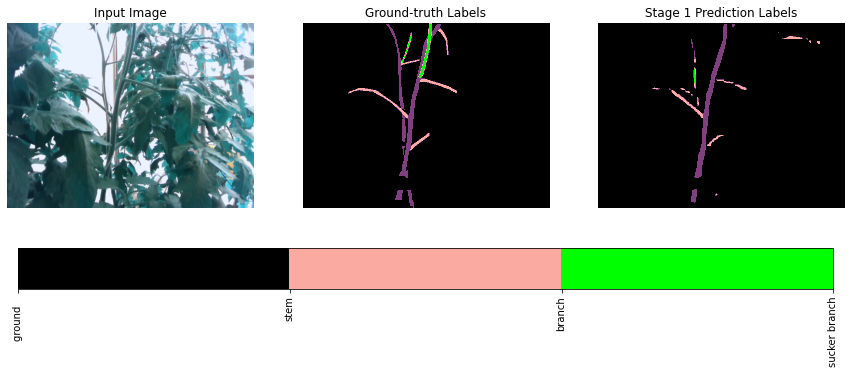

best val iou tensor(0.5565, device='cuda:0')


Train Epoch: [40/40] Loss: 0.0159 mPA: 99.34% FPS: 873.6 Lr: 0.0001710992 sucker: 0.0000 IOU1: 0.8793: 100%|██████████| 218/218 [01:09<00:00,  3.15it/s]


best_val


Train Epoch: [40/40] Loss: 0.3724 mPA: 97.22% FPS: 1240.5 Lr: 0.0000000000 sucker_t: 50.4 sucker_f: 29.0   IOU1: 0.5401 : 100%|██████████| 28/28 [00:13<00:00,  2.14it/s]


idx: 169
Val Loss: 0.2548 FPS: 124.0 IOU: 0.4280


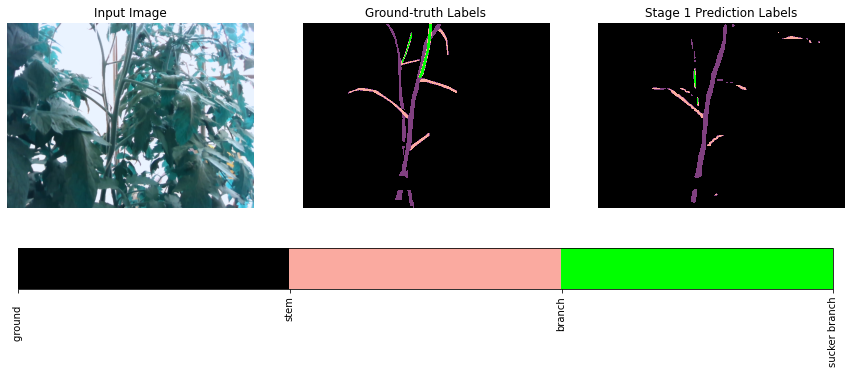

best val iou tensor(0.5565, device='cuda:0')


In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(13) # Train Epoch: [13/40] Loss: 0.2233 mPA: 97.33% FPS: 1284.2 Lr: 0.0000000000 sucker_t: 57.2 sucker_f: 24.1   IOU1: 0.5565 

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/FastSCNN2_tomato_13.pth...


idx: 169


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work on Python 2 you can use the builtin `int` for which `np.compat.long` is itself an alias. Doing this will not modify any behaviour and is safe. When replacing `np.long`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


Val Loss: 0.1647 FPS: 4.6 IOU: 0.4395


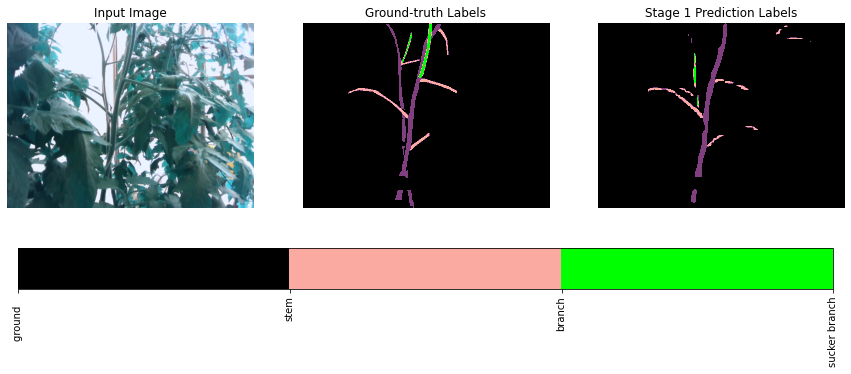

idx: 167
Val Loss: 0.1465 FPS: 191.7 IOU: 0.4455


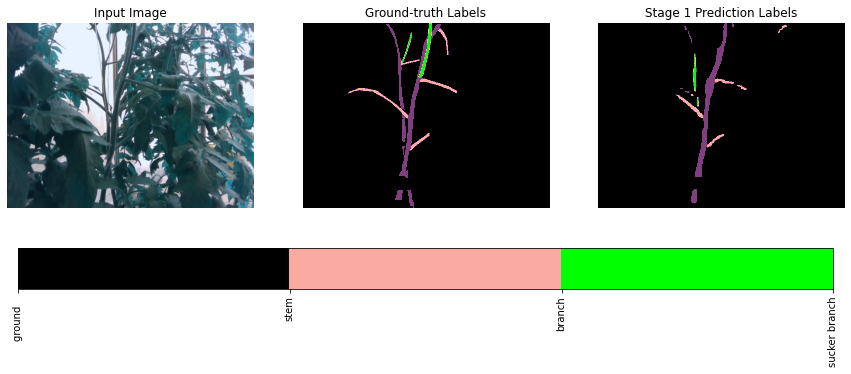

idx: 199
Val Loss: 0.1251 FPS: 192.5 IOU: 0.6867


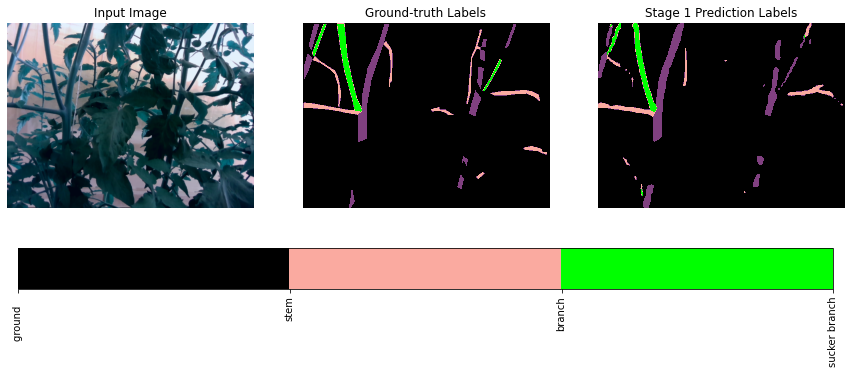

idx: 254
Val Loss: 0.0956 FPS: 179.4 IOU: 0.5010


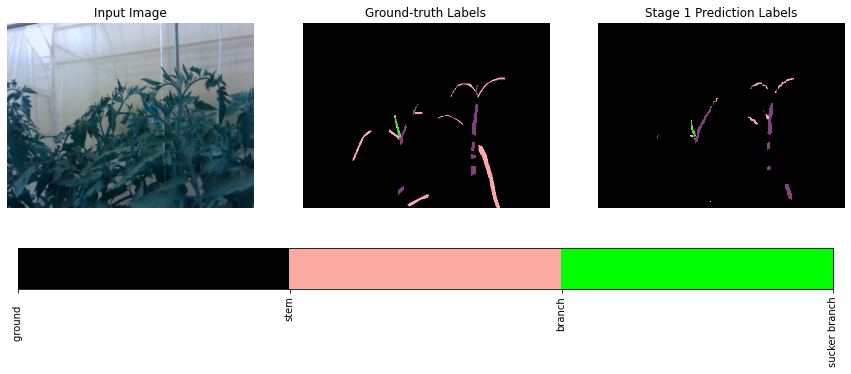

179.42011378705564

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.show_all_predict()

**DEEPLAB V3**
#[4/40] Loss: 0.2022 mPA: 98.02% FPS: 155.0 Lr: 0.0000000000 sucker_t: 82.6 sucker_f: 13.6   IOU1: 0.6388 :
#[5/40] Loss: 0.2136 mPA: 98.03% FPS: 153.0 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 12.2   IOU1: 0.6379

In [ ]:
from torchvision.models.segmentation.segmentation import deeplabv3_resnet50
from torchvision.models.segmentation.deeplabv3 import DeepLabHead
from torchvision.models.segmentation import deeplabv3_resnet101

def custom_DeepLabv3(in_channels, num_classes):
  model = deeplabv3_resnet50(pretrained=True, progress=True)
  model.classifier = DeepLabHead(2048, num_classes)

  #Set the model in training mode
  model.train()
  return model

In [ ]:
trainer = Trainner( custom_DeepLabv3,'custom_DeepLabv3',2,isdepth=False,num_output = 1)  

path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset
path /content/drive/MyDrive/colab/images/depthdataset


Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth


  0%|          | 0.00/161M [00:00<?, ?B/s]

In [ ]:
trainer.summary()

In [ ]:
trainer.load_weight_best()

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/custom_DeepLabv3_tomato_best_model.pth...


  0%|          | 0/1956 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work on Python 2 you can use the builtin `int` for which `np.compat.long` is itself an alias. Doing this will not modify any behaviour and is safe. When replacing `np.long`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work

best_val


  0%|          | 0/245 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work on Python 2 you can use the builtin `int` for which `np.compat.long` is itself an alias. Doing this will not modify any behaviour and is safe. When replacing `np.long`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work 

idx: 169
Val Loss: 0.0704 FPS: 65.9 IOU: 0.5134


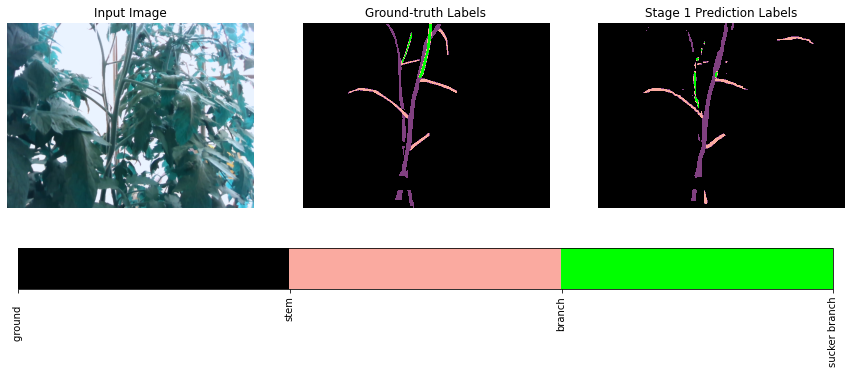

best val iou tensor(0.6025, device='cuda:0')


Train Epoch: [1/40] Loss: 0.0258 mPA: 98.99% FPS: 126.5 Lr: 0.0007729930 sucker: 0.0000 IOU1: 0.8119: 100%|██████████| 1956/1956 [14:57<00:00,  2.18it/s]


best_val


Train Epoch: [1/40] Loss: 0.1459 mPA: 97.94% FPS: 157.2 Lr: 0.0000000000 sucker_t: 75.0 sucker_f: 15.0   IOU1: 0.6255 : 100%|██████████| 245/245 [00:43<00:00,  5.67it/s]


idx: 169
Val Loss: 0.0794 FPS: 98.1 IOU: 0.5348


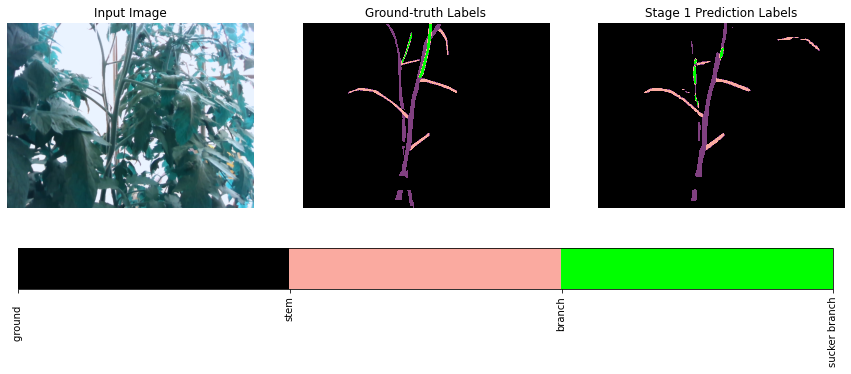

best val iou tensor(0.6255, device='cuda:0')


Train Epoch: [2/40] Loss: 0.0197 mPA: 99.23% FPS: 124.2 Lr: 0.0004298266 sucker: 0.0000 IOU1: 0.8496: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [2/40] Loss: 0.1620 mPA: 98.01% FPS: 155.9 Lr: 0.0000000000 sucker_t: 80.6 sucker_f: 13.5   IOU1: 0.6378 : 100%|██████████| 245/245 [00:43<00:00,  5.66it/s]


idx: 169
Val Loss: 0.0875 FPS: 114.4 IOU: 0.5484


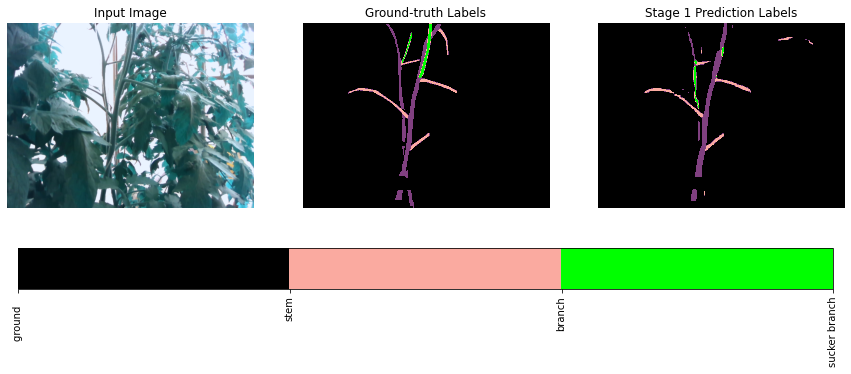

best val iou tensor(0.6378, device='cuda:0')


Train Epoch: [3/40] Loss: 0.0160 mPA: 99.37% FPS: 123.4 Lr: 0.0002390072 sucker: 0.0000 IOU1: 0.8719: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [3/40] Loss: 0.1842 mPA: 98.04% FPS: 154.3 Lr: 0.0000000000 sucker_t: 79.4 sucker_f: 12.9   IOU1: 0.6381 : 100%|██████████| 245/245 [00:43<00:00,  5.65it/s]


idx: 169
Val Loss: 0.1007 FPS: 110.0 IOU: 0.5491


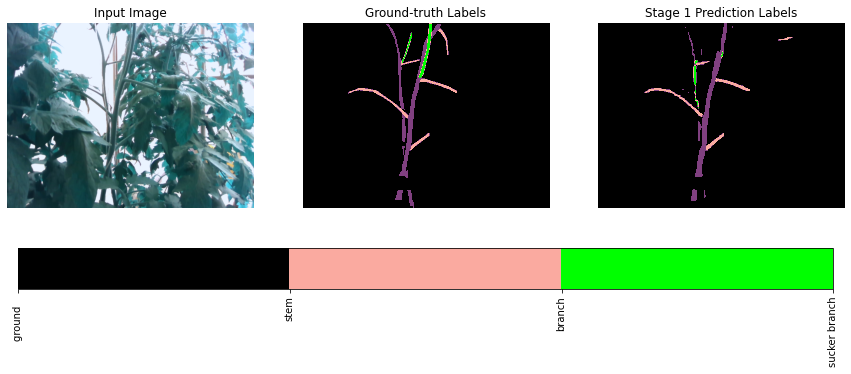

best val iou tensor(0.6381, device='cuda:0')


Train Epoch: [4/40] Loss: 0.0141 mPA: 99.44% FPS: 121.6 Lr: 0.0001329012 sucker: 0.0000 IOU1: 0.8837: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [4/40] Loss: 0.2022 mPA: 98.02% FPS: 155.0 Lr: 0.0000000000 sucker_t: 82.6 sucker_f: 13.6   IOU1: 0.6388 : 100%|██████████| 245/245 [00:43<00:00,  5.63it/s]


idx: 169
Val Loss: 0.1108 FPS: 109.3 IOU: 0.5733


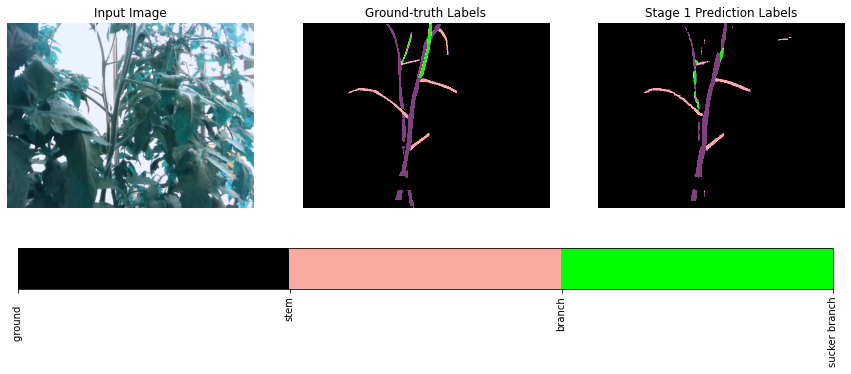

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [5/40] Loss: 0.0130 mPA: 99.48% FPS: 121.0 Lr: 0.0000739004 sucker: 0.0000 IOU1: 0.8897: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [5/40] Loss: 0.2136 mPA: 98.03% FPS: 153.0 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 12.2   IOU1: 0.6379 : 100%|██████████| 245/245 [00:43<00:00,  5.65it/s]


idx: 169
Val Loss: 0.1103 FPS: 109.4 IOU: 0.5741


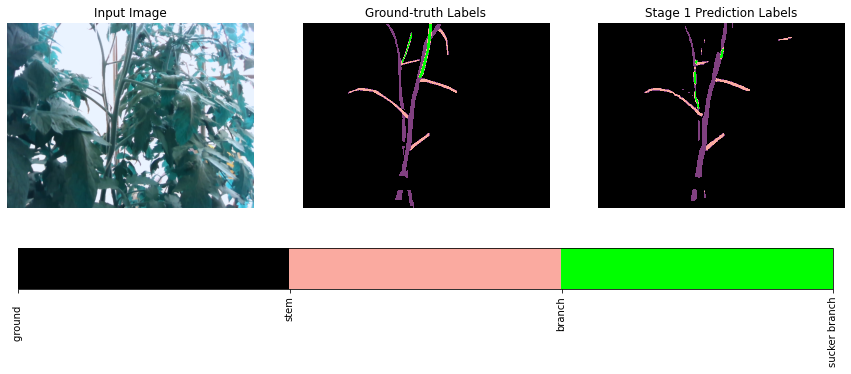

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [6/40] Loss: 0.0124 mPA: 99.51% FPS: 120.9 Lr: 0.0000410927 sucker: 0.0000 IOU1: 0.8939: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [6/40] Loss: 0.2240 mPA: 98.03% FPS: 153.6 Lr: 0.0000000000 sucker_t: 80.0 sucker_f: 12.4   IOU1: 0.6362 : 100%|██████████| 245/245 [00:43<00:00,  5.65it/s]


idx: 169
Val Loss: 0.1204 FPS: 97.7 IOU: 0.5597


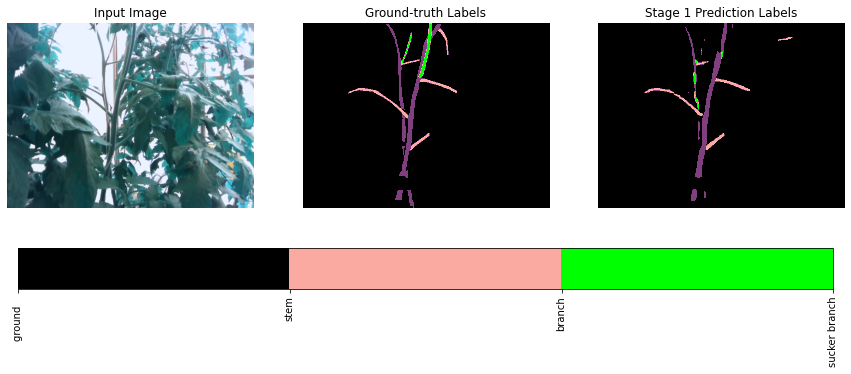

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [7/40] Loss: 0.0120 mPA: 99.52% FPS: 119.3 Lr: 0.0000228498 sucker: 0.0000 IOU1: 0.8969: 100%|██████████| 1956/1956 [14:58<00:00,  2.18it/s]


best_val


Train Epoch: [7/40] Loss: 0.2352 mPA: 98.03% FPS: 153.5 Lr: 0.0000000000 sucker_t: 81.5 sucker_f: 12.8   IOU1: 0.6376 : 100%|██████████| 245/245 [00:43<00:00,  5.65it/s]


idx: 169
Val Loss: 0.1232 FPS: 103.2 IOU: 0.5659


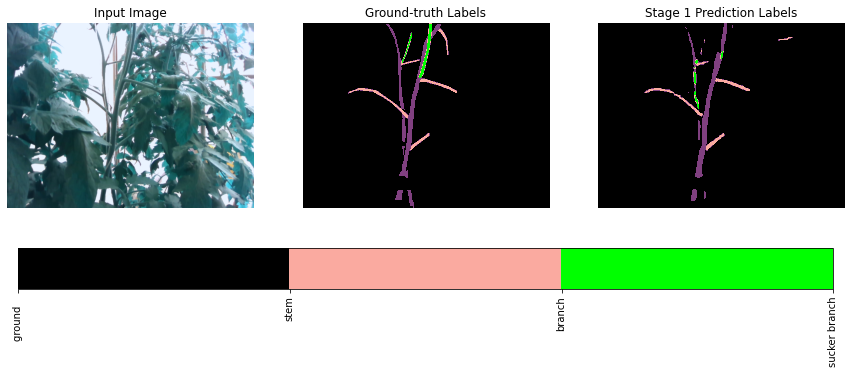

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [8/40] Loss: 0.0118 mPA: 99.53% FPS: 118.9 Lr: 0.0000127057 sucker: 0.0000 IOU1: 0.8973: 100%|██████████| 1956/1956 [14:57<00:00,  2.18it/s]


best_val


Train Epoch: [8/40] Loss: 0.2323 mPA: 98.03% FPS: 152.2 Lr: 0.0000000000 sucker_t: 80.0 sucker_f: 12.4   IOU1: 0.6357 : 100%|██████████| 245/245 [00:43<00:00,  5.64it/s]


idx: 169
Val Loss: 0.1200 FPS: 117.0 IOU: 0.5584


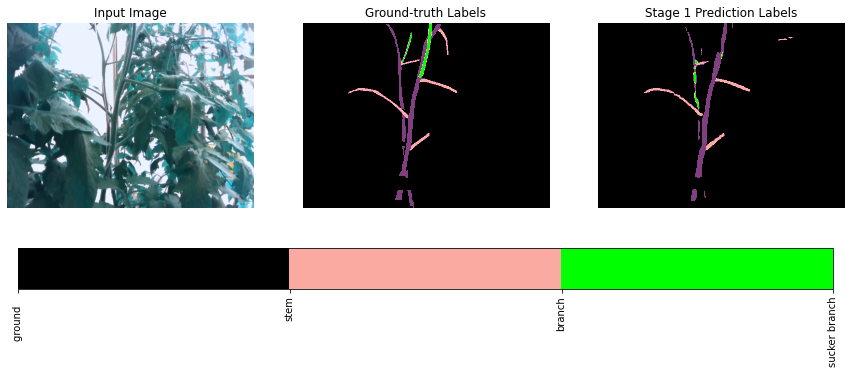

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [9/40] Loss: 0.0117 mPA: 99.53% FPS: 118.6 Lr: 0.0000070651 sucker: 0.0000 IOU1: 0.8995: 100%|██████████| 1956/1956 [14:57<00:00,  2.18it/s]


best_val


Train Epoch: [9/40] Loss: 0.2303 mPA: 98.03% FPS: 150.8 Lr: 0.0000000000 sucker_t: 80.2 sucker_f: 12.8   IOU1: 0.6367 : 100%|██████████| 245/245 [00:43<00:00,  5.64it/s]


idx: 169
Val Loss: 0.1222 FPS: 118.3 IOU: 0.5684


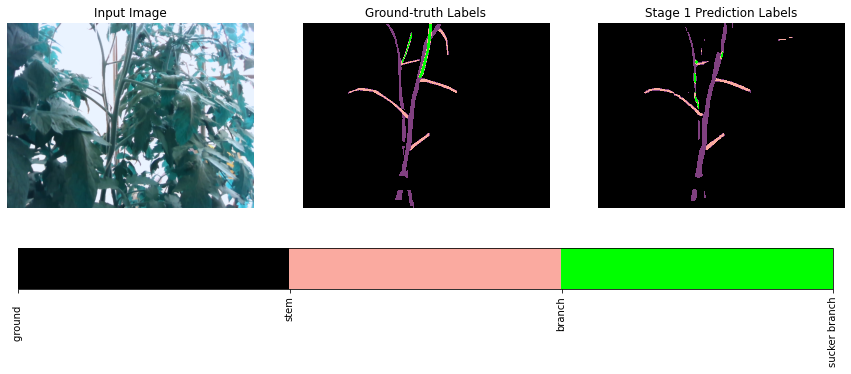

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [10/40] Loss: 0.0117 mPA: 99.53% FPS: 117.6 Lr: 0.0000039286 sucker: 0.0000 IOU1: 0.8982: 100%|██████████| 1956/1956 [14:57<00:00,  2.18it/s]


best_val


Train Epoch: [10/40] Loss: 0.2368 mPA: 98.02% FPS: 150.5 Lr: 0.0000000000 sucker_t: 80.7 sucker_f: 12.4   IOU1: 0.6366 : 100%|██████████| 245/245 [00:43<00:00,  5.65it/s]


idx: 169
Val Loss: 0.1207 FPS: 116.2 IOU: 0.5620


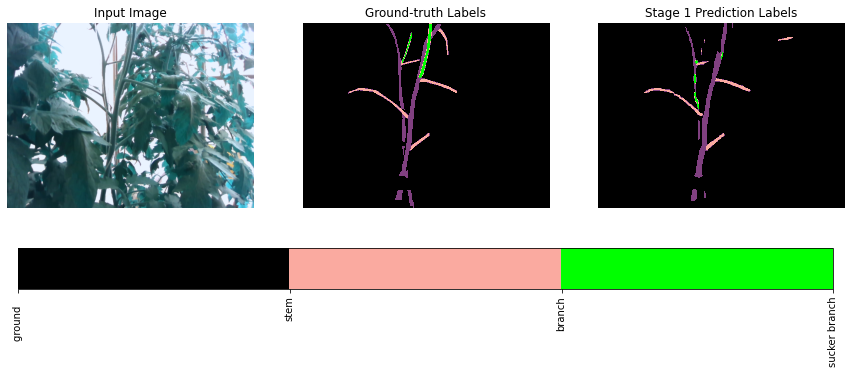

best val iou tensor(0.6388, device='cuda:0')


Train Epoch: [11/40] Loss: 0.0105 mPA: 99.58% FPS: 114.6 Lr: 0.0000039039 sucker: 0.0000 IOU1: 0.9067:   1%|          | 21/1956 [00:10<15:50,  2.04it/s]


KeyboardInterrupt: ignored

In [ ]:
trainer.train()

In [ ]:
trainer.load_epoch(4) 
#[4/40] Loss: 0.2022 mPA: 98.02% FPS: 155.0 Lr: 0.0000000000 sucker_t: 82.6 sucker_f: 13.6   IOU1: 0.6388 :
#[5/40] Loss: 0.2136 mPA: 98.03% FPS: 153.0 Lr: 0.0000000000 sucker_t: 80.4 sucker_f: 12.2   IOU1: 0.6379

Resuming training, loading /content/drive/MyDrive/colab/images/depthdataset/weights/custom_DeepLabv3_tomato_4.pth...


idx: 169
Val Loss: 0.1108 FPS: 113.4 IOU: 0.5733


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:243: DeprecationWarning: `np.long` is a deprecated alias for `np.compat.long`. To silence this warning, use `np.compat.long` by itself. In the likely event your code does not need to work on Python 2 you can use the builtin `int` for which `np.compat.long` is itself an alias. Doing this will not modify any behaviour and is safe. When replacing `np.long`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


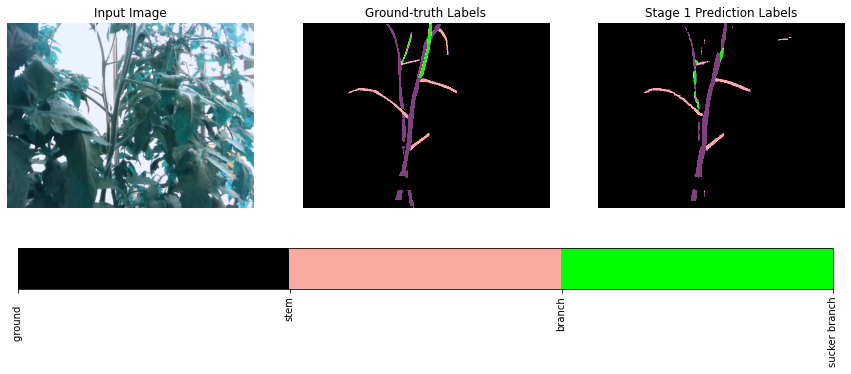

idx: 167
Val Loss: 0.0907 FPS: 114.7 IOU: 0.6177


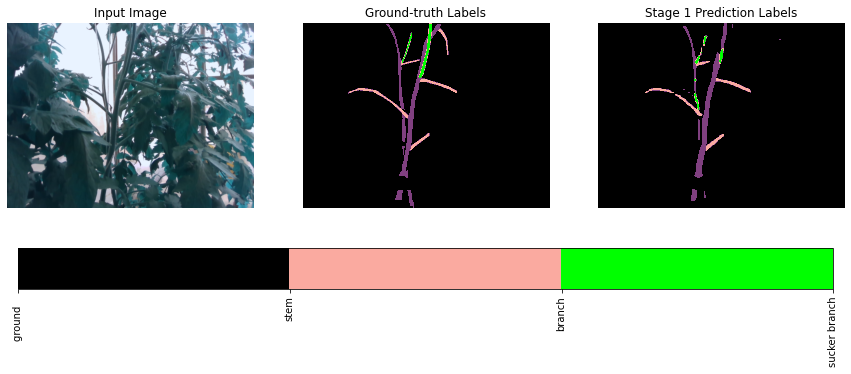

idx: 199
Val Loss: 0.1401 FPS: 114.5 IOU: 0.7514


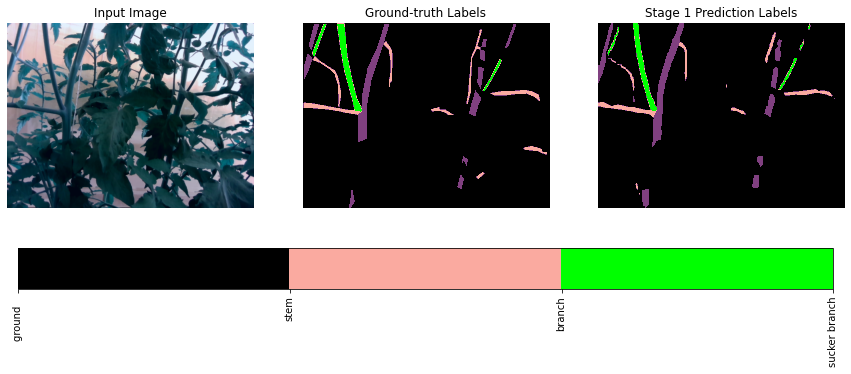

idx: 254
Val Loss: 0.0468 FPS: 78.8 IOU: 0.6850


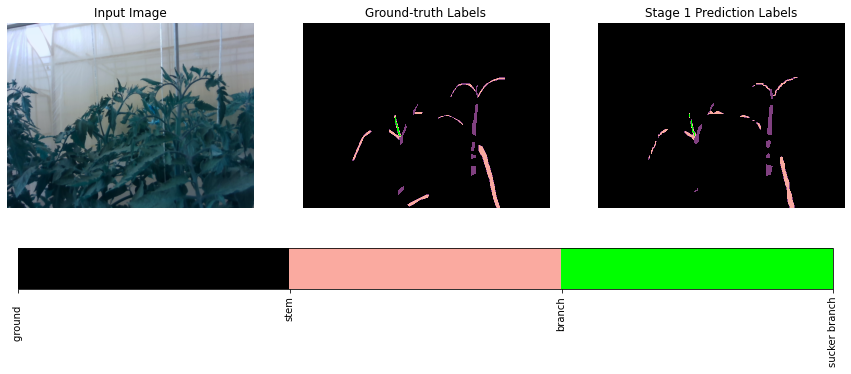

78.80474973696077

In [ ]:
trainer.random_val_predict(idx=169)
trainer.random_val_predict(idx=167)
trainer.random_val_predict(idx=199)
trainer.random_val_predict(idx=254)

In [ ]:
trainer.show_all_predict()

In [ ]:
from prettytable import PrettyTable

def count_parameters(model):
    table = PrettyTable(["Modules", "Parameters"])
    total_params = 0
    for name, parameter in model.named_parameters():
        if not parameter.requires_grad: continue
        param = parameter.numel()
        table.add_row([name, param])
        total_params+=param
    print(table)
    print(f"Total Trainable Params: {total_params}")
    return total_params
    
count_parameters(trainer.model)

+---------------------------------------+------------+
|                Modules                | Parameters |
+---------------------------------------+------------+
|         backbone.conv1.weight         |    9408    |
|          backbone.bn1.weight          |     64     |
|           backbone.bn1.bias           |     64     |
|     backbone.layer1.0.conv1.weight    |    4096    |
|      backbone.layer1.0.bn1.weight     |     64     |
|       backbone.layer1.0.bn1.bias      |     64     |
|     backbone.layer1.0.conv2.weight    |   36864    |
|      backbone.layer1.0.bn2.weight     |     64     |
|       backbone.layer1.0.bn2.bias      |     64     |
|     backbone.layer1.0.conv3.weight    |   16384    |
|      backbone.layer1.0.bn3.weight     |    256     |
|       backbone.layer1.0.bn3.bias      |    256     |
| backbone.layer1.0.downsample.0.weight |   16384    |
| backbone.layer1.0.downsample.1.weight |    256     |
|  backbone.layer1.0.downsample.1.bias  |    256     |
|     back

41999705

In [ ]:
def sizemodel(model):
  mem_params = sum([param.nelement()*param.element_size() for param in model.parameters()])
  mem_bufs = sum([buf.nelement()*buf.element_size() for buf in model.buffers()])
  mem = mem_params + mem_bufs # in bytes
  print('mem size:',mem)
sizemodel(trainer.model)

mem size: 168228172
